In [1]:
#This file seeks to use tf-idf on each entire cuisine, to identify what are the most important ingredient features per cuisine

In [ ]:
#term frequency formula

In [ ]:
#get the data

In [1]:
import csv, os, pandas as pd, pathlib, pprint, json, numpy as np
import bagOfWords as bow
from sklearn.feature_extraction.text import CountVectorizer

In [2]:
# Make sure json training json file exists

data_directory = os.path.join(os.getcwd(), "Dataset")
train_data_file_path = os.path.join(data_directory, "train.json")
test_data_file_path = os.path.join(data_directory, "test.json")
    
if(not pathlib.Path(train_data_file_path).is_file()):
    raise Exception("Missing train.json file in " + data_directory)

    
if(not pathlib.Path(test_data_file_path).is_file()):
    raise Exception("Missing test.json file in " + data_directory)

In [3]:
# Read JSON training data

with open(train_data_file_path, 'r') as f:
     trainData = pd.read_json(f)
f.closed

with open(test_data_file_path, 'r') as f:
     testData = pd.read_json(f)
f.closed

trainData.head()

,cuisine,id,ingredients
0,greek,10259,"[romaine lettuce, black olives, grape tomatoes..."
1,southern_us,25693,"[plain flour, ground pepper, salt, tomatoes, g..."
2,filipino,20130,"[eggs, pepper, salt, mayonaise, cooking oil, g..."
3,indian,22213,"[water, vegetable oil, wheat, salt]"
4,indian,13162,"[black pepper, shallots, cornflour, cayenne pe..."


In [4]:
trainData.shape

(39774, 3)

In [5]:
int(trainData.id.shape[0])

39774

In [6]:
# this is all of the ingredient occurrences across all of the recipes
from collections import Counter
allingredients_counter_for_idf = Counter()
for ingredients in trainData['ingredients']:
    allingredients_counter_for_idf.update(ingredients)

In [7]:
print(allingredients_counter_for_idf)

Counter({'salt': 18049, 'onions': 7972, 'olive oil': 7972, 'water': 7457, 'garlic': 7380, 'sugar': 6434, 'garlic cloves': 6237, 'butter': 4848, 'ground black pepper': 4785, 'all-purpose flour': 4632, 'pepper': 4438, 'vegetable oil': 4385, 'eggs': 3388, 'soy sauce': 3296, 'kosher salt': 3113, 'green onions': 3078, 'tomatoes': 3058, 'large eggs': 2948, 'carrots': 2814, 'unsalted butter': 2782, 'ground cumin': 2747, 'extra-virgin olive oil': 2747, 'black pepper': 2627, 'milk': 2263, 'chili powder': 2036, 'oil': 1970, 'red bell pepper': 1939, 'purple onion': 1896, 'scallions': 1891, 'grated parmesan cheese': 1886, 'sesame oil': 1773, 'corn starch': 1757, 'ginger': 1755, 'baking powder': 1738, 'jalapeno chilies': 1730, 'dried oregano': 1707, 'chopped cilantro fresh': 1698, 'fresh lemon juice': 1679, 'diced tomatoes': 1624, 'fresh parsley': 1604, 'minced garlic': 1583, 'chicken broth': 1554, 'sour cream': 1539, 'cayenne pepper': 1523, 'fresh ginger': 1503, 'brown sugar': 1503, 'cooking spray

In [8]:
print(len(allingredients_counter_for_idf))

6714


In [9]:
type(allingredients_counter_for_idf.keys())

dict_keys

In [10]:
#count the ingredients per cuisine - this will be our 'document frequency' for the whole cuisine

counters_each_cuisine_for_tf = {}
for cuisine in trainData['cuisine'].unique():
    counters_each_cuisine_for_tf[cuisine] = Counter()
    indices = (trainData['cuisine'] == cuisine)
    for ingredients in trainData[indices]['ingredients']:
        counters_each_cuisine_for_tf[cuisine].update(ingredients)

In [28]:
for cuisine in trainData['cuisine'].unique():
    print ("here is the ingredients for %s" % cuisine)
    print ("here is the items broken out")
    for key,value in counters_each_cuisine_for_tf[cuisine].items():
        print(key, value)

here is the ingredients for greek
here is the items broken out
romaine lettuce 39
black olives 31
grape tomatoes 26
garlic 216
pepper 203
purple onion 186
seasoning 3
garbanzo beans 23
feta cheese crumbles 252
ground pork 4
finely chopped fresh parsley 8
onions 185
salt 572
vinegar 3
caul fat 1
minced garlic 68
dried oregano 267
red wine vinegar 99
olive oil 504
boneless chop pork 1
lemon juice 183
orange 12
anise 5
cinnamon sticks 31
unflavored gelatin 2
zinfandel 2
orange blossom honey 3
sugar 77
lemon 129
calimyrna figs 1
clove 14
honey 67
whipping cream 2
plain whole-milk yogurt 5
fresh dill 108
yoghurt 10
myzithra 2
large eggs 72
cheese 15
feta cheese 191
phyllo 12
kefalotyri 9
ground black pepper 221
extra-virgin olive oil 229
hamburger buns 6
paprika 20
chopped fresh mint 68
ground cinnamon 73
balsamic vinegar 24
baby spinach leaves 9
ground lamb 68
dried mint flakes 15
tomatoes 156
dried dillweed 10
red wine 10
lamb 12
plain yogurt 56
pita bread rounds 16
cucumber 187
liquid 2


firmly packed brown sugar 1
sweet potatoes 1
egg whites 3
mustard greens 3
pasta sauce 3
prepared pizza crust 1
black lentil 1
challa 1
KnorrÂ® Vegetable recipe mix 1
water chestnuts 2
hellmann' or best food light mayonnais 1
frozen chopped spinach, thawed and squeezed dry 1
lamb stock 2
anise seed 4
noodles 1
tuna packed in water 1
butter lettuce 2
crimini mushrooms 2
whole wheat tortillas 2
tempeh 2
yeast 2
grill seasoning 2
powdered sugar 3
hot cherry pepper 1
pesto 1
malt vinegar 1
tentacles 2
whole wheat rotini pasta 1
cannellini beans 3
nonfat yogurt plain 3
lamb fillet 1
low-fat yogurt 1
beef bouillon 1
green leaf lettuce 2
vine leaves 2
cooked quinoa 1
pointed peppers 1
pork 2
mahimahi 1
hearts of romaine 1
banana peppers 2
lamb leg 1
parsnips 1
canola mayonnaise 1
nonfat buttermilk 1
vanilla beans 1
apricots 1
freshly grated parmesan 3
tortellini 1
fresh cheese 1
cod fillets 2
ground walnuts 2
ground almonds 1
organic chicken 1
potato rolls 1
raspberry vinegar 2
diced celery 1

chicken bouillon granules 7
reduced fat cheddar cheese 4
prepared mustard 17
Ritz Crackers 3
mushrooms 9
Uncle Ben's Original Converted Brand rice 1
beef consomme 1
raw honey 3
almonds 6
cacao powder 1
corn 35
cocktail sauce 4
tartar sauce 12
noodles 3
fresh rosemary 20
pork shoulder 11
salted butter 26
cherry gelatin 2
rocket leaves 2
crushed pineapples in juice 6
poppy seeds 6
bing cherries 2
rolls 11
halibut 1
dark ale 1
pork ribs 4
fresh blueberries 12
roasted ground cumin 1
Saigon cinnamon 3
collard green leaves 4
cranberries 4
capers 8
fresh chives 21
bread crumb fresh 19
ground pork 2
quail 3
yukon gold potatoes 8
grated lemon zest 31
seedless red grapes 1
lemon slices 12
fresh tarragon 17
peaches in heavy syrup 6
center cut loin pork chop 1
low sodium soy sauce 4
cream of celery soup 4
celery heart 1
mild pork sausage 1
pie crust mix 1
McCormickÂ® Pure Vanilla Extract 1
freshly grated parmesan 4
milk chocolate 3
russet 1
cube steaks 4
chop fine pecan 27
orange slices 2
black te

crushed graham crackers 5
digestive biscuit 1
triple sec 3
amaretto liqueur 2
energy drink 1
cola-flavored carbonated beverage 1
cultured buttermilk 3
extra large eggs 6
ground sumac 2
liver pate 1
color food orang 1
vanilla powder 2
muenster cheese 2
frosting 15
fudge brownie mix 2
dried cherry 3
reduced fat creamy peanut butter 1
spiced rum 3
kumquats 3
cayenne pepper sauce 1
grapefruit 1
red grapefruit juice 1
snapper fillets 1
chopped cilantro 6
plain yogurt 10
potato chips 1
grenadine syrup 2
bacardi 1
mild cheddar cheese 3
schnapps 1
frogs legs 1
sugar pea 4
banana squash 1
greek yogurt 3
honey graham crackers 1
vanilla almondmilk 1
cornish hens 1
rosewater 1
crumb topping 3
mango chutney 2
rich chicken stock 1
chunky peanut butter 2
trout 3
fillets 5
cinnamon sugar 4
almond liqueur 1
coarse sugar 1
hot pepper 3
nuts 2
white frostings 4
smoked fully cooked ham 1
navel oranges 13
root beer 1
melted fat 1
pimento stuffed green olives 2
sourdough baguette 1
essence 2
serrano chile 1

baby okra 1
vanilla lowfat yogurt 2
Oscar Mayer Bacon 1
KRAFT Shredded Cheddar Cheese 1
crisco 4
arugula 6
ruby red grapefruit 2
butter pecan ice cream 2
dr pepper 1
frozen meatballs 1
hellmann' or best food real mayonnais 3
honey whiskey 1
shiitake mushroom caps 1
portabello mushroom 2
mesquite flavored seasoning mix 1
smoked turkey sausage 1
Karo Corn Syrup 1
cubed ham 1
red beans 3
coffee ice cream 2
toffee bits 2
lobster tails 1
walnuts 3
habanero pepper 4
cake mix or white yellow 1
licorice root 1
french dressing 1
candied orange peel 1
vanilla pudding 3
large marshmallows 1
challa 1
dried dill 1
nonfat milk 2
low-fat cottage cheese 1
Fisher Pecan Halves 1
baby spinach 4
bacon salt 1
enchilada sauce 1
chocolate ice cream 1
butterscotch sauce 1
cranberry juice 3
white grapefruit juice 1
buckwheat flour 1
plain whole-milk yogurt 2
chile paste 1
pork and beans 4
honey glazed ham 1
pork stock 3
tap water 1
strawberry gelatin 1
diced yellow onion 1
crushed cornflakes 1
edible flowers 2

cheese 4
ham 3
sweet pickle relish 2
chicken breasts 14
crushed pineapple 2
sweet pickle 3
chorizo 5
fully cooked luncheon meat 1
leeks 3
chinese duck sauce 1
cane vinegar 6
dried rice noodles 3
cooked chicken breasts 4
whole chicken 4
annatto 2
lemon grass 2
palm vinegar 3
fried eggs 2
fried rice 1
beef 11
bottom round 2
sirloin 1
chicken wings 8
beans 2
chili 3
pork baby back ribs 1
cooked rice 6
dried basil 1
tilapia fillets 3
onion powder 2
celery salt 1
parmesan cheese 1
fresh lemon juice 2
jackfruit 10
taro 3
liver 13
bread crumbs 10
crabmeat 1
peas 3
eggplant 20
pork butt 8
cream cheese 4
vanilla extract 21
greater yam 3
plain breadcrumbs 1
bread flour 6
vegetable shortening 3
cider vinegar 5
Turkish bay leaves 1
chicken drumsticks 5
sausages 3
white pepper 3
peanut oil 6
long-grain rice 4
greens 1
quinoa 1
bone-in chicken 2
ghee 1
melted butter 8
flour for dusting 2
squash 2
leaves 16
green papaya 8
safflower 1
grape tomatoes 1
fennel seeds 1
ground cinnamon 4
bacon drippings 1

ground turmeric 728
burger buns 1
garlic cloves 446
panko breadcrumbs 4
chickpea flour 44
pepper 205
Sriracha 2
chickpeas 143
carrots 197
ground flaxseed 1
soy sauce 20
olive oil 359
greens 13
tahini 3
scallions 35
fenugreek leaves 56
black mustard seeds 106
amchur 69
lime wedges 27
coriander 227
sugar 335
fingerling potatoes 2
green chilies 484
chopped cilantro 155
ramps 1
black peppercorns 122
cinnamon sticks 256
cardamom pods 121
coriander seeds 210
baby spinach leaves 17
unsalted butter 67
chopped garlic 27
large shrimp 26
sea salt 85
coconut milk 216
ground coriander 380
basmati rice 246
cauliflower 120
cumin 178
minced garlic 92
raisins 75
pearl barley 1
slivered almonds 16
ground black pepper 210
flat leaf parsley 5
parsnips 5
chili oil 3
brown mustard seeds 53
cooking spray 64
yukon gold potatoes 27
quinoa 13
nonfat milk 4
granny smith apples 11
paprika 189
chicken broth 43
chicken breasts 75
chopped onion 97
chopped celery 11
lime zest 7
purple onion 170
boiling water 16
spina

beef stock 4
sugarcane juice 1
white button mushrooms 3
low fat plain yoghurt 3
halibut fillets 3
cream cheese 2
papad 4
mint sauce 3
vegetable shortening 3
urad dal split 3
grape tomatoes 5
tomatoes with juice 5
frozen corn kernels 1
nonfat plain greek yogurt 7
center-cut salmon fillet 1
low-fat milk 6
ginger piece 3
green gram 2
instant rice 2
deveined shrimp 5
frozen peas and carrots 1
onion rings 3
whipped cream 3
yellow corn meal 2
mahimahi 1
ground chicken breast 2
Italian parsley leaves 1
allspice 9
baby lima beans 1
fat free reduced sodium chicken broth 2
fresh pineapple 3
olives 4
rice noodles 2
dried arbol chile 1
silver 1
sliced almonds 25
teas 11
confectioners sugar 5
toasted peanuts 2
unsweetened applesauce 2
part-skim ricotta cheese 1
hungarian paprika 4
bone in skin on chicken thigh 1
drummettes 1
dry roasted peanuts 4
dried currants 7
vegetable oil spray 3
corn oil 5
sweetened coconut flakes 9
low fat cream 2
egg whites 4
mixed nuts 1
dry red wine 2
pappadams 5
wafer 3


shoulder lamb chops 1
true cinnamon 1
cider 1
top sirloin steak 1
green tomatoes 1
sour milk 1
ground blanched almonds 1
green plantains 1
white fleshed fish 1
small green chile 2
vine tomatoes 1
paste tomato 1
ground turkey 1
chunky peanut butter 1
Nido Milk Powder 1
yellow peas 1
demerara sugar 1
fresh bay leaves 1
fresh chives 1
boneless salmon fillets 1
low-fat buttermilk 2
grapes 1
whole grain mustard 1
unsulphured molasses 1
seasoned rice wine vinegar 1
fresh cranberries 1
powdered turmeric 1
gluten free all purpose flour 1
russet 1
iceberg lettuce 1
brown mustard 1
tandoori masala mix 1
coarse semolina 1
mild green chiles 1
color food orang 2
salmon steaks 1
jackfruit 1
less sodium soy sauce 1
chiffonade 1
stir fry vegetable blend 1
salami 1
duck 1
lamb cutlet 1
tomato chutney 1
rice stick noodles 1
chile paste with garlic 1
crust 1
pea pods 1
dried oregano 1
sirloin steak 1
Lipton Lemon Iced Tea Mix 1
rib eye steaks 1
fat free beef broth 1
scallops 1
unbleached flour 1
nonfat m

goat 3
melted butter 3
active dry yeast 2
vegetable broth 3
baby spinach 2
diced tomatoes 8
salmon steaks 1
large garlic cloves 6
cold milk 1
any 2
russet potatoes 1
skirt steak 1
butternut squash 4
yellow split peas 2
waxy potatoes 1
sweet corn 2
cod fish 2
coconut sugar 2
butter beans 2
rubbed sage 2
tarragon vinegar 1
bread 3
green pepper 5
light beer 1
diced red onions 1
vegetable bouillon cube 1
egg noodles 1
heavy whipping cream 1
jerk paste 2
chopped cilantro fresh 7
dry white wine 2
curry sauce 1
blue crabs 1
taro leaf 1
pig 2
cubed pumpkin 1
unsweetened shredded dried coconut 1
red apples 1
seasoning salt 6
jamaican curry powder 2
Jamaican allspice 4
no-salt-added black beans 1
vegetable oil cooking spray 2
no salt added chicken broth 1
chunky salsa 1
refrigerated crescent rolls 1
salsa 1
juice 1
grated parmesan cheese 2
homemade chicken stock 1
creamed coconut 1
peas 6
pimentos 7
crabmeat 1
greens 2
salt pork 2
soy 1
large shrimp 3
browning 6
rosemary leaves 1
oregano 3
half 

rioja 5
pork shoulder butt 2
smoked sweet Spanish paprika 5
fatback 1
dry red wine 26
tomato juice 24
salsa 6
canned chicken broth 2
hot pepper sauce 12
cider vinegar 8
rice 19
sofrito 1
parsley sprigs 8
ground turkey breast 2
lower sodium chicken broth 4
spanish chorizo 41
escarole 6
bay leaves 39
boneless chicken thighs 2
boiling water 9
tomato sauce 19
ketchup 6
citrus vinaigrette 1
scallions 23
quinoa 2
figs 2
cilantro 6
yellow peppers 3
squid 11
paella rice 4
fish stock 11
sweet onion 18
sobrasada 1
vegetable shortening 2
leg of lamb 4
ice water 9
orange juice 18
cold milk 1
cinnamon 9
sugar pea 2
hot sauce 12
evaporated milk 5
cream cheese 3
vanilla extract 30
sweetened condensed milk 14
fideos 6
reduced sodium chicken broth 7
pure olive oil 2
freshly ground pepper 26
white wine 21
boneless skinless chicken breasts 13
black olives 4
rolls 2
tomato paste 37
meat loaf mix 1
beef broth 6
iceberg lettuce 1
ground oregano 1
garlic mayonnaise 1
long grain brown rice 1
prosciutto 6
red 

black forest ham 1
peasant bread 1
cranberry beans 1
hass avocado 3
coriander seeds 3
seedless watermelon 1
aged balsamic vinegar 3
regular cucumber 2
red capsicum 1
chillies 1
smoked chorizo 1
kirsch 2
mild olive oil 1
pearl onions 1
japanese eggplants 1
golden zucchini 1
crushed ice 1
whole cloves 1
ground tumeric 1
tamarind paste 1
demerara sugar 1
pizza doughs 2
egg substitute 2
tortillas 1
parmigiano reggiano cheese 1
corkscrew pasta 1
fat-free chicken broth 1
white cheddar cheese 1
ground chicken 1
white hominy 1
frozen chopped spinach, thawed and squeezed dry 1
vermicelli 1
kirschenliqueur 1
baby lima beans 2
whole wheat flour 1
beef 2
fried eggs 1
sweet corn 1
minced pork 1
country style bread 2
sage 1
cauliflower 2
rum 1
orange liqueur 2
chuck 2
pepper sauce 2
burrito seasoning mix 1
pork shoulder 1
shredded cheddar cheese 2
bacon drippings 1
green papaya 1
papaya 2
rib roast 1
table salt 1
whitefish 1
chicken gizzards 1
corn oil 1
gravenstein apple 1
won ton wrappers 1
green 

chicken 84
pitas 5
goat cheese 92
reduced fat milk 29
smoked trout 1
fresh dill 16
asparagus 123
oil 92
ricotta salata 22
pecorino cheese 52
grana padano 7
pasta 255
cracked black pepper 117
green bell pepper 163
vidalia onion 19
smoked gouda 14
baby spinach leaves 39
shredded sharp cheddar cheese 17
small red potato 13
BertolliÂ® Classico Olive Oil 16
bacon, crisp-cooked and crumbled 2
bertolli vineyard premium collect marinara with burgundi wine sauc 5
bread crumb fresh 74
(    oz.) tomato sauce 7
ground veal 35
italian seasoning mix 1
beef 22
fat skimmed chicken broth 28
solid pack pumpkin 4
ground nutmeg 127
white rice 11
ground pepper 77
fresh thyme leaves 53
pistachios 10
dried cherry 6
prosciutto 256
romano cheese 89
parsley leaves 23
shallots 316
fresh raspberries 14
dry vermouth 18
canned low sodium chicken broth 46
chicken livers 14
raisins 39
seasoned bread crumbs 71
minced garlic 334
half & half 89
ground beef 237
jack cheese 9
vegetables 29
lemon juice 216
ricotta 95
yello

liquid 5
fresh chevre 4
pork sausages 14
dried minced onion 5
msg 2
pork stew meat 1
beef stew meat 3
ziti 26
Balsamico Bianco 2
ground mustard 1
chocolate 5
orange soda 1
compote 3
low-fat plain yogurt 5
snow peas 8
baby eggplants 2
mint leaves 19
lima beans 4
crÃ¨me fraÃ®che 19
wagon wheels 1
basmati rice 2
marrons 1
cocoa 6
fresh blueberries 5
sweetened condensed milk 9
soy milk 2
unsalted margarine 2
apple juice 6
yellow corn 1
shell-on shrimp 3
KNUDSEN 2% Milkfat Low Fat Cottage Cheese 1
KRAFT Reduced Fat Shredded Mozzarella Cheese 1
soy sauce 15
Emmenthal 2
blue cheese 7
ground coriander 11
sourdough bread 22
collard greens 5
marjoram 32
low sodium vegetable broth 3
medium egg noodles 8
brine-cured black olives 10
havarti cheese 2
shell pasta 6
blackberries 15
syrup 4
crÃ¨me de cassis 3
low-fat ricotta cheese 9
pumpkin 9
caponata 1
store bought low sodium chicken broth 2
cutlet 9
sage 22
pepper flakes 12
bocconcini 17
fillet red snapper 7
white vinegar 22
part-skim mozzarella 22


ground walnuts 4
lamb 3
poultry 1
Stonefire Italian Artisan Pizza Crust 2
sea salt flakes 3
italian pork sausage 5
whole wheat seasoned breadcrumbs 1
boned lamb shoulder 2
edible flowers 1
vidalia 2
whole wheat orzo 1
whipped cream cheese 2
simple syrup 2
challa 1
beer 4
whole wheat penne 5
celtic salt 3
cream sherry 2
cookies 8
pignolis 2
sunflower seeds 3
green garlic 3
low-fat mayonnaise 2
garam masala 1
ground turmeric 2
coriander powder 1
jeera 1
shredded cheese 10
whole wheat baguette 2
onion tops 2
bone in chicken thighs 5
fresh green bean 11
pound cake mix 1
unsweetened chocolate 5
chopped nuts 1
spiny lobsters 1
ground hazelnuts 1
peeled fresh ginger 11
cranberry juice 2
vanilla vodka 1
white creme de cacao 1
club soda 3
whole wheat linguine 4
deveined shrimp 6
chicken pieces 2
salad oil 3
toasted sesame oil 2
rice vinegar 8
thai basil 2
refrigerated chocolate chip cookie dough 1
molasses 4
bourbon whiskey 5
San Marzano Crushed Tomatoes 1
frozen meatballs 1
roast beef deli mea

passion fruit 1
snapper fillets 1
carrot sticks 1
top round steak 2
DeLallo Penne Ziti 1
garlic pepper seasoning 2
crushed pineapple 2
refrigerated seamless crescent dough 1
KRAFT Zesty Italian Dressing 2
crab 3
acini di pepe 3
wheat 5
boneless duck breast 1
sliced salami 1
chocolate syrup 2
cappuccino 1
blackberry jam 1
cocktail cherries 2
snaps 1
alphabet pasta 1
fat free beef broth 1
reduced sodium vegetable stock 1
marjoram leaves 1
cookie crumbs 2
unsweetened coconut milk 1
crepes 1
sparkling wine 2
kielbasa 2
lemon thyme 1
brown shrimp 1
bacon fat 1
frozen hash browns 1
quinces 2
quahog clams 1
barley 1
KRAFT Shredded Low-Moisture Part-Skim Mozzarella Cheese 1
smoked sea salt 1
framboise eau-de-vie 1
finely ground coffee 1
colby jack cheese 1
diced chicken 1
lamb loin chops 2
stone ground mustard 1
whole wheat berries 1
pies 1
enokitake 1
king crab legs 1
fat free less sodium vegetable broth 1
demi-glace 1
yellow mustard 3
cream filled chocolate sandwich cookies 1
irish cream liq

kahlÃºa 3
corn starch 56
instant espresso powder 9
boneless chicken skinless thigh 46
epazote 42
bay leaf 75
radishes 108
oregano 198
white onion 405
hominy 74
tomatillos 310
pepitas 18
chocolate bars 3
marshmallows 1
cinnamon graham crackers 1
black beans 811
quinoa 57
diced tomatoes 545
frozen corn 136
vegetable broth 75
piloncillo 22
ground allspice 39
water 907
hibiscus 1
ground cloves 69
cinnamon sticks 67
ground nutmeg 9
white sugar 75
condensed cream of mushroom soup 21
condensed cream of chicken soup 33
lean ground beef 158
Mexican cheese blend 169
chunky salsa 66
taco seasoning mix 181
salsa 923
refried beans 250
grated jack cheese 49
hot sauce 180
chicken stock 146
bone-in chicken breasts 3
red bell pepper 405
tomato paste 149
white hominy 61
tortilla chips 294
cilantro leaves 328
dried chile peppers 1
cabbage 54
granulated sugar 47
large egg whites 31
chicken broth 393
chees fresco queso 31
swiss chard 4
red pepper flakes 57
tomato sauce 240
garlic salt 94
pasta 22
pepper 80

dry mustard 9
hamburger buns 7
ground chicken breast 4
shredded reduced fat cheddar cheese 30
reduced fat cream cheese 6
sesame oil 4
fillets 12
reduced sodium soy sauce 2
fat-free chicken broth 10
white wine vinegar 24
dried lentils 5
sharp cheddar cheese 50
california avocado 8
vine ripened tomatoes 12
masa dough 12
corn husks 65
vegetable shortening 19
couscous 4
boiling water 35
red chili peppers 43
orange 66
grapefruit 3
habanero pepper 7
fat free cream cheese 6
frozen sweet corn 8
salted butter 3
ranch dressing 45
light mayonnaise 11
confectioners sugar 20
dulce de leche 2
pure vanilla extract 13
melted butter 13
cream of chicken soup 45
ice 22
evaporated milk 32
diced tomatoes with garlic and onion 3
pork loin chops 5
low-fat buttermilk 6
unsweetened soymilk 2
cooked pumpkin 1
frozen limeade 7
frozen strawberries 3
lemon-lime soda 3
whipped cream 6
mexican style 4 cheese blend 9
chicken fingers 10
cheese spread 5
vegetarian refried beans 11
chopped garlic 33
ragu old world style

pitted olives 8
pepperidge farm puff pastry 3
lean steak 1
rich turkey stock 1
seedless green grape 3
pears 4
ramps 1
garlic chives 1
syrup 3
crushed pineapple 3
ginger 8
avocado leaves 6
banana leaves 7
black turtle beans 2
anasazi beans 2
flour tortillas (not low fat) 3
jalape 6
crumbled gorgonzola 2
stout 1
chuck steaks 1
Bisquick Baking Mix 5
Old El Pasoâ„¢ Thick 'n Chunky salsa 7
fresh tarragon 2
dried black beans 16
boneless beef round steak 1
pickling liquid 1
cuban peppers 4
chicken chorizo sausages 1
textured soy protein 2
boneless chuck roast 4
lemon peel 1
Velveeta Cheese Spread 1
cantaloupe 7
mango salsa 3
refried black beans 8
frozen peas 6
spanish paprika 2
sunflower oil 4
7 Up 1
grenadine 1
wine 1
blanco tequila 2
bitters 2
low sodium pinto beans 1
meat sauce 1
squash 8
40% less sodium taco seasoning 7
mustard greens 1
sliced tomatoes 7
Jarlsberg 1
chilcostle chile 1
whole cloves 10
fresh green bean 2
america 1
Johnsonville Hot & Spicy Breakfast Links 1
pozole 4
grated l

fresh chili 2
long grain brown rice 2
Jiffy Corn Muffin Mix 1
vegetarian chicken 1
salt pork 2
olive oil cooking spray 5
creole style seasoning 1
cooking sherry 1
Alfredo sauce 1
baby bok choy 1
kohlrabi 1
brewed coffee 2
bisquick 2
orange zest 6
muenster 2
mixed spice 3
grenadine syrup 2
king prawns 1
sage 3
cactus paddles 3
guacamole seasoning mix 1
lingcod 1
yellow summer squash 2
Ritz Crackers 1
jerk marinade 1
coconut cream 1
bock beer 1
pina colada mix 1
Mrs. Dash 1
tenderloin roast 1
canadian bacon 1
snapper fillets 2
orange rind 3
dinosaur kale 1
hot dogs 3
hot dog bun 2
seafood seasoning 2
canned beans 2
pig feet 1
smoked ham 1
silver 1
less sodium beef broth 1
celtic salt 1
biscuit dough 1
cajun seasoning mix 1
top sirloin steak 2
semi-sweet chocolate morsels 5
kahlua 1
(14 oz.) sweetened condensed milk 1
sweet potatoes & yams 1
pasta shapes 1
grilled chicken strips 1
cake yeast 1
orange flower water 1
tostitos 2
Boston lettuce 4
scrod fillets 1
Minute White Rice 1
steamer 2


dipping sauces 14
lean ground pork 20
dark sesame oil 96
honey 241
boneless skinless chicken breasts 198
ketchup 110
flour 93
baking powder 52
whiskey 2
chicken wings 41
green chilies 14
hoisin sauce 323
black pepper 121
whole grain thin spaghetti 1
red bell pepper 157
baby bok choy 44
grapeseed oil 10
organic sugar 2
boneless chicken breast 29
fish sauce 63
steamed white rice 15
caramel sauce 1
chili pepper 31
boneless skinless chicken 12
fennel seeds 12
liquorice 1
green cardamom 1
cinnamon sticks 41
szechwan peppercorns 134
beef 30
chinese black bean 2
cooking wine 35
dried chile 14
rock sugar 14
bean paste 28
brown cardamom 1
bay leaf 4
cornflour 64
fillets 7
spring onions 148
white wine vinegar 21
bamboo shoots 77
chillies 14
fresh coriander 11
fresh mushrooms 24
granulated garlic 1
milk 33
vinegar 50
chili oil 68
mung bean sprouts 24
sesame paste 13
noodles 69
pickled vegetables 5
boneless skinless chicken breast halves 53
granulated sugar 38
unsalted dry roast peanuts 13
dry she

finely chopped onion 5
serrano peppers 3
homemade chicken broth 2
chicken bouillon 10
leg quarters 2
ham 8
cooked quinoa 4
buttermilk 2
panko 7
soy bean paste 1
curly kale 2
flour for dusting 2
mushroom powder 1
bean sauce 14
powdered milk 5
double-dark soi sauc 1
white rice vinegar 7
pork spare ribs 8
tomato purÃ©e 9
lemon peel 1
florets 4
store bought low sodium vegetable stock 1
baby carrots 7
lime zest 1
duck breasts 8
boneless chop pork 3
chinese wolfberries 1
white radish 3
dates 8
black mushrooms 1
dough 6
garlic bulb 1
fatfree lowsodium chicken broth 1
garbanzo beans 1
arrowroot starch 1
millet flour 2
mo hanh 2
herbs 4
low salt chicken broth 13
capellini 2
low sodium vegetable broth 1
oxtails 4
Yakisoba noodles 7
crimini mushrooms 4
fresh pineapple 8
chopped walnuts 3
chicken meat 8
fish paste 2
pork baby back ribs 4
bourbon whiskey 1
sweetened condensed milk 6
seaweed 3
leaves 6
fresh basil leaves 2
dried thyme 3
dill 1
yellow bell pepper 9
angel hair 4
pork loin 11
chilegarl

pumpkin 1
medium shrimp uncook 2
rainbow trout 1
hamburger 1
cream of celery soup 1
wieners 1
lamb 2
filet 4
tangzhong roux 1
chopped ham 1
beef roast 1
Kikkoman Soy Sauce 3
tiger lily buds 1
frozen spinach 1
reduced sodium teriyaki sauce 1
lo bok 1
chuka soba noodles 1
diced mushrooms 1
roast duck meat 1
vegetarian oyster sauce 2
soybean sprouts 2
ginkgo nut 2
fat skimmed reduced sodium chicken broth 1
candied pineapple 1
chopped nuts 1
self raising flour 1
frozen mixed thawed vegetables, 1
boiled ham 2
yolk 1
chicken wingettes 1
old bay seasoning 1
lipton pure leaf unsweeten iced tea 1
dried fig 1
cognac 1
pineapple syrup 1
Kikkoman Less Sodium Soy Sauce 1
refrigerated bread dough 1
Kikkoman Oyster Sauce 2
water chestnut powder 1
slider buns 1
thyme leaves 1
shanghai bok choy 2
whitefish fillets 1
mochiko 1
fish balls 1
red snapper 1
fronds 1
rice bran oil 1
Haas avocados 1
granulated white sugar 4
fresh peas 1
black cardamom pods 1
dried soba 1
honey dijon mustard 1
rub 1
asian barb

pound cake 4
crushed garlic 1
sharp cheddar cheese 8
top round roast 1
sourdough 1
roast beef 5
parsley leaves 2
flaked coconut 1
filet mignon 2
goose liver 1
duxelles 2
ground veal 1
onion gravy 1
ground thyme 2
marjoram 4
ground sage 4
cumin seed 3
wine syrup 1
foie gras 3
minced onion 1
chopped garlic 5
tapioca flour 1
full fat coconut milk 1
coconut oil 2
root vegetables 1
chillies 1
groundnut 1
coriander 1
chili powder 1
cooking oil 6
passata 1
caramels 2
pecans 7
bicarbonate of soda 8
cooking fat 1
Scotch whisky 2
frozen pound cake 4
meat 2
chopped onion 5
sweet pickle relish 1
skinless haddock 1
mayonaise 7
Tabasco Pepper Sauce 3
flank steak 1
thyme 7
sirloin 2
baked beans 3
streaky bacon 1
pork sausages 13
granulated white sugar 1
lamb leg 1
cider vinegar 6
chocolate covered english toffee 3
fresh blueberries 6
Swerve Sweetener 1
raspberry liqueur 1
chopped fresh mint 2
liver pate 5
Burgundy wine 2
dried basil 1
full fat cream cheese 1
eating apple 1
allspice 8
chopped hazelnut

garlic powder 19
flank steak 30
fresh cilantro 114
zucchini 44
olive oil 114
crushed red pepper flakes 38
low sodium soy sauce 46
large eggs 64
linguine 15
cooked shrimp 9
fresh turmeric 7
white peppercorns 10
pork tenderloin 14
dry roasted peanuts 26
pineapple 16
cooking spray 39
crusty bread 2
skinless chicken breasts 11
chicken stock 70
sweet potatoes 30
curry paste 46
lettuce leaves 14
ground pork 20
white rice 10
lime rind 22
boneless skinless chicken breasts 115
light brown sugar 53
reduced fat creamy peanut butter 2
boneless skinless chicken breast halves 49
water chestnuts 18
baby corn 12
pepper 81
yellow curry paste 8
cilantro 131
yukon gold potatoes 4
beef sirloin 3
canned chicken broth 3
sugar pea 23
sliced shallots 10
lime zest 37
kosher salt 83
peanut butter 65
fresh mint 71
bean threads 7
cooked chicken 13
fresh basil leaves 50
chiles 45
toasted peanuts 4
cherry tomatoes 34
sweet chili sauce 65
hothouse cucumber 5
stock 4
sea salt 32
tomatoes 52
mussels 19
whitefish fille

diced onions 3
hamburger buns 4
veggies 2
applesauce 1
beef rib short 2
baking powder 5
frozen corn kernels 1
waffle 1
chicken thigh fillets 2
sugar syrup 1
basa fillets 1
cornflour 3
lacinato kale 1
splenda no calorie sweetener 1
red grape 1
beef rump steaks 1
ancho powder 1
ground allspice 1
candlenuts 2
asian noodles 1
meal 1
pea pods 1
fresh asparagus 3
fresh chile 2
butter oil 1
feta cheese 1
shiro miso 1
gari 3
dried shiitake mushrooms 3
sake 5
pork belly 1
asian wheat noodles 1
konbu 1
flavored oil 1
Chinese egg noodles 4
filet mignon 2
baby arugula 1
jalape 2
low-fat milk 2
egg noodles, cooked and drained 2
boneless chicken breast halves 1
grated lemon zest 7
baby spinach 6
plum sauce 2
roast beef deli meat 1
light corn syrup 2
tamarind pulp 6
boneless chicken thighs 5
stevia 4
Jif Creamy Peanut Butter 2
littleneck clams 2
soy 2
panko 2
anchovy paste 3
frozen shelled edamame 2
cooked vermicelli 1
coleslaw 3
filet 2
tequila 1
chuck 3
fusilli 1
fresh shiitake mushrooms 4
chilli p

rice flour 26
tapioca starch 13
lemongrass 98
beef 22
garlic 239
vermicelli noodles 11
peanuts 48
cucumber 100
salad 5
pickled carrots 15
shallots 151
white radish 1
onions 105
leaves 18
dipping sauces 15
beansprouts 127
boneless rib eye steaks 1
cherry tomatoes 1
freshly ground pepper 19
vermicelli 4
mini cucumbers 1
bird chile 21
brown sugar 62
herbs 18
rice vinegar 135
garlic paste 4
boneless chop pork 1
lettuce leaves 34
english cucumber 31
spring roll wrappers 15
hoisin sauce 62
creamy peanut butter 10
butter lettuce 12
gluten-free hoisin sauce 1
green onions 119
shrimp 54
toasted sesame seeds 13
honey 33
edamame 1
ground cayenne pepper 1
toasted cashews 1
fresh ginger 86
crushed red pepper flakes 12
red chili peppers 63
curry powder 19
sesame oil 85
fresh mint 64
fresh ginger root 20
olive oil 38
dried rice noodles 17
chopped cilantro fresh 61
shredded cabbage 6
ground white pepper 16
regular soy sauce 6
beef rump 1
thai chile 59
pork tenderloin 15
green leaf lettuce 7
cilantro l

pickled vegetables 2
french fries 1
panko breadcrumbs 2
broccoli slaw 1
tuna steaks 1
lemon zest 1
Shaoxing wine 6
crab 2
vegetarian oyster sauce 1
sherry 1
organic vegetable broth 1
stewing hen 1
onion soup mix 1
gyoza wrappers 1
lean ground turkey 1
shucked oysters 1
fine sea salt 4
cider vinegar 2
ground meat 1
fine egg noodles 1
chili powder 3
pÃ¢tÃ© 2
cooked meat 1
frozen shelled edamame 1
kecap manis 4
worcestershire sauce 1
rotisserie chicken 2
distilled vinegar 1
hass avocado 2
dumplings 2
asian eggplants 1
salted fish 1
fish fillets 2
gluten-free tamari 1
unsalted peanut butter 2
halibut fillets 1
garlic sauce 3
chinese chives 4
kahlua 1
long buns 1
salmon 1
cardamom seeds 1
sunflower oil 1
cinnamon candy canes 1
bean sauce 2
cassia cinnamon 1
free-range chickens 1
sprouts 2
capsicum 1
walnuts 1
ginger juice 1
kiwi fruits 1
small yellow onion 2
tapioca pearls 2
groundnut 1
king prawns 1
strained yogurt 1
cream of tartar 1
almond flour 1
confectioners sugar 1
bone marrow 1
beef

eggs 87
onion soup 2
whole wheat bread toasted 1
sage 3
corn 18
purple onion 38
flax seed meal 1
yellow squash 6
sunflower oil 1
dried rosemary 9
cooked brown rice 6
green beans 6
tomato paste 91
dried parsley 12
whipping cream 25
garlic juice 1
juice 11
beer 16
turkey 13
sugar 119
ground nutmeg 15
cream cheese 26
greens 4
warm water 24
vanilla 19
dough 2
cream 8
egg yolks 23
confectioners sugar 26
melted butter 18
cake 5
icing 1
yeast 11
sea salt 26
salmon fillets 3
fiber one 1
low sodium chicken broth 31
bay leaf 106
rotisserie chicken 3
Tabasco Pepper Sauce 64
ground cayenne pepper 25
chili 3
plum tomatoes 26
cold water 10
powdered buttermilk 2
whole milk 26
vanilla extract 40
corn starch 28
chocolate 1
unsweetened cocoa powder 3
large egg yolks 10
baking powder 33
hot water 12
capers 30
whole grain mustard 7
ground chicken 2
granulated sugar 34
fine sea salt 6
active dry yeast 36
cod fillets 4
fat free less sodium chicken broth 23
diced celery 30
diced tomatoes in juice 5
boneless 

red chili powder 2
guajillo 2
tagliatelle 1
schmaltz 3
fresh pineapple 1
chicken-apple sausage 1
diced apples 1
pompano fillets 1
black cod 1
hard salami 2
pepperoncini 2
dill 2
pork hocks 1
epazote 1
pinto beans 1
chipotles in adobo 1
toasted baguette 2
bacon fat 2
shrimp shells 3
kumquats 1
chocolate chips 1
cilantro leaves 4
meat stock 1
fava beans 2
yellow peppers 7
beet greens 1
Dungeness crabs 1
dry yeast 3
condensed milk 1
chicken breast tenders 1
grated lemon zest 4
condensed tomato soup 1
neutral oil 1
lime juice 4
hoagie rolls 4
non stick spray 1
mustard 8
light cream 2
wild rice 8
white cornmeal 1
mesclun 1
pastry shell 1
prepared mustard 4
crusty bread 3
chorizo 4
peeled tomatoes 3
coconut milk 1
rotelle 4
ground cloves 9
other vegetables 1
chopped cilantro 4
canola mayonnaise 1
vegetable bouillon cube 1
andouille sausage links 4
fryer chickens 3
California bay leaves 1
extra firm tofu 1
sorghum flour 1
xanthan gum 1
food colouring 6
reduced fat sharp cheddar cheese 3
crayf

cooking wine 1
duck fat 1
duck drumsticks 1
cod 1
granny smith apples 1
smoked turkey breast 1
mesquite seasoning 1
prepared pie crusts 1
apple cider 1
whole turkey 1
italian salad dressing mix 1
grapefruit juice 1
citrus fruit 1
grapefruit 1
sherry wine vinegar 1
roast breast of chicken 1
roast beef deli meat 1
kalamata 1
Angostura bitters 1
mace 1
liqueur 1
frozen sweet corn 1
quick-cooking tapioca 1
raisin bread 1
amaretto 1
pumpkin 1
organic chicken broth 1
pork loin 1
baby leaf lettuce 1
mizuna 1
hass avocado 1
low-fat sour cream 1
applesauce 1
sunflower seeds 1
asiago 1
fresh tuna steaks 1
loaves 1
raspberries 1
champagne 1
vinaigrette dressing 1
riesling 1
reduced fat provolone cheese 1
pork chops 1
green bellpepper 1
condensed chicken broth 1
leaves 1
fish 1
imitation seafood 1
pineapple 1
red lentils 1
double cream 1
yellow mustard seeds 1
rabbit 1
whole kernel corn, drain 2
hot smoked paprika 1
boiling potatoes 1
Honeysuckle WhiteÂ® Hot Italian Turkey Sausage Links 1
milk cho

cognac 67
bananas 15
grated lemon zest 42
baby arugula 3
rye 2
granny smith apples 23
wheels 4
rib 5
chicken broth 49
finely chopped onion 24
half & half 52
trout fillet 2
plum tomatoes 56
green olives 9
vanilla sugar 6
fat free less sodium chicken broth 52
romano cheese 5
blackberries 14
chambord 4
champagne 9
radishes 20
curly endive 6
plums 15
turbinado 8
apricot preserves 9
pie dough 9
frozen blueberries 1
peaches 17
dried tarragon leaves 26
boneless skinless chicken breast halves 28
chanterelle 3
haricots verts 32
fresh peas 3
rosemary 14
chopped garlic 21
herbs 6
cornichons 17
chicken livers 21
streaky bacon 1
raisin bread 1
brioche bread 2
lardons 6
lemon slices 9
ice cubes 5
lillet 1
soda water 1
hot pepper sauce 9
egg yolks 121
tangerine 5
1% low-fat milk 51
plain dry bread crumb 3
cream of tartar 59
vegetable oil spray 13
fresh chevre 5
oil 22
baton 2
croissant dough 2
cod 4
tomato paste 75
peeled shrimp 1
clam juice 16
creole mustard 8
hungarian paprika 1
ground red pepper 1

white peppercorns 2
jerusalem artichokes 1
tropical fruits 1
dried plum 3
chicken drumsticks 6
veal stock 5
lentilles du puy 1
hazelnut oil 5
rubbed sage 3
country style bread 2
canned chicken broth 5
tea bags 2
fat free cream cheese 2
pink salmon 1
bone-in chicken breast halves 5
dark beer 2
dry gin 1
shell steak 1
green peppercorns 9
white truffle oil 3
apple jelly 4
escargot 4
yellow squash 12
chopped green bell pepper 4
table salt 5
red anjou pears 1
phyllo dough 9
pink peppercorns 3
pitted green olives 2
natural pistachios 2
fresh brussels sprouts 1
turkey broth 1
cod fillets 7
bread slices 10
glace de viande 2
slab bacon 4
light mayonnaise 6
pickle relish 1
bread 7
instant coffee 4
nonfat yogurt 2
Cointreau Liqueur 1
lemon curd 1
demerara sugar 3
and fat free half half 1
reduced-fat sour cream 7
boneless chuck roast 7
sage 4
sherry wine 2
low sodium beef broth 2
baking chocolate 1
chopped pecans 8
fresh lavender 1
toasted baguette 5
lavender honey 1
walnut oil 7
rockfish 1
tomato

bulgur 1
dill 1
pumpkin seeds 1
tomatillos 1
trout 1
poblano chiles 1
asparagus tips 1
nonfat yogurt plain 1
low-fat cottage cheese 1
truffles 2
tequila 1
raspberry vinegar 3
spring onions 3
quail eggs 1
dried chile 1
peppermint schnapps 1
organic cane sugar 1
almond milk 1
kamut flour 1
agave nectar 1
vanilla bean paste 1
kiwi 1
boneless pork shoulder 3
low-fat coffee ice cream 2
dried dill 2
beef shin 1
chestnut mushrooms 1
free-range eggs 1
lamb neck 1
lamb racks 1
coarse sugar 1
bread and butter pickle slices 1
greek seasoning 1
passion fruit 1
organic butter 1
plain yogurt 7
jack daniels 1
sesame seeds 2
ground veal 2
egg noodles, cooked and drained 1
condensed cream of mushroom soup 3
beef roast 1
beef bouillon 2
dill pickles 3
pink lady apple 1
tart shells 1
pansies 1
orange marmalade 5
teas 2
cornish game hens 1
farmer cheese 1
large curd cottage cheese 2
toasted slivered almonds 2
crystallized ginger 3
cream filled chocolate sandwich cookies 1
crÃ¨me de menthe 1
tartlet shells

minced onion 2
fresh lemon juice 28
liquid aminos 1
apple cider vinegar 5
mushrooms 31
varnish clams 1
miso 40
coriander seeds 15
tomatoes 36
lemongrass 6
shallots 30
Sriracha 23
garlic chili sauce 6
ground ginger 15
ramen noodles 37
kale 10
black pepper 29
vegetable stock 6
waxy potatoes 1
tumeric 28
fresh coriander 6
butter 70
chicken thighs 20
ketchup 32
cooked rice 14
cilantro leaves 41
coriander 14
seeds 12
ginger paste 17
red chili powder 23
okra 7
ground turmeric 33
shortbread cookies 1
boiling water 11
tea bags 2
large eggs 75
fresh mint 3
raspberries 1
cream cheese 17
fromage blanc 1
red raspberries 1
green tea powder 6
egg yolks 39
mustard 2
firm silken tofu 3
toasted sesame oil 61
chili paste 14
chinkiang vinegar 1
brown sugar 61
Shaoxing wine 5
japanese eggplants 19
sushi rice 67
sesame 5
low sodium chicken broth 3
canola oil 59
boneless pork shoulder 2
cremini mushrooms 6
leeks 19
soft-boiled egg 14
Equal Sweetener 2
sesame seeds 125
spinach 28
minced garlic 30
lemon juice

italian seasoning 1
garlic salt 2
grated parmesan cheese 5
extra light olive oil 2
center cut pork chops 2
konnyaku 3
kampyo 1
katsuo dashi 1
chive blossoms 1
thai chile 3
fat free beef broth 1
skinless salmon fillets 3
cockles 2
soya bean 1
lentils 4
semolina 4
sunflower seeds 2
sugar cookie dough 1
active dry yeast 2
bread flour 6
rice crackers 1
cane sugar 4
awase miso 1
bananas 3
medium-grain rice 4
medium dry sherry 2
flavored oil 2
coconut extract 1
sweet rice flour 4
yeast 1
powdered milk 2
round steaks 2
reduced sodium vegetable broth 1
nigari tofu 1
hot chili sauce 2
toasted almonds 1
yaki-nori 2
hass avocado 1
chat masala 2
methi 3
smoked sea salt 2
garden peas 1
garlic shoots 1
vegetable demi-glace 3
extra firm silken tofu 1
boneless pork loin 1
kalonji 2
butternut 1
rich chicken stock 1
chard 2
peppercorns 4
green onion bottoms 1
onion tops 2
beaten eggs 4
dried sardines 2
buckwheat noodles 4
baby eggplants 1
quick cooking brown rice 2
kirby cucumbers 3
mentsuyu 2
yellowfin

tart apples 1
tomato juice 1
mixed vegetables 1
fat free yogurt 1
shortening 1
whole wheat spaghetti 1
frozen mixed vegetables 1
sharp cheddar cheese 1
cole slaw mix 1
chicken bouillon granules 1
hakusai 1
Angostura bitters 1
cognac 1
orgeat syrup 1
nori furikake 1
granny smith apples 1
lychees 1
winesap 1
asian fish sauce 1
golden delicious apples 1
sato imo 1
zest 1
Gochujang base 2
color food orang 1
chipotles in adobo 1
fresh lemon 1
sweet potato starch 1
sweet peas 1
walnut halves 1
starch 1
escarole 1
chili 1
tonic water 1
gin 1
Chartreuse Liqueur 1
aloe juice 1
portabello mushroom 1
relish 1
bean threads 1
boneless salmon fillets 1
snappers 1
flowering chinese chives 1
oloroso sherry 1
chinese black mushrooms 1
teriyaki marinade 1
serrano peppers 1
cilantro stems 1
tongue 1
celery seed 1
dried lentils 1
here is the ingredients for irish
here is the items broken out
cooking spray 48
salt 376
black pepper 44
yukon gold potatoes 24
low-fat sour cream 5
leeks 38
olive oil 50
1% low-

beef bouillon 1
sliced mushrooms 2
lamb cutlet 1
seasoning 2
sliced leeks 1
stock 2
romaine lettuce 1
chicken-apple sausage 1
cornichons 1
chutney 1
whole wheat pastry flour 3
savoy cabbage 4
red grapefruit 1
vegetable shortening 3
semisweet baking chocolate 2
sausage links 2
pan drippings 1
dry yeast 2
french bread 1
fresh parsley leaves 3
mozzarella cheese 1
sweet italian sausage 1
italian seasoning 2
tomato sauce 1
rigatoni 1
watercress 2
fillet medallions 1
chocolate syrup 4
florets 1
ground round 1
stewed tomatoes 1
cold milk 2
cream sauce 1
panko 1
cake 2
mild cheddar cheese 1
sliced green onions 1
minced garlic 6
pork shoulder 1
superfine sugar 2
cream cheese frosting 2
pastry flour 1
dried strawberries 1
decorating sugars 2
sparkling sugar 1
horseradish 2
london broil 1
rounds 1
chuck steaks 1
reduced-fat sour cream 2
Country CrockÂ® Spread 1
grouper 1
vinegar 1
fresh orange juice 6
cranberries 3
sweet paprika 1
double cream 1
lobster 1
Japanese turnips 1
dumplings 1
lamb for s

coconut 1
green leaf lettuce 3
hot sauce 10
vanilla 1
milk 4
glutinous rice flour 3
sweet soy sauce 4
beef tenderloin 9
blanched almonds 1
chickpeas 1
salad 3
ham 2
chopped cilantro 2
golden caster sugar 2
mussels 3
kiwi fruits 2
soft tofu 7
squash 1
vegetable broth 5
miso paste 7
msg 5
wondra 1
korean chile paste 10
buttermilk 2
medjool date 1
mustard sauce 2
boneless beef chuck roast 2
baby back ribs 2
rice vermicelli 2
beef stock 6
cod 1
parsley 2
sweet potato vermicelli 3
extra-virgin olive oil 4
maple syrup 5
raw sugar 1
fishcake 9
riesling 1
orange 2
cinnamon sticks 2
star anise 1
long-grain rice 4
chuck roast 2
beer 1
flanken short ribs 5
chili 1
asparagus 6
rice noodles 2
pork loin 8
garlic salt 1
round steaks 2
gyoza skins 2
napa cabbage leaves 2
dipping sauces 4
medium shrimp 4
cheddar cheese 3
tortilla chips 1
jack cheese 1
butter 8
pollock 1
boneless chicken breast 2
tuna in oil 1
soba noodles 1
chestnuts 3
bread crumb fresh 1
chicken wingettes 1
cauliflower 2
asparagus spe

sliced carrots 3
pitted date 17
tawny port 2
cornish game hens 5
prune juice 1
chuck short ribs 1
dried pear 1
goat cheese 4
mayonaise 7
white wine vinegar 7
vidalia onion 4
roasted tomatoes 3
crusty bread 4
cilantro stems 7
extra large eggs 3
gingerroot 2
flank steak 3
brown sugar 9
lime zest 1
lime wedges 3
yellow peppers 1
picholine olives 7
mint sprigs 7
grated orange peel 4
chile powder 3
mixed greens 3
fresh basil leaves 2
oil-cured black olives 5
fresh salmon 1
dried cranberries 7
shelled pistachios 4
squash 5
greek yogurt 14
fresh spinach 3
phyllo pastry 11
fresh thyme 5
nutmeg 6
ground white pepper 5
sherry vinegar 4
farro 1
cauliflower florets 7
scallions 5
cherry tomatoes 10
light brown sugar 3
minced garlic 28
whipping cream 2
meyer lemon 8
caster sugar 1
teas 1
hand 2
pasta 2
whole peeled tomatoes 4
bay leaf 13
crushed red pepper flakes 4
juice 6
shrimp 3
new potatoes 2
chili pepper 4
lemon rind 10
peas 6
artichoke hearts 1
pork loin 1
pitted prunes 5
spring roll wrappers 

coconut oil 1
molasses 3
blanched almonds 6
havarti cheese 2
fresh chives 2
light cream 1
cream style cottage cheese 1
candied fruit 4
chicken pieces 1
buckwheat groats 2
beef shank 1
shredded carrots 1
kefir 2
chuck roast 1
greek style plain yogurt 1
lower sodium beef broth 1
filet 2
fresh coriander 1
fresh basil 3
dried basil 1
rhubarb 1
vegetable oil spray 1
reduced sodium vegetable broth 1
shrimp 1
Mrs. Dash 2
potato flakes 1
white kidney beans 1
chicken-flavored soup powder 1
brussels sprouts 2
tamarind juice 1
teas 1
fresh peas 1
medium shrimp 1
rock shrimp 1
walnut halves 3
whole almonds 1
superfine sugar 2
baking spray 1
Tabasco Pepper Sauce 4
ground cumin 4
kidney beans 6
mrs. dash seasoning mix 1
large curd cottage cheese 1
hoop cheese 2
chopmeat 1
corn oil 2
confit duck leg 2
grated lemon zest 1
dried orange peel 1
nonfat vanilla yogurt 1
pitted date 1
whole wheat pastry flour 1
beef stock cubes 1
starch 1
ground poppy seed 1
Belgian endive 1
walnut oil 1
chocolate glaze 1
d

In [ ]:
# now to create inverse document frequency we must use the log as follows:
#IDF(t) = log_e(Total number of documents / Number of documents with term t in it).
#inverse document frequency formula
# https://stackoverflow.com/questions/11947748/caluculating-idfinverse-document-frequency-for-document-categorization?rq=1

In [11]:
allingredients_counter_for_idf['onions']

7972

In [12]:
total_number_documents = len(trainData['cuisine'].unique()) # remember only one 'document' per cuisine
ingredient_term_idf = {}

for term in allingredients_counter_for_idf.keys():
    term_exists_in_this_many_cuisines = 0
    for cuisine in trainData['cuisine'].unique():
        if term in counters_each_cuisine_for_tf[cuisine].keys():
            print("this term %s" % term)
            print("is in %s" % cuisine)
            term_exists_in_this_many_cuisines += 1
    
    ingredient_term_idf[term] = np.log(total_number_documents / term_exists_in_this_many_cuisines)
    print(term)
    print(ingredient_term_idf[term])


this term romaine lettuce
is in greek
this term romaine lettuce
is in southern_us
this term romaine lettuce
is in indian
this term romaine lettuce
is in spanish
this term romaine lettuce
is in italian
this term romaine lettuce
is in mexican
this term romaine lettuce
is in chinese
this term romaine lettuce
is in thai
this term romaine lettuce
is in vietnamese
this term romaine lettuce
is in cajun_creole
this term romaine lettuce
is in french
this term romaine lettuce
is in irish
this term romaine lettuce
is in korean
romaine lettuce
0.43078291609245434
this term black olives
is in greek
this term black olives
is in southern_us
this term black olives
is in spanish
this term black olives
is in italian
this term black olives
is in mexican
this term black olives
is in cajun_creole
this term black olives
is in french
this term black olives
is in moroccan
this term black olives
is in russian
black olives
0.7985076962177716
this term grape tomatoes
is in greek
this term grape tomatoes
is in so

is in vietnamese
this term yellow onion
is in cajun_creole
this term yellow onion
is in brazilian
this term yellow onion
is in french
this term yellow onion
is in japanese
this term yellow onion
is in irish
this term yellow onion
is in korean
this term yellow onion
is in moroccan
this term yellow onion
is in russian
yellow onion
0.0
this term soy sauce
is in greek
this term soy sauce
is in southern_us
this term soy sauce
is in filipino
this term soy sauce
is in indian
this term soy sauce
is in jamaican
this term soy sauce
is in spanish
this term soy sauce
is in italian
this term soy sauce
is in mexican
this term soy sauce
is in chinese
this term soy sauce
is in british
this term soy sauce
is in thai
this term soy sauce
is in vietnamese
this term soy sauce
is in cajun_creole
this term soy sauce
is in brazilian
this term soy sauce
is in french
this term soy sauce
is in japanese
this term soy sauce
is in irish
this term soy sauce
is in korean
this term soy sauce
is in moroccan
this term s

this term bay leaf
is in greek
this term bay leaf
is in southern_us
this term bay leaf
is in filipino
this term bay leaf
is in indian
this term bay leaf
is in jamaican
this term bay leaf
is in spanish
this term bay leaf
is in italian
this term bay leaf
is in mexican
this term bay leaf
is in chinese
this term bay leaf
is in british
this term bay leaf
is in thai
this term bay leaf
is in vietnamese
this term bay leaf
is in cajun_creole
this term bay leaf
is in brazilian
this term bay leaf
is in french
this term bay leaf
is in japanese
this term bay leaf
is in irish
this term bay leaf
is in korean
this term bay leaf
is in moroccan
this term bay leaf
is in russian
bay leaf
0.0
this term sugar
is in greek
this term sugar
is in southern_us
this term sugar
is in filipino
this term sugar
is in indian
this term sugar
is in jamaican
this term sugar
is in spanish
this term sugar
is in italian
this term sugar
is in mexican
this term sugar
is in chinese
this term sugar
is in british
this term sugar


this term fresh pineapple
is in southern_us
this term fresh pineapple
is in filipino
this term fresh pineapple
is in indian
this term fresh pineapple
is in jamaican
this term fresh pineapple
is in spanish
this term fresh pineapple
is in italian
this term fresh pineapple
is in mexican
this term fresh pineapple
is in chinese
this term fresh pineapple
is in thai
this term fresh pineapple
is in vietnamese
this term fresh pineapple
is in cajun_creole
this term fresh pineapple
is in french
this term fresh pineapple
is in japanese
fresh pineapple
0.43078291609245434
this term pork
is in greek
this term pork
is in southern_us
this term pork
is in filipino
this term pork
is in indian
this term pork
is in jamaican
this term pork
is in spanish
this term pork
is in italian
this term pork
is in mexican
this term pork
is in chinese
this term pork
is in british
this term pork
is in thai
this term pork
is in vietnamese
this term pork
is in cajun_creole
this term pork
is in brazilian
this term pork
is 

this term sausages
is in greek
this term sausages
is in southern_us
this term sausages
is in filipino
this term sausages
is in spanish
this term sausages
is in italian
this term sausages
is in mexican
this term sausages
is in chinese
this term sausages
is in british
this term sausages
is in vietnamese
this term sausages
is in cajun_creole
this term sausages
is in brazilian
this term sausages
is in french
this term sausages
is in irish
this term sausages
is in korean
this term sausages
is in russian
sausages
0.28768207245178085
this term low sodium soy sauce
is in greek
this term low sodium soy sauce
is in southern_us
this term low sodium soy sauce
is in filipino
this term low sodium soy sauce
is in indian
this term low sodium soy sauce
is in jamaican
this term low sodium soy sauce
is in italian
this term low sodium soy sauce
is in mexican
this term low sodium soy sauce
is in chinese
this term low sodium soy sauce
is in british
this term low sodium soy sauce
is in thai
this term low sod

this term avocado
is in greek
this term avocado
is in southern_us
this term avocado
is in filipino
this term avocado
is in indian
this term avocado
is in jamaican
this term avocado
is in spanish
this term avocado
is in italian
this term avocado
is in mexican
this term avocado
is in chinese
this term avocado
is in thai
this term avocado
is in vietnamese
this term avocado
is in cajun_creole
this term avocado
is in brazilian
this term avocado
is in french
this term avocado
is in japanese
this term avocado
is in irish
this term avocado
is in korean
this term avocado
is in moroccan
this term avocado
is in russian
avocado
0.05129329438755048
this term lime juice
is in greek
this term lime juice
is in southern_us
this term lime juice
is in filipino
this term lime juice
is in indian
this term lime juice
is in jamaican
this term lime juice
is in spanish
this term lime juice
is in italian
this term lime juice
is in mexican
this term lime juice
is in chinese
this term lime juice
is in british
thi

this term raspberries
is in irish
this term raspberries
is in russian
raspberries
0.5978370007556204
this term italian seasoning
is in greek
this term italian seasoning
is in southern_us
this term italian seasoning
is in filipino
this term italian seasoning
is in spanish
this term italian seasoning
is in italian
this term italian seasoning
is in mexican
this term italian seasoning
is in chinese
this term italian seasoning
is in british
this term italian seasoning
is in cajun_creole
this term italian seasoning
is in french
this term italian seasoning
is in japanese
this term italian seasoning
is in irish
this term italian seasoning
is in russian
italian seasoning
0.43078291609245434
this term broiler-fryer chicken
is in southern_us
this term broiler-fryer chicken
is in filipino
this term broiler-fryer chicken
is in italian
this term broiler-fryer chicken
is in mexican
this term broiler-fryer chicken
is in chinese
this term broiler-fryer chicken
is in cajun_creole
broiler-fryer chicken
1

this term sesame seeds
is in greek
this term sesame seeds
is in southern_us
this term sesame seeds
is in filipino
this term sesame seeds
is in indian
this term sesame seeds
is in spanish
this term sesame seeds
is in italian
this term sesame seeds
is in mexican
this term sesame seeds
is in chinese
this term sesame seeds
is in thai
this term sesame seeds
is in vietnamese
this term sesame seeds
is in brazilian
this term sesame seeds
is in french
this term sesame seeds
is in japanese
this term sesame seeds
is in irish
this term sesame seeds
is in korean
this term sesame seeds
is in moroccan
sesame seeds
0.22314355131420976
this term red pepper
is in greek
this term red pepper
is in southern_us
this term red pepper
is in filipino
this term red pepper
is in indian
this term red pepper
is in jamaican
this term red pepper
is in spanish
this term red pepper
is in italian
this term red pepper
is in mexican
this term red pepper
is in chinese
this term red pepper
is in british
this term red pepper

this term stock
is in southern_us
this term stock
is in filipino
this term stock
is in indian
this term stock
is in jamaican
this term stock
is in spanish
this term stock
is in italian
this term stock
is in mexican
this term stock
is in chinese
this term stock
is in thai
this term stock
is in vietnamese
this term stock
is in cajun_creole
this term stock
is in brazilian
this term stock
is in french
this term stock
is in japanese
this term stock
is in irish
this term stock
is in korean
this term stock
is in moroccan
stock
0.16251892949777494
this term chile pepper
is in greek
this term chile pepper
is in southern_us
this term chile pepper
is in filipino
this term chile pepper
is in indian
this term chile pepper
is in jamaican
this term chile pepper
is in spanish
this term chile pepper
is in italian
this term chile pepper
is in mexican
this term chile pepper
is in chinese
this term chile pepper
is in thai
this term chile pepper
is in vietnamese
this term chile pepper
is in cajun_creole
th

this term large eggs
is in french
this term large eggs
is in japanese
this term large eggs
is in irish
this term large eggs
is in korean
this term large eggs
is in moroccan
this term large eggs
is in russian
large eggs
0.0
this term boiling water
is in greek
this term boiling water
is in southern_us
this term boiling water
is in filipino
this term boiling water
is in indian
this term boiling water
is in jamaican
this term boiling water
is in spanish
this term boiling water
is in italian
this term boiling water
is in mexican
this term boiling water
is in chinese
this term boiling water
is in british
this term boiling water
is in thai
this term boiling water
is in vietnamese
this term boiling water
is in cajun_creole
this term boiling water
is in brazilian
this term boiling water
is in french
this term boiling water
is in japanese
this term boiling water
is in irish
this term boiling water
is in korean
this term boiling water
is in moroccan
this term boiling water
is in russian
boiling w

this term fish sauce
is in filipino
this term fish sauce
is in indian
this term fish sauce
is in italian
this term fish sauce
is in mexican
this term fish sauce
is in chinese
this term fish sauce
is in thai
this term fish sauce
is in vietnamese
this term fish sauce
is in brazilian
this term fish sauce
is in japanese
this term fish sauce
is in korean
fish sauce
0.6931471805599453
this term lime wedges
is in southern_us
this term lime wedges
is in filipino
this term lime wedges
is in indian
this term lime wedges
is in jamaican
this term lime wedges
is in spanish
this term lime wedges
is in italian
this term lime wedges
is in mexican
this term lime wedges
is in chinese
this term lime wedges
is in thai
this term lime wedges
is in vietnamese
this term lime wedges
is in cajun_creole
this term lime wedges
is in brazilian
this term lime wedges
is in japanese
this term lime wedges
is in irish
this term lime wedges
is in moroccan
lime wedges
0.28768207245178085
this term green papaya
is in filip

this term tortilla chips
is in southern_us
this term tortilla chips
is in spanish
this term tortilla chips
is in italian
this term tortilla chips
is in mexican
this term tortilla chips
is in thai
this term tortilla chips
is in korean
tortilla chips
1.2039728043259361
this term collard greens
is in southern_us
this term collard greens
is in jamaican
this term collard greens
is in spanish
this term collard greens
is in italian
this term collard greens
is in cajun_creole
this term collard greens
is in brazilian
this term collard greens
is in moroccan
collard greens
1.0498221244986776
this term ham hock
is in southern_us
this term ham hock
is in spanish
this term ham hock
is in italian
this term ham hock
is in mexican
this term ham hock
is in vietnamese
this term ham hock
is in cajun_creole
this term ham hock
is in brazilian
this term ham hock
is in french
this term ham hock
is in irish
ham hock
0.7985076962177716
this term chicken stock
is in greek
this term chicken stock
is in southern_u

this term curry powder
is in greek
this term curry powder
is in southern_us
this term curry powder
is in filipino
this term curry powder
is in indian
this term curry powder
is in jamaican
this term curry powder
is in spanish
this term curry powder
is in italian
this term curry powder
is in mexican
this term curry powder
is in chinese
this term curry powder
is in british
this term curry powder
is in thai
this term curry powder
is in vietnamese
this term curry powder
is in cajun_creole
this term curry powder
is in brazilian
this term curry powder
is in french
this term curry powder
is in japanese
this term curry powder
is in korean
this term curry powder
is in moroccan
curry powder
0.10536051565782635
this term serrano chile
is in southern_us
this term serrano chile
is in filipino
this term serrano chile
is in indian
this term serrano chile
is in jamaican
this term serrano chile
is in spanish
this term serrano chile
is in italian
this term serrano chile
is in mexican
this term serrano ch

this term crushed red pepper
is in greek
this term crushed red pepper
is in southern_us
this term crushed red pepper
is in filipino
this term crushed red pepper
is in indian
this term crushed red pepper
is in jamaican
this term crushed red pepper
is in spanish
this term crushed red pepper
is in italian
this term crushed red pepper
is in mexican
this term crushed red pepper
is in chinese
this term crushed red pepper
is in british
this term crushed red pepper
is in thai
this term crushed red pepper
is in vietnamese
this term crushed red pepper
is in cajun_creole
this term crushed red pepper
is in brazilian
this term crushed red pepper
is in french
this term crushed red pepper
is in japanese
this term crushed red pepper
is in irish
this term crushed red pepper
is in korean
this term crushed red pepper
is in moroccan
crushed red pepper
0.05129329438755048
this term mussels
is in greek
this term mussels
is in southern_us
this term mussels
is in filipino
this term mussels
is in indian
this t

this term yukon gold potatoes
is in greek
this term yukon gold potatoes
is in southern_us
this term yukon gold potatoes
is in filipino
this term yukon gold potatoes
is in indian
this term yukon gold potatoes
is in jamaican
this term yukon gold potatoes
is in spanish
this term yukon gold potatoes
is in italian
this term yukon gold potatoes
is in mexican
this term yukon gold potatoes
is in british
this term yukon gold potatoes
is in thai
this term yukon gold potatoes
is in vietnamese
this term yukon gold potatoes
is in cajun_creole
this term yukon gold potatoes
is in brazilian
this term yukon gold potatoes
is in french
this term yukon gold potatoes
is in japanese
this term yukon gold potatoes
is in irish
this term yukon gold potatoes
is in moroccan
this term yukon gold potatoes
is in russian
yukon gold potatoes
0.10536051565782635
this term low-fat sour cream
is in southern_us
this term low-fat sour cream
is in indian
this term low-fat sour cream
is in spanish
this term low-fat sour crea

this term coconut milk
is in southern_us
this term coconut milk
is in filipino
this term coconut milk
is in indian
this term coconut milk
is in jamaican
this term coconut milk
is in spanish
this term coconut milk
is in italian
this term coconut milk
is in mexican
this term coconut milk
is in chinese
this term coconut milk
is in thai
this term coconut milk
is in vietnamese
this term coconut milk
is in cajun_creole
this term coconut milk
is in brazilian
this term coconut milk
is in french
this term coconut milk
is in japanese
this term coconut milk
is in irish
this term coconut milk
is in moroccan
coconut milk
0.22314355131420976
this term eggplant
is in greek
this term eggplant
is in southern_us
this term eggplant
is in filipino
this term eggplant
is in indian
this term eggplant
is in jamaican
this term eggplant
is in spanish
this term eggplant
is in italian
this term eggplant
is in mexican
this term eggplant
is in chinese
this term eggplant
is in thai
this term eggplant
is in vietnames

this term whole nutmegs
is in indian
this term whole nutmegs
is in italian
this term whole nutmegs
is in cajun_creole
this term whole nutmegs
is in french
this term whole nutmegs
is in moroccan
whole nutmegs
1.3862943611198906
this term ground cardamom
is in greek
this term ground cardamom
is in southern_us
this term ground cardamom
is in filipino
this term ground cardamom
is in indian
this term ground cardamom
is in jamaican
this term ground cardamom
is in spanish
this term ground cardamom
is in italian
this term ground cardamom
is in mexican
this term ground cardamom
is in british
this term ground cardamom
is in thai
this term ground cardamom
is in cajun_creole
this term ground cardamom
is in french
this term ground cardamom
is in japanese
this term ground cardamom
is in irish
this term ground cardamom
is in moroccan
this term ground cardamom
is in russian
ground cardamom
0.22314355131420976
this term Italian bread
is in greek
this term Italian bread
is in southern_us
this term Itali

this term self rising flour
is in southern_us
this term self rising flour
is in indian
this term self rising flour
is in jamaican
this term self rising flour
is in spanish
this term self rising flour
is in italian
this term self rising flour
is in mexican
this term self rising flour
is in chinese
this term self rising flour
is in british
this term self rising flour
is in vietnamese
this term self rising flour
is in cajun_creole
this term self rising flour
is in french
this term self rising flour
is in japanese
this term self rising flour
is in irish
this term self rising flour
is in korean
self rising flour
0.3566749439387324
this term softened butter
is in southern_us
this term softened butter
is in filipino
this term softened butter
is in indian
this term softened butter
is in jamaican
this term softened butter
is in italian
this term softened butter
is in mexican
this term softened butter
is in british
this term softened butter
is in cajun_creole
this term softened butter
is in fren

this term large shrimp
is in greek
this term large shrimp
is in southern_us
this term large shrimp
is in filipino
this term large shrimp
is in indian
this term large shrimp
is in jamaican
this term large shrimp
is in spanish
this term large shrimp
is in italian
this term large shrimp
is in mexican
this term large shrimp
is in chinese
this term large shrimp
is in british
this term large shrimp
is in thai
this term large shrimp
is in vietnamese
this term large shrimp
is in cajun_creole
this term large shrimp
is in brazilian
this term large shrimp
is in french
this term large shrimp
is in japanese
this term large shrimp
is in moroccan
large shrimp
0.16251892949777494
this term barley
is in indian
this term barley
is in italian
this term barley
is in irish
this term barley
is in korean
this term barley
is in moroccan
this term barley
is in russian
barley
1.2039728043259361
this term cooked ham
is in southern_us
this term cooked ham
is in filipino
this term cooked ham
is in spanish
this ter

this term tomato sauce
is in greek
this term tomato sauce
is in southern_us
this term tomato sauce
is in filipino
this term tomato sauce
is in indian
this term tomato sauce
is in jamaican
this term tomato sauce
is in spanish
this term tomato sauce
is in italian
this term tomato sauce
is in mexican
this term tomato sauce
is in chinese
this term tomato sauce
is in thai
this term tomato sauce
is in vietnamese
this term tomato sauce
is in cajun_creole
this term tomato sauce
is in brazilian
this term tomato sauce
is in french
this term tomato sauce
is in japanese
this term tomato sauce
is in irish
this term tomato sauce
is in moroccan
this term tomato sauce
is in russian
tomato sauce
0.10536051565782635
this term shredded carrots
is in greek
this term shredded carrots
is in southern_us
this term shredded carrots
is in filipino
this term shredded carrots
is in indian
this term shredded carrots
is in italian
this term shredded carrots
is in mexican
this term shredded carrots
is in chinese
thi

this term mustard powder
is in greek
this term mustard powder
is in southern_us
this term mustard powder
is in indian
this term mustard powder
is in jamaican
this term mustard powder
is in italian
this term mustard powder
is in mexican
this term mustard powder
is in chinese
this term mustard powder
is in british
this term mustard powder
is in thai
this term mustard powder
is in cajun_creole
this term mustard powder
is in french
this term mustard powder
is in japanese
this term mustard powder
is in korean
this term mustard powder
is in moroccan
mustard powder
0.3566749439387324
this term cod
is in greek
this term cod
is in southern_us
this term cod
is in indian
this term cod
is in spanish
this term cod
is in italian
this term cod
is in mexican
this term cod
is in british
this term cod
is in vietnamese
this term cod
is in cajun_creole
this term cod
is in brazilian
this term cod
is in french
this term cod
is in japanese
this term cod
is in irish
this term cod
is in korean
this term cod
is

this term ground lamb
is in greek
this term ground lamb
is in indian
this term ground lamb
is in spanish
this term ground lamb
is in italian
this term ground lamb
is in chinese
this term ground lamb
is in british
this term ground lamb
is in thai
this term ground lamb
is in irish
this term ground lamb
is in korean
this term ground lamb
is in moroccan
this term ground lamb
is in russian
ground lamb
0.5978370007556204
this term large egg whites
is in greek
this term large egg whites
is in southern_us
this term large egg whites
is in filipino
this term large egg whites
is in indian
this term large egg whites
is in jamaican
this term large egg whites
is in spanish
this term large egg whites
is in italian
this term large egg whites
is in mexican
this term large egg whites
is in chinese
this term large egg whites
is in british
this term large egg whites
is in thai
this term large egg whites
is in vietnamese
this term large egg whites
is in cajun_creole
this term large egg whites
is in brazili

this term cilantro leaves
is in southern_us
this term cilantro leaves
is in filipino
this term cilantro leaves
is in indian
this term cilantro leaves
is in jamaican
this term cilantro leaves
is in spanish
this term cilantro leaves
is in italian
this term cilantro leaves
is in mexican
this term cilantro leaves
is in chinese
this term cilantro leaves
is in british
this term cilantro leaves
is in thai
this term cilantro leaves
is in vietnamese
this term cilantro leaves
is in cajun_creole
this term cilantro leaves
is in brazilian
this term cilantro leaves
is in japanese
this term cilantro leaves
is in irish
this term cilantro leaves
is in korean
this term cilantro leaves
is in moroccan
cilantro leaves
0.16251892949777494
this term red beans
is in southern_us
this term red beans
is in jamaican
this term red beans
is in italian
this term red beans
is in mexican
this term red beans
is in chinese
this term red beans
is in cajun_creole
this term red beans
is in korean
red beans
1.04982212449867

this term creole style seasoning
is in southern_us
this term creole style seasoning
is in italian
this term creole style seasoning
is in mexican
this term creole style seasoning
is in cajun_creole
creole style seasoning
1.6094379124341003
this term condensed cheddar cheese soup
is in southern_us
this term condensed cheddar cheese soup
is in italian
this term condensed cheddar cheese soup
is in mexican
this term condensed cheddar cheese soup
is in british
this term condensed cheddar cheese soup
is in french
condensed cheddar cheese soup
1.3862943611198906
this term refried beans
is in mexican
refried beans
2.995732273553991
this term grated jack cheese
is in greek
this term grated jack cheese
is in southern_us
this term grated jack cheese
is in italian
this term grated jack cheese
is in mexican
grated jack cheese
1.6094379124341003
this term egg yolks
is in greek
this term egg yolks
is in southern_us
this term egg yolks
is in filipino
this term egg yolks
is in jamaican
this term egg yol

this term ham
is in greek
this term ham
is in southern_us
this term ham
is in filipino
this term ham
is in jamaican
this term ham
is in spanish
this term ham
is in italian
this term ham
is in mexican
this term ham
is in chinese
this term ham
is in british
this term ham
is in vietnamese
this term ham
is in cajun_creole
this term ham
is in brazilian
this term ham
is in french
this term ham
is in japanese
this term ham
is in irish
this term ham
is in korean
this term ham
is in russian
ham
0.16251892949777494
this term moong dal
is in indian
this term moong dal
is in japanese
moong dal
2.302585092994046
this term capsicum
is in indian
this term capsicum
is in jamaican
this term capsicum
is in mexican
this term capsicum
is in chinese
this term capsicum
is in thai
this term capsicum
is in vietnamese
this term capsicum
is in brazilian
this term capsicum
is in russian
capsicum
0.9162907318741551
this term green mango
is in filipino
this term green mango
is in indian
this term green mango
is in

this term red pepper flakes
is in greek
this term red pepper flakes
is in southern_us
this term red pepper flakes
is in filipino
this term red pepper flakes
is in indian
this term red pepper flakes
is in jamaican
this term red pepper flakes
is in spanish
this term red pepper flakes
is in italian
this term red pepper flakes
is in mexican
this term red pepper flakes
is in chinese
this term red pepper flakes
is in thai
this term red pepper flakes
is in vietnamese
this term red pepper flakes
is in cajun_creole
this term red pepper flakes
is in brazilian
this term red pepper flakes
is in french
this term red pepper flakes
is in japanese
this term red pepper flakes
is in korean
this term red pepper flakes
is in moroccan
this term red pepper flakes
is in russian
red pepper flakes
0.10536051565782635
this term kiwi
is in southern_us
this term kiwi
is in indian
this term kiwi
is in jamaican
this term kiwi
is in italian
this term kiwi
is in mexican
this term kiwi
is in chinese
this term kiwi
is 

this term artichoke hearts
is in greek
this term artichoke hearts
is in spanish
this term artichoke hearts
is in italian
this term artichoke hearts
is in mexican
this term artichoke hearts
is in cajun_creole
this term artichoke hearts
is in french
this term artichoke hearts
is in moroccan
artichoke hearts
1.0498221244986776
this term stuffing
is in southern_us
this term stuffing
is in italian
this term stuffing
is in mexican
this term stuffing
is in cajun_creole
this term stuffing
is in japanese
stuffing
1.3862943611198906
this term coriander powder
is in southern_us
this term coriander powder
is in indian
this term coriander powder
is in jamaican
this term coriander powder
is in italian
this term coriander powder
is in mexican
this term coriander powder
is in chinese
this term coriander powder
is in thai
this term coriander powder
is in japanese
this term coriander powder
is in moroccan
coriander powder
0.7985076962177716
this term maida flour
is in southern_us
this term maida flour
i

this term condiments
is in jamaican
this term condiments
is in mexican
this term condiments
is in thai
this term condiments
is in vietnamese
this term condiments
is in japanese
condiments
1.3862943611198906
this term pork shoulder roast
is in southern_us
this term pork shoulder roast
is in italian
this term pork shoulder roast
is in mexican
this term pork shoulder roast
is in chinese
this term pork shoulder roast
is in thai
this term pork shoulder roast
is in vietnamese
this term pork shoulder roast
is in cajun_creole
this term pork shoulder roast
is in irish
pork shoulder roast
0.9162907318741551
this term tortillas
is in greek
this term tortillas
is in indian
this term tortillas
is in jamaican
this term tortillas
is in spanish
this term tortillas
is in mexican
this term tortillas
is in thai
this term tortillas
is in cajun_creole
this term tortillas
is in korean
this term tortillas
is in russian
tortillas
0.7985076962177716
this term rose petals
is in southern_us
this term rose petals

this term boneless chicken thighs
is in greek
this term boneless chicken thighs
is in southern_us
this term boneless chicken thighs
is in indian
this term boneless chicken thighs
is in jamaican
this term boneless chicken thighs
is in spanish
this term boneless chicken thighs
is in italian
this term boneless chicken thighs
is in mexican
this term boneless chicken thighs
is in chinese
this term boneless chicken thighs
is in thai
this term boneless chicken thighs
is in vietnamese
this term boneless chicken thighs
is in cajun_creole
this term boneless chicken thighs
is in japanese
this term boneless chicken thighs
is in korean
this term boneless chicken thighs
is in moroccan
boneless chicken thighs
0.3566749439387324
this term potato starch
is in southern_us
this term potato starch
is in italian
this term potato starch
is in chinese
this term potato starch
is in vietnamese
this term potato starch
is in brazilian
this term potato starch
is in french
this term potato starch
is in japanese
th

this term sunflower oil
is in greek
this term sunflower oil
is in indian
this term sunflower oil
is in jamaican
this term sunflower oil
is in spanish
this term sunflower oil
is in mexican
this term sunflower oil
is in chinese
this term sunflower oil
is in british
this term sunflower oil
is in thai
this term sunflower oil
is in vietnamese
this term sunflower oil
is in cajun_creole
this term sunflower oil
is in brazilian
this term sunflower oil
is in french
this term sunflower oil
is in japanese
this term sunflower oil
is in moroccan
this term sunflower oil
is in russian
sunflower oil
0.28768207245178085
this term kalonji
is in indian
this term kalonji
is in japanese
kalonji
2.302585092994046
this term instant yeast
is in greek
this term instant yeast
is in southern_us
this term instant yeast
is in filipino
this term instant yeast
is in indian
this term instant yeast
is in jamaican
this term instant yeast
is in spanish
this term instant yeast
is in italian
this term instant yeast
is in m

this term french bread
is in greek
this term french bread
is in southern_us
this term french bread
is in spanish
this term french bread
is in italian
this term french bread
is in mexican
this term french bread
is in british
this term french bread
is in vietnamese
this term french bread
is in cajun_creole
this term french bread
is in brazilian
this term french bread
is in french
this term french bread
is in japanese
this term french bread
is in irish
this term french bread
is in moroccan
french bread
0.43078291609245434
this term dried dillweed
is in greek
this term dried dillweed
is in southern_us
this term dried dillweed
is in italian
this term dried dillweed
is in mexican
this term dried dillweed
is in cajun_creole
this term dried dillweed
is in french
this term dried dillweed
is in russian
dried dillweed
1.0498221244986776
this term red wine
is in greek
this term red wine
is in southern_us
this term red wine
is in jamaican
this term red wine
is in spanish
this term red wine
is in it

this term sticky rice
is in filipino
this term sticky rice
is in chinese
this term sticky rice
is in thai
this term sticky rice
is in vietnamese
this term sticky rice
is in japanese
this term sticky rice
is in korean
sticky rice
1.2039728043259361
this term white sesame seeds
is in filipino
this term white sesame seeds
is in indian
this term white sesame seeds
is in chinese
this term white sesame seeds
is in thai
this term white sesame seeds
is in vietnamese
this term white sesame seeds
is in japanese
this term white sesame seeds
is in korean
white sesame seeds
1.0498221244986776
this term chopped almonds
is in greek
this term chopped almonds
is in indian
this term chopped almonds
is in spanish
this term chopped almonds
is in italian
this term chopped almonds
is in mexican
this term chopped almonds
is in chinese
this term chopped almonds
is in british
this term chopped almonds
is in french
this term chopped almonds
is in irish
this term chopped almonds
is in moroccan
chopped almonds
0.

this term green cardamom pods
is in indian
this term green cardamom pods
is in italian
this term green cardamom pods
is in chinese
this term green cardamom pods
is in thai
this term green cardamom pods
is in vietnamese
this term green cardamom pods
is in french
this term green cardamom pods
is in japanese
green cardamom pods
1.0498221244986776
this term tomato purÃ©e
is in greek
this term tomato purÃ©e
is in southern_us
this term tomato purÃ©e
is in indian
this term tomato purÃ©e
is in jamaican
this term tomato purÃ©e
is in spanish
this term tomato purÃ©e
is in italian
this term tomato purÃ©e
is in mexican
this term tomato purÃ©e
is in chinese
this term tomato purÃ©e
is in british
this term tomato purÃ©e
is in thai
this term tomato purÃ©e
is in vietnamese
this term tomato purÃ©e
is in cajun_creole
this term tomato purÃ©e
is in french
this term tomato purÃ©e
is in japanese
this term tomato purÃ©e
is in irish
this term tomato purÃ©e
is in moroccan
this term tomato purÃ©e
is in russian
to

this term green curry paste
is in indian
this term green curry paste
is in thai
this term green curry paste
is in vietnamese
green curry paste
1.8971199848858813
this term bamboo shoots
is in greek
this term bamboo shoots
is in southern_us
this term bamboo shoots
is in filipino
this term bamboo shoots
is in indian
this term bamboo shoots
is in mexican
this term bamboo shoots
is in chinese
this term bamboo shoots
is in thai
this term bamboo shoots
is in vietnamese
this term bamboo shoots
is in cajun_creole
this term bamboo shoots
is in japanese
this term bamboo shoots
is in korean
this term bamboo shoots
is in russian
bamboo shoots
0.5108256237659907
this term chopped nuts
is in greek
this term chopped nuts
is in southern_us
this term chopped nuts
is in indian
this term chopped nuts
is in italian
this term chopped nuts
is in chinese
this term chopped nuts
is in thai
this term chopped nuts
is in french
this term chopped nuts
is in japanese
this term chopped nuts
is in russian
chopped nut

this term smoked gouda
is in southern_us
this term smoked gouda
is in italian
this term smoked gouda
is in mexican
this term smoked gouda
is in british
this term smoked gouda
is in cajun_creole
smoked gouda
1.3862943611198906
this term small red potato
is in greek
this term small red potato
is in southern_us
this term small red potato
is in indian
this term small red potato
is in jamaican
this term small red potato
is in spanish
this term small red potato
is in italian
this term small red potato
is in mexican
this term small red potato
is in cajun_creole
this term small red potato
is in french
this term small red potato
is in irish
this term small red potato
is in moroccan
small red potato
0.5978370007556204
this term tuna
is in southern_us
this term tuna
is in filipino
this term tuna
is in spanish
this term tuna
is in italian
this term tuna
is in mexican
this term tuna
is in chinese
this term tuna
is in british
this term tuna
is in thai
this term tuna
is in french
this term tuna
is in

this term wax beans
is in southern_us
this term wax beans
is in italian
this term wax beans
is in mexican
this term wax beans
is in chinese
this term wax beans
is in french
this term wax beans
is in japanese
wax beans
1.2039728043259361
this term prosciutto
is in greek
this term prosciutto
is in southern_us
this term prosciutto
is in spanish
this term prosciutto
is in italian
this term prosciutto
is in mexican
this term prosciutto
is in british
this term prosciutto
is in french
this term prosciutto
is in japanese
prosciutto
0.9162907318741551
this term romano cheese
is in greek
this term romano cheese
is in southern_us
this term romano cheese
is in filipino
this term romano cheese
is in italian
this term romano cheese
is in mexican
this term romano cheese
is in french
romano cheese
1.2039728043259361
this term cooked shrimp
is in greek
this term cooked shrimp
is in southern_us
this term cooked shrimp
is in filipino
this term cooked shrimp
is in indian
this term cooked shrimp
is in span

is in southern_us
this term dry vermouth
is in jamaican
this term dry vermouth
is in spanish
this term dry vermouth
is in italian
this term dry vermouth
is in mexican
this term dry vermouth
is in cajun_creole
this term dry vermouth
is in french
this term dry vermouth
is in irish
dry vermouth
0.7985076962177716
this term canned low sodium chicken broth
is in greek
this term canned low sodium chicken broth
is in southern_us
this term canned low sodium chicken broth
is in indian
this term canned low sodium chicken broth
is in jamaican
this term canned low sodium chicken broth
is in spanish
this term canned low sodium chicken broth
is in italian
this term canned low sodium chicken broth
is in mexican
this term canned low sodium chicken broth
is in chinese
this term canned low sodium chicken broth
is in thai
this term canned low sodium chicken broth
is in vietnamese
this term canned low sodium chicken broth
is in cajun_creole
this term canned low sodium chicken broth
is in french
this term 

this term red kidney beans
is in southern_us
this term red kidney beans
is in indian
this term red kidney beans
is in jamaican
this term red kidney beans
is in italian
this term red kidney beans
is in mexican
this term red kidney beans
is in cajun_creole
this term red kidney beans
is in brazilian
red kidney beans
1.0498221244986776
this term fresh mushrooms
is in greek
this term fresh mushrooms
is in southern_us
this term fresh mushrooms
is in filipino
this term fresh mushrooms
is in italian
this term fresh mushrooms
is in mexican
this term fresh mushrooms
is in chinese
this term fresh mushrooms
is in british
this term fresh mushrooms
is in thai
this term fresh mushrooms
is in vietnamese
this term fresh mushrooms
is in cajun_creole
this term fresh mushrooms
is in french
this term fresh mushrooms
is in japanese
this term fresh mushrooms
is in irish
this term fresh mushrooms
is in korean
this term fresh mushrooms
is in russian
fresh mushrooms
0.28768207245178085
this term red radishes
is

this term sea scallops
is in greek
this term sea scallops
is in southern_us
this term sea scallops
is in indian
this term sea scallops
is in spanish
this term sea scallops
is in italian
this term sea scallops
is in mexican
this term sea scallops
is in chinese
this term sea scallops
is in thai
this term sea scallops
is in vietnamese
this term sea scallops
is in cajun_creole
this term sea scallops
is in brazilian
this term sea scallops
is in french
this term sea scallops
is in japanese
this term sea scallops
is in korean
this term sea scallops
is in moroccan
sea scallops
0.28768207245178085
this term grate lime peel
is in southern_us
this term grate lime peel
is in indian
this term grate lime peel
is in jamaican
this term grate lime peel
is in italian
this term grate lime peel
is in mexican
this term grate lime peel
is in thai
this term grate lime peel
is in french
this term grate lime peel
is in japanese
this term grate lime peel
is in irish
this term grate lime peel
is in moroccan
grat

this term double-acting baking powder
is in greek
this term double-acting baking powder
is in southern_us
this term double-acting baking powder
is in chinese
this term double-acting baking powder
is in british
this term double-acting baking powder
is in cajun_creole
this term double-acting baking powder
is in french
this term double-acting baking powder
is in irish
this term double-acting baking powder
is in russian
double-acting baking powder
0.9162907318741551
this term duck breast halves
is in filipino
this term duck breast halves
is in italian
this term duck breast halves
is in vietnamese
this term duck breast halves
is in french
duck breast halves
1.6094379124341003
this term California bay leaves
is in greek
this term California bay leaves
is in southern_us
this term California bay leaves
is in spanish
this term California bay leaves
is in italian
this term California bay leaves
is in mexican
this term California bay leaves
is in british
this term California bay leaves
is in caju

is in indian
this term vermicelli
is in spanish
this term vermicelli
is in italian
this term vermicelli
is in mexican
this term vermicelli
is in chinese
this term vermicelli
is in thai
this term vermicelli
is in vietnamese
this term vermicelli
is in french
this term vermicelli
is in moroccan
vermicelli
0.6931471805599453
this term mini cucumbers
is in vietnamese
this term mini cucumbers
is in korean
mini cucumbers
2.302585092994046
this term bird chile
is in indian
this term bird chile
is in jamaican
this term bird chile
is in spanish
this term bird chile
is in mexican
this term bird chile
is in chinese
this term bird chile
is in thai
this term bird chile
is in vietnamese
this term bird chile
is in japanese
this term bird chile
is in korean
bird chile
0.7985076962177716
this term corn flour
is in southern_us
this term corn flour
is in indian
this term corn flour
is in mexican
this term corn flour
is in chinese
this term corn flour
is in british
this term corn flour
is in thai
this term

this term grating cheese
is in southern_us
this term grating cheese
is in filipino
this term grating cheese
is in indian
this term grating cheese
is in spanish
this term grating cheese
is in italian
this term grating cheese
is in mexican
this term grating cheese
is in british
this term grating cheese
is in cajun_creole
this term grating cheese
is in brazilian
this term grating cheese
is in french
this term grating cheese
is in irish
grating cheese
0.5978370007556204
this term dill
is in greek
this term dill
is in southern_us
this term dill
is in indian
this term dill
is in spanish
this term dill
is in italian
this term dill
is in mexican
this term dill
is in chinese
this term dill
is in cajun_creole
this term dill
is in french
this term dill
is in japanese
this term dill
is in irish
this term dill
is in russian
dill
0.5108256237659907
this term chocolate sauce
is in southern_us
this term chocolate sauce
is in italian
this term chocolate sauce
is in mexican
this term chocolate sauce
is 

this term mustard seeds
is in greek
this term mustard seeds
is in southern_us
this term mustard seeds
is in filipino
this term mustard seeds
is in indian
this term mustard seeds
is in jamaican
this term mustard seeds
is in italian
this term mustard seeds
is in british
this term mustard seeds
is in thai
this term mustard seeds
is in cajun_creole
this term mustard seeds
is in french
this term mustard seeds
is in japanese
this term mustard seeds
is in irish
mustard seeds
0.5108256237659907
this term louisiana hot sauce
is in southern_us
this term louisiana hot sauce
is in cajun_creole
louisiana hot sauce
2.302585092994046
this term arame
is in japanese
arame
2.995732273553991
this term konbu
is in chinese
this term konbu
is in thai
this term konbu
is in japanese
konbu
1.8971199848858813
this term lemon cucumber
is in japanese
lemon cucumber
2.995732273553991
this term Himalayan salt
is in indian
this term Himalayan salt
is in jamaican
this term Himalayan salt
is in italian
this term Himal

this term ginger juice
is in indian
this term ginger juice
is in chinese
this term ginger juice
is in vietnamese
this term ginger juice
is in japanese
this term ginger juice
is in korean
ginger juice
1.3862943611198906
this term sesame salt
is in korean
sesame salt
2.995732273553991
this term rice wine
is in filipino
this term rice wine
is in chinese
this term rice wine
is in thai
this term rice wine
is in vietnamese
this term rice wine
is in japanese
this term rice wine
is in korean
rice wine
1.2039728043259361
this term frozen spinach
is in greek
this term frozen spinach
is in indian
this term frozen spinach
is in spanish
this term frozen spinach
is in italian
this term frozen spinach
is in mexican
this term frozen spinach
is in chinese
this term frozen spinach
is in cajun_creole
this term frozen spinach
is in french
frozen spinach
0.9162907318741551
this term lasagne
is in italian
lasagne
2.995732273553991
this term fat free cream cheese
is in southern_us
this term fat free cream ch

this term low-fat buttermilk
is in greek
this term low-fat buttermilk
is in southern_us
this term low-fat buttermilk
is in indian
this term low-fat buttermilk
is in jamaican
this term low-fat buttermilk
is in italian
this term low-fat buttermilk
is in mexican
this term low-fat buttermilk
is in cajun_creole
this term low-fat buttermilk
is in french
this term low-fat buttermilk
is in irish
this term low-fat buttermilk
is in russian
low-fat buttermilk
0.6931471805599453
this term whole wheat flour
is in greek
this term whole wheat flour
is in southern_us
this term whole wheat flour
is in indian
this term whole wheat flour
is in spanish
this term whole wheat flour
is in italian
this term whole wheat flour
is in mexican
this term whole wheat flour
is in chinese
this term whole wheat flour
is in british
this term whole wheat flour
is in thai
this term whole wheat flour
is in brazilian
this term whole wheat flour
is in french
this term whole wheat flour
is in japanese
this term whole wheat fl

this term peaches
is in southern_us
this term peaches
is in indian
this term peaches
is in spanish
this term peaches
is in italian
this term peaches
is in mexican
this term peaches
is in chinese
this term peaches
is in british
this term peaches
is in cajun_creole
this term peaches
is in brazilian
this term peaches
is in french
this term peaches
is in irish
this term peaches
is in moroccan
this term peaches
is in russian
peaches
0.43078291609245434
this term pitted olives
is in greek
this term pitted olives
is in spanish
this term pitted olives
is in italian
this term pitted olives
is in mexican
this term pitted olives
is in cajun_creole
this term pitted olives
is in moroccan
pitted olives
1.2039728043259361
this term florets
is in indian
this term florets
is in italian
this term florets
is in chinese
this term florets
is in british
this term florets
is in thai
this term florets
is in french
this term florets
is in japanese
this term florets
is in irish
this term florets
is in moroccan


this term crumbled gorgonzola
is in greek
this term crumbled gorgonzola
is in southern_us
this term crumbled gorgonzola
is in spanish
this term crumbled gorgonzola
is in italian
this term crumbled gorgonzola
is in mexican
this term crumbled gorgonzola
is in french
crumbled gorgonzola
1.2039728043259361
this term crushed ice
is in southern_us
this term crushed ice
is in filipino
this term crushed ice
is in indian
this term crushed ice
is in jamaican
this term crushed ice
is in spanish
this term crushed ice
is in italian
this term crushed ice
is in mexican
this term crushed ice
is in british
this term crushed ice
is in thai
this term crushed ice
is in vietnamese
this term crushed ice
is in cajun_creole
this term crushed ice
is in brazilian
this term crushed ice
is in irish
this term crushed ice
is in korean
crushed ice
0.3566749439387324
this term simple syrup
is in southern_us
this term simple syrup
is in filipino
this term simple syrup
is in jamaican
this term simple syrup
is in italia

this term italian eggplant
is in indian
this term italian eggplant
is in spanish
this term italian eggplant
is in italian
italian eggplant
1.8971199848858813
this term Sicilian olives
is in italian
Sicilian olives
2.995732273553991
this term mint sprigs
is in greek
this term mint sprigs
is in southern_us
this term mint sprigs
is in indian
this term mint sprigs
is in spanish
this term mint sprigs
is in italian
this term mint sprigs
is in mexican
this term mint sprigs
is in chinese
this term mint sprigs
is in british
this term mint sprigs
is in thai
this term mint sprigs
is in vietnamese
this term mint sprigs
is in french
this term mint sprigs
is in irish
this term mint sprigs
is in moroccan
mint sprigs
0.43078291609245434
this term peasant bread
is in spanish
this term peasant bread
is in italian
this term peasant bread
is in french
peasant bread
1.8971199848858813
this term baking mix
is in southern_us
this term baking mix
is in italian
this term baking mix
is in irish
baking mix
1.897

this term candy
is in greek
this term candy
is in southern_us
this term candy
is in italian
this term candy
is in mexican
this term candy
is in chinese
this term candy
is in british
this term candy
is in vietnamese
this term candy
is in cajun_creole
this term candy
is in brazilian
this term candy
is in french
this term candy
is in japanese
candy
0.5978370007556204
this term food paste color
is in french
food paste color
2.995732273553991
this term dried parsley
is in greek
this term dried parsley
is in southern_us
this term dried parsley
is in indian
this term dried parsley
is in jamaican
this term dried parsley
is in spanish
this term dried parsley
is in italian
this term dried parsley
is in mexican
this term dried parsley
is in chinese
this term dried parsley
is in british
this term dried parsley
is in cajun_creole
this term dried parsley
is in french
this term dried parsley
is in irish
this term dried parsley
is in moroccan
this term dried parsley
is in russian
dried parsley
0.35667

this term mild curry powder
is in indian
this term mild curry powder
is in thai
mild curry powder
2.302585092994046
this term beef stew
is in indian
beef stew
2.995732273553991
this term pickling spices
is in greek
this term pickling spices
is in southern_us
this term pickling spices
is in filipino
this term pickling spices
is in indian
this term pickling spices
is in jamaican
this term pickling spices
is in spanish
this term pickling spices
is in italian
this term pickling spices
is in mexican
this term pickling spices
is in british
this term pickling spices
is in japanese
this term pickling spices
is in irish
this term pickling spices
is in russian
pickling spices
0.5108256237659907
this term teriyaki sauce
is in filipino
this term teriyaki sauce
is in jamaican
this term teriyaki sauce
is in mexican
this term teriyaki sauce
is in chinese
this term teriyaki sauce
is in thai
this term teriyaki sauce
is in vietnamese
this term teriyaki sauce
is in cajun_creole
this term teriyaki sauce
i

this term butter crackers
is in southern_us
butter crackers
2.995732273553991
this term round sourdough bread
is in southern_us
this term round sourdough bread
is in italian
round sourdough bread
2.302585092994046
this term toasted almonds
is in greek
this term toasted almonds
is in southern_us
this term toasted almonds
is in indian
this term toasted almonds
is in spanish
this term toasted almonds
is in italian
this term toasted almonds
is in mexican
this term toasted almonds
is in chinese
this term toasted almonds
is in british
this term toasted almonds
is in thai
this term toasted almonds
is in brazilian
this term toasted almonds
is in french
this term toasted almonds
is in japanese
this term toasted almonds
is in moroccan
toasted almonds
0.43078291609245434
this term red currant jelly
is in southern_us
this term red currant jelly
is in jamaican
this term red currant jelly
is in italian
this term red currant jelly
is in british
this term red currant jelly
is in french
this term red c

this term bagels
is in italian
this term bagels
is in british
bagels
2.302585092994046
this term chicken bouillon granules
is in greek
this term chicken bouillon granules
is in southern_us
this term chicken bouillon granules
is in indian
this term chicken bouillon granules
is in jamaican
this term chicken bouillon granules
is in spanish
this term chicken bouillon granules
is in italian
this term chicken bouillon granules
is in mexican
this term chicken bouillon granules
is in chinese
this term chicken bouillon granules
is in thai
this term chicken bouillon granules
is in vietnamese
this term chicken bouillon granules
is in cajun_creole
this term chicken bouillon granules
is in french
this term chicken bouillon granules
is in japanese
this term chicken bouillon granules
is in moroccan
chicken bouillon granules
0.3566749439387324
this term dry yeast
is in greek
this term dry yeast
is in southern_us
this term dry yeast
is in filipino
this term dry yeast
is in indian
this term dry yeast
is

this term quatre Ã©pices
is in southern_us
this term quatre Ã©pices
is in french
quatre Ã©pices
2.302585092994046
this term raw honey
is in greek
this term raw honey
is in southern_us
this term raw honey
is in indian
this term raw honey
is in chinese
this term raw honey
is in british
this term raw honey
is in thai
this term raw honey
is in brazilian
this term raw honey
is in japanese
this term raw honey
is in irish
this term raw honey
is in moroccan
raw honey
0.6931471805599453
this term sweetener
is in southern_us
this term sweetener
is in indian
this term sweetener
is in spanish
this term sweetener
is in italian
this term sweetener
is in mexican
this term sweetener
is in thai
this term sweetener
is in brazilian
this term sweetener
is in french
this term sweetener
is in irish
sweetener
0.7985076962177716
this term old-fashioned oats
is in southern_us
this term old-fashioned oats
is in jamaican
this term old-fashioned oats
is in italian
this term old-fashioned oats
is in british
this t

this term seasoned flour
is in southern_us
this term seasoned flour
is in french
seasoned flour
2.302585092994046
this term mandarin orange segments
is in southern_us
this term mandarin orange segments
is in mexican
this term mandarin orange segments
is in chinese
this term mandarin orange segments
is in irish
mandarin orange segments
1.6094379124341003
this term dark molasses
is in southern_us
this term dark molasses
is in jamaican
this term dark molasses
is in mexican
this term dark molasses
is in british
this term dark molasses
is in thai
this term dark molasses
is in irish
dark molasses
1.2039728043259361
this term scotch bonnet chile
is in southern_us
this term scotch bonnet chile
is in indian
this term scotch bonnet chile
is in jamaican
this term scotch bonnet chile
is in mexican
this term scotch bonnet chile
is in brazilian
scotch bonnet chile
1.3862943611198906
this term light coconut milk
is in filipino
this term light coconut milk
is in indian
this term light coconut milk
is 

this term white cabbage
is in mexican
this term white cabbage
is in chinese
this term white cabbage
is in thai
this term white cabbage
is in cajun_creole
this term white cabbage
is in japanese
this term white cabbage
is in korean
this term white cabbage
is in russian
white cabbage
1.0498221244986776
this term rye
is in southern_us
this term rye
is in french
this term rye
is in japanese
rye
1.8971199848858813
this term wheels
is in southern_us
this term wheels
is in indian
this term wheels
is in italian
this term wheels
is in mexican
this term wheels
is in french
this term wheels
is in korean
wheels
1.2039728043259361
this term cola soft drink
is in southern_us
cola soft drink
2.995732273553991
this term Mexican oregano
is in italian
this term Mexican oregano
is in mexican
this term Mexican oregano
is in chinese
Mexican oregano
1.8971199848858813
this term cottage cheese
is in greek
this term cottage cheese
is in southern_us
this term cottage cheese
is in indian
this term cottage cheese

this term vanilla sugar
is in british
this term vanilla sugar
is in french
this term vanilla sugar
is in russian
vanilla sugar
1.8971199848858813
this term garlic juice
is in cajun_creole
this term garlic juice
is in japanese
this term garlic juice
is in korean
garlic juice
1.8971199848858813
this term turkey
is in greek
this term turkey
is in southern_us
this term turkey
is in indian
this term turkey
is in jamaican
this term turkey
is in spanish
this term turkey
is in italian
this term turkey
is in mexican
this term turkey
is in chinese
this term turkey
is in cajun_creole
this term turkey
is in brazilian
this term turkey
is in french
this term turkey
is in moroccan
this term turkey
is in russian
turkey
0.43078291609245434
this term fresh lima beans
is in southern_us
this term fresh lima beans
is in spanish
this term fresh lima beans
is in mexican
fresh lima beans
1.8971199848858813
this term cilantro sprigs
is in greek
this term cilantro sprigs
is in southern_us
this term cilantro spr

this term light mayonnaise
is in greek
this term light mayonnaise
is in southern_us
this term light mayonnaise
is in indian
this term light mayonnaise
is in jamaican
this term light mayonnaise
is in italian
this term light mayonnaise
is in mexican
this term light mayonnaise
is in thai
this term light mayonnaise
is in vietnamese
this term light mayonnaise
is in cajun_creole
this term light mayonnaise
is in french
this term light mayonnaise
is in japanese
this term light mayonnaise
is in irish
this term light mayonnaise
is in russian
light mayonnaise
0.43078291609245434
this term mushroom caps
is in greek
this term mushroom caps
is in southern_us
this term mushroom caps
is in italian
this term mushroom caps
is in mexican
this term mushroom caps
is in chinese
this term mushroom caps
is in british
this term mushroom caps
is in vietnamese
this term mushroom caps
is in french
this term mushroom caps
is in japanese
this term mushroom caps
is in korean
mushroom caps
0.6931471805599453
this ter

this term pasilla chiles
is in southern_us
this term pasilla chiles
is in mexican
pasilla chiles
2.302585092994046
this term pumpkin seeds
is in southern_us
this term pumpkin seeds
is in indian
this term pumpkin seeds
is in spanish
this term pumpkin seeds
is in italian
this term pumpkin seeds
is in mexican
this term pumpkin seeds
is in brazilian
this term pumpkin seeds
is in french
this term pumpkin seeds
is in moroccan
pumpkin seeds
0.9162907318741551
this term mulato chiles
is in indian
this term mulato chiles
is in mexican
mulato chiles
2.302585092994046
this term truffle oil
is in spanish
this term truffle oil
is in italian
this term truffle oil
is in irish
this term truffle oil
is in russian
truffle oil
1.6094379124341003
this term veal scallopini
is in italian
veal scallopini
2.995732273553991
this term poppy seeds
is in southern_us
this term poppy seeds
is in indian
this term poppy seeds
is in italian
this term poppy seeds
is in chinese
this term poppy seeds
is in british
this t

this term lime rind
is in southern_us
this term lime rind
is in filipino
this term lime rind
is in indian
this term lime rind
is in jamaican
this term lime rind
is in spanish
this term lime rind
is in italian
this term lime rind
is in mexican
this term lime rind
is in thai
this term lime rind
is in cajun_creole
this term lime rind
is in french
this term lime rind
is in moroccan
lime rind
0.5978370007556204
this term reduced fat creamy peanut butter
is in southern_us
this term reduced fat creamy peanut butter
is in indian
this term reduced fat creamy peanut butter
is in chinese
this term reduced fat creamy peanut butter
is in thai
reduced fat creamy peanut butter
1.6094379124341003
this term taco toppings
is in mexican
taco toppings
2.995732273553991
this term rotel tomatoes
is in mexican
this term rotel tomatoes
is in cajun_creole
rotel tomatoes
2.302585092994046
this term flat iron steaks
is in indian
this term flat iron steaks
is in mexican
this term flat iron steaks
is in chinese
th

this term silver dragees
is in indian
this term silver dragees
is in british
silver dragees
2.302585092994046
this term frozen raspberries
is in southern_us
this term frozen raspberries
is in italian
this term frozen raspberries
is in british
this term frozen raspberries
is in french
this term frozen raspberries
is in russian
frozen raspberries
1.3862943611198906
this term sponge cake
is in italian
this term sponge cake
is in british
this term sponge cake
is in french
sponge cake
1.8971199848858813
this term sweet sherry
is in spanish
this term sweet sherry
is in italian
this term sweet sherry
is in british
sweet sherry
1.8971199848858813
this term vanilla pods
is in british
this term vanilla pods
is in thai
this term vanilla pods
is in french
vanilla pods
1.8971199848858813
this term pizza shells
is in greek
this term pizza shells
is in italian
pizza shells
2.302585092994046
this term xuxu
is in brazilian
xuxu
2.995732273553991
this term frozen mixed thawed vegetables,
is in southern_

this term toasted peanuts
is in indian
this term toasted peanuts
is in chinese
this term toasted peanuts
is in thai
this term toasted peanuts
is in vietnamese
toasted peanuts
1.6094379124341003
this term hothouse cucumber
is in greek
this term hothouse cucumber
is in indian
this term hothouse cucumber
is in spanish
this term hothouse cucumber
is in italian
this term hothouse cucumber
is in mexican
this term hothouse cucumber
is in british
this term hothouse cucumber
is in thai
this term hothouse cucumber
is in vietnamese
this term hothouse cucumber
is in french
this term hothouse cucumber
is in japanese
this term hothouse cucumber
is in russian
hothouse cucumber
0.5978370007556204
this term clam juice
is in greek
this term clam juice
is in southern_us
this term clam juice
is in spanish
this term clam juice
is in italian
this term clam juice
is in mexican
this term clam juice
is in chinese
this term clam juice
is in thai
this term clam juice
is in cajun_creole
this term clam juice
is in

this term smoked kielbasa
is in mexican
this term smoked kielbasa
is in french
this term smoked kielbasa
is in russian
smoked kielbasa
1.8971199848858813
this term all beef hot dogs
is in indian
this term all beef hot dogs
is in spanish
all beef hot dogs
2.302585092994046
this term hot dog bun
is in southern_us
this term hot dog bun
is in indian
this term hot dog bun
is in spanish
this term hot dog bun
is in italian
this term hot dog bun
is in mexican
this term hot dog bun
is in cajun_creole
hot dog bun
1.2039728043259361
this term sole fillet
is in indian
this term sole fillet
is in italian
this term sole fillet
is in cajun_creole
this term sole fillet
is in french
sole fillet
1.6094379124341003
this term serrano chilies
is in indian
this term serrano chilies
is in italian
this term serrano chilies
is in mexican
this term serrano chilies
is in chinese
this term serrano chilies
is in british
this term serrano chilies
is in thai
this term serrano chilies
is in vietnamese
this term serra

this term single crust pie
is in southern_us
this term single crust pie
is in mexican
this term single crust pie
is in british
this term single crust pie
is in french
this term single crust pie
is in irish
single crust pie
1.3862943611198906
this term shredded swiss cheese
is in greek
this term shredded swiss cheese
is in southern_us
this term shredded swiss cheese
is in italian
this term shredded swiss cheese
is in mexican
this term shredded swiss cheese
is in cajun_creole
this term shredded swiss cheese
is in french
this term shredded swiss cheese
is in irish
shredded swiss cheese
1.0498221244986776
this term light cream
is in southern_us
this term light cream
is in indian
this term light cream
is in spanish
this term light cream
is in italian
this term light cream
is in british
this term light cream
is in cajun_creole
this term light cream
is in french
this term light cream
is in irish
this term light cream
is in russian
light cream
0.7985076962177716
this term angel food cake mix
i

this term tzatziki
is in greek
this term tzatziki
is in indian
this term tzatziki
is in mexican
this term tzatziki
is in moroccan
tzatziki
1.6094379124341003
this term pita bread
is in greek
this term pita bread
is in indian
this term pita bread
is in italian
this term pita bread
is in mexican
this term pita bread
is in thai
this term pita bread
is in french
this term pita bread
is in moroccan
pita bread
1.0498221244986776
this term boneless lamb
is in greek
this term boneless lamb
is in indian
this term boneless lamb
is in moroccan
boneless lamb
1.8971199848858813
this term grapefruit
is in southern_us
this term grapefruit
is in jamaican
this term grapefruit
is in italian
this term grapefruit
is in mexican
this term grapefruit
is in chinese
this term grapefruit
is in thai
this term grapefruit
is in vietnamese
this term grapefruit
is in cajun_creole
this term grapefruit
is in french
this term grapefruit
is in japanese
grapefruit
0.6931471805599453
this term habanero pepper
is in southe

this term bonito flakes
is in thai
this term bonito flakes
is in japanese
bonito flakes
2.302585092994046
this term small red beans
is in chinese
this term small red beans
is in cajun_creole
small red beans
2.302585092994046
this term plain chocolate
is in french
plain chocolate
2.995732273553991
this term anise extract
is in spanish
this term anise extract
is in italian
this term anise extract
is in french
anise extract
1.8971199848858813
this term yolk
is in southern_us
this term yolk
is in spanish
this term yolk
is in italian
this term yolk
is in mexican
this term yolk
is in chinese
this term yolk
is in cajun_creole
this term yolk
is in french
this term yolk
is in japanese
yolk
0.9162907318741551
this term Poire Williams
is in italian
this term Poire Williams
is in french
Poire Williams
2.302585092994046
this term bartlett pears
is in southern_us
this term bartlett pears
is in jamaican
this term bartlett pears
is in italian
this term bartlett pears
is in mexican
this term bartlett p

this term fritos
is in mexican
fritos
2.995732273553991
this term white corn
is in southern_us
this term white corn
is in mexican
this term white corn
is in cajun_creole
white corn
1.8971199848858813
this term ranch salad dressing mix
is in mexican
ranch salad dressing mix
2.995732273553991
this term ponzu
is in indian
this term ponzu
is in italian
this term ponzu
is in mexican
this term ponzu
is in chinese
this term ponzu
is in thai
this term ponzu
is in vietnamese
this term ponzu
is in japanese
this term ponzu
is in korean
ponzu
0.9162907318741551
this term veal
is in greek
this term veal
is in southern_us
this term veal
is in italian
this term veal
is in british
this term veal
is in french
this term veal
is in russian
veal
1.2039728043259361
this term chard
is in indian
this term chard
is in italian
this term chard
is in french
this term chard
is in japanese
this term chard
is in irish
this term chard
is in korean
chard
1.2039728043259361
this term gold potatoes
is in indian
this te

this term limoncello
is in italian
limoncello
2.995732273553991
this term prime rib
is in irish
this term prime rib
is in korean
prime rib
2.302585092994046
this term hot chili sauce
is in southern_us
this term hot chili sauce
is in indian
this term hot chili sauce
is in mexican
this term hot chili sauce
is in chinese
this term hot chili sauce
is in thai
this term hot chili sauce
is in vietnamese
this term hot chili sauce
is in japanese
this term hot chili sauce
is in korean
this term hot chili sauce
is in russian
hot chili sauce
0.7985076962177716
this term hot chili powder
is in indian
this term hot chili powder
is in jamaican
this term hot chili powder
is in mexican
this term hot chili powder
is in chinese
this term hot chili powder
is in moroccan
hot chili powder
1.3862943611198906
this term bitter melon
is in filipino
this term bitter melon
is in vietnamese
bitter melon
2.302585092994046
this term golden beets
is in greek
this term golden beets
is in italian
this term golden beets

this term creme anglaise
is in italian
this term creme anglaise
is in british
this term creme anglaise
is in cajun_creole
this term creme anglaise
is in french
creme anglaise
1.6094379124341003
this term nonfat evaporated milk
is in southern_us
this term nonfat evaporated milk
is in indian
this term nonfat evaporated milk
is in italian
this term nonfat evaporated milk
is in mexican
this term nonfat evaporated milk
is in cajun_creole
this term nonfat evaporated milk
is in french
nonfat evaporated milk
1.2039728043259361
this term pearl rice
is in thai
pearl rice
2.995732273553991
this term bicarbonate of soda
is in southern_us
this term bicarbonate of soda
is in indian
this term bicarbonate of soda
is in jamaican
this term bicarbonate of soda
is in chinese
this term bicarbonate of soda
is in british
this term bicarbonate of soda
is in irish
bicarbonate of soda
1.2039728043259361
this term rapeseed oil
is in filipino
this term rapeseed oil
is in indian
this term rapeseed oil
is in chines

this term khoa
is in indian
this term khoa
is in japanese
khoa
2.302585092994046
this term poppyseeds
is in indian
poppyseeds
2.995732273553991
this term chana dal
is in indian
chana dal
2.995732273553991
this term caviar
is in greek
this term caviar
is in southern_us
this term caviar
is in british
this term caviar
is in french
this term caviar
is in russian
caviar
1.3862943611198906
this term whole wheat pizza crust
is in italian
whole wheat pizza crust
2.995732273553991
this term greek-style vinaigrette
is in greek
greek-style vinaigrette
2.995732273553991
this term dumplings
is in southern_us
this term dumplings
is in filipino
this term dumplings
is in italian
this term dumplings
is in mexican
this term dumplings
is in chinese
this term dumplings
is in vietnamese
this term dumplings
is in japanese
this term dumplings
is in irish
this term dumplings
is in korean
dumplings
0.7985076962177716
this term choy sum
is in chinese
this term choy sum
is in japanese
choy sum
2.302585092994046


this term canadian bacon
is in southern_us
this term canadian bacon
is in italian
this term canadian bacon
is in mexican
this term canadian bacon
is in chinese
this term canadian bacon
is in cajun_creole
this term canadian bacon
is in brazilian
this term canadian bacon
is in french
this term canadian bacon
is in irish
canadian bacon
0.9162907318741551
this term squash
is in southern_us
this term squash
is in filipino
this term squash
is in indian
this term squash
is in jamaican
this term squash
is in italian
this term squash
is in mexican
this term squash
is in chinese
this term squash
is in thai
this term squash
is in vietnamese
this term squash
is in cajun_creole
this term squash
is in korean
this term squash
is in moroccan
squash
0.5108256237659907
this term condensed tomato soup
is in southern_us
this term condensed tomato soup
is in italian
this term condensed tomato soup
is in mexican
this term condensed tomato soup
is in cajun_creole
this term condensed tomato soup
is in russian

this term fat free greek yogurt
is in greek
this term fat free greek yogurt
is in southern_us
this term fat free greek yogurt
is in indian
this term fat free greek yogurt
is in mexican
fat free greek yogurt
1.6094379124341003
this term Tabasco Green Pepper Sauce
is in indian
this term Tabasco Green Pepper Sauce
is in jamaican
this term Tabasco Green Pepper Sauce
is in mexican
this term Tabasco Green Pepper Sauce
is in thai
this term Tabasco Green Pepper Sauce
is in cajun_creole
Tabasco Green Pepper Sauce
1.3862943611198906
this term hummus
is in greek
this term hummus
is in mexican
this term hummus
is in thai
hummus
1.8971199848858813
this term spanish chorizo
is in spanish
this term spanish chorizo
is in italian
this term spanish chorizo
is in mexican
this term spanish chorizo
is in cajun_creole
this term spanish chorizo
is in french
this term spanish chorizo
is in russian
spanish chorizo
1.2039728043259361
this term jamaican jerk spice
is in jamaican
jamaican jerk spice
2.99573227355

this term red delicious apples
is in southern_us
this term red delicious apples
is in filipino
this term red delicious apples
is in italian
this term red delicious apples
is in mexican
this term red delicious apples
is in cajun_creole
this term red delicious apples
is in french
red delicious apples
1.2039728043259361
this term pinot blanc
is in french
pinot blanc
2.995732273553991
this term brats
is in southern_us
this term brats
is in italian
this term brats
is in cajun_creole
this term brats
is in french
brats
1.6094379124341003
this term cinnamon rolls
is in southern_us
this term cinnamon rolls
is in cajun_creole
cinnamon rolls
2.302585092994046
this term boneless pork shoulder roast
is in southern_us
this term boneless pork shoulder roast
is in italian
this term boneless pork shoulder roast
is in mexican
this term boneless pork shoulder roast
is in vietnamese
boneless pork shoulder roast
1.6094379124341003
this term chocolate syrup
is in greek
this term chocolate syrup
is in southe

this term cranberries
is in southern_us
this term cranberries
is in indian
this term cranberries
is in spanish
this term cranberries
is in italian
this term cranberries
is in mexican
this term cranberries
is in chinese
this term cranberries
is in british
this term cranberries
is in french
this term cranberries
is in irish
this term cranberries
is in russian
cranberries
0.6931471805599453
this term dried apple
is in southern_us
this term dried apple
is in french
this term dried apple
is in irish
dried apple
1.8971199848858813
this term roasting chickens
is in greek
this term roasting chickens
is in southern_us
this term roasting chickens
is in indian
this term roasting chickens
is in jamaican
this term roasting chickens
is in spanish
this term roasting chickens
is in italian
this term roasting chickens
is in mexican
this term roasting chickens
is in chinese
this term roasting chickens
is in thai
this term roasting chickens
is in french
this term roasting chickens
is in japanese
this ter

this term shell pasta
is in greek
this term shell pasta
is in southern_us
this term shell pasta
is in italian
this term shell pasta
is in mexican
this term shell pasta
is in french
shell pasta
1.3862943611198906
this term sardines
is in filipino
this term sardines
is in spanish
this term sardines
is in italian
this term sardines
is in mexican
this term sardines
is in japanese
this term sardines
is in moroccan
this term sardines
is in russian
sardines
1.0498221244986776
this term kirsch
is in southern_us
this term kirsch
is in spanish
this term kirsch
is in british
this term kirsch
is in french
kirsch
1.6094379124341003
this term soybean paste
is in chinese
this term soybean paste
is in korean
soybean paste
2.302585092994046
this term tangerine juice
is in greek
this term tangerine juice
is in southern_us
this term tangerine juice
is in italian
this term tangerine juice
is in mexican
this term tangerine juice
is in chinese
this term tangerine juice
is in british
this term tangerine juic

this term low-fat vanilla ice cream
is in british
low-fat vanilla ice cream
2.995732273553991
this term curly-leaf parsley
is in british
this term curly-leaf parsley
is in french
curly-leaf parsley
2.302585092994046
this term brown rice syrup
is in southern_us
this term brown rice syrup
is in italian
brown rice syrup
2.302585092994046
this term sliced olives
is in mexican
sliced olives
2.995732273553991
this term Old El Pasoâ„¢ taco seasoning mix
is in mexican
Old El Pasoâ„¢ taco seasoning mix
2.995732273553991
this term roasted unsalted cashews
is in chinese
this term roasted unsalted cashews
is in thai
roasted unsalted cashews
2.302585092994046
this term chopped leaves
is in italian
this term chopped leaves
is in mexican
this term chopped leaves
is in chinese
this term chopped leaves
is in thai
this term chopped leaves
is in french
chopped leaves
1.3862943611198906
this term Campbell's Condensed Cheddar Cheese Soup
is in mexican
Campbell's Condensed Cheddar Cheese Soup
2.995732273553

this term graham crackers
is in greek
this term graham crackers
is in southern_us
this term graham crackers
is in filipino
this term graham crackers
is in italian
this term graham crackers
is in british
this term graham crackers
is in french
graham crackers
1.2039728043259361
this term garlic bulb
is in southern_us
this term garlic bulb
is in italian
this term garlic bulb
is in mexican
this term garlic bulb
is in chinese
this term garlic bulb
is in cajun_creole
this term garlic bulb
is in french
this term garlic bulb
is in irish
garlic bulb
1.0498221244986776
this term salted peanuts
is in southern_us
this term salted peanuts
is in indian
this term salted peanuts
is in chinese
this term salted peanuts
is in thai
this term salted peanuts
is in vietnamese
this term salted peanuts
is in brazilian
this term salted peanuts
is in french
this term salted peanuts
is in japanese
this term salted peanuts
is in korean
salted peanuts
0.7985076962177716
this term hot chili oil
is in chinese
this te

this term BACARDIÂ® Superior
is in russian
BACARDIÂ® Superior
2.995732273553991
this term blood sausage
is in spanish
blood sausage
2.995732273553991
this term toasted slivered almonds
is in southern_us
this term toasted slivered almonds
is in italian
this term toasted slivered almonds
is in mexican
this term toasted slivered almonds
is in chinese
this term toasted slivered almonds
is in british
this term toasted slivered almonds
is in french
this term toasted slivered almonds
is in japanese
this term toasted slivered almonds
is in moroccan
this term toasted slivered almonds
is in russian
toasted slivered almonds
0.7985076962177716
this term yellow rice
is in southern_us
this term yellow rice
is in jamaican
this term yellow rice
is in spanish
this term yellow rice
is in mexican
this term yellow rice
is in brazilian
yellow rice
1.3862943611198906
this term baked beans
is in southern_us
this term baked beans
is in indian
this term baked beans
is in mexican
this term baked beans
is in bri

this term bing cherries
is in southern_us
this term bing cherries
is in italian
this term bing cherries
is in french
bing cherries
1.8971199848858813
this term chilegarlic sauce
is in greek
this term chilegarlic sauce
is in mexican
this term chilegarlic sauce
is in chinese
this term chilegarlic sauce
is in thai
this term chilegarlic sauce
is in vietnamese
this term chilegarlic sauce
is in cajun_creole
this term chilegarlic sauce
is in japanese
chilegarlic sauce
1.0498221244986776
this term green pumpkin seeds
is in southern_us
this term green pumpkin seeds
is in spanish
this term green pumpkin seeds
is in mexican
green pumpkin seeds
1.8971199848858813
this term low sodium diced tomatoes
is in mexican
low sodium diced tomatoes
2.995732273553991
this term sanding sugar
is in southern_us
this term sanding sugar
is in italian
this term sanding sugar
is in cajun_creole
this term sanding sugar
is in french
sanding sugar
1.6094379124341003
this term nian gao
is in chinese
nian gao
2.995732273

this term peaches in heavy syrup
is in southern_us
peaches in heavy syrup
2.995732273553991
this term stevia extract
is in greek
this term stevia extract
is in southern_us
this term stevia extract
is in british
this term stevia extract
is in thai
stevia extract
1.6094379124341003
this term unsalted peanut butter
is in thai
this term unsalted peanut butter
is in vietnamese
unsalted peanut butter
2.302585092994046
this term squirt
is in mexican
this term squirt
is in thai
this term squirt
is in russian
squirt
1.8971199848858813
this term cream of celery soup
is in southern_us
this term cream of celery soup
is in italian
this term cream of celery soup
is in mexican
this term cream of celery soup
is in chinese
this term cream of celery soup
is in cajun_creole
cream of celery soup
1.3862943611198906
this term celery heart
is in southern_us
this term celery heart
is in italian
this term celery heart
is in british
this term celery heart
is in thai
this term celery heart
is in french
this term

this term truffles
is in italian
this term truffles
is in british
this term truffles
is in french
truffles
1.8971199848858813
this term beef bouillon
is in greek
this term beef bouillon
is in southern_us
this term beef bouillon
is in filipino
this term beef bouillon
is in indian
this term beef bouillon
is in italian
this term beef bouillon
is in mexican
this term beef bouillon
is in cajun_creole
this term beef bouillon
is in french
this term beef bouillon
is in japanese
this term beef bouillon
is in irish
this term beef bouillon
is in moroccan
this term beef bouillon
is in russian
beef bouillon
0.5108256237659907
this term small pearl tapioca
is in filipino
this term small pearl tapioca
is in thai
small pearl tapioca
2.302585092994046
this term pasta shells
is in italian
this term pasta shells
is in mexican
this term pasta shells
is in french
pasta shells
1.8971199848858813
this term chopped bell pepper
is in southern_us
this term chopped bell pepper
is in indian
this term chopped bell

this term white kidney beans
is in greek
this term white kidney beans
is in indian
this term white kidney beans
is in italian
this term white kidney beans
is in mexican
this term white kidney beans
is in russian
white kidney beans
1.3862943611198906
this term caciocavallo
is in italian
caciocavallo
2.995732273553991
this term frying oil
is in southern_us
this term frying oil
is in filipino
this term frying oil
is in indian
this term frying oil
is in mexican
this term frying oil
is in cajun_creole
frying oil
1.3862943611198906
this term huitlacoche
is in mexican
huitlacoche
2.995732273553991
this term crushed pretzels
is in southern_us
crushed pretzels
2.995732273553991
this term Jell-O Gelatin
is in southern_us
this term Jell-O Gelatin
is in spanish
this term Jell-O Gelatin
is in british
this term Jell-O Gelatin
is in russian
Jell-O Gelatin
1.6094379124341003
this term red bartlett pears
is in italian
this term red bartlett pears
is in british
red bartlett pears
2.302585092994046
this 

this term smoked cheddar cheese
is in southern_us
this term smoked cheddar cheese
is in mexican
smoked cheddar cheese
2.302585092994046
this term shark steak
is in indian
shark steak
2.995732273553991
this term raita
is in greek
this term raita
is in indian
raita
2.302585092994046
this term Jarlsberg
is in italian
this term Jarlsberg
is in mexican
this term Jarlsberg
is in french
Jarlsberg
1.8971199848858813
this term raspberry liqueur
is in italian
this term raspberry liqueur
is in british
this term raspberry liqueur
is in french
raspberry liqueur
1.8971199848858813
this term chinese red rice vinegar
is in chinese
chinese red rice vinegar
2.995732273553991
this term pink peppercorns
is in greek
this term pink peppercorns
is in southern_us
this term pink peppercorns
is in indian
this term pink peppercorns
is in italian
this term pink peppercorns
is in chinese
this term pink peppercorns
is in french
this term pink peppercorns
is in japanese
pink peppercorns
1.0498221244986776
this term 

this term Domino Light Brown Sugar
is in southern_us
this term Domino Light Brown Sugar
is in mexican
this term Domino Light Brown Sugar
is in french
Domino Light Brown Sugar
1.8971199848858813
this term spaghetti squash
is in greek
this term spaghetti squash
is in filipino
this term spaghetti squash
is in italian
this term spaghetti squash
is in mexican
this term spaghetti squash
is in chinese
this term spaghetti squash
is in thai
this term spaghetti squash
is in vietnamese
this term spaghetti squash
is in french
this term spaghetti squash
is in moroccan
spaghetti squash
0.7985076962177716
this term fresh mozzarella balls
is in italian
fresh mozzarella balls
2.995732273553991
this term garland chrysanthemum
is in chinese
garland chrysanthemum
2.995732273553991
this term fish fingers
is in mexican
this term fish fingers
is in chinese
this term fish fingers
is in japanese
fish fingers
1.8971199848858813
this term chicken carcass
is in chinese
this term chicken carcass
is in thai
this te

this term cardamon
is in indian
this term cardamon
is in jamaican
this term cardamon
is in thai
cardamon
1.8971199848858813
this term chÃ¨vre
is in italian
this term chÃ¨vre
is in mexican
this term chÃ¨vre
is in french
this term chÃ¨vre
is in moroccan
chÃ¨vre
1.6094379124341003
this term bbq seasoning
is in mexican
bbq seasoning
2.995732273553991
this term kiwi fruits
is in jamaican
this term kiwi fruits
is in spanish
this term kiwi fruits
is in mexican
this term kiwi fruits
is in british
this term kiwi fruits
is in vietnamese
this term kiwi fruits
is in brazilian
this term kiwi fruits
is in irish
this term kiwi fruits
is in korean
kiwi fruits
0.9162907318741551
this term curaÃ§ao
is in spanish
this term curaÃ§ao
is in french
this term curaÃ§ao
is in irish
curaÃ§ao
1.8971199848858813
this term sparkling wine
is in southern_us
this term sparkling wine
is in spanish
this term sparkling wine
is in italian
sparkling wine
1.8971199848858813
this term Philadelphia Cooking Creme
is in italian

this term chinese ham
is in chinese
chinese ham
2.995732273553991
this term lamb stock
is in greek
this term lamb stock
is in indian
this term lamb stock
is in vietnamese
this term lamb stock
is in french
this term lamb stock
is in irish
this term lamb stock
is in moroccan
lamb stock
1.2039728043259361
this term roti
is in indian
roti
2.995732273553991
this term dried lavender
is in french
this term dried lavender
is in irish
dried lavender
2.302585092994046
this term cress
is in chinese
this term cress
is in french
this term cress
is in japanese
this term cress
is in korean
cress
1.6094379124341003
this term baby radishes
is in japanese
baby radishes
2.995732273553991
this term masoor dal
is in indian
masoor dal
2.995732273553991
this term chia seeds
is in thai
this term chia seeds
is in brazilian
chia seeds
2.302585092994046
this term coconut flakes
is in southern_us
this term coconut flakes
is in filipino
this term coconut flakes
is in indian
this term coconut flakes
is in jamaican


this term new york strip steaks
is in greek
this term new york strip steaks
is in filipino
this term new york strip steaks
is in italian
this term new york strip steaks
is in chinese
this term new york strip steaks
is in thai
this term new york strip steaks
is in vietnamese
this term new york strip steaks
is in french
this term new york strip steaks
is in japanese
this term new york strip steaks
is in korean
new york strip steaks
0.7985076962177716
this term KRAFT Mexican Style Finely Shredded Four Cheese
is in mexican
KRAFT Mexican Style Finely Shredded Four Cheese
2.995732273553991
this term picholine olives
is in greek
this term picholine olives
is in italian
this term picholine olives
is in mexican
this term picholine olives
is in french
this term picholine olives
is in moroccan
picholine olives
1.3862943611198906
this term sweet soy
is in chinese
sweet soy
2.995732273553991
this term pineapple slices
is in southern_us
this term pineapple slices
is in filipino
this term pineapple s

this term brioche
is in southern_us
this term brioche
is in spanish
this term brioche
is in british
this term brioche
is in cajun_creole
this term brioche
is in french
brioche
1.3862943611198906
this term whole crab
is in southern_us
whole crab
2.995732273553991
this term sorrel
is in jamaican
this term sorrel
is in spanish
this term sorrel
is in italian
this term sorrel
is in french
this term sorrel
is in irish
this term sorrel
is in russian
sorrel
1.2039728043259361
this term strawberry syrup
is in indian
this term strawberry syrup
is in spanish
this term strawberry syrup
is in french
strawberry syrup
1.8971199848858813
this term virgin olive oil
is in indian
this term virgin olive oil
is in spanish
this term virgin olive oil
is in italian
this term virgin olive oil
is in french
virgin olive oil
1.6094379124341003
this term condensed cream of celery soup
is in southern_us
this term condensed cream of celery soup
is in mexican
this term condensed cream of celery soup
is in french
cond

this term McCormick Ground White Pepper
is in japanese
McCormick Ground White Pepper
2.995732273553991
this term frozen shelled edamame
is in greek
this term frozen shelled edamame
is in italian
this term frozen shelled edamame
is in chinese
this term frozen shelled edamame
is in thai
this term frozen shelled edamame
is in vietnamese
this term frozen shelled edamame
is in french
this term frozen shelled edamame
is in japanese
frozen shelled edamame
1.0498221244986776
this term heeng
is in japanese
heeng
2.995732273553991
this term dhaniya powder
is in japanese
dhaniya powder
2.995732273553991
this term distilled vinegar
is in southern_us
this term distilled vinegar
is in mexican
this term distilled vinegar
is in chinese
this term distilled vinegar
is in thai
this term distilled vinegar
is in vietnamese
this term distilled vinegar
is in cajun_creole
distilled vinegar
1.2039728043259361
this term Hidden ValleyÂ® Original RanchÂ® Spicy Ranch Dressing
is in southern_us
Hidden ValleyÂ® Orig

this term toasted wheat germ
is in greek
this term toasted wheat germ
is in southern_us
this term toasted wheat germ
is in indian
this term toasted wheat germ
is in italian
this term toasted wheat germ
is in brazilian
this term toasted wheat germ
is in irish
toasted wheat germ
1.2039728043259361
this term fresh cranberries
is in southern_us
this term fresh cranberries
is in indian
this term fresh cranberries
is in jamaican
this term fresh cranberries
is in spanish
this term fresh cranberries
is in mexican
this term fresh cranberries
is in british
this term fresh cranberries
is in french
this term fresh cranberries
is in irish
this term fresh cranberries
is in russian
fresh cranberries
0.7985076962177716
this term brown rice flour
is in southern_us
this term brown rice flour
is in indian
this term brown rice flour
is in mexican
this term brown rice flour
is in chinese
this term brown rice flour
is in french
this term brown rice flour
is in russian
brown rice flour
1.2039728043259361
thi

this term powdered vanilla pudding mix
is in italian
this term powdered vanilla pudding mix
is in chinese
this term powdered vanilla pudding mix
is in french
powdered vanilla pudding mix
1.8971199848858813
this term mature cheddar
is in italian
this term mature cheddar
is in mexican
this term mature cheddar
is in british
mature cheddar
1.8971199848858813
this term whole wheat couscous
is in moroccan
whole wheat couscous
2.995732273553991
this term free-range eggs
is in greek
this term free-range eggs
is in southern_us
this term free-range eggs
is in italian
this term free-range eggs
is in chinese
this term free-range eggs
is in british
this term free-range eggs
is in thai
this term free-range eggs
is in french
free-range eggs
1.0498221244986776
this term chinese leaf
is in chinese
this term chinese leaf
is in thai
chinese leaf
2.302585092994046
this term black pudding
is in irish
black pudding
2.995732273553991
this term razor clams
is in chinese
this term razor clams
is in french
razo

this term salted roasted pecans
is in italian
salted roasted pecans
2.995732273553991
this term caramel ice cream
is in mexican
this term caramel ice cream
is in russian
caramel ice cream
2.302585092994046
this term unseasoned breadcrumbs
is in filipino
this term unseasoned breadcrumbs
is in indian
this term unseasoned breadcrumbs
is in italian
this term unseasoned breadcrumbs
is in japanese
unseasoned breadcrumbs
1.6094379124341003
this term grana
is in moroccan
grana
2.995732273553991
this term cabbage head
is in russian
cabbage head
2.995732273553991
this term canned tuna
is in italian
this term canned tuna
is in japanese
canned tuna
2.302585092994046
this term pimento stuffed olives
is in greek
this term pimento stuffed olives
is in spanish
this term pimento stuffed olives
is in italian
this term pimento stuffed olives
is in mexican
this term pimento stuffed olives
is in chinese
this term pimento stuffed olives
is in cajun_creole
this term pimento stuffed olives
is in moroccan
pime

this term beaujolais
is in french
beaujolais
2.995732273553991
this term sambal olek
is in chinese
this term sambal olek
is in vietnamese
sambal olek
2.302585092994046
this term Hidden ValleyÂ® Original Ranch SaladÂ® Dressing & Seasoning Mix
is in southern_us
this term Hidden ValleyÂ® Original Ranch SaladÂ® Dressing & Seasoning Mix
is in mexican
Hidden ValleyÂ® Original Ranch SaladÂ® Dressing & Seasoning Mix
2.302585092994046
this term pork cubes
is in filipino
this term pork cubes
is in chinese
pork cubes
2.302585092994046
this term jalape
is in southern_us
this term jalape
is in indian
this term jalape
is in spanish
this term jalape
is in italian
this term jalape
is in mexican
this term jalape
is in thai
jalape
1.2039728043259361
this term banana bread
is in cajun_creole
banana bread
2.995732273553991
this term chocolate ice cream
is in southern_us
this term chocolate ice cream
is in italian
this term chocolate ice cream
is in mexican
this term chocolate ice cream
is in cajun_creole


this term chilcostle chile
is in mexican
chilcostle chile
2.995732273553991
this term america
is in mexican
america
2.995732273553991
this term Johnsonville Hot & Spicy Breakfast Links
is in mexican
Johnsonville Hot & Spicy Breakfast Links
2.995732273553991
this term pozole
is in mexican
pozole
2.995732273553991
this term irish cream liqueur
is in italian
this term irish cream liqueur
is in british
this term irish cream liqueur
is in irish
irish cream liqueur
1.8971199848858813
this term turkey mince
is in moroccan
turkey mince
2.995732273553991
this term deli rolls
is in southern_us
this term deli rolls
is in italian
this term deli rolls
is in cajun_creole
deli rolls
1.8971199848858813
this term decorating sugars
is in southern_us
this term decorating sugars
is in mexican
this term decorating sugars
is in cajun_creole
this term decorating sugars
is in japanese
this term decorating sugars
is in irish
decorating sugars
1.3862943611198906
this term lower sodium beef broth
is in italian
t

this term apricot brandy
is in southern_us
this term apricot brandy
is in russian
apricot brandy
2.302585092994046
this term parmigiano
is in italian
this term parmigiano
is in french
parmigiano
2.302585092994046
this term natural pistachios
is in greek
this term natural pistachios
is in indian
this term natural pistachios
is in italian
this term natural pistachios
is in french
this term natural pistachios
is in moroccan
natural pistachios
1.3862943611198906
this term pear juice
is in korean
pear juice
2.995732273553991
this term hearts of romaine
is in greek
this term hearts of romaine
is in indian
this term hearts of romaine
is in italian
this term hearts of romaine
is in mexican
this term hearts of romaine
is in chinese
this term hearts of romaine
is in thai
this term hearts of romaine
is in moroccan
hearts of romaine
1.0498221244986776
this term roast beef deli meat
is in southern_us
this term roast beef deli meat
is in italian
this term roast beef deli meat
is in thai
this term ro

this term store bought low sodium vegetable stock
is in chinese
store bought low sodium vegetable stock
2.995732273553991
this term green apples
is in spanish
this term green apples
is in chinese
this term green apples
is in brazilian
this term green apples
is in french
green apples
1.6094379124341003
this term canned peas and carrots
is in russian
canned peas and carrots
2.995732273553991
this term foccacia
is in spanish
foccacia
2.995732273553991
this term chicken breast strips
is in italian
this term chicken breast strips
is in mexican
this term chicken breast strips
is in cajun_creole
chicken breast strips
1.8971199848858813
this term fat-free reduced-sodium chicken broth
is in southern_us
this term fat-free reduced-sodium chicken broth
is in italian
this term fat-free reduced-sodium chicken broth
is in mexican
this term fat-free reduced-sodium chicken broth
is in irish
this term fat-free reduced-sodium chicken broth
is in moroccan
fat-free reduced-sodium chicken broth
1.3862943611

this term high gluten bread flour
is in italian
high gluten bread flour
2.995732273553991
this term shiro miso
is in thai
this term shiro miso
is in japanese
shiro miso
2.302585092994046
this term aka miso
is in japanese
aka miso
2.995732273553991
this term eye of round roast
is in spanish
this term eye of round roast
is in british
this term eye of round roast
is in cajun_creole
eye of round roast
1.8971199848858813
this term tofu puffs
is in chinese
this term tofu puffs
is in thai
tofu puffs
2.302585092994046
this term lamb bouillon cube
is in british
lamb bouillon cube
2.995732273553991
this term asafetida (powder)
is in indian
asafetida (powder)
2.995732273553991
this term KnorrÂ® Fiesta Sides Spanish Rice
is in cajun_creole
KnorrÂ® Fiesta Sides Spanish Rice
2.995732273553991
this term pork rub
is in mexican
pork rub
2.995732273553991
this term mi
is in chinese
mi
2.995732273553991
this term kabocha squash
is in filipino
this term kabocha squash
is in thai
this term kabocha squash
i

this term cool whip
is in southern_us
this term cool whip
is in mexican
this term cool whip
is in russian
cool whip
1.8971199848858813
this term macarons
is in french
macarons
2.995732273553991
this term Spanish olives
is in filipino
this term Spanish olives
is in spanish
Spanish olives
2.302585092994046
this term low-fat bottled italian dressing
is in italian
low-fat bottled italian dressing
2.995732273553991
this term Mazola Corn Oil
is in indian
this term Mazola Corn Oil
is in mexican
this term Mazola Corn Oil
is in chinese
Mazola Corn Oil
1.8971199848858813
this term cubed beef
is in filipino
this term cubed beef
is in indian
this term cubed beef
is in chinese
this term cubed beef
is in british
this term cubed beef
is in french
this term cubed beef
is in japanese
cubed beef
1.2039728043259361
this term kewra water
is in indian
kewra water
2.995732273553991
this term frozen pie crust
is in southern_us
this term frozen pie crust
is in mexican
this term frozen pie crust
is in french
f

this term jello
is in southern_us
this term jello
is in japanese
jello
2.302585092994046
this term puff pastry sheets
is in jamaican
this term puff pastry sheets
is in italian
this term puff pastry sheets
is in chinese
this term puff pastry sheets
is in british
this term puff pastry sheets
is in thai
this term puff pastry sheets
is in cajun_creole
puff pastry sheets
1.2039728043259361
this term tea leaves
is in southern_us
this term tea leaves
is in indian
this term tea leaves
is in chinese
tea leaves
1.8971199848858813
this term sweet tea
is in southern_us
sweet tea
2.995732273553991
this term low fat tortilla chip
is in mexican
low fat tortilla chip
2.995732273553991
this term fresh dates
is in moroccan
fresh dates
2.995732273553991
this term kasha
is in russian
kasha
2.995732273553991
this term sauvignon blanc
is in italian
this term sauvignon blanc
is in french
sauvignon blanc
2.302585092994046
this term long green chilies
is in chinese
long green chilies
2.995732273553991
this ter

this term brownie layer
is in mexican
brownie layer
2.995732273553991
this term fresh bean
is in italian
this term fresh bean
is in chinese
fresh bean
2.302585092994046
this term shaoxing
is in chinese
shaoxing
2.995732273553991
this term onion slices
is in thai
this term onion slices
is in moroccan
onion slices
2.302585092994046
this term fructose
is in chinese
fructose
2.995732273553991
this term back ribs
is in southern_us
back ribs
2.995732273553991
this term casings
is in filipino
this term casings
is in italian
this term casings
is in cajun_creole
casings
1.8971199848858813
this term stone ground mustard
is in italian
this term stone ground mustard
is in french
stone ground mustard
2.302585092994046
this term nonpareils
is in italian
nonpareils
2.995732273553991
this term dried mission figs
is in italian
dried mission figs
2.995732273553991
this term fresh orange
is in southern_us
this term fresh orange
is in italian
this term fresh orange
is in russian
fresh orange
1.89711998488

this term arepa flour
is in mexican
arepa flour
2.995732273553991
this term grape juice
is in southern_us
this term grape juice
is in spanish
this term grape juice
is in italian
this term grape juice
is in french
grape juice
1.6094379124341003
this term tapenade
is in greek
this term tapenade
is in spanish
this term tapenade
is in italian
this term tapenade
is in french
tapenade
1.6094379124341003
this term butter salt
is in cajun_creole
butter salt
2.995732273553991
this term shortcakes
is in southern_us
this term shortcakes
is in french
shortcakes
2.302585092994046
this term Mizkan Rice Vinegar
is in japanese
Mizkan Rice Vinegar
2.995732273553991
this term prune puree
is in cajun_creole
prune puree
2.995732273553991
this term cane syrup
is in southern_us
this term cane syrup
is in thai
this term cane syrup
is in cajun_creole
cane syrup
1.8971199848858813
this term Italian turkey sausage links
is in italian
Italian turkey sausage links
2.995732273553991
this term ground walnuts
is in 

this term shrimp meat
is in mexican
this term shrimp meat
is in japanese
shrimp meat
2.302585092994046
this term peppermint
is in greek
this term peppermint
is in indian
peppermint
2.302585092994046
this term fresh cheese
is in greek
this term fresh cheese
is in indian
this term fresh cheese
is in italian
this term fresh cheese
is in mexican
this term fresh cheese
is in french
fresh cheese
1.3862943611198906
this term Saffron Road Vegetable Broth
is in moroccan
Saffron Road Vegetable Broth
2.995732273553991
this term refrigerated fettuccine
is in italian
this term refrigerated fettuccine
is in french
refrigerated fettuccine
2.302585092994046
this term frozen pound cake
is in southern_us
this term frozen pound cake
is in italian
this term frozen pound cake
is in british
frozen pound cake
1.8971199848858813
this term nonfat vanilla frozen yogurt
is in southern_us
nonfat vanilla frozen yogurt
2.995732273553991
this term bread and butter pickles
is in southern_us
this term bread and butter

this term cayenne pepper sauce
is in southern_us
this term cayenne pepper sauce
is in indian
this term cayenne pepper sauce
is in mexican
cayenne pepper sauce
1.8971199848858813
this term portuguese rolls
is in mexican
portuguese rolls
2.995732273553991
this term red grapefruit juice
is in southern_us
red grapefruit juice
2.995732273553991
this term KnorrÂ® Vegetable recipe mix
is in greek
this term KnorrÂ® Vegetable recipe mix
is in mexican
KnorrÂ® Vegetable recipe mix
2.302585092994046
this term feet
is in jamaican
this term feet
is in vietnamese
this term feet
is in cajun_creole
this term feet
is in brazilian
feet
1.6094379124341003
this term pork bouillon cube
is in filipino
this term pork bouillon cube
is in chinese
pork bouillon cube
2.302585092994046
this term solid white tuna
is in italian
this term solid white tuna
is in french
solid white tuna
2.302585092994046
this term chicken wingettes
is in chinese
this term chicken wingettes
is in korean
chicken wingettes
2.3025850929940

this term Taco Bell Taco Seasoning Mix
is in mexican
Taco Bell Taco Seasoning Mix
2.995732273553991
this term dried tomatoes
is in italian
this term dried tomatoes
is in french
dried tomatoes
2.302585092994046
this term chilled seltzer
is in italian
chilled seltzer
2.995732273553991
this term squash blossoms
is in italian
this term squash blossoms
is in mexican
squash blossoms
2.302585092994046
this term Pam No-Stick Cooking Spray
is in southern_us
Pam No-Stick Cooking Spray
2.995732273553991
this term Morton Salt
is in southern_us
this term Morton Salt
is in spanish
Morton Salt
2.302585092994046
this term Jimmy Dean Pork Sausage
is in southern_us
Jimmy Dean Pork Sausage
2.995732273553991
this term rye bread
is in southern_us
this term rye bread
is in italian
this term rye bread
is in irish
this term rye bread
is in russian
rye bread
1.6094379124341003
this term red apples
is in southern_us
this term red apples
is in indian
this term red apples
is in jamaican
this term red apples
is in

this term gouda
is in southern_us
this term gouda
is in indian
this term gouda
is in mexican
this term gouda
is in french
gouda
1.6094379124341003
this term tree ears
is in chinese
tree ears
2.995732273553991
this term low sodium 96% fat free ham
is in spanish
low sodium 96% fat free ham
2.995732273553991
this term hard shelled clams
is in spanish
this term hard shelled clams
is in italian
this term hard shelled clams
is in french
hard shelled clams
1.8971199848858813
this term Cholula Hot Sauce
is in greek
this term Cholula Hot Sauce
is in mexican
this term Cholula Hot Sauce
is in cajun_creole
Cholula Hot Sauce
1.8971199848858813
this term ammonium bicarbonate
is in greek
ammonium bicarbonate
2.995732273553991
this term stone flower
is in indian
stone flower
2.995732273553991
this term smooth natural peanut butter
is in thai
smooth natural peanut butter
2.995732273553991
this term crÃ¨me de framboise
is in french
crÃ¨me de framboise
2.995732273553991
this term dry hard cider
is in bri

this term gingersnap cookie crumbs
is in italian
this term gingersnap cookie crumbs
is in british
gingersnap cookie crumbs
2.302585092994046
this term chinese plum sauce
is in chinese
chinese plum sauce
2.995732273553991
this term Bob Evans Italian Sausage
is in italian
Bob Evans Italian Sausage
2.995732273553991
this term no-calorie sweetener
is in southern_us
no-calorie sweetener
2.995732273553991
this term sauerkraut juice
is in russian
sauerkraut juice
2.995732273553991
this term chocolate glaze
is in southern_us
this term chocolate glaze
is in italian
this term chocolate glaze
is in french
this term chocolate glaze
is in russian
chocolate glaze
1.6094379124341003
this term frozen fruit
is in jamaican
frozen fruit
2.995732273553991
this term cherry syrup
is in jamaican
cherry syrup
2.995732273553991
this term turmeric root
is in indian
this term turmeric root
is in thai
this term turmeric root
is in japanese
turmeric root
1.8971199848858813
this term anchovy filets
is in italian
an

this term caribbean jerk seasoning
is in jamaican
caribbean jerk seasoning
2.995732273553991
this term flounder
is in southern_us
this term flounder
is in jamaican
this term flounder
is in french
flounder
1.8971199848858813
this term turkey meatballs
is in italian
turkey meatballs
2.995732273553991
this term Royal Baking Powder
is in southern_us
Royal Baking Powder
2.995732273553991
this term single malt Scotch
is in mexican
single malt Scotch
2.995732273553991
this term cummin
is in indian
this term cummin
is in mexican
cummin
2.302585092994046
this term lap cheong
is in chinese
lap cheong
2.995732273553991
this term asian wheat noodles
is in chinese
this term asian wheat noodles
is in thai
asian wheat noodles
2.302585092994046
this term country crock calcium plus vitamin d
is in mexican
this term country crock calcium plus vitamin d
is in chinese
country crock calcium plus vitamin d
2.302585092994046
this term soya cheese
is in mexican
soya cheese
2.995732273553991
this term kumquats

this term poppadoms
is in indian
poppadoms
2.995732273553991
this term jujube
is in chinese
this term jujube
is in korean
jujube
2.302585092994046
this term sweet turkey sausage
is in italian
sweet turkey sausage
2.995732273553991
this term whole grain roll
is in cajun_creole
whole grain roll
2.995732273553991
this term Cara Cara orange
is in jamaican
Cara Cara orange
2.995732273553991
this term brandy extract
is in italian
brandy extract
2.995732273553991
this term pangasius
is in chinese
pangasius
2.995732273553991
this term robiola
is in italian
robiola
2.995732273553991
this term kippered herring fillets
is in british
kippered herring fillets
2.995732273553991
this term lesser galangal
is in thai
lesser galangal
2.995732273553991
this term Bengali 5 Spice
is in indian
this term Bengali 5 Spice
is in japanese
Bengali 5 Spice
2.302585092994046
this term hard cheese
is in southern_us
hard cheese
2.995732273553991
this term whole wheat dough
is in indian
this term whole wheat dough
is 

this term morcilla
is in spanish
morcilla
2.995732273553991
this term shellfish
is in italian
this term shellfish
is in cajun_creole
this term shellfish
is in french
shellfish
1.8971199848858813
this term buckwheat
is in japanese
this term buckwheat
is in korean
buckwheat
2.302585092994046
this term buttercup squash
is in japanese
buttercup squash
2.995732273553991
this term lemon twists
is in japanese
lemon twists
2.995732273553991
this term boneless skinless turkey breasts
is in italian
boneless skinless turkey breasts
2.995732273553991
this term biscotti
is in southern_us
this term biscotti
is in italian
biscotti
2.302585092994046
this term petits pois
is in italian
petits pois
2.995732273553991
this term eggroll wrappers
is in filipino
this term eggroll wrappers
is in chinese
eggroll wrappers
2.302585092994046
this term jamaican jerk marinade
is in jamaican
jamaican jerk marinade
2.995732273553991
this term mcintosh apples
is in british
this term mcintosh apples
is in french
mcinto

this term boy choy
is in thai
boy choy
2.995732273553991
this term alfalfa sprouts
is in greek
this term alfalfa sprouts
is in italian
this term alfalfa sprouts
is in thai
alfalfa sprouts
1.8971199848858813
this term kamut flour
is in french
kamut flour
2.995732273553991
this term chinese buns
is in chinese
chinese buns
2.995732273553991
this term condensed soup
is in filipino
this term condensed soup
is in italian
condensed soup
2.302585092994046
this term hamachi
is in thai
hamachi
2.995732273553991
this term Jimmy Dean All Natural Regular Pork Sausage
is in italian
Jimmy Dean All Natural Regular Pork Sausage
2.995732273553991
this term chopped cooked meat
is in chinese
chopped cooked meat
2.995732273553991
this term twists
is in southern_us
this term twists
is in italian
this term twists
is in british
this term twists
is in cajun_creole
twists
1.6094379124341003
this term kasu
is in japanese
kasu
2.995732273553991
this term JOHNSONVILLE Hot & Spicy Sausage Slices
is in cajun_creole


this term whole wheat fusilli
is in italian
whole wheat fusilli
2.995732273553991
this term San Marzano tomatoes
is in italian
this term San Marzano tomatoes
is in mexican
this term San Marzano tomatoes
is in chinese
San Marzano tomatoes
1.8971199848858813
this term lamb loin
is in greek
this term lamb loin
is in irish
this term lamb loin
is in moroccan
lamb loin
1.8971199848858813
this term guacamole seasoning mix
is in mexican
guacamole seasoning mix
2.995732273553991
this term sazon goya
is in brazilian
sazon goya
2.995732273553991
this term lingcod
is in mexican
lingcod
2.995732273553991
this term granular no-calorie sucralose sweetener
is in southern_us
granular no-calorie sucralose sweetener
2.995732273553991
this term meat marinade
is in chinese
this term meat marinade
is in korean
meat marinade
2.302585092994046
this term korean vermicelli
is in korean
korean vermicelli
2.995732273553991
this term ragu pizza quick sauc
is in italian
ragu pizza quick sauc
2.995732273553991
this 

this term small yellow onion
is in vietnamese
small yellow onion
2.995732273553991
this term whole grain rice
is in italian
this term whole grain rice
is in mexican
whole grain rice
2.302585092994046
this term cipollini onions
is in french
cipollini onions
2.995732273553991
this term arrowroot flour
is in indian
this term arrowroot flour
is in french
arrowroot flour
2.302585092994046
this term dried strawberries
is in irish
dried strawberries
2.995732273553991
this term dr pepper
is in southern_us
this term dr pepper
is in mexican
dr pepper
2.302585092994046
this term pork tongue
is in brazilian
pork tongue
2.995732273553991
this term demi baguette
is in spanish
demi baguette
2.995732273553991
this term fried wonton strips
is in chinese
fried wonton strips
2.995732273553991
this term Ibarra Chocolate
is in mexican
Ibarra Chocolate
2.995732273553991
this term multigrain cereal
is in southern_us
multigrain cereal
2.995732273553991
this term strained yogurt
is in indian
this term strained

this term hazelnut liqueur
is in italian
this term hazelnut liqueur
is in french
hazelnut liqueur
2.302585092994046
this term bittersweet baking chocolate
is in southern_us
this term bittersweet baking chocolate
is in french
bittersweet baking chocolate
2.302585092994046
this term Heinz Worcestershire Sauce
is in italian
Heinz Worcestershire Sauce
2.995732273553991
this term poppy seed dressing
is in southern_us
poppy seed dressing
2.995732273553991
this term cubed mango
is in indian
cubed mango
2.995732273553991
this term chicory
is in british
this term chicory
is in cajun_creole
chicory
2.302585092994046
this term knorr reduc sodium chicken flavor bouillon
is in mexican
knorr reduc sodium chicken flavor bouillon
2.995732273553991
this term disco empanada frozen
is in mexican
disco empanada frozen
2.995732273553991
this term v 8 juice
is in mexican
v 8 juice
2.995732273553991
this term crushed pistachio
is in mexican
crushed pistachio
2.995732273553991
this term kippers
is in british


this term Kraft Big Slice Pepper Jack Cheese Slices
is in mexican
Kraft Big Slice Pepper Jack Cheese Slices
2.995732273553991
this term boneless duck breast
is in italian
this term boneless duck breast
is in french
boneless duck breast
2.302585092994046
this term yam bean
is in vietnamese
yam bean
2.995732273553991
this term stem ginger in syrup
is in chinese
this term stem ginger in syrup
is in british
stem ginger in syrup
2.302585092994046
this term celery tops
is in southern_us
celery tops
2.995732273553991
this term hard cider
is in southern_us
this term hard cider
is in french
hard cider
2.302585092994046
this term cappuccino
is in italian
cappuccino
2.995732273553991
this term teriyaki marinade
is in chinese
this term teriyaki marinade
is in japanese
teriyaki marinade
2.302585092994046
this term green chile sauce
is in mexican
green chile sauce
2.995732273553991
this term low-fat vanilla yogurt
is in southern_us
this term low-fat vanilla yogurt
is in spanish
this term low-fat van

this term passover wine
is in jamaican
passover wine
2.995732273553991
this term 33% less sodium cooked deli ham
is in italian
33% less sodium cooked deli ham
2.995732273553991
this term Mission Corn Tortillas
is in mexican
Mission Corn Tortillas
2.995732273553991
this term whole wheat crackers
is in italian
whole wheat crackers
2.995732273553991
this term clementine juice
is in italian
clementine juice
2.995732273553991
this term raspberry lambic
is in french
raspberry lambic
2.995732273553991
this term white baking bar
is in southern_us
white baking bar
2.995732273553991
this term moonshine
is in southern_us
moonshine
2.995732273553991
this term low fat part skim ricotta chees
is in italian
low fat part skim ricotta chees
2.995732273553991
this term kochu chang
is in korean
kochu chang
2.995732273553991
this term mango juice
is in greek
this term mango juice
is in mexican
this term mango juice
is in brazilian
mango juice
1.8971199848858813
this term blanco chees queso
is in spanish
b

this term pancit
is in filipino
pancit
2.995732273553991
this term lecithin
is in italian
lecithin
2.995732273553991
this term anise oil
is in italian
anise oil
2.995732273553991
this term mahlab
is in greek
mahlab
2.995732273553991
this term shrimp small uncook
is in mexican
this term shrimp small uncook
is in japanese
shrimp small uncook
2.302585092994046
this term lipton tea bags
is in southern_us
lipton tea bags
2.995732273553991
this term nondairy whipped topping
is in southern_us
nondairy whipped topping
2.995732273553991
this term ground pork sausage
is in southern_us
this term ground pork sausage
is in italian
ground pork sausage
2.302585092994046
this term Old El Paso Green Chiles
is in mexican
Old El Paso Green Chiles
2.995732273553991
this term porter
is in irish
porter
2.995732273553991
this term red currants
is in british
red currants
2.995732273553991
this term Progresso Artichoke Hearts
is in italian
Progresso Artichoke Hearts
2.995732273553991
this term TruvÃ­aÂ® Baking

this term vanilla frosting
is in southern_us
this term vanilla frosting
is in cajun_creole
vanilla frosting
2.302585092994046
this term soybean oil
is in thai
soybean oil
2.995732273553991
this term kha
is in thai
kha
2.995732273553991
this term low sodium low fat vegetable broth
is in mexican
low sodium low fat vegetable broth
2.995732273553991
this term liver sausage
is in french
liver sausage
2.995732273553991
this term beet juice
is in japanese
beet juice
2.995732273553991
this term Pillsburyâ„¢ classic pizza crust
is in italian
Pillsburyâ„¢ classic pizza crust
2.995732273553991
this term black sea bass
is in french
black sea bass
2.995732273553991
this term bottled low sodium salsa
is in mexican
bottled low sodium salsa
2.995732273553991
this term beurre maniÃ©
is in french
beurre maniÃ©
2.995732273553991
this term muscadet
is in french
muscadet
2.995732273553991
this term buffalo mozarella
is in italian
buffalo mozarella
2.995732273553991
this term asian dressing
is in thai
asian

this term KRAFT Zesty Lime Vinaigrette Dressing
is in mexican
KRAFT Zesty Lime Vinaigrette Dressing
2.995732273553991
this term jambalaya
is in cajun_creole
jambalaya
2.995732273553991
this term table wine
is in irish
table wine
2.995732273553991
this term rosemary needles
is in italian
this term rosemary needles
is in brazilian
rosemary needles
2.302585092994046
this term reduced sodium smoked ham
is in southern_us
reduced sodium smoked ham
2.995732273553991
this term veal medallions
is in italian
veal medallions
2.995732273553991
this term new mexico red chile powder
is in mexican
new mexico red chile powder
2.995732273553991
this term shanghai bok choy
is in chinese
shanghai bok choy
2.995732273553991
this term boquerones
is in spanish
boquerones
2.995732273553991
this term treviso radicchio
is in italian
treviso radicchio
2.995732273553991
this term japanese radish
is in japanese
japanese radish
2.995732273553991
this term black grapes
is in italian
black grapes
2.995732273553991
t

this term speck
is in italian
speck
2.995732273553991
this term blood
is in filipino
blood
2.995732273553991
this term pork heart
is in filipino
pork heart
2.995732273553991
this term miswa
is in filipino
miswa
2.995732273553991
this term brown beech mushrooms
is in japanese
brown beech mushrooms
2.995732273553991
this term minced lean steak
is in british
minced lean steak
2.995732273553991
this term framboise liqueur
is in french
framboise liqueur
2.995732273553991
this term lipton onion soup mix
is in southern_us
lipton onion soup mix
2.995732273553991
this term frozen sweetened raspberries
is in french
frozen sweetened raspberries
2.995732273553991
this term pancetta slices
is in italian
pancetta slices
2.995732273553991
this term beluga lentil
is in russian
beluga lentil
2.995732273553991
this term goat s milk cheese
is in italian
goat s milk cheese
2.995732273553991
this term Herdez Salsa
is in mexican
Herdez Salsa
2.995732273553991
this term tomato chutney
is in indian
this term 

this term orgeat syrup
is in japanese
orgeat syrup
2.995732273553991
this term citric acid powder
is in chinese
citric acid powder
2.995732273553991
this term cooki vanilla wafer
is in southern_us
cooki vanilla wafer
2.995732273553991
this term italian meatballs
is in italian
italian meatballs
2.995732273553991
this term honeycomb tripe
is in italian
honeycomb tripe
2.995732273553991
this term oil packed dried tomatoes
is in italian
oil packed dried tomatoes
2.995732273553991
this term nori furikake
is in japanese
nori furikake
2.995732273553991
this term knorr reduc sodium chicken flavor bouillon cube
is in mexican
knorr reduc sodium chicken flavor bouillon cube
2.995732273553991
this term veal escalopes
is in italian
veal escalopes
2.995732273553991
this term puff pastry cups
is in french
puff pastry cups
2.995732273553991
this term wensleydale
is in mexican
wensleydale
2.995732273553991
this term reduced sodium reduced fat cream of mushroom soup
is in mexican
reduced sodium reduced 

this term cholesterol free egg substitute
is in southern_us
cholesterol free egg substitute
2.995732273553991
this term ciabatta loaf
is in thai
ciabatta loaf
2.995732273553991
this term LiptonÂ® Iced Tea Brew Family Size Tea Bags
is in southern_us
LiptonÂ® Iced Tea Brew Family Size Tea Bags
2.995732273553991
this term Hidden ValleyÂ® Greek Yogurt Original RanchÂ® Dip Mix
is in greek
Hidden ValleyÂ® Greek Yogurt Original RanchÂ® Dip Mix
2.995732273553991
this term lop chong
is in chinese
lop chong
2.995732273553991
this term tomato garlic pasta sauce
is in italian
tomato garlic pasta sauce
2.995732273553991
this term crushed cheese crackers
is in mexican
crushed cheese crackers
2.995732273553991


In [13]:
ingredient_term_idf['masala']

1.8971199848858813

In [14]:
#Calculate term frequency in each 'document' which is actually a whole cuisine

#note we care about the whole ingredient, not just the word!
total_ingredients_in_cuisine = {}
    
for cuisine in trainData['cuisine'].unique():
    totalingredients=0
    print ("here is the ingredients and amounts for %s" % cuisine)
    for key,value in counters_each_cuisine_for_tf[cuisine].items():
        print(key, value)
        print("adding up")
        totalingredients = totalingredients+value
        print(totalingredients)
    total_ingredients_in_cuisine[cuisine] = totalingredients

print(total_ingredients_in_cuisine)

here is the ingredients and amounts for greek
romaine lettuce 39
adding up
39
black olives 31
adding up
70
grape tomatoes 26
adding up
96
garlic 216
adding up
312
pepper 203
adding up
515
purple onion 186
adding up
701
seasoning 3
adding up
704
garbanzo beans 23
adding up
727
feta cheese crumbles 252
adding up
979
ground pork 4
adding up
983
finely chopped fresh parsley 8
adding up
991
onions 185
adding up
1176
salt 572
adding up
1748
vinegar 3
adding up
1751
caul fat 1
adding up
1752
minced garlic 68
adding up
1820
dried oregano 267
adding up
2087
red wine vinegar 99
adding up
2186
olive oil 504
adding up
2690
boneless chop pork 1
adding up
2691
lemon juice 183
adding up
2874
orange 12
adding up
2886
anise 5
adding up
2891
cinnamon sticks 31
adding up
2922
unflavored gelatin 2
adding up
2924
zinfandel 2
adding up
2926
orange blossom honey 3
adding up
2929
sugar 77
adding up
3006
lemon 129
adding up
3135
calimyrna figs 1
adding up
3136
clove 14
adding up
3150
honey 67
adding up
3217
wh

adding up
10641
rub 1
adding up
10642
lamb loin chops 3
adding up
10645
shortening 2
adding up
10647
sesame seeds 12
adding up
10659
hummus 14
adding up
10673
chopped tomatoes 13
adding up
10686
cod 1
adding up
10687
ground cayenne pepper 3
adding up
10690
elbow macaroni 7
adding up
10697
lean ground beef 13
adding up
10710
pearl barley 2
adding up
10712
fresh thyme 3
adding up
10715
mixed nuts 2
adding up
10717
tenderloin 2
adding up
10719
ground white pepper 7
adding up
10726
filet 2
adding up
10728
sherry vinegar 4
adding up
10732
i can't believ it' not butter! made with olive oil spread 1
adding up
10733
prebaked pizza crusts 1
adding up
10734
dri oregano leaves, crush 2
adding up
10736
fresh spinach leaves, rins and pat dry 1
adding up
10737
carrots 30
adding up
10767
fatfree lowsodium chicken broth 1
adding up
10768
chocolate spread 1
adding up
10769
toasted almonds 1
adding up
10770
roasted hazelnuts 1
adding up
10771
roasted pistachios 1
adding up
10772
crushed garlic 4
adding 

adding up
11556
firmly packed brown sugar 1
adding up
11557
sweet potatoes 1
adding up
11558
egg whites 3
adding up
11561
mustard greens 3
adding up
11564
pasta sauce 3
adding up
11567
prepared pizza crust 1
adding up
11568
black lentil 1
adding up
11569
challa 1
adding up
11570
KnorrÂ® Vegetable recipe mix 1
adding up
11571
water chestnuts 2
adding up
11573
hellmann' or best food light mayonnais 1
adding up
11574
frozen chopped spinach, thawed and squeezed dry 1
adding up
11575
lamb stock 2
adding up
11577
anise seed 4
adding up
11581
noodles 1
adding up
11582
tuna packed in water 1
adding up
11583
butter lettuce 2
adding up
11585
crimini mushrooms 2
adding up
11587
whole wheat tortillas 2
adding up
11589
tempeh 2
adding up
11591
yeast 2
adding up
11593
grill seasoning 2
adding up
11595
powdered sugar 3
adding up
11598
hot cherry pepper 1
adding up
11599
pesto 1
adding up
11600
malt vinegar 1
adding up
11601
tentacles 2
adding up
11603
whole wheat rotini pasta 1
adding up
11604
cannel

extra sharp cheddar cheese 29
adding up
15136
quickcooking grits 81
adding up
15217
hot sauce 194
adding up
15411
worcestershire sauce 180
adding up
15591
monterey jack 9
adding up
15600
baking soda 447
adding up
16047
honey 156
adding up
16203
corn oil 10
adding up
16213
unsalted butter 655
adding up
16868
black pepper 271
adding up
17139
bacon 192
adding up
17331
brown sugar 261
adding up
17592
green beans 18
adding up
17610
vanilla 106
adding up
17716
self rising flour 129
adding up
17845
confectioners sugar 65
adding up
17910
softened butter 21
adding up
17931
food colouring 4
adding up
17935
sirloin tip roast 1
adding up
17936
coarse salt 60
adding up
17996
steak 11
adding up
18007
granulated sugar 261
adding up
18268
vegetable shortening 73
adding up
18341
catfish fillets 57
adding up
18398
dried thyme 112
adding up
18510
peanut oil 72
adding up
18582
garlic powder 238
adding up
18820
grated parmesan cheese 82
adding up
18902
chopped celery 74
adding up
18976
mustard powder 16
ad

slaw mix 5
adding up
32630
pickle relish 13
adding up
32643
sliced ham 5
adding up
32648
cheese slices 2
adding up
32650
bread slices 12
adding up
32662
butter cooking spray 6
adding up
32668
banana peppers 2
adding up
32670
salt pork 14
adding up
32684
basmati 1
adding up
32685
smoked ham hocks 35
adding up
32720
jasmine 2
adding up
32722
long-grain rice 24
adding up
32746
chicken breast halves 10
adding up
32756
beer 28
adding up
32784
celery ribs 85
adding up
32869
beef brisket 5
adding up
32874
chili sauce 14
adding up
32888
light corn syrup 91
adding up
32979
lemon extract 10
adding up
32989
evaporated milk 62
adding up
33051
tomato sauce 31
adding up
33082
vanilla ice cream 30
adding up
33112
gala apples 3
adding up
33115
fresh basil 42
adding up
33157
fresh basil leaves 7
adding up
33164
simple syrup 12
adding up
33176
cornbread stuffing mix 5
adding up
33181
pumpkin purÃ©e 2
adding up
33183
pumpkin pie spice 18
adding up
33201
fryer chickens 9
adding up
33210
poultry seasoning 

37012
ginger root 2
adding up
37014
corn husks 12
adding up
37026
ground cayenne pepper 22
adding up
37048
broth 6
adding up
37054
sorghum 2
adding up
37056
acorn squash 2
adding up
37058
baby carrots 3
adding up
37061
lemon zest 25
adding up
37086
frozen strawberries 2
adding up
37088
crushed pretzels 2
adding up
37090
Jell-O Gelatin 4
adding up
37094
steak sauce 5
adding up
37099
swiss cheese 6
adding up
37105
whole peel tomatoes, undrain and chop 1
adding up
37106
dijon style mustard 8
adding up
37114
collards 14
adding up
37128
tumeric 9
adding up
37137
deep dish pie crust 6
adding up
37143
white pepper 30
adding up
37173
blackening seasoning 1
adding up
37174
frozen mixed vegetables 4
adding up
37178
pork spareribs 6
adding up
37184
sesame seeds 6
adding up
37190
asian barbecue sauce 1
adding up
37191
graham cracker crusts 9
adding up
37200
lime zest 25
adding up
37225
1% low-fat milk 18
adding up
37243
fat free frozen top whip 3
adding up
37246
corn mix muffin 13
adding up
37259


39048
sugar cubes 2
adding up
39050
compote 1
adding up
39051
dry roasted peanuts 6
adding up
39057
pork belly 3
adding up
39060
chanterelle 2
adding up
39062
mint 15
adding up
39077
Spring! Water 2
adding up
39079
chili 5
adding up
39084
vegetable stock 5
adding up
39089
beef 7
adding up
39096
lime wedges 3
adding up
39099
brewed coffee 17
adding up
39116
apricots 2
adding up
39118
whole grain mustard 7
adding up
39125
catsup 3
adding up
39128
cake mix 4
adding up
39132
whole okra 1
adding up
39133
vegan butter 2
adding up
39135
vanilla beans 13
adding up
39148
sanding sugar 2
adding up
39150
fresh corn 7
adding up
39157
double cream 1
adding up
39158
muscovado sugar 1
adding up
39159
base 6
adding up
39165
free range egg 3
adding up
39168
golden syrup 4
adding up
39172
brown mustard seeds 1
adding up
39173
sun-dried tomatoes 4
adding up
39177
prosciutto 4
adding up
39181
decorating sugars 1
adding up
39182
baby arugula 1
adding up
39183
chocolate syrup 1
adding up
39184
chocolate sha

adding up
40200
pepper flakes 2
adding up
40202
medium cheddar cheese 1
adding up
40203
english cucumber 2
adding up
40205
pita chips 1
adding up
40206
salted dry roasted peanuts 2
adding up
40208
evapor low-fat milk 1
adding up
40209
and fat free half half 3
adding up
40212
tarragon vinegar 2
adding up
40214
dried dillweed 4
adding up
40218
canned chicken broth 2
adding up
40220
double-acting baking powder 7
adding up
40227
crispy bacon 1
adding up
40228
mild salsa 1
adding up
40229
gouda 2
adding up
40231
almond meal 3
adding up
40234
broiler-fryer chicken 3
adding up
40237
1% low-fat cottage cheese 1
adding up
40238
frozen chopped broccoli 2
adding up
40240
Hatch Green Chiles 1
adding up
40241
plums 3
adding up
40244
thickeners 2
adding up
40246
low sodium canned chicken stock 1
adding up
40247
low fat low sodium chicken broth 2
adding up
40249
bone in chicken thighs 1
adding up
40250
grapeseed oil 3
adding up
40253
bisquick 6
adding up
40259
yellow summer squash 3
adding up
40262
o

adding up
40951
hash brown 3
adding up
40954
reduced fat cream of mushroom soup 1
adding up
40955
blood orange juice 1
adding up
40956
salami 1
adding up
40957
head on shrimp 1
adding up
40958
green onion bottoms 1
adding up
40959
shredded carrots 3
adding up
40962
sweet relish 1
adding up
40963
pork rind 1
adding up
40964
almond milk 3
adding up
40967
bbq sauce 7
adding up
40974
chili flakes 1
adding up
40975
duck drumsticks 1
adding up
40976
aioli 1
adding up
40977
corn salsa 1
adding up
40978
spanish paprika 5
adding up
40983
cajun spice mix 1
adding up
40984
orange juice concentrate 3
adding up
40987
strawberry extract 1
adding up
40988
shortcakes 1
adding up
40989
full fat cream cheese 1
adding up
40990
spanish onion 3
adding up
40993
multigrain cereal 1
adding up
40994
smoked hog jowl 1
adding up
40995
chipotle chile powder 1
adding up
40996
Mrs. Dash 1
adding up
40997
house seasoning 1
adding up
40998
boneless skin on chicken thighs 1
adding up
40999
fusilli 1
adding up
41000
ja

arrowroot powder 1
adding up
41454
anise 1
adding up
41455
straight bourbon whiskey 1
adding up
41456
vanilla frosting 1
adding up
41457
anise seed 1
adding up
41458
shoepeg corn 1
adding up
41459
salted cashews 1
adding up
41460
dill weed 1
adding up
41461
beef base 1
adding up
41462
whole wheat breadcrumbs 1
adding up
41463
cointreau 1
adding up
41464
small curd cottage cheese 1
adding up
41465
pork lard 1
adding up
41466
yoplait 1
adding up
41467
Gold Medal All Purpose Flour 1
adding up
41468
White Lily Flour 2
adding up
41470
sucanat 1
adding up
41471
mesquite seasoning 1
adding up
41472
semi sweet mini chocolate chips 1
adding up
41473
Crisco Pure Vegetable Oil 1
adding up
41474
lamb rib chops 1
adding up
41475
crema mexican 1
adding up
41476
eggnog 1
adding up
41477
snow pea shoots 1
adding up
41478
tilapia 1
adding up
41479
tomato salsa 2
adding up
41481
basil mayonnaise 1
adding up
41482
hamburger 1
adding up
41483
seasoning mix 1
adding up
41484
chocolate candy bars 1
adding u

cold water 5
adding up
5576
ox tongue 2
adding up
5578
crimini mushrooms 1
adding up
5579
light soy sauce 7
adding up
5586
granulated white sugar 8
adding up
5594
Japanese soy sauce 1
adding up
5595
pork tenderloin 6
adding up
5601
green peas 5
adding up
5606
crushed ice 2
adding up
5608
honeydew melon 3
adding up
5611
vanilla ice cream 2
adding up
5613
cantaloupe 4
adding up
5617
Jell-O Gelatin Dessert 1
adding up
5618
papaya 3
adding up
5621
tapioca 2
adding up
5623
noodles 19
adding up
5642
fish balls 2
adding up
5644
fresh corn 1
adding up
5645
spinach 13
adding up
5658
meat 4
adding up
5662
tomato sauce 32
adding up
5694
cheddar cheese 9
adding up
5703
hot dogs 13
adding up
5716
long beans 5
adding up
5721
panko breadcrumbs 6
adding up
5727
vegetable broth 7
adding up
5734
banana peppers 4
adding up
5738
jasmine rice 6
adding up
5744
Mo Qua 1
adding up
5745
raisins 23
adding up
5768
elbow macaroni 5
adding up
5773
cheese 4
adding up
5777
ham 3
adding up
5780
sweet pickle relish 2


7437
mustard greens 1
adding up
7438
cinnamon 2
adding up
7440
dried chile 1
adding up
7441
spring rolls 1
adding up
7442
cornish hens 1
adding up
7443
Spanish olives 1
adding up
7444
beef stew meat 2
adding up
7446
sweet gherkin 1
adding up
7447
clams 1
adding up
7448
pork country-style ribs 1
adding up
7449
cut up chicken 1
adding up
7450
romano cheese 2
adding up
7452
low salt chicken broth 1
adding up
7453
tawny port 1
adding up
7454
duck breast halves 1
adding up
7455
cherries 1
adding up
7456
orange blossom honey 1
adding up
7457
cream powder 1
adding up
7458
rapeseed oil 1
adding up
7459
frozen chopped spinach 2
adding up
7461
pork sausages 1
adding up
7462
yellow mustard 2
adding up
7464
cooked bone in ham 1
adding up
7465
clove 1
adding up
7466
liquid 1
adding up
7467
baby potatoes 1
adding up
7468
sirloin steak 1
adding up
7469
black bean and corn salsa 1
adding up
7470
pie pastry 1
adding up
7471
chicken strips 1
adding up
7472
wine 1
adding up
7473
chocolate 1
adding up
747

dry coconut 14
adding up
29109
butternut squash 20
adding up
29129
greek yogurt 89
adding up
29218
lower sodium chicken broth 4
adding up
29222
ground red pepper 90
adding up
29312
kosher salt 251
adding up
29563
acorn squash 3
adding up
29566
Madras curry powder 22
adding up
29588
brown cardamom 33
adding up
29621
red chili powder 171
adding up
29792
lamb chops 3
adding up
29795
green cardamom 77
adding up
29872
vegetables 25
adding up
29897
sesame seeds 21
adding up
29918
figs 3
adding up
29921
chopped parsley 7
adding up
29928
homemade chicken stock 1
adding up
29929
hot curry powder 4
adding up
29933
tomato sauce 58
adding up
29991
arrowroot powder 3
adding up
29994
heavy cream 105
adding up
30099
wheat flour 16
adding up
30115
chiles 47
adding up
30162
frozen chopped spinach 14
adding up
30176
fresh curry leaves 67
adding up
30243
basil leaves 3
adding up
30246
shrimp 13
adding up
30259
hot sauce 7
adding up
30266
fresh chile 1
adding up
30267
lite coconut milk 7
adding up
30274
a

dried split peas 1
adding up
35574
red wine vinegar 17
adding up
35591
double concentrate tomato paste 1
adding up
35592
florets 18
adding up
35610
dried lentils 17
adding up
35627
jasmine rice 14
adding up
35641
kewra 1
adding up
35642
coconut sugar 7
adding up
35649
chicken bones 1
adding up
35650
lentils 41
adding up
35691
boneless chicken 19
adding up
35710
chilli paste 11
adding up
35721
meat 12
adding up
35733
granulated garlic 3
adding up
35736
cardamon 14
adding up
35750
grated nutmeg 16
adding up
35766
whole milk greek yogurt 3
adding up
35769
pickles 4
adding up
35773
canned tomatoes 11
adding up
35784
sandwich buns 1
adding up
35785
bulgur 2
adding up
35787
raita 8
adding up
35795
sun-dried tomatoes 4
adding up
35799
lettuce leaves 4
adding up
35803
chicken stock cubes 6
adding up
35809
rolled oats 2
adding up
35811
dal 13
adding up
35824
heavy whipping cream 3
adding up
35827
veggies 5
adding up
35832
oregano 2
adding up
35834
dry mustard 11
adding up
35845
lemon zest 6
add

snappers 1
adding up
37114
cod fillets 4
adding up
37118
bhaji 2
adding up
37120
baby corn 2
adding up
37122
pork chops 2
adding up
37124
swiss chard 3
adding up
37127
unsalted dry roast peanuts 3
adding up
37130
chicken breast halves 8
adding up
37138
watercress 4
adding up
37142
cooking sherry 1
adding up
37143
beef bouillon 2
adding up
37145
garden peas 2
adding up
37147
grass-fed butter 1
adding up
37148
baton 1
adding up
37149
chapatti flour 1
adding up
37150
butter oil 2
adding up
37152
puff pastry 4
adding up
37156
salmon 5
adding up
37161
Knorr Chicken Stock Pots 1
adding up
37162
Elmlea single 1
adding up
37163
vidalia onion 2
adding up
37165
flatbread 6
adding up
37171
diced celery 5
adding up
37176
hearts of romaine 1
adding up
37177
yellow mustard 1
adding up
37178
pitas 3
adding up
37181
balsamic vinegar 6
adding up
37187
pastry 2
adding up
37189
mixed bell peppers 2
adding up
37191
cherries 2
adding up
37193
oleo 1
adding up
37194
panch phoran 1
adding up
37195
shell-on s

dill weed 1
adding up
37836
white poppy seeds 4
adding up
37840
clotted cream 1
adding up
37841
green lentil 1
adding up
37842
gravy 3
adding up
37845
powdered garlic 1
adding up
37846
sandwiches 1
adding up
37847
country loaf 1
adding up
37848
hard-boiled egg 3
adding up
37851
yeast extract 1
adding up
37852
chicken meat 1
adding up
37853
minute rice 1
adding up
37854
Tabasco Green Pepper Sauce 1
adding up
37855
beef tenderloin 2
adding up
37857
no-salt-added diced tomatoes 1
adding up
37858
(   oz.) tomato paste 2
adding up
37860
sago 3
adding up
37863
hot chocolate mix 1
adding up
37864
chicken broth low fat 1
adding up
37865
dried cranberries 2
adding up
37867
wheels 1
adding up
37868
amba 1
adding up
37869
canned chicken broth 1
adding up
37870
poultry seasoning 1
adding up
37871
champagne vinegar 1
adding up
37872
maui onion 1
adding up
37873
fresh veget 1
adding up
37874
loin pork chops 1
adding up
37875
fish steaks 1
adding up
37876
Anaheim chile 1
adding up
37877
salt water 1


adding up
3717
low sodium chicken broth 2
adding up
3719
scotch bonnet chile 39
adding up
3758
okra 18
adding up
3776
bone in chicken thighs 1
adding up
3777
sweet potatoes 18
adding up
3795
light coconut milk 6
adding up
3801
medium shrimp 3
adding up
3804
canned chopped tomatoes 2
adding up
3806
meat 12
adding up
3818
vinegar 20
adding up
3838
pork baby back ribs 1
adding up
3839
spiced rum 2
adding up
3841
jerk seasoning 9
adding up
3850
bbq sauce 1
adding up
3851
pigeon peas 3
adding up
3854
chicken stock 19
adding up
3873
long-grain rice 21
adding up
3894
cooking oil 23
adding up
3917
red potato 2
adding up
3919
stewing beef 3
adding up
3922
boiling water 5
adding up
3927
chicken legs 8
adding up
3935
jalapeno chilies 28
adding up
3963
orange juice 24
adding up
3987
white wine vinegar 8
adding up
3995
chicken 36
adding up
4031
rum 19
adding up
4050
honey 8
adding up
4058
black beans 12
adding up
4070
fresh bay leaves 1
adding up
4071
chicken breasts 12
adding up
4083
cinnamon stic

adding up
5851
green pepper 5
adding up
5856
light beer 1
adding up
5857
diced red onions 1
adding up
5858
vegetable bouillon cube 1
adding up
5859
egg noodles 1
adding up
5860
heavy whipping cream 1
adding up
5861
jerk paste 2
adding up
5863
chopped cilantro fresh 7
adding up
5870
dry white wine 2
adding up
5872
curry sauce 1
adding up
5873
blue crabs 1
adding up
5874
taro leaf 1
adding up
5875
pig 2
adding up
5877
cubed pumpkin 1
adding up
5878
unsweetened shredded dried coconut 1
adding up
5879
red apples 1
adding up
5880
seasoning salt 6
adding up
5886
jamaican curry powder 2
adding up
5888
Jamaican allspice 4
adding up
5892
no-salt-added black beans 1
adding up
5893
vegetable oil cooking spray 2
adding up
5895
no salt added chicken broth 1
adding up
5896
chunky salsa 1
adding up
5897
refrigerated crescent rolls 1
adding up
5898
salsa 1
adding up
5899
juice 1
adding up
5900
grated parmesan cheese 2
adding up
5902
homemade chicken stock 1
adding up
5903
creamed coconut 1
adding up
5

fresh cranberries 1
adding up
6401
tamari soy sauce 1
adding up
6402
orange zest 1
adding up
6403
sugar substitute 1
adding up
6404
almond flour 1
adding up
6405
xanthan gum 1
adding up
6406
collard greens 1
adding up
6407
center cut loin pork chop 1
adding up
6408
vegetable seasoning 1
adding up
6409
basil 1
adding up
6410
onion salt 1
adding up
6411
yuca 1
adding up
6412
sweet potatoes or yams 1
adding up
6413
Country CrockÂ® Spread 1
adding up
6414
jicama 1
adding up
6415
sweet and sour sauce 2
adding up
6417
large egg whites 1
adding up
6418
ground turkey 1
adding up
6419
kaiser rolls 1
adding up
6420
snapper fillets 1
adding up
6421
green leaf lettuce 1
adding up
6422
sandwiches 1
adding up
6423
softened butter 1
adding up
6424
sugar pumpkin 1
adding up
6425
here is the ingredients and amounts for spanish
olive oil 387
adding up
387
salt 460
adding up
847
medium shrimp 25
adding up
872
pepper 133
adding up
1005
garlic 128
adding up
1133
chopped cilantro 12
adding up
1145
jalapeno 

english cucumber 8
adding up
7958
lime juice 5
adding up
7963
vegetable juice 6
adding up
7969
stock 4
adding up
7973
chicken meat 2
adding up
7975
green pepper 21
adding up
7996
mushrooms 13
adding up
8009
garbanzo beans 9
adding up
8018
vegetable broth 9
adding up
8027
couscous 3
adding up
8030
chopped garlic 6
adding up
8036
croutons 7
adding up
8043
fresh herbs 5
adding up
8048
serrano 4
adding up
8052
roast red peppers, drain 9
adding up
8061
fine sea salt 6
adding up
8067
baby spinach 5
adding up
8072
vegetables 3
adding up
8075
red wine 19
adding up
8094
brandy 22
adding up
8116
ice 4
adding up
8120
ground veal 3
adding up
8123
coriander 2
adding up
8125
nutmeg 4
adding up
8129
cumin 8
adding up
8137
tomato purÃ©e 4
adding up
8141
quince paste 3
adding up
8144
white sugar 18
adding up
8162
ground nutmeg 10
adding up
8172
shortening 5
adding up
8177
sliced apples 1
adding up
8178
lean steak 1
adding up
8179
fresh bay leaves 2
adding up
8181
fresh thyme leaves 4
adding up
8185
sli

9481
allspice berries 1
adding up
9482
plain flour 1
adding up
9483
minced beef 1
adding up
9484
free range egg 1
adding up
9485
manzanilla 2
adding up
9487
ground coriander 6
adding up
9493
waxy potatoes 5
adding up
9498
baby potatoes 2
adding up
9500
bananas 2
adding up
9502
lemon-lime soda 2
adding up
9504
golden syrup 1
adding up
9505
broth 1
adding up
9506
lump crab meat 2
adding up
9508
meat 2
adding up
9510
cracked black pepper 8
adding up
9518
chicken bouillon granules 1
adding up
9519
merlot 2
adding up
9521
burgundy 1
adding up
9522
pinot noir 1
adding up
9523
sparkling mineral water 1
adding up
9524
onion powder 2
adding up
9526
dri leav thyme 1
adding up
9527
white pepper 4
adding up
9531
fillet red snapper 2
adding up
9533
pinto beans 2
adding up
9535
hot pepper 1
adding up
9536
california chile 1
adding up
9537
chuck roast 1
adding up
9538
fajita seasoning mix 1
adding up
9539
stewed tomatoes 5
adding up
9544
sherry wine 4
adding up
9548
canned tomatoes 2
adding up
9550
c

black pepper 636
adding up
31380
dry white wine 658
adding up
32038
tomatoes 601
adding up
32639
finely chopped onion 145
adding up
32784
lemon 236
adding up
33020
pesto 113
adding up
33133
salmon fillets 11
adding up
33144
white wine 176
adding up
33320
pizza crust 36
adding up
33356
plum tomatoes 340
adding up
33696
part-skim mozzarella cheese 201
adding up
33897
crushed tomatoes 241
adding up
34138
fresh rosemary 292
adding up
34430
boneless pork loin 9
adding up
34439
pappardelle 11
adding up
34450
red pepper 49
adding up
34499
Italian bread 89
adding up
34588
balsamic vinegar 348
adding up
34936
sausage casings 78
adding up
35014
honey 126
adding up
35140
shredded mozzarella cheese 413
adding up
35553
roasted red peppers 114
adding up
35667
penne pasta 146
adding up
35813
spinach 119
adding up
35932
asiago 72
adding up
36004
whole wheat pasta 13
adding up
36017
sweet onion 69
adding up
36086
grape tomatoes 98
adding up
36184
chestnuts 9
adding up
36193
granulated sugar 82
adding u

fresh chives 24
adding up
61438
white mushrooms 20
adding up
61458
haricots verts 4
adding up
61462
fresh peas 16
adding up
61478
bow-tie pasta 86
adding up
61564
asparagus tips 3
adding up
61567
green beans 70
adding up
61637
low-fat cottage cheese 14
adding up
61651
whole wheat lasagna noodles 8
adding up
61659
shredded parmesan cheese 38
adding up
61697
apricots 5
adding up
61702
grappa 9
adding up
61711
all purpose unbleached flour 68
adding up
61779
dry yeast 71
adding up
61850
worcestershire sauce 54
adding up
61904
amaretti 6
adding up
61910
frozen strawberries 1
adding up
61911
strawberries 48
adding up
61959
cooked ham 9
adding up
61968
Alfredo sauce 43
adding up
62011
chopped fresh sage 91
adding up
62102
cheese slices 11
adding up
62113
bread 51
adding up
62164
morel 2
adding up
62166
leeks 106
adding up
62272
1% low-fat cottage cheese 10
adding up
62282
feta cheese crumbles 68
adding up
62350
pork belly 2
adding up
62352
fresh sage 29
adding up
62381
pork loin 3
adding up
6

green cabbage 12
adding up
68055
cavolo nero 4
adding up
68059
winter squash 1
adding up
68060
thin pizza crust 9
adding up
68069
toasted pine nuts 30
adding up
68099
grated parmesan romano 2
adding up
68101
cumin seed 4
adding up
68105
cilantro leaves 7
adding up
68112
seasoning salt 15
adding up
68127
mixed greens 16
adding up
68143
turkey breast cutlets 9
adding up
68152
cod fillets 8
adding up
68160
barilla 4
adding up
68164
linguini 9
adding up
68173
perciatelli 7
adding up
68180
crumbled blue cheese 16
adding up
68196
black mission figs 4
adding up
68200
swordfish steaks 11
adding up
68211
anchovy paste 47
adding up
68258
chuck 8
adding up
68266
tomatoes with juice 30
adding up
68296
store bought low sodium chicken stock 2
adding up
68298
fresh lavender 1
adding up
68299
grated orange 31
adding up
68330
vanilla wafers 3
adding up
68333
amaretto 19
adding up
68352
toasted almonds 6
adding up
68358
light corn syrup 8
adding up
68366
focaccia 10
adding up
68376
oyster mushrooms 6
ad

granulated garlic 6
adding up
72206
calabrese sausage 1
adding up
72207
varnish clams 9
adding up
72216
creole style seasoning 2
adding up
72218
turkey sausage 5
adding up
72223
almond paste 13
adding up
72236
loin pork roast 1
adding up
72237
evaporated skim milk 4
adding up
72241
butter-margarine blend 5
adding up
72246
parmagiano reggiano 13
adding up
72259
fennel 27
adding up
72286
Dungeness crabs 5
adding up
72291
basil dried leaves 27
adding up
72318
low-sodium fat-free chicken broth 4
adding up
72322
penne rigate 17
adding up
72339
smoked turkey 5
adding up
72344
pasta shell small 6
adding up
72350
(   oz.) tomato paste 4
adding up
72354
dry lasagna 4
adding up
72358
frozen corn kernels 7
adding up
72365
lasagna sheets 3
adding up
72368
chili flakes 17
adding up
72385
vin santo 7
adding up
72392
peaches 18
adding up
72410
orange rind 14
adding up
72424
seedless green grape 2
adding up
72426
orange blossom honey 3
adding up
72429
tomato basil sauce 22
adding up
72451
shelled pist

74463
hearts of palm 3
adding up
74466
turkey salami 1
adding up
74467
espresso powder 1
adding up
74468
organic tomato 4
adding up
74472
lean bacon 1
adding up
74473
pea shoots 2
adding up
74475
prepar pesto 17
adding up
74492
prego fresh mushroom italian sauce 3
adding up
74495
soft tofu 4
adding up
74499
italian style seasoning 12
adding up
74511
low sodium tomato juice 3
adding up
74514
whole wheat penne pasta 2
adding up
74516
baby broccoli 2
adding up
74518
pimento stuffed olives 3
adding up
74521
long grain brown rice 1
adding up
74522
low fat mozzarella 6
adding up
74528
flavoring 1
adding up
74529
mini pepperoni slices 1
adding up
74530
Pillsburyâ„¢ Refrigerated Crescent Dinner Rolls 4
adding up
74534
light cream cheese 9
adding up
74543
cream cheese with chives 2
adding up
74545
frozen artichoke hearts 7
adding up
74552
Bisquick Baking Mix 1
adding up
74553
pita bread rounds 2
adding up
74555
vermouth 2
adding up
74557
American cheese 5
adding up
74562
savory 2
adding up
7456

75699
vermicelli 9
adding up
75708
pasilla pepper 1
adding up
75709
frozen mini ravioli 1
adding up
75710
chunky pasta sauce 7
adding up
75717
double cream 1
adding up
75718
bertolli four chees rosa sauc 2
adding up
75720
whitefish 2
adding up
75722
Nutella 3
adding up
75725
chicken wings 2
adding up
75727
chocolate chips 2
adding up
75729
boston butt 2
adding up
75731
sliced ham 9
adding up
75740
boneless turkey breast 1
adding up
75741
bread, cut french into loaf 2
adding up
75743
whole nutmegs 6
adding up
75749
chopped bell pepper 4
adding up
75753
bouquet 1
adding up
75754
chopped ham 5
adding up
75759
chicken leg quarters 1
adding up
75760
salsa 8
adding up
75768
shredded pepper jack cheese 2
adding up
75770
green pesto 1
adding up
75771
hazelnut oil 2
adding up
75773
gorgonzola dolce 4
adding up
75777
nonfat mayonnaise 2
adding up
75779
cajun seasoning 5
adding up
75784
anisette 1
adding up
75785
red sockeye 1
adding up
75786
center cut loin pork chop 4
adding up
75790
vine leave

adding up
76663
steamed rice 1
adding up
76664
cornish hens 3
adding up
76667
bresaola 2
adding up
76669
fresh cheese 2
adding up
76671
italian sauce 1
adding up
76672
onion soup mix 3
adding up
76675
plain breadcrumbs 3
adding up
76678
JohnsonvilleÂ® Mild Italian Ground Sausage 2
adding up
76680
balsamic reduction 5
adding up
76685
frozen stir fry vegetable blend 1
adding up
76686
leg of lamb 4
adding up
76690
crescent rolls 1
adding up
76691
spelt 3
adding up
76694
vegan margarine 1
adding up
76695
chiffonade 1
adding up
76696
zucchini blossoms 1
adding up
76697
dry fettuccine 1
adding up
76698
whole wheat penne rigate 1
adding up
76699
sirloin steak 3
adding up
76702
jumbo shells 3
adding up
76705
clam sauce 1
adding up
76706
cashew butter 1
adding up
76707
oat milk 1
adding up
76708
vanilla bean paste 1
adding up
76709
shredded extra sharp cheddar cheese 2
adding up
76711
reduced fat reduced sodium tomato and herb pasta sauce 1
adding up
76712
celery heart 2
adding up
76714
bibb le

adding up
77266
radish sprouts 1
adding up
77267
potato starch 2
adding up
77269
za'atar 1
adding up
77270
sumac powder 1
adding up
77271
reduced sodium italian style stewed tomatoes 1
adding up
77272
jasmine rice 1
adding up
77273
chili paste 1
adding up
77274
beansprouts 1
adding up
77275
cold-smoked salmon 1
adding up
77276
scape pesto 1
adding up
77277
whole wheat spaghetti noodles 1
adding up
77278
sauvignon blanc 1
adding up
77279
grape juice 1
adding up
77280
corn tortilla chips 1
adding up
77281
cheese sauce 1
adding up
77282
low sodium crushed tomatoes 2
adding up
77284
light rum 1
adding up
77285
mixed frozen seafood 1
adding up
77286
baby artichokes 1
adding up
77287
jumbo shell pasta , cook and drain 1
adding up
77288
tangerine 1
adding up
77289
pilsner 1
adding up
77290
turnip greens 1
adding up
77291
pan drippings 1
adding up
77292
raw cashews 3
adding up
77295
tapioca starch 1
adding up
77296
agave nectar 2
adding up
77298
schmaltz 1
adding up
77299
gray salt 2
adding up

adding up
18407
roma tomatoes 117
adding up
18524
chopped cilantro 385
adding up
18909
flour tortillas 818
adding up
19727
cheese 202
adding up
19929
breakfast sausages 6
adding up
19935
large eggs 189
adding up
20124
garlic powder 483
adding up
20607
sea salt 134
adding up
20741
onion powder 183
adding up
20924
dried oregano 518
adding up
21442
paprika 214
adding up
21656
cooked chicken 156
adding up
21812
enchilada sauce 294
adding up
22106
sliced green onions 115
adding up
22221
picante sauce 51
adding up
22272
green pepper 101
adding up
22373
canned black beans 71
adding up
22444
shredded lettuce 154
adding up
22598
sour cream 1076
adding up
23674
shredded cheddar cheese 599
adding up
24273
garlic cloves 921
adding up
25194
canola oil 258
adding up
25452
tomatoes 871
adding up
26323
chicken breast halves 33
adding up
26356
white vinegar 91
adding up
26447
vegetable oil 775
adding up
27222
lettuce leaves 16
adding up
27238
chopped onion 315
adding up
27553
finely chopped onion 82
ad

pasilla pepper 4
adding up
51389
corn 228
adding up
51617
Mexican cheese 67
adding up
51684
rice 94
adding up
51778
roasted tomatoes 29
adding up
51807
corn chips 29
adding up
51836
lager beer 3
adding up
51839
safflower oil 6
adding up
51845
unsalted butter 156
adding up
52001
poblano chiles 134
adding up
52135
long-grain rice 57
adding up
52192
diced onions 75
adding up
52267
spices 18
adding up
52285
canned corn 10
adding up
52295
lettuce 98
adding up
52393
semisweet chocolate 20
adding up
52413
corn flour 8
adding up
52421
wheat flour 3
adding up
52424
manicotti shells 2
adding up
52426
coarse kosher salt 16
adding up
52442
ancho chile pepper 133
adding up
52575
watercress 9
adding up
52584
masa 25
adding up
52609
chicken bouillon 23
adding up
52632
long grain white rice 78
adding up
52710
green bell pepper, slice 14
adding up
52724
red chili powder 6
adding up
52730
orange bell pepper 31
adding up
52761
beef 34
adding up
52795
rolls 13
adding up
52808
cinnamon sugar 4
adding up
52

62090
sweetened condensed milk 35
adding up
62125
KnorrÂ® Beef Bouillon 1
adding up
62126
chorizo sausage 40
adding up
62166
red kidnei beans, rins and drain 9
adding up
62175
beef stock cubes 9
adding up
62184
lean beef 8
adding up
62192
worcestershire sauce 65
adding up
62257
chili flakes 10
adding up
62267
red wine 5
adding up
62272
whole wheat pastry flour 1
adding up
62273
Neapolitan ice cream 1
adding up
62274
gluten 6
adding up
62280
tomato juice 23
adding up
62303
Maggi 1
adding up
62304
cooked chicken breasts 45
adding up
62349
instant rice 14
adding up
62363
grated parmesan cheese 33
adding up
62396
noodles 5
adding up
62401
cod fillets 6
adding up
62407
cooking oil 27
adding up
62434
chunky tomato salsa 3
adding up
62437
rhubarb 1
adding up
62438
apples 9
adding up
62447
dried chile 4
adding up
62451
doritos 12
adding up
62463
salad dressing 16
adding up
62479
fresh chorizo 1
adding up
62480
ahi tuna steaks 3
adding up
62483
water chestnuts 1
adding up
62484
chopped celery 1

65659
ginger liqueur 1
adding up
65660
ginger beer 1
adding up
65661
low-fat cheddar 2
adding up
65663
morel 2
adding up
65665
chanterelle 1
adding up
65666
mild green chiles 8
adding up
65674
wild mushrooms 1
adding up
65675
scallion greens 6
adding up
65681
taco seasoning reduced sodium 7
adding up
65688
fajita size flour tortillas 12
adding up
65700
spaghetti squash 10
adding up
65710
ground paprika 3
adding up
65713
tilapia 10
adding up
65723
crushed garlic 13
adding up
65736
cannellini beans 5
adding up
65741
whole grain mustard 2
adding up
65743
arugula 5
adding up
65748
cooked bacon 7
adding up
65755
sweet mini bells 9
adding up
65764
arborio rice 1
adding up
65765
fresh veget 1
adding up
65766
Best FoodsÂ® Real Mayonnaise 1
adding up
65767
habanero 5
adding up
65772
hot pepper 6
adding up
65778
yellow corn 16
adding up
65794
black bean and corn salsa 2
adding up
65796
tortilla shells 9
adding up
65805
kalamata 4
adding up
65809
grated orange 6
adding up
65815
pimento stuffed gr

adding up
67499
low-fat yogurt 2
adding up
67501
shredded coleslaw mix 2
adding up
67503
dark sesame oil 2
adding up
67505
candy 2
adding up
67507
canned jalapeno peppers 2
adding up
67509
rib pork chops 1
adding up
67510
papalo 2
adding up
67512
string cheese 2
adding up
67514
liqueur 5
adding up
67519
apple pie filling 2
adding up
67521
gluten free all purpose flour 1
adding up
67522
clamato juice 3
adding up
67525
french dressing 5
adding up
67530
cream sweeten whip 3
adding up
67533
splenda no calorie sweetener 3
adding up
67536
spring onions 13
adding up
67549
spanish chorizo 5
adding up
67554
red 3
adding up
67557
basil 5
adding up
67562
tomato ketchup 3
adding up
67565
vine tomatoes 2
adding up
67567
granulated garlic 11
adding up
67578
cod cheeks 1
adding up
67579
homemade chicken stock 4
adding up
67583
dried cascabel chile 1
adding up
67584
plums 4
adding up
67588
chipotle sauce 6
adding up
67594
kaiser rolls 3
adding up
67597
hungarian sweet paprika 3
adding up
67600
fresh s

adding up
68646
Flora Cuisine 1
adding up
68647
beef sausage 1
adding up
68648
golden zucchini 1
adding up
68649
cheese dip 3
adding up
68652
passata 4
adding up
68656
salad 6
adding up
68662
lean minced beef 2
adding up
68664
frozen broccoli 1
adding up
68665
corn bread 5
adding up
68670
polenta prepar 1
adding up
68671
toasted sesame seeds 6
adding up
68677
toasted sesame oil 1
adding up
68678
low-fat ricotta cheese 2
adding up
68680
prepared horseradish 2
adding up
68682
bacon bits 4
adding up
68686
Italian parsley leaves 9
adding up
68695
cornichons 2
adding up
68697
pork butt roast 5
adding up
68702
tempeh 5
adding up
68707
red grape 2
adding up
68709
crispy bacon 1
adding up
68710
capon 1
adding up
68711
red chile powder 2
adding up
68713
shells 8
adding up
68721
mango chutney 2
adding up
68723
shelled hemp seeds 1
adding up
68724
toasted slivered almonds 1
adding up
68725
sprouts 2
adding up
68727
mung beans 1
adding up
68728
wax beans 1
adding up
68729
unsweetened apple juice 1

key lime 3
adding up
69364
albacore 1
adding up
69365
sliced chorizo 1
adding up
69366
whole wheat potato buns 1
adding up
69367
turkey stock 3
adding up
69370
za'atar 1
adding up
69371
oliv pit ripe 1
adding up
69372
Ro-Tel Diced Tomatoes & Green Chilies 3
adding up
69375
San Marzano tomatoes 1
adding up
69376
dill seed 1
adding up
69377
prosciutto 1
adding up
69378
vegetable juice cocktail 1
adding up
69379
crusty bread 1
adding up
69380
grated GruyÃ¨re cheese 1
adding up
69381
white button mushrooms 1
adding up
69382
organic chicken 2
adding up
69384
asparagus spears 3
adding up
69387
Pillsburyâ„¢ Crescent Recipe CreationsÂ® refrigerated seamless dough sheet 1
adding up
69388
american cheese slices 2
adding up
69390
baby greens 2
adding up
69392
small green chile 1
adding up
69393
chiltepÃ­n 1
adding up
69394
country crock calcium plus vitamin d 1
adding up
69395
creamed spinach 1
adding up
69396
tart apples 1
adding up
69397
catfish fillets 2
adding up
69399
chicken breast strips 2

broccolini 1
adding up
69866
snappers 1
adding up
69867
whipping heavy cream 1
adding up
69868
bibb lettuce 1
adding up
69869
dry pasta 1
adding up
69870
banana squash 1
adding up
69871
pickling salt 1
adding up
69872
raspberry jam 1
adding up
69873
cream of potato soup 1
adding up
69874
guanabana 1
adding up
69875
whole peel tomatoes, undrain and chop 1
adding up
69876
Knorr Onion Minicubes 3
adding up
69879
ragu 1
adding up
69880
sunflower seeds 1
adding up
69881
baked corn tortilla chips 1
adding up
69882
lime peel 2
adding up
69884
anchovy paste 1
adding up
69885
homemade chicken broth 1
adding up
69886
cream sauce 1
adding up
69887
preserv raspberri seedless 1
adding up
69888
roasted salted cashews 1
adding up
69889
homemade beef stock 1
adding up
69890
turkey bacon 2
adding up
69892
flounder fillets 1
adding up
69893
salad leaves 1
adding up
69894
serrano ham 1
adding up
69895
white cake mix 1
adding up
69896
oysters 1
adding up
69897
Herdez Salsa 1
adding up
69898
meat drippings

23116
lemon juice 45
adding up
23161
tomato sauce 7
adding up
23168
coriander 32
adding up
23200
ground pepper 18
adding up
23218
safflower oil 2
adding up
23220
large eggs 145
adding up
23365
frozen peas 47
adding up
23412
steamed rice 8
adding up
23420
sea salt 38
adding up
23458
pork belly 33
adding up
23491
mustard 9
adding up
23500
minced ginger 82
adding up
23582
brussels sprouts 4
adding up
23586
chili powder 17
adding up
23603
large garlic cloves 40
adding up
23643
water chestnuts 143
adding up
23786
lettuce leaves 22
adding up
23808
chinese hot mustard 1
adding up
23809
chili sauce 42
adding up
23851
steamer 4
adding up
23855
soy marinade 1
adding up
23856
medium egg noodles 2
adding up
23858
sunflower oil 17
adding up
23875
stir fry vegetable blend 12
adding up
23887
pork tenderloin 61
adding up
23948
Madras curry powder 3
adding up
23951
prawns 15
adding up
23966
teriyaki sauce 30
adding up
23996
fresh green bean 13
adding up
24009
rice 49
adding up
24058
garlic powder 71
ad

28802
skirt steak 3
adding up
28805
lime juice 15
adding up
28820
chickpeas 1
adding up
28821
liquid aminos 1
adding up
28822
semi firm tofu 1
adding up
28823
confectioners sugar 9
adding up
28832
stir fry beef meat 1
adding up
28833
breast of lamb 1
adding up
28834
light brown sugar 32
adding up
28866
quick cooking brown rice 1
adding up
28867
hot chili 6
adding up
28873
chile pepper 6
adding up
28879
center cut pork chops 2
adding up
28881
chicken breast tenders 3
adding up
28884
chinese red rice vinegar 2
adding up
28886
pink peppercorns 2
adding up
28888
ground turmeric 6
adding up
28894
chilli paste 2
adding up
28896
cooked chicken breasts 8
adding up
28904
bread crumbs 1
adding up
28905
roasted sesame seeds 11
adding up
28916
sea scallops 3
adding up
28919
watercress 8
adding up
28927
mango 3
adding up
28930
unflavored gelatin 6
adding up
28936
heavy cream 5
adding up
28941
dark leafy greens 4
adding up
28945
red cabbage 10
adding up
28955
turnips 7
adding up
28962
sweet chili sa

adding up
30517
cider vinegar 24
adding up
30541
loin pork roast 6
adding up
30547
shrimp heads 1
adding up
30548
thai jasmine rice 1
adding up
30549
graham cracker crumbs 1
adding up
30550
whipping cream 3
adding up
30553
orange extract 1
adding up
30554
juice concentrate 1
adding up
30555
red bean paste 4
adding up
30559
cherries 1
adding up
30560
frozen broccoli 4
adding up
30564
frozen shelled edamame 2
adding up
30566
white bread 2
adding up
30568
neutral oil 8
adding up
30576
Thai chili garlic sauce 1
adding up
30577
salted seaweed 1
adding up
30578
red vinegar 1
adding up
30579
crabmeat 7
adding up
30586
dumpling dough 1
adding up
30587
gelatin 3
adding up
30590
medium dry sherry 12
adding up
30602
lean beef 2
adding up
30604
onion salt 1
adding up
30605
almond extract 8
adding up
30613
olive oil spray 2
adding up
30615
long green chilies 1
adding up
30616
apple cider 1
adding up
30617
orange marmalade 11
adding up
30628
char 2
adding up
30630
dry yeast 3
adding up
30633
sliced 

adding up
31426
grated carrot 4
adding up
31430
Soy VayÂ® Toasted Sesame Dressing & Marinade 1
adding up
31431
soybean paste 1
adding up
31432
unsweetened dried coconut 1
adding up
31433
cane sugar 2
adding up
31435
pure vanilla extract 2
adding up
31437
duck drumsticks 3
adding up
31440
crepes 2
adding up
31442
clams, well scrub 1
adding up
31443
jam 3
adding up
31446
canned corn 1
adding up
31447
dried minced onion 1
adding up
31448
dried parsley 1
adding up
31449
frozen chopped spinach 3
adding up
31452
ground meat 3
adding up
31455
semolina flour 1
adding up
31456
sesame seed paste 1
adding up
31457
salad greens 1
adding up
31458
green tea bags 2
adding up
31460
asian pear 1
adding up
31461
deveined shrimp 4
adding up
31465
less sodium beef broth 2
adding up
31467
soba 5
adding up
31472
tea leaves 1
adding up
31473
dried orange peel 3
adding up
31476
mung beans 3
adding up
31479
longan 1
adding up
31480
corn flakes 2
adding up
31482
jujube 2
adding up
31484
regular sugar 2
adding u

gluten-free tamari sauce 1
adding up
31960
frozen seafood 1
adding up
31961
center cut pork roast 1
adding up
31962
pork lard 1
adding up
31963
fresh salmon 1
adding up
31964
powdered vanilla pudding mix 1
adding up
31965
fettucine 1
adding up
31966
spam 1
adding up
31967
rooster 1
adding up
31968
roasted hazelnuts 1
adding up
31969
catfish 1
adding up
31970
fresh herbs 1
adding up
31971
beef bones 1
adding up
31972
chinese radish 1
adding up
31973
romaine lettuce hearts 1
adding up
31974
spaghetti squash 1
adding up
31975
brisket 1
adding up
31976
San Marzano tomatoes 1
adding up
31977
habanero 1
adding up
31978
crÃ¨me fraÃ®che 1
adding up
31979
tuna 1
adding up
31980
crushed tomatoes 1
adding up
31981
penne pasta 1
adding up
31982
leaf lettuce 1
adding up
31983
sunflower seeds 1
adding up
31984
shrimp stock 1
adding up
31985
pitas 1
adding up
31986
white flour 1
adding up
31987
citric acid powder 1
adding up
31988
vanilla powder 1
adding up
31989
apples 1
adding up
31990
pork stock 1

mint leaves 2
adding up
5614
mascarpone 2
adding up
5616
blackberries 5
adding up
5621
lean minced beef 1
adding up
5622
beef stock 22
adding up
5644
tomato purÃ©e 8
adding up
5652
extra-virgin olive oil 19
adding up
5671
dried mixed herbs 4
adding up
5675
lemon rind 3
adding up
5678
beef drippings 12
adding up
5690
sausage links 3
adding up
5693
savory 1
adding up
5694
ham steak 1
adding up
5695
pork 10
adding up
5705
peppercorns 2
adding up
5707
ground pork 8
adding up
5715
shortcrust pastry 2
adding up
5717
medium curry powder 3
adding up
5720
cayenne 10
adding up
5730
shredded extra sharp cheddar cheese 1
adding up
5731
cookies 4
adding up
5735
vegetable shortening 10
adding up
5745
garlic powder 10
adding up
5755
onion powder 7
adding up
5762
basil 1
adding up
5763
red potato 4
adding up
5767
dijon mustard 18
adding up
5785
lemon 38
adding up
5823
yellow peppers 1
adding up
5824
scrod 1
adding up
5825
dried thyme 23
adding up
5848
basil mayonnaise 1
adding up
5849
red pepper 2
add

7106
gran marnier 2
adding up
7108
fresh cranberries 3
adding up
7111
calimyrna figs 2
adding up
7113
rump roast 2
adding up
7115
non stick spray 1
adding up
7116
yukon gold 1
adding up
7117
frozen hash browns 1
adding up
7118
beef gravy 5
adding up
7123
all purpose unbleached flour 9
adding up
7132
boiling potatoes 4
adding up
7136
vanilla custard 1
adding up
7137
unsalted shelled pistachio 1
adding up
7138
syrup 1
adding up
7139
pie crust 6
adding up
7145
English muffins 1
adding up
7146
rapid rise yeast 1
adding up
7147
grated orange 5
adding up
7152
beef liver 1
adding up
7153
grass-fed butter 1
adding up
7154
coconut flour 1
adding up
7155
2% reduced-fat milk 3
adding up
7158
seasoning 2
adding up
7160
brown ale 2
adding up
7162
whole wheat bread 2
adding up
7164
hot tea 1
adding up
7165
cooking apples 4
adding up
7169
gingerroot 2
adding up
7171
plums 3
adding up
7174
light beer 1
adding up
7175
simple syrup 1
adding up
7176
creme anglaise 1
adding up
7177
bartlett pears 1
adding

7685
sour cherries 1
adding up
7686
orange peel 1
adding up
7687
bosc pears 1
adding up
7688
tikka paste 1
adding up
7689
green beans 1
adding up
7690
smoked mackerel 1
adding up
7691
elderflower cordial 1
adding up
7692
gooseberries 1
adding up
7693
sweet white wine 1
adding up
7694
lime 2
adding up
7696
lean bacon 1
adding up
7697
rum raisin ice cream 1
adding up
7698
pippin apples 1
adding up
7699
large shrimp 1
adding up
7700
hanger steak 1
adding up
7701
corn flakes 1
adding up
7702
Belgian endive 2
adding up
7704
shoulder lamb chops 1
adding up
7705
candy 1
adding up
7706
ground cardamom 1
adding up
7707
old-fashioned oatmeal 1
adding up
7708
butternut squash 2
adding up
7710
frozen corn kernels 1
adding up
7711
brown sauce 1
adding up
7712
vanilla pudding 1
adding up
7713
jelli strawberri 2
adding up
7715
balsamic reduction 1
adding up
7716
diced onions 2
adding up
7718
orange liqueur 1
adding up
7719
whole wheat breadcrumbs 1
adding up
7720
minced lean steak 1
adding up
7721
gi

baby carrots 3
adding up
14435
herbs 3
adding up
14438
mint 18
adding up
14456
frozen vegetables 1
adding up
14457
apple juice 2
adding up
14459
coconut aminos 5
adding up
14464
ground chicken breast 4
adding up
14468
chinese cabbage 10
adding up
14478
dry white wine 10
adding up
14488
yellow bell pepper 13
adding up
14501
liquid 4
adding up
14505
rocket leaves 1
adding up
14506
chicken breasts 74
adding up
14580
white onion 12
adding up
14592
roast turkey 1
adding up
14593
salad 7
adding up
14600
peeled fresh ginger 78
adding up
14678
raisins 3
adding up
14681
white pepper 21
adding up
14702
leaves 6
adding up
14708
toasted sesame seeds 17
adding up
14725
mango 33
adding up
14758
pearl rice 1
adding up
14759
white rice flour 1
adding up
14760
bananas 4
adding up
14764
shredded coconut 4
adding up
14768
chopped green bell pepper 2
adding up
14770
lump crab meat 3
adding up
14773
papaya 4
adding up
14777
sea scallops 9
adding up
14786
hot water 16
adding up
14802
pepper flakes 1
adding 

sweet onion 8
adding up
17813
roasted red peppers 4
adding up
17817
rice flour 6
adding up
17823
dipping sauces 8
adding up
17831
chopped celery 3
adding up
17834
reduced fat milk 1
adding up
17835
reduced-sodium tamari sauce 1
adding up
17836
shoyu 1
adding up
17837
banana leaves 3
adding up
17840
loosely packed fresh basil leaves 3
adding up
17843
acorn squash 3
adding up
17846
mahi mahi fillets 1
adding up
17847
vegetables 11
adding up
17858
white sesame seeds 3
adding up
17861
seeds 8
adding up
17869
fillets 8
adding up
17877
cashew nuts 16
adding up
17893
kelp noodles 2
adding up
17895
scallion greens 3
adding up
17898
chicken drumsticks 4
adding up
17902
low sodium chicken stock 5
adding up
17907
raw prawn 1
adding up
17908
asian pear 1
adding up
17909
fried eggs 1
adding up
17910
salsa 2
adding up
17912
steamed rice 9
adding up
17921
bawang goreng 5
adding up
17926
crabmeat 2
adding up
17928
cream cheese 2
adding up
17930
reduced fat firm tofu 5
adding up
17935
light mayonnaise 

peeled prawns 2
adding up
18792
hellmann' or best food real mayonnais 2
adding up
18794
top sirloin 2
adding up
18796
crumbles 1
adding up
18797
drumstick 1
adding up
18798
tom yum paste 5
adding up
18803
coconut milk powder 1
adding up
18804
dairy free coconut ice cream 1
adding up
18805
ramen noodles 2
adding up
18807
tomato sauce 3
adding up
18810
sweet rice wine 1
adding up
18811
corn syrup 1
adding up
18812
large egg whites 5
adding up
18817
less sodium mushroom flavored soy sauce 1
adding up
18818
corn flour 6
adding up
18824
boy choy 1
adding up
18825
nutmeg 2
adding up
18827
chicken pieces 3
adding up
18830
curry sauce 3
adding up
18833
clove garlic, fine chop 1
adding up
18834
mandarin oranges 2
adding up
18836
light pancake syrup 2
adding up
18838
beef tenderloin steaks 2
adding up
18840
pork shoulder roast 1
adding up
18841
low sodium teriyaki sauce 2
adding up
18843
hamachi 1
adding up
18844
puff pastry sheets 1
adding up
18845
leaf lettuce 2
adding up
18847
cooked fettucci

771
chicken breasts 18
adding up
789
corn starch 49
adding up
838
sweetened condensed milk 16
adding up
854
ice 4
adding up
858
espresso 3
adding up
861
lime 97
adding up
958
cilantro 77
adding up
1035
glass noodles 10
adding up
1045
Boston lettuce 4
adding up
1049
mirin 6
adding up
1055
persian cucumber 6
adding up
1061
avocado 11
adding up
1072
thai basil 58
adding up
1130
peanut butter 12
adding up
1142
rice paper 46
adding up
1188
Sriracha 47
adding up
1235
carrots 196
adding up
1431
chili paste 19
adding up
1450
fish sauce 392
adding up
1842
garlic cloves 148
adding up
1990
sugar 344
adding up
2334
warm water 24
adding up
2358
oil 69
adding up
2427
water 227
adding up
2654
rice flour 26
adding up
2680
tapioca starch 13
adding up
2693
lemongrass 98
adding up
2791
beef 22
adding up
2813
garlic 239
adding up
3052
vermicelli noodles 11
adding up
3063
peanuts 48
adding up
3111
cucumber 100
adding up
3211
salad 5
adding up
3216
pickled carrots 15
adding up
3231
shallots 151
adding up
33

adding up
8809
roast beef 3
adding up
8812
Thai chili paste 1
adding up
8813
low-fat mayonnaise 1
adding up
8814
Equal Sweetener 2
adding up
8816
salad oil 5
adding up
8821
catfish fillets 6
adding up
8827
cayenne 5
adding up
8832
salted roast peanuts 7
adding up
8839
chopped fresh chives 2
adding up
8841
steamed rice 4
adding up
8845
stir fry sauce 3
adding up
8848
baby bok choy 11
adding up
8859
cracked black pepper 13
adding up
8872
watercress 7
adding up
8879
tomato paste 10
adding up
8889
salmon steaks 1
adding up
8890
dijon mustard 1
adding up
8891
butternut squash 2
adding up
8893
lime zest 3
adding up
8896
Thai red curry paste 2
adding up
8898
tapioca flour 2
adding up
8900
kaffir lime 1
adding up
8901
roma tomatoes 4
adding up
8905
msg 1
adding up
8906
chopped onion 3
adding up
8909
tomato sauce 2
adding up
8911
large eggs 14
adding up
8925
instant coffee 1
adding up
8926
whole milk 2
adding up
8928
vanilla 1
adding up
8929
spearmint 3
adding up
8932
pomelo 2
adding up
8934
se

adding up
9973
spareribs 1
adding up
9974
apple cider vinegar 7
adding up
9981
cherries 1
adding up
9982
fresh orange juice 1
adding up
9983
Chinese egg noodles 5
adding up
9988
green bell pepper, slice 1
adding up
9989
wonton skins 1
adding up
9990
bread 1
adding up
9991
soup 4
adding up
9995
beef steak 6
adding up
10001
sweet soy sauce 3
adding up
10004
sesame 1
adding up
10005
asparagus 3
adding up
10008
fresh green bean 3
adding up
10011
club soda 1
adding up
10012
bay leaves 5
adding up
10017
curry paste 2
adding up
10019
starch 2
adding up
10021
idaho potatoes 1
adding up
10022
Rice Krispies Cereal 1
adding up
10023
fillets 2
adding up
10025
corn kernels 2
adding up
10027
coarse salt 4
adding up
10031
cornish game hens 1
adding up
10032
pickled vegetables 2
adding up
10034
french fries 1
adding up
10035
panko breadcrumbs 2
adding up
10037
broccoli slaw 1
adding up
10038
tuna steaks 1
adding up
10039
lemon zest 1
adding up
10040
Shaoxing wine 6
adding up
10046
crab 2
adding up
100

Johnsonville Andouille Dinner Sausage 1
adding up
3811
parsley 35
adding up
3846
jambalaya rice mix 2
adding up
3848
worcestershire sauce 186
adding up
4034
hot pepper sauce 73
adding up
4107
creole seasoning 216
adding up
4323
pecans 10
adding up
4333
golden brown sugar 2
adding up
4335
crumbled blue cheese 2
adding up
4337
chuck 2
adding up
4339
hamburger buns 3
adding up
4342
mayonaise 80
adding up
4422
ground black pepper 265
adding up
4687
salt 743
adding up
5430
okra pods 10
adding up
5440
watercress 6
adding up
5446
fresh lemon juice 67
adding up
5513
kosher salt 105
adding up
5618
kielbasa 14
adding up
5632
celery ribs 173
adding up
5805
large garlic cloves 34
adding up
5839
long-grain rice 107
adding up
5946
cayenne pepper 297
adding up
6243
medium shrimp 95
adding up
6338
ham 28
adding up
6366
Corn Flakes Cereal 1
adding up
6367
yellow corn meal 17
adding up
6384
coleslaw 1
adding up
6385
catfish fillets 37
adding up
6422
cooking spray 42
adding up
6464
chopped celery 145
add

adding up
15471
black peppercorns 14
adding up
15485
red potato 14
adding up
15499
whole grain dijon mustard 2
adding up
15501
cinnamon 20
adding up
15521
grated nutmeg 5
adding up
15526
baking spray 1
adding up
15527
lavender 1
adding up
15528
instant yeast 4
adding up
15532
bourbon whiskey 7
adding up
15539
lump crab meat 40
adding up
15579
deveined shrimp 6
adding up
15585
Zatarainâ€™s Jambalaya Mix 1
adding up
15586
frozen peppers and onions 3
adding up
15589
fresh mushrooms 24
adding up
15613
grated parmesan cheese 38
adding up
15651
crushed red pepper 22
adding up
15673
creole style seasoning 4
adding up
15677
instant rice 7
adding up
15684
creole seasoning mix 1
adding up
15685
italian salad dressing 4
adding up
15689
bouillon cube 3
adding up
15692
olive oil flavored cooking spray 5
adding up
15697
turkey breakfast sausage 1
adding up
15698
pork loin chops 2
adding up
15700
light brown sugar 12
adding up
15712
orange blossom extract 1
adding up
15713
orange juice 2
adding up
15

18088
dill tips 1
adding up
18089
fresh cilantro 4
adding up
18093
mixed greens 4
adding up
18097
fresh dill 2
adding up
18099
panko 7
adding up
18106
grated lemon peel 4
adding up
18110
cubed ham 1
adding up
18111
parsley leaves 5
adding up
18116
italian sausage 5
adding up
18121
thyme leaves 3
adding up
18124
bottled clam juice 7
adding up
18131
lean ground meat 2
adding up
18133
ginger 3
adding up
18136
mustard seeds 7
adding up
18143
beef stock 6
adding up
18149
french sandwich rolls 1
adding up
18150
reduced fat mayonnaise 6
adding up
18156
butter cooking spray 1
adding up
18157
french rolls 1
adding up
18158
shredded lettuce 1
adding up
18159
small new potatoes 1
adding up
18160
seasoned bread crumbs 5
adding up
18165
frozen bread dough 1
adding up
18166
lemon extract 2
adding up
18168
fresh basil leaves 4
adding up
18172
fillet red snapper 3
adding up
18175
italian seasoning mix 1
adding up
18176
honey 14
adding up
18190
chiles 1
adding up
18191
hot sausage 2
adding up
18193
glu

18797
low-fat mayonnaise 5
adding up
18802
hoagie buns 1
adding up
18803
yukon gold potatoes 1
adding up
18804
white mushrooms 3
adding up
18807
vegan Worcestershire sauce 2
adding up
18809
king crab legs 1
adding up
18810
brioche 2
adding up
18812
freshly grated parmesan 1
adding up
18813
ground rosemary 1
adding up
18814
cajun seasoning mix 1
adding up
18815
olive oil cooking spray 2
adding up
18817
quickcooking grits 3
adding up
18820
ragu cheesi classic alfredo sauc 1
adding up
18821
flat iron steaks 1
adding up
18822
salted butter 6
adding up
18828
polenta 1
adding up
18829
sliced ham 2
adding up
18831
mortadella 5
adding up
18836
rendered bacon fat 1
adding up
18837
jambalaya mix 3
adding up
18840
dried chile peppers 1
adding up
18841
Madeira 2
adding up
18843
coffee granules 1
adding up
18844
firmly packed light brown sugar 1
adding up
18845
sweet pickle relish 1
adding up
18846
hot dog bun 1
adding up
18847
stout 2
adding up
18849
brats 1
adding up
18850
center cut pork chops 2

adding up
19321
crimini mushrooms 1
adding up
19322
Dole Seven Lettuces 1
adding up
19323
halibut 1
adding up
19324
tortillas 1
adding up
19325
pico de gallo 1
adding up
19326
lemonade 1
adding up
19327
silver 1
adding up
19328
vanilla frosting 1
adding up
19329
flavored vodka 1
adding up
19330
powdered garlic 1
adding up
19331
English muffins 1
adding up
19332
baby kale 1
adding up
19333
salt free cajun creole seasoning 1
adding up
19334
Old Bay Blackened Seasoning 1
adding up
19335
string beans 1
adding up
19336
low-fat plain yogurt 1
adding up
19337
chicken cutlets 1
adding up
19338
poultry 1
adding up
19339
bread mix 1
adding up
19340
tumeric 1
adding up
19341
uncle bens 1
adding up
19342
sweet italian sausage 2
adding up
19344
serrano chile 1
adding up
19345
fresh bay leaves 1
adding up
19346
seeds 1
adding up
19347
pork shoulder 1
adding up
19348
feet 1
adding up
19349
Zatarains Creole Seasoning 1
adding up
19350
white cabbage 1
adding up
19351
spring onions 2
adding up
19353
shr

honey 10
adding up
2736
vanilla 3
adding up
2739
cinnamon 8
adding up
2747
aÃ§ai 14
adding up
2761
almond milk 9
adding up
2770
crushed tomatoes 9
adding up
2779
unsweetened coconut milk 13
adding up
2792
cooking oil 7
adding up
2799
chicken 5
adding up
2804
dried black beans 18
adding up
2822
bacon slices 4
adding up
2826
pork shoulder boston butt 2
adding up
2828
white vinegar 10
adding up
2838
beef rib short 6
adding up
2844
lower sodium chicken broth 2
adding up
2846
finely chopped onion 7
adding up
2853
orange slices 7
adding up
2860
smoked ham hocks 6
adding up
2866
pumpkin purÃ©e 1
adding up
2867
icing 1
adding up
2868
apple pie spice 1
adding up
2869
queso fresco 3
adding up
2872
all purpose unbleached flour 2
adding up
2874
grated parmesan cheese 12
adding up
2886
minced garlic 13
adding up
2899
paprika 11
adding up
2910
fresh cilantro 20
adding up
2930
diced tomatoes 16
adding up
2946
tilapia fillets 3
adding up
2949
olives 5
adding up
2954
salad 1
adding up
2955
peas 7
addin

coffee 2
adding up
4094
white cheese 1
adding up
4095
grouper 2
adding up
4097
sliced tomatoes 2
adding up
4099
pinenuts 1
adding up
4100
sliced black olives 1
adding up
4101
brown basmati rice 1
adding up
4102
chili powder 3
adding up
4105
cranberry juice 1
adding up
4106
cabernet sauvignon 1
adding up
4107
oats 1
adding up
4108
forest fruit 1
adding up
4109
maple syrup 1
adding up
4110
chimichurri 1
adding up
4111
skirt steak 2
adding up
4113
dry red wine 1
adding up
4114
fine salt 1
adding up
4115
sourdough baguette 1
adding up
4116
turkey 2
adding up
4118
caster sugar 2
adding up
4120
dry coconut 2
adding up
4122
baby spinach 2
adding up
4124
chicken-flavored soup powder 1
adding up
4125
meyer lemon 1
adding up
4126
granulated white sugar 1
adding up
4127
peeled tomatoes 1
adding up
4128
pork ribs 3
adding up
4131
smoked bacon 3
adding up
4134
dried beef 2
adding up
4136
beef sirloin 1
adding up
4137
2% reduced-fat milk 1
adding up
4138
lobster 1
adding up
4139
fresh parsley leaves

adding up
9572
fresh lemon juice 239
adding up
9811
grated lemon peel 27
adding up
9838
cream 27
adding up
9865
all-purpose flour 593
adding up
10458
sliced almonds 31
adding up
10489
dark rum 18
adding up
10507
crÃ¨me fraÃ®che 74
adding up
10581
cake flour 22
adding up
10603
lemon 56
adding up
10659
double-acting baking powder 2
adding up
10661
flat leaf parsley 125
adding up
10786
California bay leaves 22
adding up
10808
bok choy 1
adding up
10809
large garlic cloves 69
adding up
10878
thyme 61
adding up
10939
clove 36
adding up
10975
turnips 23
adding up
10998
bay leaves 115
adding up
11113
celery 58
adding up
11171
leeks 137
adding up
11308
carrots 221
adding up
11529
savoy cabbage 7
adding up
11536
fresh thyme 94
adding up
11630
sea salt 101
adding up
11731
baking potatoes 37
adding up
11768
bay leaf 149
adding up
11917
lean ground pork 2
adding up
11919
refrigerated piecrusts 10
adding up
11929
dijon mustard 170
adding up
12099
zucchini 86
adding up
12185
fresh basil leaves 34
ad

adding up
20588
broth 2
adding up
20590
croutons 5
adding up
20595
sole fillet 7
adding up
20602
fresh blueberries 10
adding up
20612
ground allspice 25
adding up
20637
light brown sugar 25
adding up
20662
shortening 12
adding up
20674
food colouring 3
adding up
20677
bread flour 21
adding up
20698
cocktail cherries 3
adding up
20701
St Germain Liqueur 1
adding up
20702
cherry juice 1
adding up
20703
prosecco 2
adding up
20705
plain low-fat yogurt 3
adding up
20708
port 13
adding up
20721
cream cheese, soften 17
adding up
20738
mint leaves 5
adding up
20743
fresh herbs 10
adding up
20753
salad dressing 2
adding up
20755
unflavored gelatin 29
adding up
20784
oregano 7
adding up
20791
french fried onions 1
adding up
20792
dry sherry 28
adding up
20820
sea bass 3
adding up
20823
onion powder 3
adding up
20826
marjoram 12
adding up
20838
essence 2
adding up
20840
savory 6
adding up
20846
herbes de provence 42
adding up
20888
potato starch 3
adding up
20891
almond extract 44
adding up
20935

rome apples 1
adding up
23170
fresh sage 7
adding up
23177
rock cornish game hens 1
adding up
23178
spices 3
adding up
23181
apple juice 5
adding up
23186
smoked turkey sausage 4
adding up
23190
brioche 6
adding up
23196
garlic salt 2
adding up
23198
prepared horseradish 8
adding up
23206
vine ripened tomatoes 3
adding up
23209
bouillon 2
adding up
23211
arborio rice 1
adding up
23212
pumpkin 3
adding up
23215
ruby red grapefruit 1
adding up
23216
dessert wine 2
adding up
23218
bone in chicken thighs 6
adding up
23224
salted butter 10
adding up
23234
finely chopped fresh parsley 11
adding up
23245
fresh parsley leaves 23
adding up
23268
flat anchovy 2
adding up
23270
organic vegetable broth 5
adding up
23275
medium shrimp 7
adding up
23282
grouper 3
adding up
23285
crusty bread 9
adding up
23294
mango 5
adding up
23299
mango chutney 1
adding up
23300
part-skim ricotta cheese 5
adding up
23305
endive 1
adding up
23306
chÃ¨vre 3
adding up
23309
hot pepper 2
adding up
23311
chicken pieces

anjou pears 3
adding up
24586
fat free frozen top whip 2
adding up
24588
tawny port 5
adding up
24593
mie 2
adding up
24595
verjus 2
adding up
24597
foie gras terrine 2
adding up
24599
curly-leaf parsley 2
adding up
24601
round steaks 1
adding up
24602
cabernet 1
adding up
24603
chutney 3
adding up
24606
mustard seeds 4
adding up
24610
boneless chicken breast halves 2
adding up
24612
broccoli stems 3
adding up
24615
spareribs 1
adding up
24616
florets 1
adding up
24617
coarse ground mustard 1
adding up
24618
red food coloring 2
adding up
24620
yellow food coloring 1
adding up
24621
horseradish mustard 1
adding up
24622
turkey kielbasa 4
adding up
24626
spinach leaves 6
adding up
24632
frangipane 2
adding up
24634
corn 3
adding up
24637
celery heart 1
adding up
24638
oat groats 1
adding up
24639
new york strip steaks 6
adding up
24645
pork loin 3
adding up
24648
european style butter 1
adding up
24649
pappardelle pasta 1
adding up
24650
(    oz.) tomato sauce 1
adding up
24651
oil cured

parmigiano 1
adding up
25323
organic chicken 1
adding up
25324
cipollini onions 2
adding up
25326
full fat coconut milk 1
adding up
25327
arrowroot flour 1
adding up
25328
coconut water 1
adding up
25329
coconut oil 1
adding up
25330
vanilla powder 1
adding up
25331
light tuna packed in olive oil 1
adding up
25332
crumbled gorgonzola 3
adding up
25335
medium eggs 1
adding up
25336
strong white bread flour 1
adding up
25337
summer savory 1
adding up
25338
skinless mahi mahi fillets 1
adding up
25339
semolina 1
adding up
25340
raclette 2
adding up
25342
boneless magret duck breast halves 1
adding up
25343
beef liver 1
adding up
25344
seasoned flour 2
adding up
25346
beef gravy 3
adding up
25349
lump crab meat 4
adding up
25353
bechamel 2
adding up
25355
Meyer lemon juice 2
adding up
25357
marrons glacÃ©s 1
adding up
25358
loin pork chops 1
adding up
25359
red cabbage 3
adding up
25362
extra 1
adding up
25363
jelly 6
adding up
25369
loin 2
adding up
25371
red pepper 4
adding up
25375
sirl

short-grain rice 1
adding up
25698
lettuce 2
adding up
25700
caster 2
adding up
25702
hard shelled clams 1
adding up
25703
king crab legs 1
adding up
25704
fresh green peas 1
adding up
25705
cheese curds 1
adding up
25706
lacinato kale 1
adding up
25707
Castelvetrano olives 1
adding up
25708
liquid 1
adding up
25709
chocolate shavings 3
adding up
25712
violets 1
adding up
25713
crisps 1
adding up
25714
Reblochon 2
adding up
25716
1% low-fat cottage cheese 1
adding up
25717
boneless pork loin 1
adding up
25718
tripe 1
adding up
25719
dried red chile peppers 1
adding up
25720
whole chicken 2
adding up
25722
chicken stock cubes 1
adding up
25723
refrigerated fettuccine 1
adding up
25724
sliced apples 1
adding up
25725
Domino Light Brown Sugar 1
adding up
25726
parsley flakes 1
adding up
25727
all purpose seasoning 1
adding up
25728
shredded colby 1
adding up
25729
pie shell 1
adding up
25730
skinless chicken breasts 1
adding up
25731
pecan halves 2
adding up
25733
liver sausage 1
adding u

25972
chocolate flavored liqueur 1
adding up
25973
black bass 1
adding up
25974
dried beans 1
adding up
25975
light beer 1
adding up
25976
unsalted shelled pistachio 1
adding up
25977
meringue 1
adding up
25978
here is the ingredients and amounts for japanese
sirloin 2
adding up
2
mirin 402
adding up
404
yellow onion 21
adding up
425
low sodium soy sauce 64
adding up
489
water 383
adding up
872
corn oil 3
adding up
875
sugar 401
adding up
1276
green onions 175
adding up
1451
glass noodles 3
adding up
1454
sake 289
adding up
1743
shiitake 69
adding up
1812
napa cabbage 28
adding up
1840
melted butter 4
adding up
1844
matcha green tea powder 10
adding up
1854
white sugar 60
adding up
1914
milk 52
adding up
1966
all-purpose flour 69
adding up
2035
eggs 144
adding up
2179
salt 422
adding up
2601
baking powder 39
adding up
2640
chopped walnuts 1
adding up
2641
top round steak 1
adding up
2642
vegetable oil 245
adding up
2887
soy sauce 561
adding up
3448
fresh asparagus 1
adding up
3449
praw

pork spareribs 1
adding up
11900
ground beef 11
adding up
11911
white bread 1
adding up
11912
golden brown sugar 2
adding up
11914
Thai fish sauce 2
adding up
11916
dashi powder 16
adding up
11932
steamed rice 7
adding up
11939
chicken thigh fillets 4
adding up
11943
shiso leaves 6
adding up
11949
rice 23
adding up
11972
Spring! Water 1
adding up
11973
onion flakes 1
adding up
11974
frozen corn 2
adding up
11976
ramen 3
adding up
11979
center-cut salmon fillet 1
adding up
11980
mochiko 8
adding up
11988
sweetened coconut flakes 1
adding up
11989
hot water 18
adding up
12007
2% reduced-fat milk 1
adding up
12008
salad greens 2
adding up
12010
lemon dressing 1
adding up
12011
lobster 1
adding up
12012
flat leaf parsley 3
adding up
12015
sweet rice wine 1
adding up
12016
agave nectar 10
adding up
12026
hot bean paste 1
adding up
12027
canned black beans 1
adding up
12028
A Taste of Thai Rice Noodles 1
adding up
12029
thai green curry paste 1
adding up
12030
mandarin oranges 1
adding up
12

12869
mochi 2
adding up
12871
chili bean sauce 1
adding up
12872
clear honey 2
adding up
12874
dry sherry 8
adding up
12882
stir fry vegetable blend 1
adding up
12883
fresh angel hair 1
adding up
12884
slaw 1
adding up
12885
corn tortillas 1
adding up
12886
albacore 1
adding up
12887
fish 7
adding up
12894
pickles 1
adding up
12895
chicken bouillon 3
adding up
12898
Tabasco Pepper Sauce 3
adding up
12901
atta 1
adding up
12902
crabmeat 3
adding up
12905
frozen orange juice concentrate 2
adding up
12907
low salt chicken broth 4
adding up
12911
nori paper 2
adding up
12913
tuna 8
adding up
12921
small new potatoes 1
adding up
12922
pickle relish 1
adding up
12923
light mayonnaise 2
adding up
12925
whole wheat pita 1
adding up
12926
kohlrabi 1
adding up
12927
radicchio 2
adding up
12929
ramen soup mix 1
adding up
12930
sunflower oil 8
adding up
12938
roe 1
adding up
12939
self rising flour 1
adding up
12940
carbonated water 2
adding up
12942
fresh pork fat 1
adding up
12943
pig 1
adding u

garlic chives 1
adding up
13410
short rib 1
adding up
13411
flowering chives 1
adding up
13412
chestnuts 1
adding up
13413
diced chicken 2
adding up
13415
mitsuba 6
adding up
13421
unagi 3
adding up
13424
beef bouillon 2
adding up
13426
japanese pumpkin 1
adding up
13427
prosciutto 1
adding up
13428
haricots verts 1
adding up
13429
aonori 2
adding up
13431
chuno sauce 2
adding up
13433
boneless, skinless chicken breast 2
adding up
13435
chopped fresh mint 1
adding up
13436
crisps 1
adding up
13437
king salmon 1
adding up
13438
szechwan peppercorns 1
adding up
13439
pineapple juice 1
adding up
13440
Yakisoba noodles 1
adding up
13441
dried thyme 1
adding up
13442
finely chopped onion 3
adding up
13445
lean ground pork 1
adding up
13446
sweet pepper 1
adding up
13447
nonstick spray 4
adding up
13451
mustard powder 2
adding up
13453
braggs liquid aminos 1
adding up
13454
TruvÃ­aÂ® natural sweetener 1
adding up
13455
chicken carcass 1
adding up
13456
seltzer water 3
adding up
13459
chuck 1

adding up
2567
flour 42
adding up
2609
buttermilk 75
adding up
2684
Guinness Lager 1
adding up
2685
dried rosemary 3
adding up
2688
wheat germ 4
adding up
2692
granny smith apples 6
adding up
2698
cinnamon 9
adding up
2707
caster sugar 1
adding up
2708
plain flour 7
adding up
2715
juice 1
adding up
2716
wheat bran 5
adding up
2721
low-fat buttermilk 17
adding up
2738
flax seed meal 1
adding up
2739
whole wheat flour 38
adding up
2777
molasses 7
adding up
2784
beef bouillon granules 4
adding up
2788
deli ham 1
adding up
2789
tenderloin roast 2
adding up
2791
beef consomme 1
adding up
2792
milk 111
adding up
2903
shallots 11
adding up
2914
fresh mushrooms 8
adding up
2922
Madeira 3
adding up
2925
frozen pastry puff sheets 2
adding up
2927
parsnips 9
adding up
2936
celery ribs 9
adding up
2945
Guinness Beer 22
adding up
2967
chopped onion 19
adding up
2986
turnips 9
adding up
2995
dried thyme 22
adding up
3017
beef broth 23
adding up
3040
beef roast 1
adding up
3041
chopped celery 10
addi

bacon slices 2
adding up
5530
grated parmesan cheese 4
adding up
5534
beef rib roast 1
adding up
5535
demi-glace 1
adding up
5536
cumin 1
adding up
5537
allspice 3
adding up
5540
coriander 1
adding up
5541
yellow peas 1
adding up
5542
chopped pecans 3
adding up
5545
whipped cream 4
adding up
5549
OREOÂ® Cookies 2
adding up
5551
large garlic cloves 4
adding up
5555
hot mustard 2
adding up
5557
ale 2
adding up
5559
asparagus spears 2
adding up
5561
beef tenderloin steaks 2
adding up
5563
red bell pepper 6
adding up
5569
fresh shiitake mushrooms 2
adding up
5571
green beans 2
adding up
5573
large free range egg 1
adding up
5574
pure vanilla extract 4
adding up
5578
rhubarb 4
adding up
5582
anise 1
adding up
5583
light molasses 4
adding up
5587
dried pear 2
adding up
5589
liqueur 1
adding up
5590
firmly packed brown sugar 6
adding up
5596
low-fat milk 4
adding up
5600
bourbon whiskey 2
adding up
5602
lemon curd 1
adding up
5603
orange liqueur 1
adding up
5604
shortbread cookies 1
adding up

4851
chicken wings 24
adding up
4875
kale 3
adding up
4878
romaine lettuce 5
adding up
4883
gingerroot 8
adding up
4891
cooked white rice 11
adding up
4902
mirin 59
adding up
4961
rib eye steaks 21
adding up
4982
black pepper 81
adding up
5063
hot bean paste 2
adding up
5065
white vinegar 25
adding up
5090
reduced sodium soy sauce 18
adding up
5108
toasted sesame oil 77
adding up
5185
fresh spinach 12
adding up
5197
ground black pepper 92
adding up
5289
Korean chile flakes 21
adding up
5310
fresh lemon juice 7
adding up
5317
celery 4
adding up
5321
peanut oil 13
adding up
5334
vegetable oil 120
adding up
5454
green bell pepper 3
adding up
5457
red bell pepper 17
adding up
5474
large eggs 35
adding up
5509
bean threads 3
adding up
5512
safflower oil 3
adding up
5515
mushrooms 37
adding up
5552
cayenne 5
adding up
5557
reduced sodium tamari 1
adding up
5558
baby spinach 9
adding up
5567
chopped garlic 24
adding up
5591
daikon 35
adding up
5626
red radishes 2
adding up
5628
chili flakes 1

adding up
8868
fern 1
adding up
8869
sweet red bean paste 1
adding up
8870
batter 1
adding up
8871
oyster sauce 9
adding up
8880
boneless chuck roast 3
adding up
8883
carrot sticks 1
adding up
8884
boneless skinless chicken breasts 4
adding up
8888
thai chile 3
adding up
8891
seafood 4
adding up
8895
seasoned rice wine vinegar 3
adding up
8898
coleslaw 1
adding up
8899
nori 11
adding up
8910
chili bean paste 2
adding up
8912
fine sea salt 1
adding up
8913
white rice vinegar 1
adding up
8914
mashed potatoes 1
adding up
8915
pumpkin 3
adding up
8918
rice sticks 1
adding up
8919
fish stock 1
adding up
8920
ponzu 2
adding up
8922
chillies 2
adding up
8924
chuck tender 1
adding up
8925
knoblauch 1
adding up
8926
summer squash 1
adding up
8927
medium firm tofu 4
adding up
8931
gala apples 1
adding up
8932
Kewpie Mayonnaise 1
adding up
8933
sliced chicken 2
adding up
8935
chicken pieces 3
adding up
8938
cola 1
adding up
8939
fat free less sodium chicken broth 2
adding up
8941
reduced fat firm

red 1
adding up
7318
cumin seed 42
adding up
7360
brine cured green olives 2
adding up
7362
celery 15
adding up
7377
red wine vinegar 13
adding up
7390
brown lentils 7
adding up
7397
chili powder 12
adding up
7409
coriander 40
adding up
7449
allspice 8
adding up
7457
clove 15
adding up
7472
cardamom 3
adding up
7475
whitefish 2
adding up
7477
waxy potatoes 1
adding up
7478
yellow bell pepper 10
adding up
7488
sweet paprika 43
adding up
7531
basil 1
adding up
7532
parsley 24
adding up
7556
black olives 8
adding up
7564
white onion 13
adding up
7577
cilantro 28
adding up
7605
honey 100
adding up
7705
whole chicken 1
adding up
7706
olive oil flavored cooking spray 1
adding up
7707
ground red pepper 37
adding up
7744
jumbo shrimp 1
adding up
7745
long-grain rice 3
adding up
7748
spanish onion 3
adding up
7751
fresh coriander 34
adding up
7785
puy lentils 1
adding up
7786
diced lamb 2
adding up
7788
whole almonds 2
adding up
7790
toasted sesame seeds 5
adding up
7795
lamb shanks 11
adding u

10162
raw honey 1
adding up
10163
hibiscus 1
adding up
10164
grouper 1
adding up
10165
ale 1
adding up
10166
bread flour 1
adding up
10167
dried plum 3
adding up
10170
chunky peanut butter 1
adding up
10171
frozen peas 4
adding up
10175
Crisco Pure Canola Oil 1
adding up
10176
rose petals 1
adding up
10177
plums 1
adding up
10178
fish fillets 3
adding up
10181
brine-cured olives 1
adding up
10182
stewing beef 5
adding up
10187
dried fig 3
adding up
10190
swordfish steaks 5
adding up
10195
canned chicken broth 1
adding up
10196
dried thyme 5
adding up
10201
dried basil 1
adding up
10202
lamb for stew 1
adding up
10203
Quorn crumbles 1
adding up
10204
unsalted cashews 1
adding up
10205
sunflower oil 2
adding up
10207
whole wheat pita 1
adding up
10208
low-fat plain yogurt 1
adding up
10209
min 1
adding up
10210
low sodium vegetable broth 3
adding up
10213
artichokes 2
adding up
10215
minced ginger 3
adding up
10218
fillets 2
adding up
10220
brine 1
adding up
10221
hot chili powder 1
addi

adding up
2101
apple cider 1
adding up
2102
fresh ham 1
adding up
2103
dijon mustard 9
adding up
2112
beer 3
adding up
2115
mayonaise 31
adding up
2146
turkey hot dogs 1
adding up
2147
green onions 20
adding up
2167
dill pickles 10
adding up
2177
peas 7
adding up
2184
apples 13
adding up
2197
sea salt 9
adding up
2206
cabbage 37
adding up
2243
ginger 3
adding up
2246
golden delicious apples 1
adding up
2247
apple juice 1
adding up
2248
bay leaf 12
adding up
2260
ground cloves 10
adding up
2270
applesauce 3
adding up
2273
red cabbage 11
adding up
2284
salmon fillets 8
adding up
2292
lemon 31
adding up
2323
tomatoes 22
adding up
2345
sturgeon fillets 1
adding up
2346
capers 10
adding up
2356
tomato paste 19
adding up
2375
pickles 12
adding up
2387
fish stock 1
adding up
2388
olives 3
adding up
2391
farmer cheese 11
adding up
2402
baking powder 35
adding up
2437
granny smith apples 10
adding up
2447
powdered sugar 26
adding up
2473
cake 2
adding up
2475
granulated sugar 17
adding up
2492


ground chicken 3
adding up
4356
beaten eggs 3
adding up
4359
crusty bread 1
adding up
4360
tomato purÃ©e 4
adding up
4364
red lentils 1
adding up
4365
filo 1
adding up
4366
lamb stew meat 1
adding up
4367
unsalted pistachios 1
adding up
4368
turbinado 1
adding up
4369
squirt 2
adding up
4371
salt and ground black pepper 2
adding up
4373
herring fillets 2
adding up
4375
poppy seed filling 1
adding up
4376
fat-free buttermilk 1
adding up
4377
bittersweet chocolate 4
adding up
4381
pancetta 1
adding up
4382
spelt flour 1
adding up
4383
bear 1
adding up
4384
cherry pie filling 1
adding up
4385
meringue 1
adding up
4386
dried fruit 3
adding up
4389
flour for dusting 2
adding up
4391
seasoning 1
adding up
4392
lean beef 2
adding up
4394
jelly 1
adding up
4395
clarified butter 2
adding up
4397
cheese 2
adding up
4399
medium zucchini 1
adding up
4400
pork loin 3
adding up
4403
herbs 1
adding up
4404
juice 1
adding up
4405
eating apple 1
adding up
4406
horseradish root 1
adding up
4407
fronds 1

sunflower oil 2
adding up
4931
food colouring 1
adding up
4932
condensed tomato soup 1
adding up
4933
green olives 1
adding up
4934
instant coffee 1
adding up
4935
anise 1
adding up
4936
allspice 1
adding up
4937
seasoning salt 1
adding up
4938
diced potatoes 1
adding up
4939
frozen corn 1
adding up
4940
swiss chard 1
adding up
4941
toast 1
adding up
4942
schmaltz 1
adding up
4943
cilantro 1
adding up
4944
tortillas 1
adding up
4945
mixed greens 1
adding up
4946
reduced sodium beef broth 1
adding up
4947
champagne vinegar 1
adding up
4948
hothouse cucumber 1
adding up
4949
dark rye flour 1
adding up
4950
dark corn syrup 2
adding up
4952
muscat 1
adding up
4953
ancho powder 1
adding up
4954
celery seed 1
adding up
4955
fresh cranberries 1
adding up
4956
brown rice flour 1
adding up
4957
flax seed meal 1
adding up
4958
tapioca flour 1
adding up
4959
sorghum flour 1
adding up
4960
coffee granules 2
adding up
4962
saffron 2
adding up
4964
2% reduced-fat milk 1
adding up
4965
turkey 1
addin

In [15]:
#Calculate term frequency(TF) in each document
#Iterate each document and count how often each word appears
#Determine the relative frequency:
#Take the number of times a word appears and divide by the total word count of the document
#(we need to do this by counting total ingredients in the cuisine 'document')

#https://methodi.ca/recipes/calculating-tf-idf-python

cuisine_term_frequencies_tf = {}

for cuisine in trainData['cuisine'].unique():
    term_frequencies = {}
    for term in allingredients_counter_for_idf.keys():
        #print(term)
        #print("here is my counters for this term in this cuisine:")
        #print(cuisine)
        #print(counters_each_cuisine_for_tf[cuisine][term])
        term_frequencies[term] = counters_each_cuisine_for_tf[cuisine][term] / total_ingredients_in_cuisine[cuisine]
    cuisine_term_frequencies_tf[cuisine] = term_frequencies


In [16]:
print(len(cuisine_term_frequencies_tf))

20


In [17]:
#cannot print the whole dictionary it hits notebook rate limits
print(cuisine_term_frequencies_tf['french'])

{'romaine lettuce': 0.00046192932481330356, 'black olives': 0.0008083763184232812, 'grape tomatoes': 0.0005004234352144122, 'garlic': 0.008237739625837247, 'pepper': 0.008045269073831704, 'purple onion': 0.0024636230656709525, 'seasoning': 3.849411040110863e-05, 'garbanzo beans': 3.849411040110863e-05, 'feta cheese crumbles': 0.00011548233120332589, 'plain flour': 0.00019247055200554314, 'ground pepper': 0.0006159057664177381, 'salt': 0.046308414812533685, 'tomatoes': 0.004965740241743013, 'ground black pepper': 0.014820232504426822, 'thyme': 0.0023481407344676263, 'eggs': 0.007121410424205096, 'green tomatoes': 0.0, 'yellow corn meal': 0.00023096466240665178, 'milk': 0.007236892755408422, 'vegetable oil': 0.00392639926091308, 'mayonaise': 0.0018092231888521056, 'cooking oil': 0.0005389175456155208, 'green chilies': 0.0, 'grilled chicken breasts': 0.0, 'garlic powder': 0.0004234352144121949, 'yellow onion': 0.0018862114096543229, 'soy sauce': 0.00019247055200554314, 'butter': 0.0197859

In [18]:
#now compute tf-idf

tfidfs_for_cuisine = {}

for cuisine in trainData['cuisine'].unique():
    cuisine_tfidf_for_term = {}
    for term in allingredients_counter_for_idf.keys():
        cuisine_tfidf_for_term[term] = cuisine_term_frequencies_tf[cuisine][term] * ingredient_term_idf[term]
    tfidfs_for_cuisine[cuisine]=cuisine_tfidf_for_term


In [52]:
for key, value in tfidfs_for_cuisine['french'].items():
    print(key)
    print(value)

romaine lettuce
0.00019899126157169343
black olives
0.0006454947117011781
grape tomatoes
0.00025562911344052195
garlic
0.0
pepper
0.0
purple onion
0.0
seasoning
0.0
garbanzo beans
1.9663777956963228e-05
feta cheese crumbles
8.004625227807514e-05
plain flour
9.872448684954669e-06
ground pepper
0.0
salt
0.0
tomatoes
0.0
ground black pepper
0.0
thyme
0.0006755179929000936
eggs
0.0
green tomatoes
0.0
yellow corn meal
0.0001380792210537271
milk
0.0
vegetable oil
0.0
mayonaise
0.0
cooking oil
0.0
green chilies
0.0
grilled chicken breasts
0.0
garlic powder
0.0
yellow onion
0.0
soy sauce
0.0
butter
0.0
chicken livers
0.0008486513440015486
water
0.0
wheat
2.3013203508954515e-05
black pepper
0.0
shallots
0.0
cornflour
2.3013203508954515e-05
cayenne pepper
0.0
onions
0.0
garlic paste
0.0
lemon juice
0.0
chili powder
7.897958947963736e-06
passata
0.0
oil
0.0
ground cumin
2.961734605486401e-05
boneless chicken skinless thigh
3.7536129686144034e-05
garam masala
0.0
double cream
0.0001410871863691054

ginger paste
0.0
cinnamon
0.0
tomato ketchup
0.0
pecan pie
0.0
tostada shells
0.0
grouper
0.00010581538977682906
corn kernels
2.214813091475717e-05
ricotta salata
0.0
pecorino cheese
0.0
grana padano
0.0
kaffir lime leaves
0.0
corn
2.576913749875392e-05
soba noodles
0.0
galangal
0.0
green curry paste
0.0
bamboo shoots
0.0
chopped nuts
6.147568682868363e-05
bourbon whiskey
0.0002459027473147345
ketchup
0.0
rhubarb
0.00024690257614593447
liquid
8.58971249958464e-06
store bought low sodium chicken stock
0.0
safflower oil
6.903961052686355e-05
jeera
0.0
cardamom
0.0
crema
0.0
salmon steaks
3.073784341434181e-05
jam
5.3364168185383425e-05
karashi
0.0
spring onions
1.2167277964950306e-05
free range egg
4.602640701790903e-05
jicama
0.0
water chestnuts
0.0
diced celery
1.9663777956963228e-05
shredded sharp cheddar cheese
6.147568682868363e-05
dinner rolls
0.0
cactus pad
0.0
fenugreek seeds
0.0
cauliflower flowerets
0.0
boiling potatoes
6.489214914640164e-05
baby spinach
4.3792151300501374e-05


0.00013903758614896482
cooked turkey
1.9663777956963228e-05
leftover gravy
0.0
mashed potatoes
9.831888978481613e-05
turkey broth
5.3364168185383425e-05
baby lima beans
0.00017635898296138175
firm silken tofu
0.0
chinkiang vinegar
0.0
japanese eggplants
2.6682084092691713e-05
fresca
0.0
relish
0.0
slaw
0.0
whipped cream
0.00018825911277543594
hot cocoa mix
0.0
abbamele
0.0
wild mushrooms
0.0001610924245626816
fregola
0.0
light mayonnaise
9.949563078584671e-05
mushroom caps
0.00013341042046345855
pinot grigio
0.0
sablefish
0.0
liquid egg substitute
0.0
chocolate candy bars
0.0
dry roasted peanuts
0.0
pineapple
1.2512043228714677e-05
msg
0.0
gai lan
0.0
fresh chile
0.0
lite coconut milk
0.0
pitted date
0.0
golden syrup
0.0
self-rising cake flour
6.195388068496806e-05
pigeon peas
0.0
sushi rice
0.0
paneer
0.0
gram flour
0.0
soda
0.0
chaat masala
0.0
whole snapper
0.0
sauerkraut
0.0004956310454797445
banana peppers
0.0
boneless beef roast
7.302794614234666e-05
boneless chicken breast halve

0.0
cooking liquid
6.195388068496806e-05
kumquats
5.3364168185383425e-05
grilled chicken
0.0
somen
0.0
usukuchi soy sauce
0.0
unsweetened shredded dried coconut
7.054359318455271e-05
cilantro root
0.0
brown mushroom
0.0
fresh parsley leaves
0.0003813999180124124
rouille
0.0006919082932221089
salad greens
0.0002991716456164087
whole grain dijon mustard
0.00028288378133384956
strip loin steak
0.0
pastry flour
0.0
starch
0.0
chinese black vinegar
7.302794614234666e-05
tortellini
0.0
reduced fat alfredo sauce
0.0
black chicken
0.0
potato chips
0.0
rock salt
4.041196876197851e-05
wheat crackers
0.0
baking spray
5.3364168185383425e-05
lavender
6.195388068496806e-05
annatto powder
0.0
chinese eggplants
0.0
fat free greek yogurt
0.0
Tabasco Green Pepper Sauce
0.0
hummus
0.0
spanish chorizo
4.6345862049654944e-05
jamaican jerk spice
0.0
organic vegetable broth
0.00011506601754477257
whole milk greek yogurt
0.0
whole wheat pita
0.0
deveined shrimp
0.0
custard
0.0
powdered milk
3.5271796592276356

sweet soy sauce
0.0
mixed seafood
0.0
pure vanilla
0.0
unsalted margarine
0.0
yellow corn
0.0
abalone
0.0
shahi jeera
0.0
kewra essence
0.0
mutton
5.3364168185383425e-05
KNUDSEN 2% Milkfat Low Fat Cottage Cheese
0.0
KRAFT Reduced Fat Shredded Mozzarella Cheese
0.0
soy nuts
0.0
thai noodles
0.0
rainbow trout
7.302794614234666e-05
tostadas
0.0
nopales
0.0
Mo Qua
0.0
sweet pickle relish
0.0
asian chile paste
0.0
posole
0.0
frozen banana leaf
0.0
burro banana
0.0
pork country-style ribs
0.0
blue cheese
0.00027807517229792964
roasted ground cumin
0.0
Saigon cinnamon
0.0
collard green leaves
0.0
sweet white miso paste
0.0
satsuma imo
0.0
cheese soup
0.0
turkey burger
0.0
vegetable stock powder
0.0
havarti cheese
0.0
ocean perch
0.00011531804887035149
fish steaks
0.00012390776136993612
reduced fat monterey jack cheese
7.302794614234666e-05
pork liver
0.00010672833637076685
beef jerky
0.0
syrup
6.903961052686355e-05
crÃ¨me de cassis
0.00017727192955531958
low-fat ricotta cheese
0.0
side pork
0

haddock
0.00012390776136993612
reduced fat Mexican cheese
0.0
vegetarian protein crumbles
0.0
chardonnay
0.0002921117845693866
treviso
0.0
claws
0.0
top loin
7.302794614234666e-05
soya bean
0.0
lamb breast
0.0
extra virgin coconut oil
0.0
dried peach
8.863596477765979e-05
tart apples
0.00028288378133384956
persimmon
0.0
sea cucumber
0.0
hemp seeds
0.0
Hawaiian salt
0.0
sliced mango
0.0
pitted cherries
0.0
raw buckwheat groats
0.0
frozen mango
0.0
cashew butter
0.0
cacao nibs
8.863596477765979e-05
orange flavored brandy
0.0
french toast
8.863596477765979e-05
tandoori seasoning
0.0
Chianti
0.0
boar
7.302794614234666e-05
stilton cheese
8.863596477765979e-05
adobo seasoning
0.0
uncooked vermicelli
0.0
smoked fully cooked ham
0.0
satsumas
0.0
comice pears
0.0
bone-in chicken
0.0
garlic shoots
0.0
barbecued pork
0.0
taleggio
0.0
yellow summer squash
9.269172409930989e-05
honey mustard
5.3364168185383425e-05
tea cake
0.0
pumpkin seed oil
0.0
catalina dressing
0.0
boneless skinless chicken thi

0.0
sandwich bread
5.3364168185383425e-05
dried fish flakes
0.0
bulb
0.0
vegetable gumbo mixture
0.0
smoked pork neck bones
0.0
braising steak
0.0
red wine vinaigrette
0.0
frozen basil
0.0
Asian chili sauce
0.0
fruit puree
0.0
chinese wolfberries
0.0
wholemeal flour
0.0
black mushrooms
0.0
toasted baguette
0.0003097694034248403
lavender honey
0.00011531804887035149
light cream or half and half
0.0
lipton green tea bag
0.0
KnorrÂ® Fiesta Sidesâ„¢ - Mexican Rice
0.0
boneless sirloin steak
4.041196876197851e-05
millet flour
0.0
mo hanh
0.0
bone broth
0.0
rockfish
8.863596477765979e-05
veal demi-glace
0.0003097694034248403
soft taco size flour tortillas
0.0
pinot noir
0.00021908383842703994
queso manchego
0.0
campari
0.0
meringue nests
0.0
Yakisoba noodles
0.0
tentacles
0.0
camembert
0.00046127219548140595
steak seasoning
0.0
earl grey tea bags
0.0
reduced sodium vegetable broth
0.0
ground caraway
0.0
tonkatsu sauce
0.0
fish paste
0.0
filo dough
0.0
hot sausage
0.0
Land O LakesÂ® Butter
0.

6.195388068496806e-05
bread machine yeast
0.0
alaskan king salmon
0.0
fat free beef broth
0.0
medium cheddar cheese
0.0
pita chips
0.0
evapor low-fat milk
0.0
yellow peas
0.0
Kraft Sharp Cheddar Cheese
0.0
filet mignon steaks
0.0002921117845693866
shredded low-fat cheddar cheese
0.0
queso anejo
0.0
spring rolls
0.0
nonfat block cream cheese
0.00011531804887035149
low-sodium low-fat chicken broth
0.0
monkfish
0.00017727192955531958
red mullet
8.863596477765979e-05
crispy bacon
0.0
mild salsa
0.0
gouda
6.195388068496806e-05
tree ears
0.0
low sodium 96% fat free ham
0.0
hard shelled clams
7.302794614234666e-05
Cholula Hot Sauce
0.0
ammonium bicarbonate
0.0
stone flower
0.0
smooth natural peanut butter
0.0
crÃ¨me de framboise
0.00011531804887035149
dry hard cider
8.863596477765979e-05
creamed coconut
0.0
sugar cookie dough
0.0
cheese dip
0.0
hot italian pork sausage
0.0
boneless chicken cutlet
0.0
wish-bone
0.0
mineral water
0.00011531804887035149
tikka masala curry paste
0.0
skinless chic

evaporated low-fat 2% milk
0.0
wing sauce
0.0
Spanish smoked paprika
0.0
organic milk
0.0
king salmon
0.0
chopmeat
0.0
tostitos
0.0
ganache
0.00017727192955531958
biga
0.0
scrod fillets
0.0
amber rum
0.0
chestnut purÃ©e
0.00017727192955531958
nonfat vanilla yogurt
0.0
Minute White Rice
0.0
brown rice noodles
0.0
sweet cream butter
0.0
dark meat
0.0
whole wheat tortilla wraps
0.0
gravy master
0.0
knorr leek recip mix
0.0
nonfat cream cheese
0.0
deviled ham
0.0
cardoons
0.0
fillet medallions
0.0
ground poppy seed
0.0
char fillets
0.00023063609774070297
kabuli channa
0.0
torpedo rolls
0.0
reduced fat cream of mushroom soup
0.0
Uncle Ben's Ready Rice Whole Grain Brown Rice
0.0
granary bread
0.0
arrow root
0.0
seasoned ground turkey
0.0
TABASCOÂ® Chipotle Pepper Sauce
0.0
Greek black olives
0.0
plum jam
0.0
watermelon radishes
0.0
Marcona almonds
0.0
Kung Pao sauce
0.0
long buns
0.0
baobab fruit powder
0.0
low sodium tomato paste
0.0
cinnamon candy canes
0.0
cooked long-grain brown rice
0.0

flax egg
0.0
conger eel
0.00011531804887035149
chocolate liqueur
0.0
cured pork
0.0
straight bourbon whiskey
0.0
condensed reduced fat reduced sodium tomato soup
0.0
condensed cream
8.863596477765979e-05
anise powder
0.0
low-fat plain greek yogurt
0.0
swiss
0.00011531804887035149
snow crab
0.00011531804887035149
spot prawns
0.00011531804887035149
barilla piccolini mini
0.0
hachiya
0.00011531804887035149
salmon sashimi
0.0
grape vine leaves
0.0
brown butter
0.0
cold meatloaf
0.0
low-fat chicken broth
0.0
peanut butter chips
0.00011531804887035149
yoplait
0.0
White Lily Flour
0.0
squash seeds
0.0
paste tomato
0.0
grain alcohol
0.0
praline
0.00011531804887035149
pita wraps
0.0
mesquite seasoning
0.0
semi sweet mini chocolate chips
0.0
andouille turkey sausages
0.0
peeled diced tomatoes
0.0
whole wheat angel hair pasta
0.0
Nido Milk Powder
0.0
french style sandwich rolls
0.0
liverwurst
0.0
Kitchen Bouquet
8.863596477765979e-05
tortellini, cook and drain
0.0
do chua
0.0
black garlic
0.0
Kno

In [55]:
#Now we need to know the top terms for each cuisine

In [19]:
positive_tfidfs_for_cuisine = {}

for cuisine in trainData['cuisine'].unique():
    positive_cuisine_tfidf_for_term = {}
    for key, value in tfidfs_for_cuisine[cuisine].items():
        if value>0:
            print("I have a value")
            print(key)
            print(value)
            positive_cuisine_tfidf_for_term[key]=value
    positive_tfidfs_for_cuisine[cuisine]=positive_cuisine_tfidf_for_term

        

I have a value
romaine lettuce
0.0014042572490476195
I have a value
black olives
0.0020690186043757037
I have a value
grape tomatoes
0.001110119209120341
I have a value
garbanzo beans
0.000982028531144917
I have a value
feta cheese crumbles
0.014599890463148297
I have a value
plain flour
2.5723818649724413e-05
I have a value
thyme
0.00016831950076583632
I have a value
wheat
0.0001499089771202659
I have a value
chili powder
1.2861909324862207e-05
I have a value
passata
0.00020126593184987228
I have a value
ground cumin
0.0001629175181149213
I have a value
boneless chicken skinless thigh
5.433598445261616e-05
I have a value
powdered sugar
2.6419387075683638e-05
I have a value
medium shrimp
9.508797279207827e-05
I have a value
chopped cilantro
8.806462358561212e-06
I have a value
flat leaf parsley
0.00027867470203868117
I have a value
almond extract
5.595374907577978e-05
I have a value
pork
1.7612924717122424e-05
I have a value
cheddar cheese
5.595374907577978e-05
I have a value
iceberg l

0.0002981234904202043
I have a value
apricots
4.996965904008863e-05
I have a value
base
4.269689265847465e-05
I have a value
wine
3.600659612942614e-05
I have a value
marinade
5.9624698084040854e-05
I have a value
lamb leg
0.00011587214653292298
I have a value
green cabbage
4.287303108287402e-06
I have a value
whole wheat tortillas
0.00017549684461696383
I have a value
chicken bouillon granules
5.9624698084040854e-05
I have a value
dry yeast
7.213692889964415e-05
I have a value
whole grain mustard
4.996965904008863e-05
I have a value
snappers
7.658732295838809e-05
I have a value
tenderloin
0.0002690467924496991
I have a value
rotisserie chicken
4.269689265847465e-05
I have a value
crackers
0.0001499089771202659
I have a value
broccoli florets
2.9812349042020427e-05
I have a value
raw honey
5.793607326646149e-05
I have a value
toasted walnuts
0.00022976196887516427
I have a value
clarified butter
0.0001334850712500454
I have a value
salad dressing
0.0004996965904008864
I have a value
gr

0.000500791085515545
I have a value
watermelon seeds
0.0002503955427577725
I have a value
mango juice
0.00015856903919139764
I have a value
Mezzetta Sliced Greek Kalamata Olives
0.0002503955427577725
I have a value
whole wheat pita pockets
0.0002503955427577725
I have a value
lean minced lamb
0.000500791085515545
I have a value
halloumi cheese
0.00015856903919139764
I have a value
mahlab
0.0002503955427577725
I have a value
sliced fresh fruit
0.00019245946949131108
I have a value
sunflower kernels
0.0002503955427577725
I have a value
reduced fat reduced sodium cream of mushroom soup
0.00019245946949131108
I have a value
low-fat plain greek yogurt
0.0002503955427577725
I have a value
grape vine leaves
0.0002503955427577725
I have a value
pita wraps
0.0002503955427577725
I have a value
low-fat caesar dressing
0.0002503955427577725
I have a value
mahimahi fillet
0.000500791085515545
I have a value
honey-flavored greek style yogurt
0.0002503955427577725
I have a value
baked pita chips
0.00

cracker crumbs
0.00038667032948948906
I have a value
crab meat
1.6652984661363797e-05
I have a value
boneless chicken thighs
1.7138358308566534e-05
I have a value
potato starch
5.755286953495219e-05
I have a value
cream of tartar
0.00042954368574609414
I have a value
semi-sweet chocolate morsels
0.0003681803020680807
I have a value
cake flour
0.00042160839967226373
I have a value
hazelnuts
1.6652984661363797e-05
I have a value
red kidnei beans, rins and drain
3.3305969322727594e-05
I have a value
black sesame seeds
2.5222163815647062e-05
I have a value
dry red wine
3.290696738706347e-05
I have a value
cremini mushrooms
1.3823226218762745e-05
I have a value
creole mustard
0.0005925223987582937
I have a value
prepared horseradish
0.00036636566255000353
I have a value
celery salt
0.0003330596932272759
I have a value
shrimp and crab boil seasoning
0.00018231458423332113
I have a value
turnip greens
0.0010483088593415965
I have a value
butternut squash
4.8381291765669604e-05
I have a value


0.00011510573906990437
I have a value
crimini mushrooms
2.454535347120538e-05
I have a value
Oscar Mayer Bacon
4.5578646058330284e-05
I have a value
pork belly
4.308942176841797e-05
I have a value
brussels sprouts
2.454535347120538e-05
I have a value
deli ham
2.2014048287585112e-05
I have a value
beef consomme
2.2014048287585112e-05
I have a value
crumbled gorgonzola
2.892566139696649e-05
I have a value
crushed ice
9.426097069711593e-05
I have a value
simple syrup
0.00014727212082723228
I have a value
blanched almond flour
0.00011064003522062542
I have a value
tapioca flour
1.7138358308566534e-05
I have a value
mild olive oil
1.0349636405171524e-05
I have a value
fontina cheese
0.00020247962977876542
I have a value
lamb shanks
1.227267673560269e-05
I have a value
fatfree lowsodium chicken broth
4.4028096575170223e-05
I have a value
greek seasoning
0.00013673593817499084
I have a value
brown rice
4.8381291765669604e-05
I have a value
crumbs
8.805619315034045e-05
I have a value
raisin br

0.00019983581593636555
I have a value
pumpkin
1.6083190878663944e-05
I have a value
black tea
0.00011570264558786596
I have a value
granola
5.532001761031271e-05
I have a value
pastry dough
3.836857968996813e-05
I have a value
cooked bacon
0.00014987686195227416
I have a value
top sirloin
2.2014048287585112e-05
I have a value
grated coconut
7.673715937993626e-05
I have a value
pastry
0.00013499944409162959
I have a value
single crust pie
0.00019983581593636555
I have a value
shredded swiss cheese
0.00017655514670952943
I have a value
light cream
0.00013429002891488843
I have a value
buttercream frosting
0.00022128007044125084
I have a value
canning salt
5.532001761031271e-05
I have a value
medium shrimp uncook
2.454535347120538e-05
I have a value
all purpose seasoning
3.866703294894891e-05
I have a value
Country CrockÂ® Spread
0.00019983581593636555
I have a value
condensed milk
8.569179154283265e-05
I have a value
coffee
6.911613109381372e-05
I have a value
slab bacon
9.99179079681827

5.532001761031271e-05
I have a value
ham steak
0.00036636566255000353
I have a value
graham cracker crusts
0.00041020781452497253
I have a value
bittersweet chocolate chips
6.661193864545519e-05
I have a value
prepar pesto
4.5578646058330284e-05
I have a value
rapid rise yeast
0.00011007024143792556
I have a value
flavoring
0.0002110271882948247
I have a value
shuck corn
7.733406589789782e-05
I have a value
pork tail
5.532001761031271e-05
I have a value
center cut pork chops
2.2014048287585112e-05
I have a value
smoked cheddar cheese
0.00022128007044125084
I have a value
pink peppercorns
5.0444327631294125e-05
I have a value
chocolate shavings
0.00013322387729091038
I have a value
vermouth
0.00013673593817499084
I have a value
vanilla instant pudding
0.00045399894868164713
I have a value
Nilla Wafers
0.0007197300227167649
I have a value
spicy sausage
9.991790796818278e-05
I have a value
habanero chile
9.991790796818278e-05
I have a value
white grapefruit
5.532001761031271e-05
I have a 

hard cheese
7.19730022716765e-05
I have a value
bacon salt
5.532001761031271e-05
I have a value
frozen cranberry juice concentrate
7.19730022716765e-05
I have a value
frozen brussels sprouts
5.532001761031271e-05
I have a value
montreal steak seasoning
5.532001761031271e-05
I have a value
chili seasoning
4.5578646058330284e-05
I have a value
frozen crabmeat, thaw and drain
5.532001761031271e-05
I have a value
boneless moulard duck breast halves
7.19730022716765e-05
I have a value
kielbasa (not low fat)
7.19730022716765e-05
I have a value
brown mustard
9.991790796818278e-05
I have a value
iodized salt
9.115729211666057e-05
I have a value
instant tapioca
0.0002159190068150295
I have a value
mixed fruit
4.5578646058330284e-05
I have a value
natural sugar
5.532001761031271e-05
I have a value
vanilla soy milk
5.532001761031271e-05
I have a value
Italian seasoned panko bread crumbs
7.19730022716765e-05
I have a value
pattypan squash
4.5578646058330284e-05
I have a value
Frank'sÂ® RedHotÂ® Or

cream of tartar
0.0006089312071382671
I have a value
cake flour
0.00022862151453121658
I have a value
black sesame seeds
0.00013904928801306989
I have a value
Japanese soy sauce
0.00021317058442835764
I have a value
dry red wine
1.3955035186467066e-05
I have a value
celery salt
9.180757358409871e-05
I have a value
apples
1.3955035186467066e-05
I have a value
salted butter
0.00011411467975959055
I have a value
instant yeast
0.00014777718630080118
I have a value
cooked white rice
0.0001905179287760138
I have a value
vegetables
6.793813826165626e-06
I have a value
taco seasoning
0.00025127417018356045
I have a value
bell pepper
0.00011164028149173653
I have a value
boneless skinless chicken breasts
6.793813826165626e-05
I have a value
leaves
0.0006096573720832442
I have a value
salt and ground black pepper
0.00013955035186467065
I have a value
water chestnuts, drained and chopped
0.00025127417018356045
I have a value
chinese cabbage
0.0005561971520522795
I have a value
dipping sauces
0.00

I have a value
blackberry jam
0.00021317058442835764
I have a value
pork leg
0.0010050966807342418
I have a value
bread machine yeast
0.00021317058442835764
I have a value
spring rolls
0.00025127417018356045
I have a value
chinese chili paste
0.0003049781580124564
I have a value
pancit bihon
0.00039678573159655507
I have a value
fresh sea bass
0.00025127417018356045
I have a value
finger chili
0.0003049781580124564
I have a value
chinese parsley
0.0003049781580124564
I have a value
smoked & dried fish
0.0005025483403671209
I have a value
cassava
0.0010050966807342418
I have a value
bitter gourd
0.0003049781580124564
I have a value
small potatoes
0.00039678573159655507
I have a value
flan
0.0003049781580124564
I have a value
seasoning mix
0.00021317058442835764
I have a value
yucca
0.00025127417018356045
I have a value
homemade beef stock
0.00021317058442835764
I have a value
iodized salt
0.00025127417018356045
I have a value
chinese spinach
0.0006099563160249128
I have a value
Frank'sÂ

I have a value
active dry yeast
4.570636359096122e-05
I have a value
fresh mint
6.721524057494297e-05
I have a value
chicken drumsticks
6.814925233159658e-05
I have a value
pitas
7.204298657150816e-05
I have a value
goat cheese
4.185489549312148e-05
I have a value
gingerroot
0.00015833220257593556
I have a value
rib eye steaks
9.34780752538873e-06
I have a value
medjool date
6.278234323968222e-05
I have a value
diced bell pepper
3.633227699758598e-05
I have a value
cream
0.0003066716354921846
I have a value
smoked paprika
0.00011500186330956924
I have a value
reduced fat milk
5.449841549637897e-05
I have a value
garlic puree
8.370979098624296e-05
I have a value
green cardamom pods
0.0018709483296443568
I have a value
tomato purÃ©e
0.0003109309637629094
I have a value
chile sauce
4.802865771433877e-05
I have a value
persian cucumber
1.816613849879299e-05
I have a value
peanut butter
7.266455399517196e-05
I have a value
red chile powder
0.0004639851409155861
I have a value
boneless chick

3.155395755126156e-05
I have a value
gold potatoes
2.4014328857169385e-05
I have a value
pomegranate seeds
0.00012556468647936445
I have a value
lime slices
2.2580087854725564e-05
I have a value
panko
1.754457107512919e-05
I have a value
hungarian sweet paprika
8.370979098624296e-05
I have a value
frozen vegetables
6.310791510252311e-05
I have a value
nonfat yogurt
0.00032903283928787156
I have a value
whitefish
1.338781905246857e-05
I have a value
dark chocolate
1.1290043927362782e-05
I have a value
ajwain
0.0006638126644023091
I have a value
Anaheim chile
2.7513946024181717e-05
I have a value
liqueur
7.53962869409217e-06
I have a value
kirby cucumbers
1.56682304422796e-05
I have a value
low sodium vegetable broth
0.00010899683099275793
I have a value
hot chili sauce
2.092744774656074e-05
I have a value
hot chili powder
0.0003269904929782738
I have a value
tamarind extract
0.00019888038420021818
I have a value
winter squash
4.2180467355962374e-05
I have a value
chicken breast tenders


7.851274435354835e-05
I have a value
swordfish
4.9720096050054546e-05
I have a value
poppadoms
0.00023553823306064506
I have a value
Bengali 5 Spice
0.00018103981756426612
I have a value
whole wheat dough
6.034660585475537e-05
I have a value
ground peanut
4.9720096050054546e-05
I have a value
coarse semolina
4.9720096050054546e-05
I have a value
hamachi fillets
7.851274435354835e-05
I have a value
puffed rice
0.0003140509774141934
I have a value
lavash
6.034660585475537e-05
I have a value
habanero powder
7.851274435354835e-05
I have a value
soy yogurt
0.00023553823306064506
I have a value
brown mustard
3.633227699758598e-05
I have a value
iodized salt
4.9720096050054546e-05
I have a value
cream yogurt
7.851274435354835e-05
I have a value
pattypan squash
4.9720096050054546e-05
I have a value
tamari almonds
7.851274435354835e-05
I have a value
rice bran
0.00012069321170951074
I have a value
ceylon cinnamon
6.034660585475537e-05
I have a value
sooji
0.00024138642341902148
I have a value
c

nutmeg
0.0012850290114592626
I have a value
portabello mushroom
7.950593366007638e-05
I have a value
medium eggs
9.304856042889034e-05
I have a value
allspice berries
0.0008630626372730836
I have a value
mustard seeds
0.00023851780098022913
I have a value
Himalayan salt
0.00014261334348235878
I have a value
cocoa powder
6.704792468365049e-05
I have a value
roasted tomatoes
0.00010788282965913545
I have a value
red beets
0.00016339643961068914
I have a value
caster sugar
7.98339212257595e-06
I have a value
non-fat sour cream
7.950593366007638e-05
I have a value
lettuce
0.00010419154146966993
I have a value
lump crab meat
7.950593366007638e-05
I have a value
lemon slices
1.6398523837793985e-05
I have a value
low-fat buttermilk
0.00010788282965913545
I have a value
pork chops
4.477541983685305e-05
I have a value
Tabasco Pepper Sauce
5.058955003821788e-05
I have a value
long grain white rice
0.00013118819070235188
I have a value
fish fillets
1.6398523837793985e-05
I have a value
rolls
2.52

hot pepper sauce
0.00012264295158540266
I have a value
bread slices
0.0001549146757624933
I have a value
great northern beans
0.0003055064869042616
I have a value
sage leaves
7.745733788124665e-05
I have a value
chicken thighs
0.00020440491930900445
I have a value
cream cheese
4.72942854295591e-05
I have a value
shredded cheddar cheese
8.357414222377618e-05
I have a value
tortilla chips
0.00011678851530952917
I have a value
collard greens
0.00020367099126950775
I have a value
ham hock
7.745733788124665e-05
I have a value
rib
4.178707111188809e-05
I have a value
light brown sugar
9.951167792715198e-06
I have a value
large garlic cloves
0.0003532664566413895
I have a value
pepperoni
0.00015611969273781167
I have a value
ice cubes
0.00017316407124975052
I have a value
club soda
0.0004497792483464469
I have a value
green pepper
0.00021462516527445466
I have a value
sour cream
9.198221368905201e-05
I have a value
salmon fillets
4.975583896357599e-06
I have a value
cumin seed
0.0001515185623

I have a value
wine
8.357414222377618e-05
I have a value
green cabbage
1.9902335585430396e-05
I have a value
chicken bouillon granules
3.459840371895746e-05
I have a value
dry yeast
8.371774346254172e-05
I have a value
frozen strawberries
0.00011678851530952917
I have a value
fino sherry
0.00022335678465360811
I have a value
morel
0.00023357703061905834
I have a value
snappers
8.888260082201525e-05
I have a value
hot pepper
2.7905914487513907e-05
I have a value
rotisserie chicken
4.955142339373273e-05
I have a value
crackers
5.7991754850676155e-05
I have a value
broccoli florets
6.919680743791492e-05
I have a value
sweetener
7.745733788124665e-05
I have a value
white beans
0.0003098293515249866
I have a value
smoked turkey
0.00013447418383159284
I have a value
sage
7.745733788124665e-05
I have a value
squid
0.00054506565733106
I have a value
seafood stock
0.0003055064869042616
I have a value
apple juice
0.00016714828444755236
I have a value
white cheddar cheese
6.723709191579642e-05
I 

I have a value
pain au levain
0.0002905938765694045
I have a value
piquillo peppers
0.000581187753138809
I have a value
fat free less sodium vegetable broth
0.00022335678465360811
I have a value
atlantic cod fillets
0.0002905938765694045
I have a value
dried beef
0.0001840256072253256
I have a value
whole grain bread
0.0001840256072253256
I have a value
broad beans
0.00015611969273781167
I have a value
plain seltzer
0.0002905938765694045
I have a value
cava
0.000581187753138809
I have a value
non fat chicken stock
0.00022335678465360811
I have a value
yellowfin tuna
0.0001840256072253256
I have a value
morcilla
0.0002905938765694045
I have a value
chiffonade
0.00015611969273781167
I have a value
calabaza
0.00044671356930721623
I have a value
piri-piri sauce
0.00022335678465360811
I have a value
Marcona almonds
0.00022335678465360811
I have a value
demi baguette
0.0002905938765694045
I have a value
hot spanish paprika
0.00022335678465360811
I have a value
padron peppers
0.00029059387656

0.0009931459846352325
I have a value
chicken bones
1.1797684111323408e-05
I have a value
green bell pepper, slice
5.970070005540991e-05
I have a value
anchovy fillets
0.0011066508348389046
I have a value
crusty rolls
1.7849207013530722e-05
I have a value
coconut oil
1.9812775459674177e-06
I have a value
almond flour
5.261700580848914e-05
I have a value
green peas
5.290612629115619e-05
I have a value
clams
0.0002773268673261838
I have a value
boneless skinless chicken breast halves
0.00012019750445535669
I have a value
seasoned rice wine vinegar
1.0281170847564237e-05
I have a value
snow peas
9.438147289058726e-05
I have a value
hard-boiled egg
1.255505654894163e-05
I have a value
artichoke hearts
0.0013381795398994306
I have a value
stuffing
3.5698414027061444e-05
I have a value
coriander powder
1.0281170847564237e-05
I have a value
pita bread rounds
4.144457523617754e-05
I have a value
grated GruyÃ¨re cheese
7.750864616413253e-05
I have a value
silken tofu
1.0281170847564237e-05
I hav

7.714298926323898e-05
I have a value
hot Italian sausages
0.0006045674400802336
I have a value
french rolls
5.354762104059216e-05
I have a value
jumbo pasta shells
0.0010969349716196028
I have a value
gluten free blend
2.9646891124854135e-05
I have a value
bone in skinless chicken thigh
2.072228761808877e-05
I have a value
Mexican seasoning mix
2.9646891124854135e-05
I have a value
light cream cheese
0.0001216526854454028
I have a value
egg substitute
0.00023203969117589938
I have a value
shiitake mushroom caps
0.0001644987335610278
I have a value
beef brisket
1.3154251452122285e-05
I have a value
mini chocolate chips
0.00012213166369795932
I have a value
mini marshmallows
3.100345846565301e-05
I have a value
balsamic vinaigrette
0.0001465579964375512
I have a value
pepper sauce
1.1797684111323408e-05
I have a value
pickling spices
6.577125726061143e-06
I have a value
petite peas
2.072228761808877e-05
I have a value
chicken meat
3.288562863030571e-05
I have a value
waxy potatoes
1.3154

minced pork
1.35169650494892e-05
I have a value
cabernet sauvignon
4.885266547918373e-05
I have a value
rump roast
6.758482524744599e-05
I have a value
herb vinegar
0.00011571448389485847
I have a value
diced chicken
1.7849207013530722e-05
I have a value
green split peas
1.7849207013530722e-05
I have a value
no salt added chicken broth
7.750864616413253e-05
I have a value
hot dogs
2.70339300989784e-05
I have a value
italian style stewed tomatoes
0.00036639499109387795
I have a value
veal stock
0.0002075282378739789
I have a value
crepes
2.4426332739591864e-05
I have a value
bottled balsamic vinaigrette
3.857149463161949e-05
I have a value
italian tomatoes
0.0002480276677252241
I have a value
ground bison
2.9646891124854135e-05
I have a value
garlic chives
1.0281170847564237e-05
I have a value
green garlic
6.21668628542663e-05
I have a value
whole wheat pizza crust
0.00011571448389485847
I have a value
dumplings
2.0562341695128474e-05
I have a value
dried mixed herbs
6.21668628542663e-0

treviso
3.857149463161949e-05
I have a value
soya bean
4.650518769847951e-05
I have a value
cashew butter
1.7849207013530722e-05
I have a value
Chianti
0.0003857149463161949
I have a value
boar
7.32789982187756e-05
I have a value
adobo seasoning
1.7849207013530722e-05
I have a value
uncooked vermicelli
4.144457523617754e-05
I have a value
garlic shoots
4.885266547918373e-05
I have a value
taleggio
0.00011571448389485847
I have a value
yellow summer squash
3.100345846565301e-05
I have a value
cream sherry
2.3595368222646815e-05
I have a value
baby greens
3.848719538257049e-05
I have a value
sliced green olives
4.144457523617754e-05
I have a value
chicken-flavored soup powder
1.7849207013530722e-05
I have a value
unsweetened almond milk
1.35169650494892e-05
I have a value
sweet chocolate
2.9646891124854135e-05
I have a value
new york strip steaks
2.0562341695128474e-05
I have a value
picholine olives
5.354762104059216e-05
I have a value
small new potatoes
2.70339300989784e-05
I have a va

I have a value
smoked sea salt
1.7849207013530722e-05
I have a value
tagliarini
7.714298926323898e-05
I have a value
italian pizza crust
3.857149463161949e-05
I have a value
buffalo
2.9646891124854135e-05
I have a value
broiler-fryers
2.4426332739591864e-05
I have a value
Stonefire Italian Thin Pizza Crust
7.714298926323898e-05
I have a value
English toffee bits
2.4426332739591864e-05
I have a value
gingersnap cookie crumbs
2.9646891124854135e-05
I have a value
Bob Evans Italian Sausage
3.857149463161949e-05
I have a value
chocolate glaze
2.072228761808877e-05
I have a value
anchovy filets
0.00015428597852647796
I have a value
low sodium fat free vegetable broth
3.857149463161949e-05
I have a value
caramel topping
2.072228761808877e-05
I have a value
low-fat ricotta
0.00011571448389485847
I have a value
candied ginger
1.7849207013530722e-05
I have a value
NeufchÃ¢tel
7.32789982187756e-05
I have a value
condensed golden mushroom soup
2.072228761808877e-05
I have a value
low sodium chick

I have a value
turnips
3.186444920164643e-06
I have a value
fish sauce
1.979600395721616e-05
I have a value
lime wedges
0.001018794413286519
I have a value
chile powder
0.00036671373236214614
I have a value
tamarind paste
3.438497777566254e-05
I have a value
crushed garlic
3.0169588077383284e-05
I have a value
dried basil
7.010178824362215e-05
I have a value
diced tomatoes
0.0003991895563440148
I have a value
worcestershire sauce
4.760976360066231e-05
I have a value
hot pepper sauce
0.00010230783053780851
I have a value
creole seasoning
0.00010493873782990965
I have a value
great northern beans
7.495624130707833e-05
I have a value
sage leaves
1.1402528898281735e-05
I have a value
chicken thighs
5.1153915268904256e-05
I have a value
star anise
6.372889840329286e-06
I have a value
cream cheese
0.0004246949706277801
I have a value
shredded cheddar cheese
0.003684744416447188
I have a value
black-eyed peas
7.918401582886465e-05
I have a value
tortilla chips
0.005054591733022393
I have a va

0.00013857202770051314
I have a value
small red potato
2.5610975485396927e-05
I have a value
tuna
5.1221950970793855e-05
I have a value
fat-free refried beans
0.0003945654102718667
I have a value
low-fat milk
2.917794763689276e-05
I have a value
fresh lime
0.00025734805144381006
I have a value
ground white pepper
5.859663212389208e-06
I have a value
bacon, crisp-cooked and crumbled
3.288045085598889e-05
I have a value
bread crumb fresh
1.5932224600823213e-05
I have a value
margarita salt
0.0001283353585037909
I have a value
(    oz.) tomato sauce
1.979600395721616e-05
I have a value
solid pack pumpkin
7.918401582886465e-05
I have a value
fresh thyme leaves
1.5932224600823213e-05
I have a value
grapeseed oil
9.167843309053654e-05
I have a value
dried cherry
3.9253340696318175e-05
I have a value
wax beans
1.719248888783127e-05
I have a value
prosciutto
1.3084446898772724e-05
I have a value
romano cheese
6.876995555132508e-05
I have a value
cooked shrimp
7.130544795930619e-05
I have a val

0.0001283353585037909
I have a value
pork lard
0.0001625429451986361
I have a value
whole almonds
3.959200791443232e-05
I have a value
ground paprika
2.9694005935824244e-05
I have a value
ground almonds
1.979600395721616e-05
I have a value
marjoram
6.151493182716508e-05
I have a value
corn bread
0.00013545245433219675
I have a value
pepper jack
0.0016777187680487987
I have a value
bibb lettuce
8.536991828465641e-06
I have a value
cornichons
2.9982496522831333e-05
I have a value
peeled deveined shrimp
1.719248888783127e-05
I have a value
tiger prawn
8.536991828465641e-06
I have a value
orange flower water
9.89800197860808e-06
I have a value
and fat free half half
7.495624130707833e-05
I have a value
condensed chicken broth
5.1577466663493815e-05
I have a value
unsalted chicken stock
1.1402528898281735e-05
I have a value
extra lean ground beef
0.00019488622739840365
I have a value
raspberry jam
1.719248888783127e-05
I have a value
ragu old world style pasta sauc
0.0001625429451986361
I h

I have a value
Pace Chunky Salsa
0.0003422276226767757
I have a value
tamales
9.864135256796668e-05
I have a value
meatballs
2.2982448877380803e-05
I have a value
cuban peppers
6.876995555132508e-05
I have a value
turkey sausage
1.719248888783127e-05
I have a value
corn mix muffin
0.00022982448877380802
I have a value
jackfruit
3.438497777566254e-05
I have a value
pita rounds
2.709049086643935e-05
I have a value
grenadine
2.2982448877380803e-05
I have a value
frozen lemonade concentrate
2.2982448877380803e-05
I have a value
grapes
1.3084446898772724e-05
I have a value
low-fat shredded cheddar cheese
8.555690566919393e-05
I have a value
fatfre cream of chicken soup
0.0001283353585037909
I have a value
fat free cream of mushroom soup
4.2778452834596965e-05
I have a value
Hellmann'sÂ® Real Mayonnaise
1.979600395721616e-05
I have a value
cornbread mix
8.127147259931805e-05
I have a value
queso asadero
0.0003850060755113727
I have a value
whole milk yoghurt
1.4991248261415666e-05
I have a v

I have a value
smoked turkey breast
1.979600395721616e-05
I have a value
prepared lasagne
3.288045085598889e-05
I have a value
rye whiskey
2.2982448877380803e-05
I have a value
sazon seasoning
0.00021389226417298482
I have a value
Adobo All Purpose Seasoning
4.2778452834596965e-05
I have a value
boneless pork tenderloin
4.2778452834596965e-05
I have a value
carbonated water
1.719248888783127e-05
I have a value
waffle
2.2982448877380803e-05
I have a value
chicken breast tenderloins
2.2982448877380803e-05
I have a value
Campbell's Condensed Cream of Mushroom Soup
3.288045085598889e-05
I have a value
hand
4.4973744784246996e-05
I have a value
bean soup
2.709049086643935e-05
I have a value
reduced fat shredded cheese
0.00017111381133838786
I have a value
guajillo chile powder
0.0001283353585037909
I have a value
dry rub
2.709049086643935e-05
I have a value
coca-cola
2.2982448877380803e-05
I have a value
butter oil
1.2302986365433016e-05
I have a value
low sodium beef stock
3.95920079144323

2.709049086643935e-05
I have a value
bread rolls
2.2982448877380803e-05
I have a value
chicken in water
4.2778452834596965e-05
I have a value
mora chiles
4.2778452834596965e-05
I have a value
tex-mex shredded cheese
8.555690566919393e-05
I have a value
avocado dressing
4.2778452834596965e-05
I have a value
40% less sodium taco seasoning mix
0.00021389226417298482
I have a value
brown gravy mix
2.2982448877380803e-05
I have a value
seasoning mix
6.894734663214241e-05
I have a value
waffle fries
4.2778452834596965e-05
I have a value
beef cheek
4.2778452834596965e-05
I have a value
salad dressing mix
6.576090171197778e-05
I have a value
salted cashews
2.2982448877380803e-05
I have a value
knorr homestyl stock   chicken
3.288045085598889e-05
I have a value
cooked meat
4.5964897754761606e-05
I have a value
swordfish
2.709049086643935e-05
I have a value
whole wheat dough
3.288045085598889e-05
I have a value
beef hot dogs
4.2778452834596965e-05
I have a value
Ranch Style Beans
0.0003850060755

I have a value
stock
7.103543593408833e-05
I have a value
chile pepper
4.180022815751666e-05
I have a value
sliced mushrooms
0.00011162711361071023
I have a value
sherry
0.0004788330499333591
I have a value
grated parmesan cheese
9.86829681465748e-06
I have a value
spaghetti
0.0003462489818594794
I have a value
cooked chicken
0.00011670107332028797
I have a value
egg roll wrappers
0.0009473397582352582
I have a value
sweet and sour sauce
0.0004522304468281893
I have a value
molasses
8.360045631503333e-05
I have a value
shredded cabbage
0.00017963288944850507
I have a value
ground pork
0.0002866531281726986
I have a value
flour tortillas
0.00010022087091628447
I have a value
cheese
3.289432271552493e-06
I have a value
hot sauce
4.9341484073287396e-05
I have a value
bacon
4.9341484073287396e-05
I have a value
fresh parsley
1.1209898867088772e-05
I have a value
peanut oil
0.0014207087186817664
I have a value
ground red pepper
2.029583883831095e-05
I have a value
shrimp
0.00019056828074050

I have a value
chiles
9.640523448197702e-05
I have a value
beer
9.86829681465748e-06
I have a value
chili sauce
0.0004676973976093275
I have a value
beef rib short
9.414550148757979e-05
I have a value
miso paste
7.517782106312434e-05
I have a value
seaweed
0.00017768841569333887
I have a value
dashi
4.328112273243493e-05
I have a value
phyllo
4.328112273243493e-05
I have a value
cracker crumbs
5.024782742535437e-05
I have a value
Philadelphia Cream Cheese
8.656224546486985e-05
I have a value
crab meat
0.00019476505229595715
I have a value
savoy cabbage
0.00024264380299166612
I have a value
boneless chicken thighs
0.00010022087091628447
I have a value
potato starch
0.0003988798982043193
I have a value
semi-sweet chocolate morsels
1.59483491653447e-05
I have a value
cake flour
0.0001347246670863788
I have a value
ricotta cheese
2.8607266059136906e-05
I have a value
black sesame seeds
0.00022943349583174347
I have a value
Japanese soy sauce
0.00010049565485070874
I have a value
fresh salm

pepper sauce
0.00011442906423654763
I have a value
teriyaki sauce
0.0007478998091330986
I have a value
ramen noodles
0.0005244194190439851
I have a value
petite peas
5.024782742535437e-05
I have a value
glaze
4.328112273243493e-05
I have a value
chicken meat
0.0001275867933227576
I have a value
flour for dusting
3.18966983306894e-05
I have a value
white mushrooms
4.454260929612643e-05
I have a value
fresh peas
1.8664907922435855e-05
I have a value
green leaf lettuce
2.689871471073708e-05
I have a value
rice vermicelli
0.0004134780158471838
I have a value
garlic pepper seasoning
3.758891053156217e-05
I have a value
roast red peppers, drain
2.1640561366217464e-05
I have a value
pitted prunes
2.4929993637769955e-05
I have a value
medium egg noodles
8.656224546486985e-05
I have a value
stir fry vegetable blend
0.000451066926378746
I have a value
Madras curry powder
6.492168409865238e-05
I have a value
chicken pieces
1.973659362931496e-05
I have a value
frozen corn kernels
3.732981584487171

potato flour
0.00035537683138667773
I have a value
french fried onions
5.721453211827381e-05
I have a value
wide egg noodles
4.328112273243493e-05
I have a value
sea bass
0.00025746539453223215
I have a value
essence
0.00019665728214149442
I have a value
savory
3.277621369024907e-05
I have a value
pineapple chunks
0.00045445178869056666
I have a value
wheat free soy sauce
0.00014377677758314368
I have a value
gluten-free chicken stock
9.35289501577893e-05
I have a value
sweet corn
6.37933966613788e-05
I have a value
cream style corn
0.0002631223737209352
I have a value
roasted cashews
0.00022885812847309525
I have a value
yellow bean sauce
0.00017768841569333887
I have a value
neutral oil
0.00019943994910215964
I have a value
greater yam
7.188838879157184e-05
I have a value
dried prawns
9.35289501577893e-05
I have a value
chile de arbol
0.00012464996818884976
I have a value
rabbit
2.8607266059136906e-05
I have a value
jelly
2.8607266059136906e-05
I have a value
gyoza wrappers
0.0002512

5.9229471897779626e-05
I have a value
malt syrup
5.024782742535437e-05
I have a value
black rice
0.0002369178875911185
I have a value
merluza
5.024782742535437e-05
I have a value
asian rice noodles
7.188838879157184e-05
I have a value
hearts of romaine
6.555242738049814e-05
I have a value
quail eggs
5.024782742535437e-05
I have a value
sweet & sour stir fry sauce
9.35289501577893e-05
I have a value
leg quarters
8.656224546486985e-05
I have a value
cassia cinnamon
0.00017768841569333887
I have a value
pork fillet
0.00020099130970141748
I have a value
bean sauce
0.0008292126065689147
I have a value
Japanese turnips
0.0001127667315946865
I have a value
double-dark soi sauc
9.35289501577893e-05
I have a value
white rice vinegar
0.00041460630328445737
I have a value
pork spare ribs
0.0003462489818594794
I have a value
store bought low sodium vegetable stock
9.35289501577893e-05
I have a value
green apples
5.024782742535437e-05
I have a value
less sodium soy sauce
0.0001507434822760631
I hav

0.00020010310776319093
I have a value
bacon slices
0.00016555838435528607
I have a value
tumeric
0.00018737770503202337
I have a value
red lentils
0.00010229409380191797
I have a value
spinach
1.971302628268658e-05
I have a value
greek yogurt
0.00011037225623685738
I have a value
lemon curd
0.00017759343596206642
I have a value
confectioners sugar
0.00029694226805946445
I have a value
raspberries
0.0008424554199733313
I have a value
italian seasoning
5.518612811842869e-05
I have a value
hot chili
0.00015423684400793443
I have a value
fresh lime juice
2.69947516417695e-05
I have a value
cooked rice
1.349737582088475e-05
I have a value
chicken breasts
6.571008760895526e-06
I have a value
chopped fresh mint
4.16394900071163e-05
I have a value
rice
1.3142017521791053e-05
I have a value
baking potatoes
0.0007174196655395728
I have a value
red pepper
1.3142017521791053e-05
I have a value
yellow peppers
2.8586158251884416e-05
I have a value
capers
0.00022074451247371476
I have a value
olives


I have a value
California bay leaves
0.00010229409380191797
I have a value
mint leaves
5.717231650376883e-05
I have a value
pesto sauce
0.00029497631219498413
I have a value
arugula
0.00013707722672510854
I have a value
cream cheese, soften
0.00013707722672510854
I have a value
beef shank
8.879671798103321e-05
I have a value
juice
2.6284035043582105e-05
I have a value
fresh herbs
9.138481781673902e-05
I have a value
dough
4.16394900071163e-05
I have a value
coarse sea salt
4.0492127462654246e-05
I have a value
corn flour
0.00015317371272242388
I have a value
meat bones
5.518612811842869e-05
I have a value
diced onions
1.3142017521791053e-05
I have a value
coconut flour
0.00010229409380191797
I have a value
pickles
7.658685636121194e-05
I have a value
sweet paprika
5.717231650376883e-05
I have a value
tea bags
8.879671798103321e-05
I have a value
rosemary sprigs
0.00022976056908363582
I have a value
canned beef broth
0.00023476575246583528
I have a value
grating cheese
7.658685636121194

I have a value
chopped hazelnuts
0.00024303356198896763
I have a value
strawberry jam
0.0014748815609749205
I have a value
clotted cream
0.0011799052487799365
I have a value
vanilla essence
0.0006724456344470136
I have a value
cold milk
0.00015317371272242388
I have a value
golden caster sugar
0.00011738287623291764
I have a value
large free range egg
0.00035214862869875293
I have a value
cranberries
0.00044398358990516606
I have a value
sliced carrots
2.081974500355815e-05
I have a value
currant
0.001243154051734465
I have a value
cookies
0.00040917637520767187
I have a value
mixed vegetables
8.879671798103321e-05
I have a value
spelt flour
0.00020617959421395085
I have a value
fine granulated sugar
0.00024303356198896763
I have a value
kirsch
0.00020617959421395085
I have a value
tangerine juice
0.00013448912688940272
I have a value
cooking fat
0.00017759343596206642
I have a value
white chocolate
0.00023476575246583528
I have a value
Melba toast
0.00029497631219498413
I have a value

red currants
0.0003837730301760173
I have a value
aged cheddar cheese
0.00024303356198896763
I have a value
tart filling
0.0003837730301760173
I have a value
shoulder lamb chops
0.00029497631219498413
I have a value
smoked mackerel
0.0003837730301760173
I have a value
elderflower cordial
0.0003837730301760173
I have a value
sweet white wine
0.0003837730301760173
I have a value
rum raisin ice cream
0.0003837730301760173
I have a value
pippin apples
0.0003837730301760173
I have a value
brown sauce
0.0003837730301760173
I have a value
minced lean steak
0.0003837730301760173
I have a value
mashed cauliflower
0.0003837730301760173
I have a value
cold coffee
0.0003837730301760173
I have a value
carnation condensed milk
0.0003837730301760173
I have a value
soft margarine
0.0003837730301760173
I have a value
cumberland sausage
0.0003837730301760173
I have a value
Colman's Mustard Powder
0.0003837730301760173
I have a value
puff paste
0.0003837730301760173
I have a value
romaine lettuce
0.00044

garlic salt
1.683436187049668e-05
I have a value
chili paste
0.0008360057499690155
I have a value
red pepper flakes
0.0002837552731617449
I have a value
asian pear
8.33560136955718e-05
I have a value
scallion greens
4.4698892549997024e-05
I have a value
wonton wrappers
5.291336479863173e-05
I have a value
peeled fresh ginger
0.00042563290974261735
I have a value
nonstick spray
3.6945819757482123e-05
I have a value
green bell pepper, slice
1.8472909878741062e-05
I have a value
coconut oil
0.00012751595870118205
I have a value
almond flour
2.6456682399315866e-05
I have a value
coconut aminos
0.00027186195475934264
I have a value
green peas
4.365465740949921e-05
I have a value
clams
8.92444408726858e-05
I have a value
boneless skinless chicken breast halves
0.00013017254117412335
I have a value
seasoned rice wine vinegar
0.00045491944574246364
I have a value
snow peas
0.0017558917070304401
I have a value
coriander powder
8.271262649862975e-05
I have a value
udon
0.0003334240547822872
I ha

0.0001631171728556056
I have a value
nutritional yeast
4.1356313249314876e-05
I have a value
chicken bouillon granules
1.8472909878741062e-05
I have a value
red bell pepper, sliced
8.33560136955718e-05
I have a value
dry coconut
6.235616347244334e-05
I have a value
hot pepper
8.939778509999405e-05
I have a value
rotisserie chicken
7.937004719794758e-05
I have a value
beaten eggs
5.9598523399996034e-05
I have a value
crackers
3.0963175924778354e-05
I have a value
broccoli florets
0.0002770936481811159
I have a value
veggies
7.179896214625495e-05
I have a value
raw honey
0.0001435979242925099
I have a value
sweetener
8.271262649862975e-05
I have a value
toasted walnuts
4.745653262244433e-05
I have a value
acorn squash
0.00012406893974794463
I have a value
salad dressing
6.192635184955671e-05
I have a value
shrimp paste
0.0020821699022413936
I have a value
white beans
4.1356313249314876e-05
I have a value
seeds
0.00011919704679999207
I have a value
squid
0.00013228341199657932
I have a va

0.00029476693363671245
I have a value
celery heart
6.235616347244334e-05
I have a value
salmon
8.92444408726858e-05
I have a value
giblet
5.4372390951868535e-05
I have a value
cornish hens
4.1356313249314876e-05
I have a value
lean minced beef
5.4372390951868535e-05
I have a value
asian noodles
0.00011925549476869929
I have a value
lychees
0.0001667120273911436
I have a value
browning
8.271262649862975e-05
I have a value
small pearl tapioca
0.00011925549476869929
I have a value
clove garlic, fine chop
3.589948107312748e-05
I have a value
phyllo pastry
4.1356313249314876e-05
I have a value
halibut steak
7.179896214625495e-05
I have a value
celery stick
9.288952777433504e-05
I have a value
seedless cucumber
0.00018519677679521107
I have a value
nam pla
0.0007155329686121957
I have a value
trout
6.235616347244334e-05
I have a value
cornish game hens
4.745653262244433e-05
I have a value
sweet rice
0.0001435979242925099
I have a value
asian eggplants
0.00020678156624657438
I have a value
le

I have a value
hot chili
0.0004605423369325566
I have a value
asian fish sauce
0.004468856012774401
I have a value
yellow squash
2.1339155715234747e-05
I have a value
garlic chili sauce
0.0013257094397244819
I have a value
sliced green onions
0.00034191608003739587
I have a value
broccolini
0.0002628738831043765
I have a value
fresh lime juice
0.0011083156471608396
I have a value
cooked rice
6.045358075422761e-05
I have a value
chicken breasts
8.829294242860368e-05
I have a value
pork loin
7.770820000849907e-05
I have a value
roasted peanuts
0.0024534895756408476
I have a value
hoisin sauce
0.004734386264272912
I have a value
creamy peanut butter
0.0006628547198622409
I have a value
chopped fresh mint
0.0003574577200390957
I have a value
thai basil
0.006677863885522071
I have a value
rice
7.848261549209216e-05
I have a value
rice noodles
0.00683472096071379
I have a value
beansprouts
0.011128327718085272
I have a value
roma tomatoes
8.535662286093899e-05
I have a value
low-fat mayonnai

I have a value
caramel sauce
0.0005756779211656958
I have a value
chili pepper
9.324984001019888e-05
I have a value
boneless skinless chicken
5.7170986014690676e-05
I have a value
bean threads
0.0010039419761869348
I have a value
reduced sodium tamari
0.00018142105621936323
I have a value
szechwan peppercorns
0.00010039419761869346
I have a value
cooking wine
0.0001527221375571907
I have a value
rock sugar
0.0008807822866956282
I have a value
brown cardamom
0.00013257094397244818
I have a value
fresh mushrooms
5.502191306336059e-05
I have a value
beans
7.770820000849907e-05
I have a value
reduced sodium chicken broth
7.770820000849907e-05
I have a value
mung bean sprouts
0.002811037533323417
I have a value
pickled vegetables
0.00020078839523738693
I have a value
coconut
0.0002471739023194727
I have a value
firmly packed brown sugar
2.7510956531680295e-05
I have a value
tapioca starch
0.001139120160118965
I have a value
chili
0.00030262052184848324
I have a value
dressing
8.535662286093

coco
0.00011513558423313915
I have a value
golden caster sugar
0.0001752492554029177
I have a value
sliced carrots
1.5541640001699812e-05
I have a value
dumpling wrappers
0.00013257094397244818
I have a value
french baguette
0.0002290832063357861
I have a value
roast
6.821745126493877e-05
I have a value
oxtails
0.0006860518321762882
I have a value
mixed vegetables
6.628547198622409e-05
I have a value
instant coffee
7.636106877859535e-05
I have a value
mung beans
0.0007027593833308542
I have a value
avocado oil
0.00013257094397244818
I have a value
heirloom tomatoes
0.00011513558423313915
I have a value
cabbage leaves
0.00011513558423313915
I have a value
enokitake
0.00011513558423313915
I have a value
watercress leaves
0.00011513558423313915
I have a value
wonton skins
0.00018142105621936323
I have a value
small eggs
0.00022019557167390704
I have a value
parsley flakes
6.628547198622409e-05
I have a value
dried wood ear mushrooms
0.0017188862619607866
I have a value
cuban peppers
0.000

sesame oil
1.4748388826606217e-05
I have a value
ground turkey
2.1605765540413485e-05
I have a value
crushed red pepper flakes
0.00011883171047227415
I have a value
corn starch
7.362925473451314e-05
I have a value
Italian parsley leaves
4.424516647981865e-05
I have a value
hot red pepper flakes
1.1439739122024495e-05
I have a value
trout fillet
4.093651677523694e-05
I have a value
fine sea salt
1.577769744310996e-05
I have a value
fresh cilantro
1.0518464962073307e-05
I have a value
ground coriander
1.3148081202591633e-05
I have a value
avocado
7.88884872155498e-06
I have a value
lime juice
3.33269618574336e-05
I have a value
flank steak
5.401441385103371e-06
I have a value
fresh parmesan cheese
0.00014092444353647419
I have a value
fat free less sodium chicken broth
0.00019163003068024318
I have a value
chopped fresh chives
9.151791297619596e-05
I have a value
bacon slices
6.625390896531135e-05
I have a value
fat free milk
6.625390896531135e-05
I have a value
tumeric
8.3317404643584e-

9.142698245122843e-05
I have a value
pistachios
8.187303355047388e-05
I have a value
chicken wings
4.424516647981865e-05
I have a value
green chile
9.194663192181182e-05
I have a value
peeled tomatoes
7.856438384589215e-05
I have a value
chicken
0.00010518464962073306
I have a value
chiles
8.3317404643584e-06
I have a value
beer
8.642306216165394e-05
I have a value
chili sauce
5.4856189470737065e-05
I have a value
fresh dill
2.9496777653212435e-05
I have a value
okra
0.004045651804559719
I have a value
cracker crumbs
0.00016501977980458324
I have a value
crab meat
0.0001776753769506678
I have a value
boneless chicken thighs
7.314158596098276e-05
I have a value
cream of tartar
5.237625589726143e-05
I have a value
cake flour
5.899355530642487e-05
I have a value
fire roasted diced tomatoes
0.00014214030156053427
I have a value
red kidnei beans, rins and drain
0.00028428060312106853
I have a value
dried porcini mushrooms
9.394962902431612e-05
I have a value
dry red wine
3.240864831062023e-

0.0001180449652924252
I have a value
English muffins
6.172320333876429e-05
I have a value
chili beans
9.725827872889784e-05
I have a value
rotisserie chicken
7.856438384589215e-05
I have a value
beaten eggs
8.84903329596373e-05
I have a value
crackers
6.129775461454122e-05
I have a value
broccoli florets
1.828539649024569e-05
I have a value
clarified butter
0.00012280955032571082
I have a value
salad dressing
9.194663192181182e-05
I have a value
white beans
4.093651677523694e-05
I have a value
seeds
1.4748388826606217e-05
I have a value
cream of mushroom soup
0.00043206242337134995
I have a value
long grain and wild rice mix
0.0003541348958772756
I have a value
smoked turkey
0.00014214030156053427
I have a value
turkey legs
8.250988990229162e-05
I have a value
cornbread
0.00019451655745779568
I have a value
ground chuck
9.194663192181182e-05
I have a value
onion soup
0.0002360899305848504
I have a value
whole wheat bread toasted
0.0001180449652924252
I have a value
sage
0.0001228095503

0.00015358004068255875
I have a value
french toast
0.0001180449652924252
I have a value
uncooked vermicelli
8.250988990229162e-05
I have a value
smoked fully cooked ham
0.0001180449652924252
I have a value
satsumas
9.725827872889784e-05
I have a value
duck drumsticks
7.107015078026713e-05
I have a value
baby greens
6.129775461454122e-05
I have a value
brisket
6.172320333876429e-05
I have a value
brown ale
9.725827872889784e-05
I have a value
small new potatoes
5.382047188037925e-05
I have a value
vanilla bean paste
8.187303355047388e-05
I have a value
lowfat pepper jack cheese
0.0001180449652924252
I have a value
whole grain English muffins
0.00015358004068255875
I have a value
remoulade
0.0001180449652924252
I have a value
shrimp stock
0.0010492944567589927
I have a value
corn kernel whole
4.697481451215806e-05
I have a value
uncle bens
9.725827872889784e-05
I have a value
soft shelled crabs
7.107015078026713e-05
I have a value
peppadews
0.00015358004068255875
I have a value
brioche
0

beer
0.00018958257428308836
I have a value
chili sauce
8.022378406179316e-05
I have a value
beef rib short
0.0005813534630127588
I have a value
dashi
0.0003118070987674068
I have a value
yoghurt
0.00011489555190418146
I have a value
okra
0.0002689325239566444
I have a value
potato starch
0.00017960137116908943
I have a value
semi-sweet chocolate morsels
0.00011489555190418146
I have a value
serrano
0.00017960137116908943
I have a value
steel-cut oats
0.0004267026506715883
I have a value
sweet cherries
0.0003619968314066802
I have a value
dry red wine
2.3697821785386045e-05
I have a value
butternut squash
0.00012941163852981595
I have a value
apples
0.00011848910892693022
I have a value
salted butter
0.00019378448767091964
I have a value
sunflower oil
0.00012941163852981595
I have a value
fresh coriander
0.00032089513624717264
I have a value
cooked white rice
0.00038823491558944784
I have a value
bell pepper
0.0003791651485661767
I have a value
boneless skinless chicken breasts
5.768476

pizza seasoning
0.000673803930174087
I have a value
low-fat chicken broth
0.000673803930174087
I have a value
paprika paste
0.000673803930174087
I have a value
diced bacon
0.000673803930174087
I have a value
ground dried shrimp
0.000673803930174087
I have a value
romaine lettuce
0.00019899126157169343
I have a value
black olives
0.0006454947117011781
I have a value
grape tomatoes
0.00025562911344052195
I have a value
garbanzo beans
1.9663777956963228e-05
I have a value
feta cheese crumbles
8.004625227807514e-05
I have a value
plain flour
9.872448684954669e-06
I have a value
thyme
0.0006755179929000936
I have a value
yellow corn meal
0.0001380792210537271
I have a value
chicken livers
0.0008486513440015486
I have a value
wheat
2.3013203508954515e-05
I have a value
cornflour
2.3013203508954515e-05
I have a value
chili powder
7.897958947963736e-06
I have a value
ground cumin
2.961734605486401e-05
I have a value
boneless chicken skinless thigh
3.7536129686144034e-05
I have a value
double c

I have a value
chopped almonds
0.00016009250455615028
I have a value
baby arugula
8.004625227807514e-05
I have a value
tequila
4.6345862049654944e-05
I have a value
crust
0.00017635898296138175
I have a value
pecan halves
6.147568682868363e-05
I have a value
corn syrup
6.903961052686355e-05
I have a value
superfine sugar
9.384032421536008e-05
I have a value
blackberries
0.0003221848491253632
I have a value
whiskey
7.054359318455271e-05
I have a value
active dry yeast
7.700509974264642e-05
I have a value
fresh mint
2.961734605486401e-05
I have a value
pineapple preserves
7.302794614234666e-05
I have a value
chicken drumsticks
3.7536129686144034e-05
I have a value
goat cheese
0.0007991839287728871
I have a value
gingerroot
3.322219637213575e-05
I have a value
rib eye steaks
4.118965400786039e-05
I have a value
cream
0.00016891258358764813
I have a value
smoked paprika
1.2512043228714677e-05
I have a value
reduced fat milk
0.0006937341864099846
I have a value
green cardamom pods
4.0411968

I have a value
yellow food coloring
4.6345862049654944e-05
I have a value
hungarian paprika
2.6682084092691713e-05
I have a value
halibut fillets
7.507225937228807e-05
I have a value
lamb shoulder
0.00024690257614593447
I have a value
tomatoes with juice
1.6582605130974455e-05
I have a value
bulgur
4.6345862049654944e-05
I have a value
fresh orange juice
6.318367158370989e-05
I have a value
cantaloupe
4.6345862049654944e-05
I have a value
honeydew melon
9.269172409930989e-05
I have a value
confit duck leg
0.0004381676768540799
I have a value
celery seed
9.205281403581806e-05
I have a value
table salt
5.537032728689291e-05
I have a value
new potatoes
0.00015102873136215475
I have a value
sourdough bread
0.00032018500911230055
I have a value
chopped fresh herbs
0.0002317293102482747
I have a value
escarole
8.082393752395702e-05
I have a value
smoked kielbasa
7.302794614234666e-05
I have a value
sole fillet
0.00043367716479477645
I have a value
spanish paprika
4.6345862049654944e-05
I hav

8.863596477765979e-05
I have a value
tart apples
0.00028288378133384956
I have a value
cacao nibs
8.863596477765979e-05
I have a value
french toast
8.863596477765979e-05
I have a value
boar
7.302794614234666e-05
I have a value
stilton cheese
8.863596477765979e-05
I have a value
yellow summer squash
9.269172409930989e-05
I have a value
honey mustard
5.3364168185383425e-05
I have a value
cream sherry
3.5271796592276356e-05
I have a value
preserves
4.041196876197851e-05
I have a value
duck drumsticks
0.00048027751366845086
I have a value
baby greens
2.3013203508954515e-05
I have a value
new york strip steaks
0.00018442706048605088
I have a value
picholine olives
0.00010672833637076685
I have a value
pineapple slices
4.041196876197851e-05
I have a value
brown ale
7.302794614234666e-05
I have a value
small new potatoes
0.00020205984380989252
I have a value
broiler
8.863596477765979e-05
I have a value
white button mushrooms
0.00012295137365736725
I have a value
vanilla bean paste
3.073784341

0.00011531804887035149
I have a value
grape tomatoes
3.687472921143368e-05
I have a value
plain flour
4.8134904139042535e-05
I have a value
green chilies
0.0006437698871006429
I have a value
cornflour
0.0008199597931391603
I have a value
garlic paste
0.0009925829074842467
I have a value
chili powder
0.0001295939726820376
I have a value
ground cumin
6.294564387413255e-05
I have a value
boneless chicken skinless thigh
0.00031675529462498543
I have a value
garam masala
0.0023016509280125233
I have a value
double cream
0.0001322876967984054
I have a value
fresh ginger root
0.0006230031165490093
I have a value
powdered sugar
2.281683007099394e-05
I have a value
medium shrimp
0.0001290484533657348
I have a value
chopped cilantro
6.084488018931718e-05
I have a value
flat leaf parsley
1.1108054801317509e-05
I have a value
skirt steak
0.00011062418763430103
I have a value
almond extract
3.221591731960006e-05
I have a value
fresh pineapple
6.219344778639347e-05
I have a value
pork
9.887293030764

sliced almonds
1.610795865980003e-05
I have a value
grated orange
4.832387597940008e-05
I have a value
natural peanut butter
8.691061895083636e-05
I have a value
grated orange peel
1.610795865980003e-05
I have a value
minced ginger
0.0003318725629029031
I have a value
mint leaves
1.610795865980003e-05
I have a value
arugula
0.00012873563269282193
I have a value
shredded coconut
0.00012438689557278695
I have a value
glutinous rice flour
0.00011617973813860539
I have a value
lentils
0.00017262311434508638
I have a value
vermicelli noodles
8.691061895083636e-05
I have a value
pickled carrots
0.00013694650869023903
I have a value
egg noodles
2.0766770551633643e-05
I have a value
dough
5.8658387893515823e-05
I have a value
coarse sea salt
7.605610023664647e-06
I have a value
boneless rib eye steaks
0.0001515660325559341
I have a value
bird chile
5.764149976306733e-05
I have a value
corn flour
8.631155717254319e-05
I have a value
diced onions
7.405369867545006e-06
I have a value
coconut crea

sushi vinegar
0.00021625151761741075
I have a value
thin spaghetti
8.691061895083636e-05
I have a value
gravlax
0.00021625151761741075
I have a value
seedless cucumber
0.00011062418763430103
I have a value
striped bass
0.00011617973813860539
I have a value
mullet
0.00013694650869023903
I have a value
sea bream
0.00021625151761741075
I have a value
dried fruit
6.61438483992027e-05
I have a value
sweet rice
0.00020014355895761073
I have a value
asian eggplants
5.764149976306733e-05
I have a value
semi firm tofu
0.0001662156278780081
I have a value
quick cooking brown rice
0.0001515660325559341
I have a value
medium curry powder
0.00013694650869023903
I have a value
rapid rise yeast
6.61438483992027e-05
I have a value
center cut pork chops
0.0001322876967984054
I have a value
pink peppercorns
7.578301627796705e-05
I have a value
chilli paste
7.578301627796705e-05
I have a value
japanese cucumber
0.0011617973813860538
I have a value
grissini
0.0001662156278780081
I have a value
chile paste

I have a value
cooked ham
6.944751186401004e-05
I have a value
grated nutmeg
0.0002518144219247893
I have a value
vegetable shortening
0.0002470541465900326
I have a value
finely chopped fresh parsley
0.00016470276439335506
I have a value
vinegar
8.269110815339428e-06
I have a value
caul fat
0.0003058391076714301
I have a value
heavy whipping cream
0.0004861325830480703
I have a value
instant espresso powder
0.0002954347031675496
I have a value
radishes
2.6200053119099617e-05
I have a value
oregano
5.7500393993024724e-05
I have a value
cauliflower
5.095623842874078e-05
I have a value
cumin
3.5973488846398476e-05
I have a value
low salt chicken broth
1.6538221630678856e-05
I have a value
tomato sauce
1.698541280958026e-05
I have a value
shredded carrots
3.5973488846398476e-05
I have a value
vegetable oil cooking spray
0.00041740104015251133
I have a value
chopped green bell pepper
5.7500393993024724e-05
I have a value
seasoning salt
0.00018551157340111613
I have a value
ranch dressing
0

I have a value
piecrust
0.00022348772547475262
I have a value
clear honey
0.0002594612143211511
I have a value
white chocolate
0.0002954347031675496
I have a value
stout
0.002200175337495213
I have a value
apple juice concentrate
0.0002594612143211511
I have a value
bouquet
0.00022348772547475262
I have a value
parsley flakes
0.00011174386273737631
I have a value
granulated white sugar
0.0001477173515837748
I have a value
chopped cooked ham
0.00022348772547475262
I have a value
chervil
0.00019409524493405384
I have a value
candy bar
0.0006116782153428602
I have a value
garlic bulb
0.00033848851346080205
I have a value
diced yellow onion
0.00011174386273737631
I have a value
beef tenderloin steaks
0.0002954347031675496
I have a value
cardamom seeds
0.00012872927554695657
I have a value
raw sugar
8.235138219667753e-05
I have a value
croissants
0.00044697545094950523
I have a value
grated carrot
0.00016470276439335506
I have a value
oats
0.00033848851346080205
I have a value
light butter


0.0001718383421347534
I have a value
chinese cabbage
0.0008967090535969913
I have a value
dipping sauces
0.00029602698294253484
I have a value
red wine
2.382485066348599e-05
I have a value
lamb
7.400674573563371e-05
I have a value
kale
1.6429626645595926e-05
I have a value
boneless beef short ribs
0.0004051078336292721
I have a value
fresh spinach
6.57185065823837e-05
I have a value
pears
0.0016362127603010593
I have a value
apple cider vinegar
2.738271107599321e-05
I have a value
cilantro
3.285925329119185e-05
I have a value
wasabi
0.0006076617504439081
I have a value
sticky rice
0.0005141886843160094
I have a value
white sesame seeds
0.0012329749486958631
I have a value
baby arugula
7.400674573563371e-05
I have a value
corn syrup
0.0014042722631458092
I have a value
chicken drumsticks
5.205603122926808e-05
I have a value
gingerroot
0.0002457245974390612
I have a value
rib eye steaks
0.0007997196052437946
I have a value
hot bean paste
0.0004051078336292721
I have a value
medjool date


0.00024584508787038714
I have a value
melissa
0.0003198518336060208
I have a value
kochu chang
0.0003198518336060208
I have a value
riso
0.0003198518336060208
I have a value
dangmyun
0.0003198518336060208
I have a value
azuki bean
0.0003198518336060208
I have a value
angus
0.0003198518336060208
I have a value
pilsner
0.00024584508787038714
I have a value
chrysanthemum
0.0003198518336060208
I have a value
shredded nori
0.0004916901757407743
I have a value
black radish
0.0003198518336060208
I have a value
tatsoi
0.00024584508787038714
I have a value
chuka soba noodles
0.00024584508787038714
I have a value
gluten-free penne
0.0003198518336060208
I have a value
mandarin orange juice
0.0003198518336060208
I have a value
beef carpaccio
0.0003198518336060208
I have a value
ketjap
0.0003198518336060208
I have a value
black olives
0.0006027041767848073
I have a value
garbanzo beans
0.0016386518735771
I have a value
feta cheese crumbles
0.00039238447809790275
I have a value
plain flour
1.4518339

apricots
0.00033843022969466197
I have a value
wine
8.128746411783269e-05
I have a value
beef tenderloin
5.428475751519593e-05
I have a value
marinade
3.365175431066444e-05
I have a value
rutabaga
0.00013079482603263427
I have a value
lamb leg
0.00013079482603263427
I have a value
green cabbage
9.678893176252568e-06
I have a value
chicken bouillon granules
0.00010095526293199331
I have a value
dry yeast
0.00013571189378798983
I have a value
hot pepper
2.7142378757597967e-05
I have a value
rotisserie chicken
4.819564334050295e-05
I have a value
crackers
5.640503828244367e-05
I have a value
broccoli florets
3.365175431066444e-05
I have a value
raw honey
6.539741301631713e-05
I have a value
acorn squash
7.533802209810091e-05
I have a value
clarified butter
7.533802209810091e-05
I have a value
white beans
7.533802209810091e-05
I have a value
seeds
2.7142378757597967e-05
I have a value
ground chuck
5.640503828244367e-05
I have a value
lamb chops
0.00011359305635682008
I have a value
apple j

fat
4.214420626313054e-05
I have a value
sweetened condensed milk
9.751135769866495e-05
I have a value
chuck
8.428841252626108e-05
I have a value
watercress
6.500757179910998e-05
I have a value
softened butter
0.00023913480030224817
I have a value
food colouring
0.00010216512475319815
I have a value
sherry vinegar
0.00014266997757549297
I have a value
white bread
0.0001726092434710685
I have a value
ramps
0.0002772588722239781
I have a value
black peppercorns
9.232792989759087e-05
I have a value
cardamom pods
0.00015970153924355434
I have a value
coriander seeds
0.00013001514359821997
I have a value
sweet onion
4.1034635510040385e-05
I have a value
rum
0.0003446263328739635
I have a value
semisweet chocolate
0.00047826960060449634
I have a value
chopped garlic
2.0517317755020193e-05
I have a value
barley
0.00048158912173037446
I have a value
cooked ham
0.00017231316643698174
I have a value
starchy potatoes
0.0003218875824868201
I have a value
grated nutmeg
0.00013388613078852584
I have

I have a value
seedless cucumber
0.0002043302495063963
I have a value
basil dried leaves
0.0003218875824868201
I have a value
dried fruit
0.000549774439124493
I have a value
white kidney beans
0.0002772588722239781
I have a value
Jell-O Gelatin
0.0003218875824868201
I have a value
tomato soup
0.0002772588722239781
I have a value
Nutella
0.0003218875824868201
I have a value
tagliatelle
0.0003218875824868201
I have a value
apricot jam
0.0006298932746992065
I have a value
candied fruit
0.0011090354888959124
I have a value
muscat
0.00037942399697717626
I have a value
candy sprinkles
0.0004605170185988092
I have a value
herb seasoning
0.0003218875824868201
I have a value
rock shrimp
0.00024079456086518723
I have a value
sour cherries
0.00047910461773066295
I have a value
pork stock
0.0002772588722239781
I have a value
condensed french onion soup
0.00037942399697717626
I have a value
Philadelphia Cooking Creme
0.0004605170185988092
I have a value
celery root
0.001099548878248986
I have a val

In [20]:
#print the length of the positives now to see how many

for cuisine in trainData['cuisine'].unique():
    print(len(positive_tfidfs_for_cuisine[cuisine]))

1091
2355
840
1557
770
1156
2822
2577
1685
1059
1269
1001
1469
746
1995
1332
892
791
867
765


In [60]:
print((positive_tfidfs_for_cuisine['french']))

{'romaine lettuce': 0.00019899126157169343, 'black olives': 0.0006454947117011781, 'grape tomatoes': 0.00025562911344052195, 'garbanzo beans': 1.9663777956963228e-05, 'feta cheese crumbles': 8.004625227807514e-05, 'plain flour': 9.872448684954669e-06, 'thyme': 0.0006755179929000936, 'yellow corn meal': 0.0001380792210537271, 'chicken livers': 0.0008486513440015486, 'wheat': 2.3013203508954515e-05, 'cornflour': 2.3013203508954515e-05, 'chili powder': 7.897958947963736e-06, 'ground cumin': 2.961734605486401e-05, 'boneless chicken skinless thigh': 3.7536129686144034e-05, 'double cream': 0.00014108718636910542, 'fresh ginger root': 2.214813091475717e-05, 'powdered sugar': 0.00043802200673821105, 'medium shrimp': 4.3792151300501374e-05, 'chopped cilantro': 1.622303728660041e-05, 'flat leaf parsley': 0.00024681121712386673, 'pistachio nuts': 0.00013903758614896482, 'almond extract': 0.0003779473499817241, 'dried cranberries': 7.865511182785291e-05, 'fresh pineapple': 1.6582605130974455e-05, 

In [74]:
df = pd.DataFrame(list(positive_tfidfs_for_cuisine['french'].items()))
df.sort_values(by=1, ascending=False, inplace=True)
df.head(n=100)

,0,1
59,gruyere cheese,0.003896
402,grated GruyÃ¨re cheese,0.002178
390,chopped fresh thyme,0.002065
491,fresh tarragon,0.001921
760,NiÃ§oise olives,0.001753
1085,herbes de provence,0.001697
1034,calvados,0.001684
257,semisweet chocolate,0.001634
714,thyme sprigs,0.001609
90,capers,0.001526


In [76]:
df = pd.DataFrame(list(positive_tfidfs_for_cuisine['filipino'].items()))
df.sort_values(by=1, ascending=False, inplace=True)
filipinohead=df.head(n=50)

In [21]:
topingredients = []

for cuisine in trainData['cuisine'].unique():
    df = pd.DataFrame(list(positive_tfidfs_for_cuisine[cuisine].items()))
    df.sort_values(by=1, ascending=False, inplace=True)
    topingredients.extend(df[0].head(n=75).tolist())

len(topingredients)

1500

In [83]:
#removing duplicates

In [22]:
unique_top_ingredient_list=[]
for i in topingredients:
    if i not in unique_top_ingredient_list:
        unique_top_ingredient_list.append(i)
print(len(unique_top_ingredient_list))

1119


In [23]:
testdf = trainData
testdf.head()

,cuisine,id,ingredients
0,greek,10259,"[romaine lettuce, black olives, grape tomatoes..."
1,southern_us,25693,"[plain flour, ground pepper, salt, tomatoes, g..."
2,filipino,20130,"[eggs, pepper, salt, mayonaise, cooking oil, g..."
3,indian,22213,"[water, vegetable oil, wheat, salt]"
4,indian,13162,"[black pepper, shallots, cornflour, cayenne pe..."


In [ ]:
#now create an empty matrix to count up the appearance of these ingredients in the recipes

In [24]:
myworkingmatrix = np.zeros((len(testdf),len(unique_top_ingredient_list))).astype(int)

In [25]:
final_ingredients_features = unique_top_ingredient_list

myworkingmatrix

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [26]:
for i, row in testdf.iterrows():
    
    print(row)
    a,b,c = row 
    print ("this is a %s" % a)
    print ("this is b %s" % b)
    print ("this is c %s" % c)
    print("ingredients")
    print(c)
    for ingredientitem in c:
        if ingredientitem in final_ingredients_features:
            myworkingmatrix[i,final_ingredients_features.index(ingredientitem)] = 1


cuisine                                                    greek
id                                                         10259
ingredients    [romaine lettuce, black olives, grape tomatoes...
Name: 0, dtype: object
this is a greek
this is b 10259
this is c ['romaine lettuce', 'black olives', 'grape tomatoes', 'garlic', 'pepper', 'purple onion', 'seasoning', 'garbanzo beans', 'feta cheese crumbles']
ingredients
['romaine lettuce', 'black olives', 'grape tomatoes', 'garlic', 'pepper', 'purple onion', 'seasoning', 'garbanzo beans', 'feta cheese crumbles']
cuisine                                              southern_us
id                                                         25693
ingredients    [plain flour, ground pepper, salt, tomatoes, g...
Name: 1, dtype: object
this is a southern_us
this is b 25693
this is c ['plain flour', 'ground pepper', 'salt', 'tomatoes', 'ground black pepper', 'thyme', 'eggs', 'green tomatoes', 'yellow corn meal', 'milk', 'vegetable oil']
ingredients
['pl

Name: 157, dtype: object
this is a korean
this is b 34248
this is c ['soy sauce', 'chili paste', 'oil', 'brown sugar', 'honey', 'red pepper flakes', 'kiwi', 'pepper', 'asian pear', 'garlic cloves', 'pork', 'fresh ginger', 'salt']
ingredients
['soy sauce', 'chili paste', 'oil', 'brown sugar', 'honey', 'red pepper flakes', 'kiwi', 'pepper', 'asian pear', 'garlic cloves', 'pork', 'fresh ginger', 'salt']
cuisine                                                  mexican
id                                                         13792
ingredients    [chicken broth, chees fresco queso, corn torti...
Name: 158, dtype: object
this is a mexican
this is b 13792
this is c ['chicken broth', 'chees fresco queso', 'corn tortillas', 'swiss chard', 'salt', 'olive oil', 'garlic', 'onions', 'red pepper flakes', 'salsa']
ingredients
['chicken broth', 'chees fresco queso', 'corn tortillas', 'swiss chard', 'salt', 'olive oil', 'garlic', 'onions', 'red pepper flakes', 'salsa']
cuisine                         

this is b 3245
this is c ['white vinegar', 'reduced sodium soy sauce', 'kosher salt', 'toasted sesame oil', 'fresh spinach', 'garlic cloves', 'ground black pepper']
ingredients
['white vinegar', 'reduced sodium soy sauce', 'kosher salt', 'toasted sesame oil', 'fresh spinach', 'garlic cloves', 'ground black pepper']
cuisine                                              southern_us
id                                                         40403
ingredients    [baking powder, milk, salt, flour, sugar, vege...
Name: 248, dtype: object
this is a southern_us
this is b 40403
this is c ['baking powder', 'milk', 'salt', 'flour', 'sugar', 'vegetable shortening']
ingredients
['baking powder', 'milk', 'salt', 'flour', 'sugar', 'vegetable shortening']
cuisine                                               vietnamese
id                                                         33603
ingredients    [lime, cilantro, glass noodles, Boston lettuce...
Name: 249, dtype: object
this is a vietnamese
this is b 

Name: 334, dtype: object
this is a mexican
this is b 1667
this is c ['Old El Pasoâ„¢ mild red enchilada sauce', 'Pillsburyâ„¢ Refrigerated Crescent Dinner Rolls', 'Mexican cheese blend', 'cooked chicken', 'refrigerated crescent rolls', 'red enchilada sauce', 'cooked chicken', 'Mexican cheese blend']
ingredients
['Old El Pasoâ„¢ mild red enchilada sauce', 'Pillsburyâ„¢ Refrigerated Crescent Dinner Rolls', 'Mexican cheese blend', 'cooked chicken', 'refrigerated crescent rolls', 'red enchilada sauce', 'cooked chicken', 'Mexican cheese blend']
cuisine                                                  mexican
id                                                         48571
ingredients    [jumbo shrimp, sea scallops, grate lime peel, ...
Name: 335, dtype: object
this is a mexican
this is b 48571
this is c ['jumbo shrimp', 'sea scallops', 'grate lime peel', 'olive oil', 'chopped onion', 'chopped cilantro', 'bottled clam juice', 'white hominy', 'sun-dried tomatoes in oil', 'salsa verde', 'garli

Name: 436, dtype: object
this is a indian
this is b 44562
this is c ['white vinegar', 'olive oil', 'butter', 'chicken fingers', 'chicken stock', 'garam masala', 'yellow onion', 'black pepper', 'hot pepper sauce', 'apricot preserves', 'lime zest', 'garlic powder', 'salt']
ingredients
['white vinegar', 'olive oil', 'butter', 'chicken fingers', 'chicken stock', 'garam masala', 'yellow onion', 'black pepper', 'hot pepper sauce', 'apricot preserves', 'lime zest', 'garlic powder', 'salt']
cuisine                                                   korean
id                                                          3820
ingredients    [ginger juice, minced garlic, green onions, so...
Name: 437, dtype: object
this is a korean
this is b 3820
this is c ['ginger juice', 'minced garlic', 'green onions', 'soy sauce', 'sesame salt', 'chili powder', 'pepper', 'pork ribs', 'sesame oil', 'sugar', 'chili paste', 'rice wine']
ingredients
['ginger juice', 'minced garlic', 'green onions', 'soy sauce', 'sesame

Name: 527, dtype: object
this is a jamaican
this is b 11696
this is c ['pepper', 'ground thyme', 'salt', 'onions', 'soy sauce', 'ground black pepper', 'garlic', 'gingerroot', 'ground cloves', 'green onions', 'malt vinegar', 'oil', 'ground cinnamon', 'ground nutmeg', 'lemon', 'ground allspice', 'pork butt']
ingredients
['pepper', 'ground thyme', 'salt', 'onions', 'soy sauce', 'ground black pepper', 'garlic', 'gingerroot', 'ground cloves', 'green onions', 'malt vinegar', 'oil', 'ground cinnamon', 'ground nutmeg', 'lemon', 'ground allspice', 'pork butt']
cuisine                                                   french
id                                                         36636
ingredients    [vidalia onion, ground black pepper, extra-vir...
Name: 528, dtype: object
this is a french
this is b 36636
this is c ['vidalia onion', 'ground black pepper', 'extra-virgin olive oil', 'kosher salt', 'parmigiano reggiano cheese', 'garlic cloves', 'pinenuts', 'zucchini', 'penne pasta', 'water', 'b

Name: 630, dtype: object
this is a cajun_creole
this is b 19754
this is c ['dried basil', 'paprika', 'vegetable oil cooking spray', 'garlic powder', 'margarine', 'catfish fillets', 'dried thyme', 'salt', 'black pepper', 'ground red pepper']
ingredients
['dried basil', 'paprika', 'vegetable oil cooking spray', 'garlic powder', 'margarine', 'catfish fillets', 'dried thyme', 'salt', 'black pepper', 'ground red pepper']
cuisine                                            italian
id                                                     996
ingredients    [olive oil, all-purpose flour, salt, sugar]
Name: 631, dtype: object
this is a italian
this is b 996
this is c ['olive oil', 'all-purpose flour', 'salt', 'sugar']
ingredients
['olive oil', 'all-purpose flour', 'salt', 'sugar']
cuisine                                                    greek
id                                                         28232
ingredients    [ground black pepper, phyllo, onions, myzithra...
Name: 632, dtype: object


Name: 728, dtype: object
this is a italian
this is b 42322
this is c ['extra-virgin olive oil', 'red pepper flakes', 'feta cheese crumbles', 'cannellini beans', 'garlic', 'diced tomatoes', 'chopped cilantro fresh']
ingredients
['extra-virgin olive oil', 'red pepper flakes', 'feta cheese crumbles', 'cannellini beans', 'garlic', 'diced tomatoes', 'chopped cilantro fresh']
cuisine                                                   korean
id                                                         28973
ingredients    [shiitake, green onions, Gochujang base, seafo...
Name: 729, dtype: object
this is a korean
this is b 28973
this is c ['shiitake', 'green onions', 'Gochujang base', 'seafood stock', 'ginger', 'steak', 'radishes', 'watercress', 'shrimp', 'olive oil', 'jalapeno chilies', 'garlic', 'onions']
ingredients
['shiitake', 'green onions', 'Gochujang base', 'seafood stock', 'ginger', 'steak', 'radishes', 'watercress', 'shrimp', 'olive oil', 'jalapeno chilies', 'garlic', 'onions']
cuisine 

Name: 829, dtype: object
this is a italian
this is b 23189
this is c ['olive oil', 'abbamele', 'wild mushrooms', 'kosher salt', 'dry white wine', 'chopped walnuts', 'fat free less sodium chicken broth', 'chopped fresh chives', 'goat cheese', 'water', 'shallots', 'fregola']
ingredients
['olive oil', 'abbamele', 'wild mushrooms', 'kosher salt', 'dry white wine', 'chopped walnuts', 'fat free less sodium chicken broth', 'chopped fresh chives', 'goat cheese', 'water', 'shallots', 'fregola']
cuisine                                                  italian
id                                                         32348
ingredients    [olive oil, flat leaf parsley, haricots verts,...
Name: 830, dtype: object
this is a italian
this is b 32348
this is c ['olive oil', 'flat leaf parsley', 'haricots verts', 'anchovy fillets', 'savoy cabbage', 'grated parmesan cheese', 'spaghetti', 'capers', 'garlic cloves']
ingredients
['olive oil', 'flat leaf parsley', 'haricots verts', 'anchovy fillets', 'savoy

this is b 37370
this is c ['black pepper', 'cannellini beans', 'red bell pepper', 'spinach', 'part-skim mozzarella cheese', 'salt', 'onions', 'olive oil', 'diced tomatoes', 'celery', 'rosemary sprigs', 'zucchini', 'garlic cloves', 'dried oregano']
ingredients
['black pepper', 'cannellini beans', 'red bell pepper', 'spinach', 'part-skim mozzarella cheese', 'salt', 'onions', 'olive oil', 'diced tomatoes', 'celery', 'rosemary sprigs', 'zucchini', 'garlic cloves', 'dried oregano']
cuisine                                                  mexican
id                                                          9591
ingredients    [black beans, guacamole, salsa, olive oil, gra...
Name: 914, dtype: object
this is a mexican
this is b 9591
this is c ['black beans', 'guacamole', 'salsa', 'olive oil', 'grating cheese', 'sour cream', 'fresh coriander', 'green onions', 'cream cheese', 'tomatoes', 'flour tortillas', 'bacon']
ingredients
['black beans', 'guacamole', 'salsa', 'olive oil', 'grating cheese', 

Name: 1016, dtype: object
this is a italian
this is b 15730
this is c ['tomatoes', 'unsalted butter', 'extra-virgin olive oil', 'spaghetti', 'white wine', 'grated parmesan cheese', 'carrots', 'pancetta', 'cream', 'coarse salt', 'ground beef', 'celery ribs', 'ground black pepper', 'crushed red pepper flakes', 'onions']
ingredients
['tomatoes', 'unsalted butter', 'extra-virgin olive oil', 'spaghetti', 'white wine', 'grated parmesan cheese', 'carrots', 'pancetta', 'cream', 'coarse salt', 'ground beef', 'celery ribs', 'ground black pepper', 'crushed red pepper flakes', 'onions']
cuisine                                                  mexican
id                                                         36443
ingredients    [mayonaise, salsa, chili powder, ground black ...
Name: 1017, dtype: object
this is a mexican
this is b 36443
this is c ['mayonaise', 'salsa', 'chili powder', 'ground black pepper', 'avocado', 'salt']
ingredients
['mayonaise', 'salsa', 'chili powder', 'ground black pepper'

Name: 1105, dtype: object
this is a french
this is b 27440
this is c ['garlic', 'kalamata', 'flat leaf parsley', 'extra-virgin olive oil', 'fresh oregano leaves', 'fresh lemon juice']
ingredients
['garlic', 'kalamata', 'flat leaf parsley', 'extra-virgin olive oil', 'fresh oregano leaves', 'fresh lemon juice']
cuisine                                                  mexican
id                                                         44019
ingredients    [frozen whole kernel corn, cornmeal, water, sa...
Name: 1106, dtype: object
this is a mexican
this is b 44019
this is c ['frozen whole kernel corn', 'cornmeal', 'water', 'salt', 'masa harina', 'baking powder', 'white sugar', 'milk', 'margarine']
ingredients
['frozen whole kernel corn', 'cornmeal', 'water', 'salt', 'masa harina', 'baking powder', 'white sugar', 'milk', 'margarine']
cuisine                                                  chinese
id                                                         25361
ingredients    [green bell pep

Name: 1200, dtype: object
this is a southern_us
this is b 42945
this is c ['cream cheese, soften', 'toasted pecans', 'dried cranberries', 'orange marmalade']
ingredients
['cream cheese, soften', 'toasted pecans', 'dried cranberries', 'orange marmalade']
cuisine                                                   korean
id                                                         23436
ingredients    [soy sauce, all-purpose flour, red pepper, lar...
Name: 1201, dtype: object
this is a korean
this is b 23436
this is c ['soy sauce', 'all-purpose flour', 'red pepper', 'large eggs', 'scallions', 'cold water', 'salt']
ingredients
['soy sauce', 'all-purpose flour', 'red pepper', 'large eggs', 'scallions', 'cold water', 'salt']
cuisine                                                    irish
id                                                         10150
ingredients    [ground cinnamon, baking soda, all-purpose flo...
Name: 1202, dtype: object
this is a irish
this is b 10150
this is c ['ground ci

Name: 1304, dtype: object
this is a italian
this is b 33191
this is c ['sugar', 'berries', 'cold water', 'whipping cream', 'white wine', 'unflavored gelatin', 'vanilla extract']
ingredients
['sugar', 'berries', 'cold water', 'whipping cream', 'white wine', 'unflavored gelatin', 'vanilla extract']
cuisine                                                  italian
id                                                         35448
ingredients    [olive oil, linguine, clams, shallots, dry whi...
Name: 1305, dtype: object
this is a italian
this is b 35448
this is c ['olive oil', 'linguine', 'clams', 'shallots', 'dry white wine', 'arugula', 'peeled tomatoes', 'large garlic cloves']
ingredients
['olive oil', 'linguine', 'clams', 'shallots', 'dry white wine', 'arugula', 'peeled tomatoes', 'large garlic cloves']
cuisine                                                  mexican
id                                                          5879
ingredients    [jack cheese, oregano, flour, evaporated mil

cuisine                                                    irish
id                                                         13436
ingredients    [unsalted butter, heavy cream, green onions, f...
Name: 1413, dtype: object
this is a irish
this is b 13436
this is c ['unsalted butter', 'heavy cream', 'green onions', 'freshly ground pepper', 'lager', 'salt', 'yukon gold potatoes']
ingredients
['unsalted butter', 'heavy cream', 'green onions', 'freshly ground pepper', 'lager', 'salt', 'yukon gold potatoes']
cuisine                                                 jamaican
id                                                          1954
ingredients    [ground cloves, ground black pepper, rum, whit...
Name: 1414, dtype: object
this is a jamaican
this is b 1954
this is c ['ground cloves', 'ground black pepper', 'rum', 'white wine vinegar', 'long-grain rice', 'chicken stock', 'honey', 'fresh thyme', 'extra-virgin olive oil', 'ground allspice', 'black beans', 'fresh bay leaves', 'chicken breasts',

Name: 1515, dtype: object
this is a vietnamese
this is b 26004
this is c ['water', 'ground pork', 'bitter melon', 'ground black pepper', 'soy sauce', 'green onions', 'fish sauce', 'garlic powder']
ingredients
['water', 'ground pork', 'bitter melon', 'ground black pepper', 'soy sauce', 'green onions', 'fish sauce', 'garlic powder']
cuisine                                                  italian
id                                                         26087
ingredients    [olive oil, golden beets, kosher salt, pizza d...
Name: 1516, dtype: object
this is a italian
this is b 26087
this is c ['olive oil', 'golden beets', 'kosher salt', 'pizza doughs', 'shallots', 'honey', 'feta cheese crumbles']
ingredients
['olive oil', 'golden beets', 'kosher salt', 'pizza doughs', 'shallots', 'honey', 'feta cheese crumbles']
cuisine                                                   indian
id                                                         29172
ingredients    [red chili powder, coriander powd

Name: 1633, dtype: object
this is a japanese
this is b 2708
this is c ['hatcho miso', 'ground black pepper', 'lemon wedge', 'all-purpose flour', 'japanese rice', 'boneless chop pork', 'mirin', 'miso', 'soy sauce', 'granulated sugar', 'vegetable oil', 'sauce', 'green cabbage', 'panko', 'large eggs', 'salt']
ingredients
['hatcho miso', 'ground black pepper', 'lemon wedge', 'all-purpose flour', 'japanese rice', 'boneless chop pork', 'mirin', 'miso', 'soy sauce', 'granulated sugar', 'vegetable oil', 'sauce', 'green cabbage', 'panko', 'large eggs', 'salt']
cuisine                                                  british
id                                                         12764
ingredients    [chopped fresh chives, salt, fresh rosemary, p...
Name: 1634, dtype: object
this is a british
this is b 12764
this is c ['chopped fresh chives', 'salt', 'fresh rosemary', 'pan drippings', 'chopped fresh sage', 'whole milk', 'all-purpose flour', 'large eggs', 'chopped fresh thyme', 'fresh parsley'

Name: 1739, dtype: object
this is a chinese
this is b 3018
this is c ['spices', 'spinach leaves', 'long-grain rice', 'water', 'salt']
ingredients
['spices', 'spinach leaves', 'long-grain rice', 'water', 'salt']
cuisine                                                   indian
id                                                         10614
ingredients    [water, ground cardamom, rose essence, dry coc...
Name: 1740, dtype: object
this is a indian
this is b 10614
this is c ['water', 'ground cardamom', 'rose essence', 'dry coconut', 'sugar', 'khoa']
ingredients
['water', 'ground cardamom', 'rose essence', 'dry coconut', 'sugar', 'khoa']
cuisine                                                   indian
id                                                         44715
ingredients    [black peppercorns, almonds, potatoes, salt, c...
Name: 1741, dtype: object
this is a indian
this is b 44715
this is c ['black peppercorns', 'almonds', 'potatoes', 'salt', 'coriander', 'clove', 'red chili peppers',

this is b 1914
this is c ['milk', 'garam masala', 'paneer', 'oil', 'chopped tomatoes', 'bay leaves', 'green chilies', 'chopped cilantro', 'amchur', 'coriander powder', 'cayenne pepper', 'corn starch', 'tumeric', 'vegetables', 'ginger', 'cumin seed', 'asafetida']
ingredients
['milk', 'garam masala', 'paneer', 'oil', 'chopped tomatoes', 'bay leaves', 'green chilies', 'chopped cilantro', 'amchur', 'coriander powder', 'cayenne pepper', 'corn starch', 'tumeric', 'vegetables', 'ginger', 'cumin seed', 'asafetida']
cuisine                                              southern_us
id                                                         25022
ingredients    [vidalia onion, freshly ground pepper, mayonai...
Name: 1830, dtype: object
this is a southern_us
this is b 25022
this is c ['vidalia onion', 'freshly ground pepper', 'mayonaise', 'pimentos', 'sharp cheddar cheese']
ingredients
['vidalia onion', 'freshly ground pepper', 'mayonaise', 'pimentos', 'sharp cheddar cheese']
cuisine               

this is c ['eggs', 'ground pepper', 'garlic cloves', 'ground oregano', 'crushed tomatoes', 'red pepper flakes', 'flat leaf parsley', 'lean ground turkey', 'basil leaves', 'whole wheat breadcrumbs', 'olive oil', 'salt', 'onions']
ingredients
['eggs', 'ground pepper', 'garlic cloves', 'ground oregano', 'crushed tomatoes', 'red pepper flakes', 'flat leaf parsley', 'lean ground turkey', 'basil leaves', 'whole wheat breadcrumbs', 'olive oil', 'salt', 'onions']
cuisine                                                   indian
id                                                          1163
ingredients    [green chile, garlic, black mustard seeds, cho...
Name: 1913, dtype: object
this is a indian
this is b 1163
this is c ['green chile', 'garlic', 'black mustard seeds', 'chopped cilantro', 'tomatoes', 'vegetable oil', 'cumin seed', 'coconut milk', 'mint leaves', 'cayenne pepper', 'lemon juice', 'corn kernels', 'salt', 'waxy potatoes']
ingredients
['green chile', 'garlic', 'black mustard seeds',

Name: 1996, dtype: object
this is a thai
this is b 10891
this is c ['lime juice', 'chopped cilantro fresh', 'fish sauce', 'roasted peanuts', 'fresh ginger', 'sugar', 'garlic cloves']
ingredients
['lime juice', 'chopped cilantro fresh', 'fish sauce', 'roasted peanuts', 'fresh ginger', 'sugar', 'garlic cloves']
cuisine                                                   indian
id                                                         11260
ingredients    [plain yogurt, potatoes, ground coriander, cho...
Name: 1997, dtype: object
this is a indian
this is b 11260
this is c ['plain yogurt', 'potatoes', 'ground coriander', 'chopped cilantro fresh', 'garbanzo beans', 'purple onion', 'potato chips', 'ground cumin', 'ground black pepper', 'salt', 'chutney', 'fresh ginger', 'chili powder', 'rock salt', 'wheat crackers']
ingredients
['plain yogurt', 'potatoes', 'ground coriander', 'chopped cilantro fresh', 'garbanzo beans', 'purple onion', 'potato chips', 'ground cumin', 'ground black pepper', 'sa

Name: 2096, dtype: object
this is a moroccan
this is b 48112
this is c ['tumeric', 'parsley', 'long-grain rice', 'tomatoes', 'spanish onion', 'lemon', 'ground ginger', 'fresh coriander', 'butter', 'puy lentils', 'ground cinnamon', 'diced lamb', 'chickpeas']
ingredients
['tumeric', 'parsley', 'long-grain rice', 'tomatoes', 'spanish onion', 'lemon', 'ground ginger', 'fresh coriander', 'butter', 'puy lentils', 'ground cinnamon', 'diced lamb', 'chickpeas']
cuisine                                                  mexican
id                                                         32220
ingredients    [ground black pepper, cayenne pepper, garlic p...
Name: 2097, dtype: object
this is a mexican
this is b 32220
this is c ['ground black pepper', 'cayenne pepper', 'garlic powder', 'red pepper flakes', 'ground cumin', 'kosher salt', 'onion powder', 'oregano', 'chili powder', 'smoked paprika']
ingredients
['ground black pepper', 'cayenne pepper', 'garlic powder', 'red pepper flakes', 'ground cumin'

Name: 2190, dtype: object
this is a mexican
this is b 35749
this is c ['vegetable oil', 'kosher salt', 'salsa', 'avocado', 'cilantro', 'garlic powder', 'sour cream']
ingredients
['vegetable oil', 'kosher salt', 'salsa', 'avocado', 'cilantro', 'garlic powder', 'sour cream']
cuisine                                                indian
id                                                      44954
ingredients    [basmati rice, cumin seed, water, frozen peas]
Name: 2191, dtype: object
this is a indian
this is b 44954
this is c ['basmati rice', 'cumin seed', 'water', 'frozen peas']
ingredients
['basmati rice', 'cumin seed', 'water', 'frozen peas']
cuisine                                                  italian
id                                                         29562
ingredients    [olive oil, ground black pepper, chopped fresh...
Name: 2192, dtype: object
this is a italian
this is b 29562
this is c ['olive oil', 'ground black pepper', 'chopped fresh thyme', 'fontina cheese', 'froze

Name: 2286, dtype: object
this is a korean
this is b 46283
this is c ['soy sauce', 'green onions', 'green pepper', 'sake', 'beef', 'sliced carrots', 'onions', 'sesame', 'shiitake', 'sesame oil', 'Gochujang base', 'sugar', 'mirin', 'garlic']
ingredients
['soy sauce', 'green onions', 'green pepper', 'sake', 'beef', 'sliced carrots', 'onions', 'sesame', 'shiitake', 'sesame oil', 'Gochujang base', 'sugar', 'mirin', 'garlic']
cuisine                                                  italian
id                                                         22415
ingredients    [minced garlic, dry white wine, juice, ground ...
Name: 2287, dtype: object
this is a italian
this is b 22415
this is c ['minced garlic', 'dry white wine', 'juice', 'ground black pepper', 'parsley', 'capers', 'fresh lemon', 'trout fillet', 'chicken broth', 'flour', 'butter']
ingredients
['minced garlic', 'dry white wine', 'juice', 'ground black pepper', 'parsley', 'capers', 'fresh lemon', 'trout fillet', 'chicken broth', 'flou

Name: 2390, dtype: object
this is a mexican
this is b 15704
this is c ['black peppercorns', 'kosher salt', 'almonds', 'tomatillos', 'pumpkin seeds', 'canela', 'anise seed', 'chipotle chile', 'coriander seeds', 'chicken breasts', 'mexican chocolate', 'corn tortillas', 'sugar', 'baguette', 'roma tomatoes', 'raisins', 'lard', 'onions', 'clove', 'pasilla chiles', 'sesame seeds', 'mulato chiles', 'garlic', 'ancho chile pepper', 'canola oil']
ingredients
['black peppercorns', 'kosher salt', 'almonds', 'tomatillos', 'pumpkin seeds', 'canela', 'anise seed', 'chipotle chile', 'coriander seeds', 'chicken breasts', 'mexican chocolate', 'corn tortillas', 'sugar', 'baguette', 'roma tomatoes', 'raisins', 'lard', 'onions', 'clove', 'pasilla chiles', 'sesame seeds', 'mulato chiles', 'garlic', 'ancho chile pepper', 'canola oil']
cuisine                                             cajun_creole
id                                                         43303
ingredients    [prepared horseradish, paprika,

Name: 2490, dtype: object
this is a southern_us
this is b 26312
this is c ['powdered sugar', 'large eggs', 'all-purpose flour', 'pecan halves', 'granulated sugar', 'vanilla extract', 'melted butter', 'milk', 'butter', 'unsweetened cocoa powder', 'firmly packed brown sugar', 'mini marshmallows', 'salt']
ingredients
['powdered sugar', 'large eggs', 'all-purpose flour', 'pecan halves', 'granulated sugar', 'vanilla extract', 'melted butter', 'milk', 'butter', 'unsweetened cocoa powder', 'firmly packed brown sugar', 'mini marshmallows', 'salt']
cuisine                                                   korean
id                                                         18742
ingredients    [eggs, asian pear, beef broth, chicken broth, ...
Name: 2491, dtype: object
this is a korean
this is b 18742
this is c ['eggs', 'asian pear', 'beef broth', 'chicken broth', 'sugar', 'pickled radish', 'noodles', 'ice cubes', 'hot mustard', 'vinegar', 'cucumber', 'brown rice vinegar', 'sesame seeds', 'cooked b

ingredients
['cognac', 'sugar', 'unsweetened cocoa powder', 'whipping cream']
cuisine                                                  italian
id                                                         22345
ingredients    [butter, heavy whipping cream, grated parmesan...
Name: 2579, dtype: object
this is a italian
this is b 22345
this is c ['butter', 'heavy whipping cream', 'grated parmesan cheese']
ingredients
['butter', 'heavy whipping cream', 'grated parmesan cheese']
cuisine                                                  italian
id                                                          9124
ingredients    [pinenuts, asparagus, gnocchi, water, extra-vi...
Name: 2580, dtype: object
this is a italian
this is b 9124
this is c ['pinenuts', 'asparagus', 'gnocchi', 'water', 'extra-virgin olive oil', 'parmesan cheese', 'fresh lemon juice', 'minced garlic', 'basil leaves', 'large shrimp']
ingredients
['pinenuts', 'asparagus', 'gnocchi', 'water', 'extra-virgin olive oil', 'parmesan chee

Name: 2695, dtype: object
this is a greek
this is b 819
this is c ['boneless chicken thighs', 'olive oil', 'garlic cloves', 'water', 'anchovy paste', 'green beans', 'black pepper', 'diced tomatoes', 'feta cheese crumbles', 'red potato', 'dried thyme', 'chopped onion']
ingredients
['boneless chicken thighs', 'olive oil', 'garlic cloves', 'water', 'anchovy paste', 'green beans', 'black pepper', 'diced tomatoes', 'feta cheese crumbles', 'red potato', 'dried thyme', 'chopped onion']
cuisine                                                  spanish
id                                                         12606
ingredients    [pepper, salt, chili, tomatoes, buttermilk, sw...
Name: 2696, dtype: object
this is a spanish
this is b 12606
this is c ['pepper', 'salt', 'chili', 'tomatoes', 'buttermilk', 'sweet onion', 'cucumber']
ingredients
['pepper', 'salt', 'chili', 'tomatoes', 'buttermilk', 'sweet onion', 'cucumber']
cuisine                                                     thai
id          

Name: 2796, dtype: object
this is a russian
this is b 19277
this is c ['shredded cabbage', 'oregano', 'mayonaise', 'salt', 'lettuce', 'butter', 'pepper', 'bread slices']
ingredients
['shredded cabbage', 'oregano', 'mayonaise', 'salt', 'lettuce', 'butter', 'pepper', 'bread slices']
cuisine                                                  mexican
id                                                         38163
ingredients    [stock, tortillas, hot sauce, onions, pork, ch...
Name: 2797, dtype: object
this is a mexican
this is b 38163
this is c ['stock', 'tortillas', 'hot sauce', 'onions', 'pork', 'chili powder', 'sour cream', 'orange', 'cilantro', 'lard', 'cotija', 'bay leaves', 'enchilada sauce', 'cumin']
ingredients
['stock', 'tortillas', 'hot sauce', 'onions', 'pork', 'chili powder', 'sour cream', 'orange', 'cilantro', 'lard', 'cotija', 'bay leaves', 'enchilada sauce', 'cumin']
cuisine                                                    irish
id                                          

Name: 2899, dtype: object
this is a mexican
this is b 47391
this is c ['pepper', 'tortilla chips', 'shredded lettuce', 'ripe olives', 'pork', 'salsa', 'sliced green onions', 'Mexican cheese blend', 'sour cream']
ingredients
['pepper', 'tortilla chips', 'shredded lettuce', 'ripe olives', 'pork', 'salsa', 'sliced green onions', 'Mexican cheese blend', 'sour cream']
cuisine                                                   indian
id                                                         29681
ingredients    [fresh ginger, salt, sugar, raisins, mango, wh...
Name: 2900, dtype: object
this is a indian
this is b 29681
this is c ['fresh ginger', 'salt', 'sugar', 'raisins', 'mango', 'white vinegar', 'red pepper', 'onions', 'water', 'garlic']
ingredients
['fresh ginger', 'salt', 'sugar', 'raisins', 'mango', 'white vinegar', 'red pepper', 'onions', 'water', 'garlic']
cuisine                                                  mexican
id                                                         15120


cuisine                                                 japanese
id                                                         30990
ingredients    [black sesame seeds, olive oil, tamari soy sau...
Name: 2995, dtype: object
this is a japanese
this is b 30990
this is c ['black sesame seeds', 'olive oil', 'tamari soy sauce', 'sesame oil', 'extra firm tofu', 'sliced green onions']
ingredients
['black sesame seeds', 'olive oil', 'tamari soy sauce', 'sesame oil', 'extra firm tofu', 'sliced green onions']
cuisine                                                  spanish
id                                                         44096
ingredients    [pepper, salt, oil, onions, stock, parsley, ch...
Name: 2996, dtype: object
this is a spanish
this is b 44096
this is c ['pepper', 'salt', 'oil', 'onions', 'stock', 'parsley', 'chickpeas', 'carrots', 'tomatoes', 'potatoes', 'cayenne pepper', 'garlic cloves', 'tomato sauce', 'chicken meat', 'green pepper', 'bay leaf']
ingredients
['pepper', 'salt', 'oi

Name: 3105, dtype: object
this is a italian
this is b 12819
this is c ['marrons', 'chestnuts', 'mascarpone', 'cocoa', 'powdered sugar', 'crÃ¨me fraÃ®che']
ingredients
['marrons', 'chestnuts', 'mascarpone', 'cocoa', 'powdered sugar', 'crÃ¨me fraÃ®che']
cuisine                                                  chinese
id                                                         32484
ingredients    [cold water, green onions, garlic, bamboo shoo...
Name: 3106, dtype: object
this is a chinese
this is b 32484
this is c ['cold water', 'green onions', 'garlic', 'bamboo shoots', 'soy sauce', 'napa cabbage', 'all-purpose flour', 'chinese rice wine', 'sesame oil', 'salt', 'fresh ginger', 'ground pork', 'ground white pepper']
ingredients
['cold water', 'green onions', 'garlic', 'bamboo shoots', 'soy sauce', 'napa cabbage', 'all-purpose flour', 'chinese rice wine', 'sesame oil', 'salt', 'fresh ginger', 'ground pork', 'ground white pepper']
cuisine                                                  span

ingredients
['seeds', 'cumin', 'tumeric', 'salt', 'moong dal', 'oil', 'mustard', 'chili powder']
cuisine                                                 moroccan
id                                                          7571
ingredients    [pepper, leeks, vegetable stock powder, onions...
Name: 3210, dtype: object
this is a moroccan
this is b 7571
this is c ['pepper', 'leeks', 'vegetable stock powder', 'onions', 'eggplant', 'cinnamon', 'chickpeas', 'ground cumin', 'olive oil', 'basil leaves', 'cilantro leaves', 'coriander', 'celery ribs', 'organic tomato', 'red pepper', 'garlic cloves']
ingredients
['pepper', 'leeks', 'vegetable stock powder', 'onions', 'eggplant', 'cinnamon', 'chickpeas', 'ground cumin', 'olive oil', 'basil leaves', 'cilantro leaves', 'coriander', 'celery ribs', 'organic tomato', 'red pepper', 'garlic cloves']
cuisine                                                  italian
id                                                         46234
ingredients    [parmigiano r

Name: 3303, dtype: object
this is a japanese
this is b 4614
this is c ['shiitake', 'vegetable oil', 'spinach', 'shallots', 'low sodium canned chicken stock', 'low sodium soy sauce', 'udon', 'rice vinegar', 'fresh ginger', 'sesame oil', 'scallions']
ingredients
['shiitake', 'vegetable oil', 'spinach', 'shallots', 'low sodium canned chicken stock', 'low sodium soy sauce', 'udon', 'rice vinegar', 'fresh ginger', 'sesame oil', 'scallions']
cuisine                                                  chinese
id                                                         38877
ingredients    [chinese noodles, dark soy sauce, oyster sauce...
Name: 3304, dtype: object
this is a chinese
this is b 38877
this is c ['chinese noodles', 'dark soy sauce', 'oyster sauce', 'chicken stock', 'spring onions', 'light soy sauce', 'bok choy']
ingredients
['chinese noodles', 'dark soy sauce', 'oyster sauce', 'chicken stock', 'spring onions', 'light soy sauce', 'bok choy']
cuisine                                      

Name: 3410, dtype: object
this is a italian
this is b 28999
this is c ['cheese', 'chopped fresh sage', 'ground black pepper', 'salt', 'beets', 'olive oil', 'white wine vinegar', 'chopped walnuts', 'shallots', 'lemon rind']
ingredients
['cheese', 'chopped fresh sage', 'ground black pepper', 'salt', 'beets', 'olive oil', 'white wine vinegar', 'chopped walnuts', 'shallots', 'lemon rind']
cuisine                                                  chinese
id                                                         10537
ingredients    [ground pork, chinese noodles, hot water, blac...
Name: 3411, dtype: object
this is a chinese
this is b 10537
this is c ['ground pork', 'chinese noodles', 'hot water', 'black bean sauce', 'oil', 'russet potatoes', 'cucumber']
ingredients
['ground pork', 'chinese noodles', 'hot water', 'black bean sauce', 'oil', 'russet potatoes', 'cucumber']
cuisine                                                   french
id                                                        

this is c ['bacon', 'grated parmesan cheese', 'heavy whipping cream', 'tortellini', 'egg yolks']
ingredients
['bacon', 'grated parmesan cheese', 'heavy whipping cream', 'tortellini', 'egg yolks']
cuisine                                                 jamaican
id                                                          8654
ingredients    [soy sauce, olive oil, bay leaves, ground alls...
Name: 3495, dtype: object
this is a jamaican
this is b 8654
this is c ['soy sauce', 'olive oil', 'bay leaves', 'ground allspice', 'peppercorns', 'pepper', 'ground black pepper', 'ground thyme', 'garlic cloves', 'white vinegar', 'lime juice', 'ground sage', 'cilantro leaves', 'cinnamon sticks', 'molasses', 'ground nutmeg', 'green onions', 'orange juice', 'chicken']
ingredients
['soy sauce', 'olive oil', 'bay leaves', 'ground allspice', 'peppercorns', 'pepper', 'ground black pepper', 'ground thyme', 'garlic cloves', 'white vinegar', 'lime juice', 'ground sage', 'cilantro leaves', 'cinnamon sticks', 'mola

this is a southern_us
this is b 2699
this is c ['sugar', 'butter', 'water', 'allspice', 'dried fruit', 'lemon juice', 'biscuits', 'cinnamon']
ingredients
['sugar', 'butter', 'water', 'allspice', 'dried fruit', 'lemon juice', 'biscuits', 'cinnamon']
cuisine                                                   indian
id                                                         35330
ingredients    [vegetable oil, ground cumin, sweet onion, sal...
Name: 3593, dtype: object
this is a indian
this is b 35330
this is c ['vegetable oil', 'ground cumin', 'sweet onion', 'salt', 'frozen okra', 'mustard seeds', 'crushed red pepper']
ingredients
['vegetable oil', 'ground cumin', 'sweet onion', 'salt', 'frozen okra', 'mustard seeds', 'crushed red pepper']
cuisine                                                  italian
id                                                         24856
ingredients    [olive oil, salt, french baguette, artichok he...
Name: 3594, dtype: object
this is a italian
this is b 2485

Name: 3704, dtype: object
this is a italian
this is b 46880
this is c ['water', 'dry white wine', 'grated lemon zest', 'arborio rice', 'olive oil', 'clam juice', 'snow peas', 'dried thyme', 'shallots', 'medium shrimp', 'black pepper', 'fresh parmesan cheese', 'green peas']
ingredients
['water', 'dry white wine', 'grated lemon zest', 'arborio rice', 'olive oil', 'clam juice', 'snow peas', 'dried thyme', 'shallots', 'medium shrimp', 'black pepper', 'fresh parmesan cheese', 'green peas']
cuisine                                                  italian
id                                                         35340
ingredients    [globe eggplant, salt, seasoning, olive oil, g...
Name: 3705, dtype: object
this is a italian
this is b 35340
this is c ['globe eggplant', 'salt', 'seasoning', 'olive oil', 'garlic puree', 'mint', 'parsley', 'fresh lemon juice', 'aleppo pepper', 'red wine vinegar']
ingredients
['globe eggplant', 'salt', 'seasoning', 'olive oil', 'garlic puree', 'mint', 'parsley',

Name: 3806, dtype: object
this is a italian
this is b 81
this is c ['fresh marjoram', 'grated parmesan cheese', 'large garlic cloves', 'finely chopped onion', 'crimini mushrooms', 'low salt chicken broth', 'dried porcini mushrooms', 'dry white wine', 'extra-virgin olive oil', 'arborio rice', 'fresh thyme', 'butter']
ingredients
['fresh marjoram', 'grated parmesan cheese', 'large garlic cloves', 'finely chopped onion', 'crimini mushrooms', 'low salt chicken broth', 'dried porcini mushrooms', 'dry white wine', 'extra-virgin olive oil', 'arborio rice', 'fresh thyme', 'butter']
cuisine                                                  italian
id                                                          3802
ingredients    [lime zest, butter, sugar, heavy whipping crea...
Name: 3807, dtype: object
this is a italian
this is b 3802
this is c ['lime zest', 'butter', 'sugar', 'heavy whipping cream', 'unflavored gelatin', 'strawberries', 'mascarpone', 'fresh lime juice']
ingredients
['lime zest', 

['unflavored gelatin', 'grapefruit', 'cold water', 'navel oranges', 'sugar', 'muscat', 'tangerine', 'white grapefruit']
cuisine                                                  chinese
id                                                         21411
ingredients    [water, garlic, orange juice, green onions, sa...
Name: 3911, dtype: object
this is a chinese
this is b 21411
this is c ['water', 'garlic', 'orange juice', 'green onions', 'sauce', 'corn starch', 'honey', 'rice vinegar', 'oil', 'soy sauce', 'ginger', 'skinless chicken breasts', 'orange zest']
ingredients
['water', 'garlic', 'orange juice', 'green onions', 'sauce', 'corn starch', 'honey', 'rice vinegar', 'oil', 'soy sauce', 'ginger', 'skinless chicken breasts', 'orange zest']
cuisine                                                     thai
id                                                         49459
ingredients    [fresh spinach, sesame oil, rice, coconut milk...
Name: 3912, dtype: object
this is a thai
this is b 49459
thi

Name: 4023, dtype: object
this is a french
this is b 14678
this is c ['ground ginger', 'olive oil', 'garlic', 'thyme', 'pig', 'red wine', 'carrots', 'pork', 'ground black pepper', 'salt', 'orange rind', 'ground cloves', 'leeks', 'fowl', 'onions']
ingredients
['ground ginger', 'olive oil', 'garlic', 'thyme', 'pig', 'red wine', 'carrots', 'pork', 'ground black pepper', 'salt', 'orange rind', 'ground cloves', 'leeks', 'fowl', 'onions']
cuisine                                                  italian
id                                                         46373
ingredients    [black peppercorns, dried thyme, lemon juice, ...
Name: 4024, dtype: object
this is a italian
this is b 46373
this is c ['black peppercorns', 'dried thyme', 'lemon juice', 'minced garlic', 'minced onion', 'dried basil', 'cooking wine', 'kosher salt', 'olive oil', 'dried oregano']
ingredients
['black peppercorns', 'dried thyme', 'lemon juice', 'minced garlic', 'minced onion', 'dried basil', 'cooking wine', 'kosher s

Name: 4129, dtype: object
this is a mexican
this is b 39105
this is c ['tomato paste', 'garlic powder', 'Tabasco Pepper Sauce', 'coriander', 'cumin', 'cider vinegar', 'chili powder', 'red bell pepper', 'dried leaves oregano', 'boneless chicken skinless thigh', 'agave nectar', 'diced tomatoes', 'boneless skinless chicken breast halves', 'whole grain mustard', 'onion powder', 'onions', 'arugula']
ingredients
['tomato paste', 'garlic powder', 'Tabasco Pepper Sauce', 'coriander', 'cumin', 'cider vinegar', 'chili powder', 'red bell pepper', 'dried leaves oregano', 'boneless chicken skinless thigh', 'agave nectar', 'diced tomatoes', 'boneless skinless chicken breast halves', 'whole grain mustard', 'onion powder', 'onions', 'arugula']
cuisine                                                  chinese
id                                                         29120
ingredients    [sugar, green pepper, canola oil, water, corn ...
Name: 4130, dtype: object
this is a chinese
this is b 29120
this is

this is a thai
this is b 35416
this is c ['water', 'sesame oil', 'cilantro leaves', 'jalapeno chilies', 'garlic', 'asian fish sauce', 'cooking oil', 'red pepper flakes', 'rice vinegar', 'sugar', 'boneless skinless chicken breasts', 'salt']
ingredients
['water', 'sesame oil', 'cilantro leaves', 'jalapeno chilies', 'garlic', 'asian fish sauce', 'cooking oil', 'red pepper flakes', 'rice vinegar', 'sugar', 'boneless skinless chicken breasts', 'salt']
cuisine                                                  chinese
id                                                         49415
ingredients    [green onions, bamboo shoots, slivered almonds...
Name: 4235, dtype: object
this is a chinese
this is b 49415
this is c ['green onions', 'bamboo shoots', 'slivered almonds', 'green pepper', 'chicken breasts', 'fresh ginger root', 'oil']
ingredients
['green onions', 'bamboo shoots', 'slivered almonds', 'green pepper', 'chicken breasts', 'fresh ginger root', 'oil']
cuisine                               

Name: 4304, dtype: object
this is a italian
this is b 6515
this is c ['capers', 'dry white wine', 'skinless chicken breasts', 'large egg whites', 'lemon', 'olive oil spray', 'reduced sodium chicken broth', 'whipped butter', 'fresh parsley leaves', 'ground black pepper', 'dry bread crumbs']
ingredients
['capers', 'dry white wine', 'skinless chicken breasts', 'large egg whites', 'lemon', 'olive oil spray', 'reduced sodium chicken broth', 'whipped butter', 'fresh parsley leaves', 'ground black pepper', 'dry bread crumbs']
cuisine                                                  mexican
id                                                         47712
ingredients    [black beans, cherry tomatoes, sea salt, cayen...
Name: 4305, dtype: object
this is a mexican
this is b 47712
this is c ['black beans', 'cherry tomatoes', 'sea salt', 'cayenne pepper', 'corn', 'ground pepper', 'cheese', 'cooked quinoa', 'fresh cilantro', 'olive oil', 'extra-virgin olive oil', 'scallions', 'lime', 'chili powder',

Name: 4387, dtype: object
this is a vietnamese
this is b 39927
this is c ['heavy cream', 'sweetened condensed milk', 'egg yolks', 'coffee beans', 'salt', 'cinnamon', 'cardamom pods']
ingredients
['heavy cream', 'sweetened condensed milk', 'egg yolks', 'coffee beans', 'salt', 'cinnamon', 'cardamom pods']
cuisine                                                    greek
id                                                         26707
ingredients    [baby lima beans, chopped onion, fresh dill, s...
Name: 4388, dtype: object
this is a greek
this is b 26707
this is c ['baby lima beans', 'chopped onion', 'fresh dill', 'savory', 'low salt chicken broth', 'pancetta', 'olive oil', 'fresh fava bean', 'fennel seeds', 'fennel bulb', 'fresh lemon juice']
ingredients
['baby lima beans', 'chopped onion', 'fresh dill', 'savory', 'low salt chicken broth', 'pancetta', 'olive oil', 'fresh fava bean', 'fennel seeds', 'fennel bulb', 'fresh lemon juice']
cuisine                                               

ingredients
['soy sauce', 'Shaoxing wine', 'old ginger', 'thai basil', 'chicken drumsticks', 'baking soda', 'garlic', 'sweet soy sauce', 'dark sesame oil']
cuisine                                                   indian
id                                                         27277
ingredients    [sugar, canned tomatoes, garlic cloves, cooked...
Name: 4494, dtype: object
this is a indian
this is b 27277
this is c ['sugar', 'canned tomatoes', 'garlic cloves', 'cooked rice', 'vegetable oil', 'lamb', 'ground lamb', 'fennel seeds', 'fresh ginger', 'curry', 'coriander', 'fresh tomatoes', 'peas', 'green chilies']
ingredients
['sugar', 'canned tomatoes', 'garlic cloves', 'cooked rice', 'vegetable oil', 'lamb', 'ground lamb', 'fennel seeds', 'fresh ginger', 'curry', 'coriander', 'fresh tomatoes', 'peas', 'green chilies']
cuisine                                             cajun_creole
id                                                         20367
ingredients    [large eggs, chopped fresh 

Name: 4604, dtype: object
this is a mexican
this is b 9372
this is c ['boneless skinless chicken breasts', 'rotel tomatoes', 'cream of chicken soup', 'portabello mushroom', 'tortillas', 'butter', 'onions', 'bell pepper', 'shredded cheese']
ingredients
['boneless skinless chicken breasts', 'rotel tomatoes', 'cream of chicken soup', 'portabello mushroom', 'tortillas', 'butter', 'onions', 'bell pepper', 'shredded cheese']
cuisine                                                 moroccan
id                                                         46358
ingredients    [tomato paste, olive oil, all-purpose flour, l...
Name: 4605, dtype: object
this is a moroccan
this is b 46358
this is c ['tomato paste', 'olive oil', 'all-purpose flour', 'low salt chicken broth', 'ground ginger', 'honey', 'prune juice', 'chuck short ribs', 'ground cinnamon', 'butternut squash', 'dried pear', 'onions', 'pitted date', 'dry red wine', 'ground allspice', 'ground cumin']
ingredients
['tomato paste', 'olive oil', 'a

Name: 4706, dtype: object
this is a thai
this is b 40612
this is c ['brown sugar', 'red curry paste', 'cooked shrimp', 'fish sauce', 'rice noodles', 'coconut milk', 'shiitake', 'garlic chili sauce', 'lime', 'scallions', 'chicken base']
ingredients
['brown sugar', 'red curry paste', 'cooked shrimp', 'fish sauce', 'rice noodles', 'coconut milk', 'shiitake', 'garlic chili sauce', 'lime', 'scallions', 'chicken base']
cuisine                                                   french
id                                                         38940
ingredients    [potatoes, carrots, butter, chicken, savory, o...
Name: 4707, dtype: object
this is a french
this is b 38940
this is c ['potatoes', 'carrots', 'butter', 'chicken', 'savory', 'onions', 'ground black pepper', 'salt']
ingredients
['potatoes', 'carrots', 'butter', 'chicken', 'savory', 'onions', 'ground black pepper', 'salt']
cuisine                                              chinese
id                                                    

Name: 4807, dtype: object
this is a thai
this is b 12832
this is c ['lemongrass', 'peeled fresh ginger', 'gluten', 'fresh lime juice', 'rice stick noodles', 'basil leaves', 'shallots', 'thai chile', 'sugar', 'lettuce leaves', 'vegetable oil', 'garlic cloves', 'mint leaves', 'boneless skinless chicken breasts', 'cilantro']
ingredients
['lemongrass', 'peeled fresh ginger', 'gluten', 'fresh lime juice', 'rice stick noodles', 'basil leaves', 'shallots', 'thai chile', 'sugar', 'lettuce leaves', 'vegetable oil', 'garlic cloves', 'mint leaves', 'boneless skinless chicken breasts', 'cilantro']
cuisine                                                  italian
id                                                         38016
ingredients    [black pepper, fennel bulb, garlic cloves, pan...
Name: 4808, dtype: object
this is a italian
this is b 38016
this is c ['black pepper', 'fennel bulb', 'garlic cloves', 'pancetta', 'olive oil', 'salt', 'onions', 'water', 'parmigiano reggiano cheese', 'California

Name: 4910, dtype: object
this is a chinese
this is b 28564
this is c ['sugar', 'peeled fresh ginger', 'rolls', 'oyster sauce', 'celery ribs', 'shell-on shrimp', 'salt', 'scallions', 'soy sauce', 'fresh shiitake mushrooms', 'peanut oil', 'carrots', 'large eggs', 'sesame oil', 'chinese roast pork', 'chopped garlic']
ingredients
['sugar', 'peeled fresh ginger', 'rolls', 'oyster sauce', 'celery ribs', 'shell-on shrimp', 'salt', 'scallions', 'soy sauce', 'fresh shiitake mushrooms', 'peanut oil', 'carrots', 'large eggs', 'sesame oil', 'chinese roast pork', 'chopped garlic']
cuisine                                                  italian
id                                                         36299
ingredients    [parsley flakes, french bread, dried oregano, ...
Name: 4911, dtype: object
this is a italian
this is b 36299
this is c ['parsley flakes', 'french bread', 'dried oregano', 'chicken broth', 'olive oil', 'garlic cloves', 'tomatoes', 'grated parmesan cheese', 'olive oil flavored co

Name: 5020, dtype: object
this is a greek
this is b 21050
this is c ['parmesan cheese', 'salt', 'finely chopped fresh parsley', 'vegetables', 'long-grain rice', 'saffron threads', 'butter']
ingredients
['parmesan cheese', 'salt', 'finely chopped fresh parsley', 'vegetables', 'long-grain rice', 'saffron threads', 'butter']
cuisine                                                   french
id                                                         20670
ingredients    [ground black pepper, carrots, dried rosemary,...
Name: 5021, dtype: object
this is a french
this is b 20670
this is c ['ground black pepper', 'carrots', 'dried rosemary', 'sauce', 'celery', 'salt', 'leg of lamb', 'white wine', 'garlic cloves', 'onions']
ingredients
['ground black pepper', 'carrots', 'dried rosemary', 'sauce', 'celery', 'salt', 'leg of lamb', 'white wine', 'garlic cloves', 'onions']
cuisine                                                   indian
id                                                         3347

cuisine                                                   indian
id                                                         14390
ingredients    [black pepper, leeks, onions, cherry tomatoes,...
Name: 5117, dtype: object
this is a indian
this is b 14390
this is c ['black pepper', 'leeks', 'onions', 'cherry tomatoes', 'salt', 'fresh coriander', 'curry sauce', 'potatoes', 'oil']
ingredients
['black pepper', 'leeks', 'onions', 'cherry tomatoes', 'salt', 'fresh coriander', 'curry sauce', 'potatoes', 'oil']
cuisine                                                  italian
id                                                         48320
ingredients    [large egg yolks, cake flour, sliced almonds, ...
Name: 5118, dtype: object
this is a italian
this is b 48320
this is c ['large egg yolks', 'cake flour', 'sliced almonds', 'unsalted butter', 'sugar', 'mascarpone', 'cream cheese', 'vegetable oil spray', 'orange marmalade']
ingredients
['large egg yolks', 'cake flour', 'sliced almonds', 'unsalted 

Name: 5211, dtype: object
this is a italian
this is b 29441
this is c ['bread crumbs', 'fresh parsley', 'fresh rosemary', 'anchovy paste', 'fish', 'fresh thyme', 'onions', 'eggs', 'extra-virgin olive oil']
ingredients
['bread crumbs', 'fresh parsley', 'fresh rosemary', 'anchovy paste', 'fish', 'fresh thyme', 'onions', 'eggs', 'extra-virgin olive oil']
cuisine                                                  spanish
id                                                         12736
ingredients    [minced garlic, dry white wine, unsweetened ch...
Name: 5212, dtype: object
this is a spanish
this is b 12736
this is c ['minced garlic', 'dry white wine', 'unsweetened chocolate', 'bay leaves', 'salt', 'onions', 'olive oil', 'paprika', 'carrots', 'green bell pepper', 'oxtails', 'beef broth']
ingredients
['minced garlic', 'dry white wine', 'unsweetened chocolate', 'bay leaves', 'salt', 'onions', 'olive oil', 'paprika', 'carrots', 'green bell pepper', 'oxtails', 'beef broth']
cuisine              

Name: 5314, dtype: object
this is a italian
this is b 28764
this is c ['kosher salt', 'green onions', 'garlic', 'italian sausage', 'egg whites', 'extra-virgin olive oil', 'feta cheese', 'Tabasco Pepper Sauce', 'red bell pepper', 'eggs', 'baby kale', '1% low-fat milk']
ingredients
['kosher salt', 'green onions', 'garlic', 'italian sausage', 'egg whites', 'extra-virgin olive oil', 'feta cheese', 'Tabasco Pepper Sauce', 'red bell pepper', 'eggs', 'baby kale', '1% low-fat milk']
cuisine                                             cajun_creole
id                                                         42876
ingredients    [egg yolks, shredded sharp cheddar cheese, cay...
Name: 5315, dtype: object
this is a cajun_creole
this is b 42876
this is c ['egg yolks', 'shredded sharp cheddar cheese', 'cayenne pepper', 'shredded cheddar cheese', 'butter', 'all-purpose flour', 'crabmeat', 'American cheese', 'green onions', 'salt', 'creole seasoning', 'garlic powder', 'heavy cream', 'yellow onion', 'cel

ingredients
['minced garlic', 'ground coriander', 'cornish game hens', 'cayenne pepper', 'curry powder', 'ground cumin']
cuisine                                                 jamaican
id                                                         39786
ingredients    [cooked rice, ground black pepper, worcestersh...
Name: 5410, dtype: object
this is a jamaican
this is b 39786
this is c ['cooked rice', 'ground black pepper', 'worcestershire sauce', 'allspice berries', 'canola oil', 'light brown sugar', 'kosher salt', 'beef stock', 'yellow onion', 'thyme', 'habanero chile', 'flour', 'garlic', 'carrots', 'tomato paste', 'minced ginger', 'oxtails', 'scallions', 'celery']
ingredients
['cooked rice', 'ground black pepper', 'worcestershire sauce', 'allspice berries', 'canola oil', 'light brown sugar', 'kosher salt', 'beef stock', 'yellow onion', 'thyme', 'habanero chile', 'flour', 'garlic', 'carrots', 'tomato paste', 'minced ginger', 'oxtails', 'scallions', 'celery']
cuisine                    

Name: 5518, dtype: object
this is a cajun_creole
this is b 17505
this is c ['smoked sausage', 'whole okra', 'red bell pepper', 'creole seasoning', 'chicken breasts']
ingredients
['smoked sausage', 'whole okra', 'red bell pepper', 'creole seasoning', 'chicken breasts']
cuisine                                                    greek
id                                                          3376
ingredients    [rosemary, lamb, extra-virgin olive oil, lemon...
Name: 5519, dtype: object
this is a greek
this is b 3376
this is c ['rosemary', 'lamb', 'extra-virgin olive oil', 'lemon', 'mint', 'salt']
ingredients
['rosemary', 'lamb', 'extra-virgin olive oil', 'lemon', 'mint', 'salt']
cuisine                                                  chinese
id                                                         30482
ingredients    [sugar, flank steak, salt, ground white pepper...
Name: 5520, dtype: object
this is a chinese
this is b 30482
this is c ['sugar', 'flank steak', 'salt', 'ground white p

Name: 5597, dtype: object
this is a japanese
this is b 38745
this is c ['plain flour', 'coriander seeds', 'boneless chicken breast', 'ground tumeric', 'cumin seed', 'fennel seeds', 'honey', 'ground black pepper', 'vegetable oil', 'yellow onion', 'frozen peas', 'green cardamom pods', 'frozen edamame beans', 'fresh ginger root', 'large free range egg', 'purple onion', 'chillies', 'chicken stock', 'chopped tomatoes', 'Japanese soy sauce', 'sticky rice', 'fenugreek seeds', 'panko breadcrumbs']
ingredients
['plain flour', 'coriander seeds', 'boneless chicken breast', 'ground tumeric', 'cumin seed', 'fennel seeds', 'honey', 'ground black pepper', 'vegetable oil', 'yellow onion', 'frozen peas', 'green cardamom pods', 'frozen edamame beans', 'fresh ginger root', 'large free range egg', 'purple onion', 'chillies', 'chicken stock', 'chopped tomatoes', 'Japanese soy sauce', 'sticky rice', 'fenugreek seeds', 'panko breadcrumbs']
cuisine                                                  mexican
id  

Name: 5676, dtype: object
this is a chinese
this is b 14707
this is c ['cream', 'butter', 'frozen pastry puff sheets', 'milk', 'vanilla extract', 'powdered sugar', 'egg yolks']
ingredients
['cream', 'butter', 'frozen pastry puff sheets', 'milk', 'vanilla extract', 'powdered sugar', 'egg yolks']
cuisine                                              southern_us
id                                                         48288
ingredients    [pepper, thick-cut bacon, chicken stock, green...
Name: 5677, dtype: object
this is a southern_us
this is b 48288
this is c ['pepper', 'thick-cut bacon', 'chicken stock', 'green beans', 'salt', 'brown sugar', 'onions']
ingredients
['pepper', 'thick-cut bacon', 'chicken stock', 'green beans', 'salt', 'brown sugar', 'onions']
cuisine                                                  russian
id                                                         22583
ingredients    [hard-boiled egg, cream, imitation crab meat, ...
Name: 5678, dtype: object
this is a ru

Name: 5767, dtype: object
this is a moroccan
this is b 36092
this is c ['slivered almonds', 'dates', 'dried apricot', 'couscous', 'unsalted butter', 'vegetable broth', 'ground cinnamon', 'golden raisins']
ingredients
['slivered almonds', 'dates', 'dried apricot', 'couscous', 'unsalted butter', 'vegetable broth', 'ground cinnamon', 'golden raisins']
cuisine                                                  italian
id                                                         48753
ingredients    [avocado, fresh lime juice, vegetable oil, can...
Name: 5768, dtype: object
this is a italian
this is b 48753
this is c ['avocado', 'fresh lime juice', 'vegetable oil', 'canned chicken broth', 'fresh basil leaves', 'large garlic cloves']
ingredients
['avocado', 'fresh lime juice', 'vegetable oil', 'canned chicken broth', 'fresh basil leaves', 'large garlic cloves']
cuisine                                                   indian
id                                                          8402
ingred

['vanilla ice cream', 'graham cracker crumbs', 'bartlett pears', 'lemon zest', 'corn starch', 'ground cinnamon', 'flour tortillas', 'chopped pecans', 'honey', 'vegetable oil', 'white sugar']
cuisine                                                  italian
id                                                         28109
ingredients    [grated parmesan cheese, salad, rotisserie chi...
Name: 5826, dtype: object
this is a italian
this is b 28109
this is c ['grated parmesan cheese', 'salad', 'rotisserie chicken']
ingredients
['grated parmesan cheese', 'salad', 'rotisserie chicken']
cuisine                                              southern_us
id                                                         32587
ingredients    [unsalted butter, sweet potatoes, ground allsp...
Name: 5827, dtype: object
this is a southern_us
this is b 32587
this is c ['unsalted butter', 'sweet potatoes', 'ground allspice', 'ground cloves', 'large eggs', 'vanilla extract', 'ground cinnamon', 'granulated sugar', '

this is a southern_us
this is b 46403
this is c ['ground black pepper', 'cucumber', 'eggs', 'salt', 'milk', 'all-purpose flour', 'vegetable oil']
ingredients
['ground black pepper', 'cucumber', 'eggs', 'salt', 'milk', 'all-purpose flour', 'vegetable oil']
cuisine                                                   indian
id                                                         15331
ingredients    [garam masala, chili powder, onions, curry pow...
Name: 5910, dtype: object
this is a indian
this is b 15331
this is c ['garam masala', 'chili powder', 'onions', 'curry powder', 'flour', 'garlic cloves', 'tomato paste', 'ground black pepper', 'salt', 'olive oil', 'chicken breasts', 'coconut milk']
ingredients
['garam masala', 'chili powder', 'onions', 'curry powder', 'flour', 'garlic cloves', 'tomato paste', 'ground black pepper', 'salt', 'olive oil', 'chicken breasts', 'coconut milk']
cuisine                                             cajun_creole
id                                         

this is b 16303
this is c ['marinara sauce', 'parmesan cheese', 'basil', 'eggplant', 'ricotta cheese', 'lasagna noodles', 'goat cheese']
ingredients
['marinara sauce', 'parmesan cheese', 'basil', 'eggplant', 'ricotta cheese', 'lasagna noodles', 'goat cheese']
cuisine                         italian
id                                 4203
ingredients    [Chianti, navel oranges]
Name: 5993, dtype: object
this is a italian
this is b 4203
this is c ['Chianti', 'navel oranges']
ingredients
['Chianti', 'navel oranges']
cuisine                                                   indian
id                                                           354
ingredients    [cauliflower, fresh ginger root, ground red pe...
Name: 5994, dtype: object
this is a indian
this is b 354
this is c ['cauliflower', 'fresh ginger root', 'ground red pepper', 'salt', 'ground turmeric', 'water', 'cilantro stems', 'garlic', 'white sugar', 'tomato purÃ©e', 'potatoes', 'vegetable oil', 'onions', 'tomatoes', 'garam masala'

ingredients
['garlic cloves', 'white onion', 'ancho chile pepper', 'white vinegar', 'dried chile', 'kosher salt']
cuisine                                                  british
id                                                         29718
ingredients    [kosher salt, dry mustard, beef rib roast, bla...
Name: 6076, dtype: object
this is a british
this is b 29718
this is c ['kosher salt', 'dry mustard', 'beef rib roast', 'black pepper', 'all-purpose flour']
ingredients
['kosher salt', 'dry mustard', 'beef rib roast', 'black pepper', 'all-purpose flour']
cuisine                                              southern_us
id                                                         35634
ingredients    [arborio rice, grated parmesan cheese, green p...
Name: 6077, dtype: object
this is a southern_us
this is b 35634
this is c ['arborio rice', 'grated parmesan cheese', 'green peas', 'water', 'butter', 'crawfish', 'dry white wine', 'fennel bulb', 'fat free reduced sodium chicken broth']
ingred

['olive oil', 'garlic cloves', 'green bell pepper', 'crushed red pepper', 'dried oregano', 'fresh basil', 'shallots', 'sliced mushrooms', 'bone-in chicken breast halves', 'tomato basil sauce']
cuisine                                                 jamaican
id                                                         45600
ingredients    [ground cinnamon, fresh thyme, scotch bonnet c...
Name: 6159, dtype: object
this is a jamaican
this is b 45600
this is c ['ground cinnamon', 'fresh thyme', 'scotch bonnet chile', 'whole allspice', 'shallots', 'dark brown sugar', 'black peppercorns', 'dark rum', 'garlic', 'ground nutmeg', 'lime wedges', 'boneless skinless chicken breast halves']
ingredients
['ground cinnamon', 'fresh thyme', 'scotch bonnet chile', 'whole allspice', 'shallots', 'dark brown sugar', 'black peppercorns', 'dark rum', 'garlic', 'ground nutmeg', 'lime wedges', 'boneless skinless chicken breast halves']
cuisine                                                  spanish
id          

this is a japanese
this is b 29709
this is c ['low sodium soy sauce', 'sesame seeds', 'sesame oil', 'kale leaves', 'kosher salt', 'ground black pepper', 'garlic', 'radish sprouts', 'chili flakes', 'shiitake', 'miso', 'scallions', 'chicken broth', 'fresh ginger', 'extra firm tofu', 'yellow onion', 'soba']
ingredients
['low sodium soy sauce', 'sesame seeds', 'sesame oil', 'kale leaves', 'kosher salt', 'ground black pepper', 'garlic', 'radish sprouts', 'chili flakes', 'shiitake', 'miso', 'scallions', 'chicken broth', 'fresh ginger', 'extra firm tofu', 'yellow onion', 'soba']
cuisine                                               british
id                                                       6371
ingredients    [sour cream, heavy cream, confectioners sugar]
Name: 6243, dtype: object
this is a british
this is b 6371
this is c ['sour cream', 'heavy cream', 'confectioners sugar']
ingredients
['sour cream', 'heavy cream', 'confectioners sugar']
cuisine                                         

this is b 42743
this is c ['cilantro stems', 'garlic cloves', 'cooking spray', 'sea salt', 'coriander seeds', 'vegetable oil', 'white peppercorns', 'low sodium soy sauce', 'chicken breast halves', 'chicken leg quarters']
ingredients
['cilantro stems', 'garlic cloves', 'cooking spray', 'sea salt', 'coriander seeds', 'vegetable oil', 'white peppercorns', 'low sodium soy sauce', 'chicken breast halves', 'chicken leg quarters']
cuisine                                                   french
id                                                          1957
ingredients    [russet potatoes, bay leaf, fresh thyme, chopp...
Name: 6326, dtype: object
this is a french
this is b 1957
this is c ['russet potatoes', 'bay leaf', 'fresh thyme', 'chopped onion', 'chives', 'low salt chicken broth', 'olive oil', 'large garlic cloves']
ingredients
['russet potatoes', 'bay leaf', 'fresh thyme', 'chopped onion', 'chives', 'low salt chicken broth', 'olive oil', 'large garlic cloves']
cuisine                  

ingredients
['brown sugar', 'green onions', 'salt', 'oil', 'pepper', 'red pepper flakes', 'all-purpose flour', 'ginger root', 'soy sauce', 'boneless skinless chicken breasts', 'rice vinegar', 'corn starch', 'eggs', 'water', 'garlic', 'orange juice']
cuisine                                              southern_us
id                                                         20787
ingredients    [vanilla extract, quick-cooking oats, white su...
Name: 6409, dtype: object
this is a southern_us
this is b 20787
this is c ['vanilla extract', 'quick-cooking oats', 'white sugar', 'milk', 'peanut butter', 'butter', 'unsweetened cocoa powder']
ingredients
['vanilla extract', 'quick-cooking oats', 'white sugar', 'milk', 'peanut butter', 'butter', 'unsweetened cocoa powder']
cuisine                                                   french
id                                                          9644
ingredients    [large eggs, salt, sugar, butter, fresh parsle...
Name: 6410, dtype: object
this is 

Name: 6487, dtype: object
this is a italian
this is b 29536
this is c ['eggs', 'lasagna noodles', 'fresh parsley', 'pasta sauce', 'lean ground beef', 'part-skim mozzarella', 'grated parmesan cheese', 'water', 'ricotta cheese']
ingredients
['eggs', 'lasagna noodles', 'fresh parsley', 'pasta sauce', 'lean ground beef', 'part-skim mozzarella', 'grated parmesan cheese', 'water', 'ricotta cheese']
cuisine                                                  chinese
id                                                          1742
ingredients    [molasses, fat skimmed chicken broth, dark soy...
Name: 6488, dtype: object
this is a chinese
this is b 1742
this is c ['molasses', 'fat skimmed chicken broth', 'dark soy sauce', 'granulated sugar', 'bone in chicken thighs', 'fresh ginger', 'salad oil', 'rock sugar', 'salt', 'sliced green onions']
ingredients
['molasses', 'fat skimmed chicken broth', 'dark soy sauce', 'granulated sugar', 'bone in chicken thighs', 'fresh ginger', 'salad oil', 'rock sugar',

Name: 6539, dtype: object
this is a italian
this is b 16835
this is c ['honey', 'cream cheese, soften', 'fresh rosemary', 'dry sherry', 'gorgonzola', 'baguette', 'salted roasted pecans', 'butter', 'bartlett pears']
ingredients
['honey', 'cream cheese, soften', 'fresh rosemary', 'dry sherry', 'gorgonzola', 'baguette', 'salted roasted pecans', 'butter', 'bartlett pears']
cuisine                                                   indian
id                                                         44067
ingredients    [vegetables, scallions, chopped cilantro fresh...
Name: 6540, dtype: object
this is a indian
this is b 44067
this is c ['vegetables', 'scallions', 'chopped cilantro fresh', 'kosher salt', 'all-purpose flour', 'greek yogurt', 'eggs', 'ground black pepper', 'lemon juice', 'ground cumin', 'milk', 'ground coriander', 'onions']
ingredients
['vegetables', 'scallions', 'chopped cilantro fresh', 'kosher salt', 'all-purpose flour', 'greek yogurt', 'eggs', 'ground black pepper', 'lemon ju

Name: 6610, dtype: object
this is a mexican
this is b 36123
this is c ['fresh spinach', 'white hominy', 'red bell pepper', 'ground cumin', 'olive oil', 'large garlic cloves', 'onions', 'chili', 'chili powder', 'corn tortillas', 'tawny port', 'pinto beans', 'dried oregano']
ingredients
['fresh spinach', 'white hominy', 'red bell pepper', 'ground cumin', 'olive oil', 'large garlic cloves', 'onions', 'chili', 'chili powder', 'corn tortillas', 'tawny port', 'pinto beans', 'dried oregano']
cuisine                                                  mexican
id                                                          7263
ingredients    [cheddar cheese, jalapeno chilies, freshly gro...
Name: 6611, dtype: object
this is a mexican
this is b 7263
this is c ['cheddar cheese', 'jalapeno chilies', 'freshly ground pepper', 'canola oil', 'flour tortillas', 'beer', 'onions', 'water', 'frozen corn', 'garlic cloves', 'black beans', 'coarse salt', 'scallions', 'ground cumin']
ingredients
['cheddar cheese', 

Name: 6669, dtype: object
this is a french
this is b 18598
this is c ['ground black pepper', 'lemon', 'water', 'cooking spray', 'dried oregano', 'unsalted butter', 'sea salt', 'orange', 'free-range chickens']
ingredients
['ground black pepper', 'lemon', 'water', 'cooking spray', 'dried oregano', 'unsalted butter', 'sea salt', 'orange', 'free-range chickens']
cuisine                                                   indian
id                                                         46663
ingredients    [whitefish fillets, brown lentils, tomato purÃ...
Name: 6670, dtype: object
this is a indian
this is b 46663
this is c ['whitefish fillets', 'brown lentils', 'tomato purÃ©e', 'mango chutney', 'lime', 'onions', 'medium curry powder', 'vegetable oil']
ingredients
['whitefish fillets', 'brown lentils', 'tomato purÃ©e', 'mango chutney', 'lime', 'onions', 'medium curry powder', 'vegetable oil']
cuisine                                                  mexican
id                                  

this is c ['eggs', 'salt', 'garlic', 'chile pepper', 'olive oil', 'cilantro leaves']
ingredients
['eggs', 'salt', 'garlic', 'chile pepper', 'olive oil', 'cilantro leaves']
cuisine                                                   french
id                                                         15960
ingredients    [orange, bittersweet chocolate, sugar, salt, u...
Name: 6742, dtype: object
this is a french
this is b 15960
this is c ['orange', 'bittersweet chocolate', 'sugar', 'salt', 'unsweetened cocoa powder', 'silken tofu', 'Grand Marnier', 'vanilla extract', 'grated orange']
ingredients
['orange', 'bittersweet chocolate', 'sugar', 'salt', 'unsweetened cocoa powder', 'silken tofu', 'Grand Marnier', 'vanilla extract', 'grated orange']
cuisine                                             cajun_creole
id                                                         24650
ingredients    [chicken broth, shelled shrimp, bay leaf, cele...
Name: 6743, dtype: object
this is a cajun_creole
this is b 

['celery salt', 'chili flakes', 'white pepper', 'minced garlic', 'chili powder', 'paprika', 'anchovy fillets', 'fresh basil', 'pitted black olives', 'kosher salt', 'olive oil', 'balsamic vinegar', 'salt', 'plum tomatoes', 'pasta', 'brown sugar', 'scallops', 'dried basil', 'onion powder', 'cracked black pepper', 'smoked paprika', 'capers', 'cajun spice mix', 'pepper', 'garlic powder', 'ground thyme', 'cayenne pepper', 'dried oregano']
cuisine                                                  italian
id                                                         48317
ingredients    [olive oil, garlic cloves, green olives, roast...
Name: 6825, dtype: object
this is a italian
this is b 48317
this is c ['olive oil', 'garlic cloves', 'green olives', 'roasted red peppers', 'fresh parsley', 'fresh basil', 'part-skim mozzarella cheese', 'fresh lemon juice', 'hearts of palm', 'freshly ground pepper', 'dried rosemary']
ingredients
['olive oil', 'garlic cloves', 'green olives', 'roasted red peppers', 

Name: 6908, dtype: object
this is a spanish
this is b 19423
this is c ['white beans', 'chorizo sausage', 'bacon', 'sausages', 'bay leaves', 'garlic cloves', 'salt', 'onions']
ingredients
['white beans', 'chorizo sausage', 'bacon', 'sausages', 'bay leaves', 'garlic cloves', 'salt', 'onions']
cuisine                                                     thai
id                                                         45759
ingredients    [fish sauce, curry powder, ground turmeric, bl...
Name: 6909, dtype: object
this is a thai
this is b 45759
this is c ['fish sauce', 'curry powder', 'ground turmeric', 'black pepper', 'coconut milk', 'sweet chili sauce', 'chicken drumsticks', 'minced garlic', 'coriander']
ingredients
['fish sauce', 'curry powder', 'ground turmeric', 'black pepper', 'coconut milk', 'sweet chili sauce', 'chicken drumsticks', 'minced garlic', 'coriander']
cuisine                                              southern_us
id                                                         

this is b 44754
this is c ['sugar', 'salt', 'baking powder', 'unsalted butter', 'all-purpose flour', 'buttermilk']
ingredients
['sugar', 'salt', 'baking powder', 'unsalted butter', 'all-purpose flour', 'buttermilk']
cuisine                                                   korean
id                                                         45191
ingredients    [soy sauce, green onions, white vinegar, groun...
Name: 6992, dtype: object
this is a korean
this is b 45191
this is c ['soy sauce', 'green onions', 'white vinegar', 'ground black pepper', 'water', 'sesame oil', 'sugar', 'zucchini']
ingredients
['soy sauce', 'green onions', 'white vinegar', 'ground black pepper', 'water', 'sesame oil', 'sugar', 'zucchini']
cuisine                                                  italian
id                                                          8862
ingredients    [olive oil, flat anchovy, Italian parsley leav...
Name: 6993, dtype: object
this is a italian
this is b 8862
this is c ['olive oil', 'f

this is c ['saffron threads', 'green bell pepper', 'olive oil', 'spanish chorizo', 'onions', 'arborio rice', 'kosher salt', 'parsley', 'shrimp', 'tomatoes', 'minced garlic', 'littleneck clams', 'red bell pepper', 'mussels', 'reduced sodium chicken broth', 'dry white wine', 'spanish paprika']
ingredients
['saffron threads', 'green bell pepper', 'olive oil', 'spanish chorizo', 'onions', 'arborio rice', 'kosher salt', 'parsley', 'shrimp', 'tomatoes', 'minced garlic', 'littleneck clams', 'red bell pepper', 'mussels', 'reduced sodium chicken broth', 'dry white wine', 'spanish paprika']
cuisine                                                   korean
id                                                         16858
ingredients    [soy sauce, kosher salt, chicken wings, ground...
Name: 7075, dtype: object
this is a korean
this is b 16858
this is c ['soy sauce', 'kosher salt', 'chicken wings', 'ground black pepper', 'sugar', 'vegetable oil']
ingredients
['soy sauce', 'kosher salt', 'chicken win

['sugar', 'baking powder', 'strawberries', 'flour', 'whipped cream', 'unsalted butter', 'cinnamon', 'eggs', 'whole milk', 'salt']
cuisine                                               vietnamese
id                                                         40947
ingredients    [soy sauce, boneless skinless chicken breasts,...
Name: 7158, dtype: object
this is a vietnamese
this is b 40947
this is c ['soy sauce', 'boneless skinless chicken breasts', 'dipping sauces', 'carrots', 'greens', 'lime juice', 'tapioca', 'persian cucumber', 'lime leaves', 'water', 'ginger', 'cilantro leaves', 'red bell pepper', 'garlic paste', 'green onions', 'light coconut milk', 'creamy peanut butter', 'toasted sesame seeds']
ingredients
['soy sauce', 'boneless skinless chicken breasts', 'dipping sauces', 'carrots', 'greens', 'lime juice', 'tapioca', 'persian cucumber', 'lime leaves', 'water', 'ginger', 'cilantro leaves', 'red bell pepper', 'garlic paste', 'green onions', 'light coconut milk', 'creamy peanut butte

Name: 7266, dtype: object
this is a italian
this is b 17078
this is c ['tomato sauce', 'mushrooms', 'garlic', 'thyme', 'grated parmesan cheese', 'red pepper flakes', 'shredded mozzarella cheese', 'dried oregano', 'eggs', 'basil leaves', 'cracked black pepper', 'oven-ready lasagna noodles', 'zucchini', 'ricotta cheese', 'salt', 'onions']
ingredients
['tomato sauce', 'mushrooms', 'garlic', 'thyme', 'grated parmesan cheese', 'red pepper flakes', 'shredded mozzarella cheese', 'dried oregano', 'eggs', 'basil leaves', 'cracked black pepper', 'oven-ready lasagna noodles', 'zucchini', 'ricotta cheese', 'salt', 'onions']
cuisine                                                  italian
id                                                         21353
ingredients    [eggs, ground beef, ground black pepper, itali...
Name: 7267, dtype: object
this is a italian
this is b 21353
this is c ['eggs', 'ground beef', 'ground black pepper', 'italian seasoned dry bread crumbs', 'ketchup', 'onions', 'salt', 'i

Name: 7366, dtype: object
this is a southern_us
this is b 23721
this is c ['ground black pepper', 'corn muffin', 'kosher salt', 'heavy cream', 'large eggs', 'softened butter', 'shredded cheddar cheese', 'bacon']
ingredients
['ground black pepper', 'corn muffin', 'kosher salt', 'heavy cream', 'large eggs', 'softened butter', 'shredded cheddar cheese', 'bacon']
cuisine                                              southern_us
id                                                         41283
ingredients    [green onions, red bell pepper, olive oil, che...
Name: 7367, dtype: object
this is a southern_us
this is b 41283
this is c ['green onions', 'red bell pepper', 'olive oil', 'chees fresco queso', 'crawfish', 'butter', 'fajita seasoning mix', 'flour tortillas', 'cayenne pepper']
ingredients
['green onions', 'red bell pepper', 'olive oil', 'chees fresco queso', 'crawfish', 'butter', 'fajita seasoning mix', 'flour tortillas', 'cayenne pepper']
cuisine                                          

Name: 7466, dtype: object
this is a spanish
this is b 44195
this is c ['garlic cloves', 'coarse salt', 'fresh lemon juice', 'extra-virgin olive oil']
ingredients
['garlic cloves', 'coarse salt', 'fresh lemon juice', 'extra-virgin olive oil']
cuisine                                                   french
id                                                         14658
ingredients    [tomatoes, olive oil, baking potatoes, chopped...
Name: 7467, dtype: object
this is a french
this is b 14658
this is c ['tomatoes', 'olive oil', 'baking potatoes', 'chopped onion', 'fresh parsley', 'water', 'half & half', 'salt', 'red bell pepper', 'black pepper', 'chopped green bell pepper', 'crushed red pepper', 'garlic cloves', 'grated orange', 'fennel seeds', 'dried thyme', 'dry white wine', 'grouper', 'bay leaf']
ingredients
['tomatoes', 'olive oil', 'baking potatoes', 'chopped onion', 'fresh parsley', 'water', 'half & half', 'salt', 'red bell pepper', 'black pepper', 'chopped green bell pepper', 'cru

Name: 7566, dtype: object
this is a southern_us
this is b 12154
this is c ['pepper', 'salt', 'grapes', 'turkey', 'chicken broth', 'butter', 'sage leaves', 'orange slices', 'rubbed sage']
ingredients
['pepper', 'salt', 'grapes', 'turkey', 'chicken broth', 'butter', 'sage leaves', 'orange slices', 'rubbed sage']
cuisine                                               vietnamese
id                                                         43053
ingredients    [sugar, grated parmesan cheese, water, oyster ...
Name: 7567, dtype: object
this is a vietnamese
this is b 43053
this is c ['sugar', 'grated parmesan cheese', 'water', 'oyster sauce', 'minced garlic', 'Maggi', 'fish sauce', 'unsalted butter', 'noodles']
ingredients
['sugar', 'grated parmesan cheese', 'water', 'oyster sauce', 'minced garlic', 'Maggi', 'fish sauce', 'unsalted butter', 'noodles']
cuisine                                                   french
id                                                         18785
ingredients    [

this is b 26987
this is c ['garlic oil', 'spring onions', 'cilantro leaves', 'caster sugar', 'vinegar', 'wonton wrappers', 'minced pork', 'dark soy sauce', 'light soy sauce', 'sesame oil', 'shao hsing wine', 'pepper', 'water chestnuts', 'salt', 'coriander']
ingredients
['garlic oil', 'spring onions', 'cilantro leaves', 'caster sugar', 'vinegar', 'wonton wrappers', 'minced pork', 'dark soy sauce', 'light soy sauce', 'sesame oil', 'shao hsing wine', 'pepper', 'water chestnuts', 'salt', 'coriander']
cuisine                                                    greek
id                                                         42705
ingredients    [fresh lemon, cayenne pepper, eggplant, extra-...
Name: 7658, dtype: object
this is a greek
this is b 42705
this is c ['fresh lemon', 'cayenne pepper', 'eggplant', 'extra-virgin olive oil', 'fresh parsley', 'paprika', 'garlic cloves', 'tahini', 'salt', 'cumin']
ingredients
['fresh lemon', 'cayenne pepper', 'eggplant', 'extra-virgin olive oil', 'fresh 

ingredients
['pepper', 'zucchini', 'salt', 'bok choy', 'olive oil', 'crushed red pepper flakes', 'cilantro leaves', 'onions', 'shiitake', 'ginger', 'red bell pepper', 'thai basil', 'garlic', 'coconut milk']
cuisine                                              southern_us
id                                                          4313
ingredients    [ground cloves, granulated sugar, cake flour, ...
Name: 7741, dtype: object
this is a southern_us
this is b 4313
this is c ['ground cloves', 'granulated sugar', 'cake flour', 'ground cinnamon', 'crystallized ginger', 'glazed pecans', 'dark brown sugar', 'ground ginger', 'molasses', 'large eggs', 'salt', 'pecans', 'unsalted butter', 'heavy cream', 'unsweetened cocoa powder']
ingredients
['ground cloves', 'granulated sugar', 'cake flour', 'ground cinnamon', 'crystallized ginger', 'glazed pecans', 'dark brown sugar', 'ground ginger', 'molasses', 'large eggs', 'salt', 'pecans', 'unsalted butter', 'heavy cream', 'unsweetened cocoa powder']
cuisi

['seasoned bread crumbs', 'chopped green bell pepper', 'salt', 'shredded mozzarella cheese', 'italian seasoning', 'olive oil', 'tomatoes with juice', 'creole seasoning', 'white sugar', 'water', 'worcestershire sauce', 'cayenne pepper', 'fresh parsley', 'chuck', 'tomato sauce', 'garlic powder', 'chopped celery', 'chopped onion', 'dried oregano']
cuisine                                                  italian
id                                                         11228
ingredients    [frozen chopped spinach, olive oil, leeks, gar...
Name: 7824, dtype: object
this is a italian
this is b 11228
this is c ['frozen chopped spinach', 'olive oil', 'leeks', 'garlic', 'thyme', 'tomatoes', 'grated parmesan cheese', 'ground red pepper', 'elbow macaroni', 'fresh parsley', 'red kidney beans', 'zucchini', 'shredded cabbage', 'salt', 'celery', 'water', 'low sodium chicken broth', 'basil', 'carrots', 'oregano']
ingredients
['frozen chopped spinach', 'olive oil', 'leeks', 'garlic', 'thyme', 'tomatoe

Name: 7925, dtype: object
this is a french
this is b 30188
this is c ['large egg whites', 'salt', 'baking powder', 'orange zest', 'unsalted butter', 'all-purpose flour', 'demerara sugar', 'cinnamon']
ingredients
['large egg whites', 'salt', 'baking powder', 'orange zest', 'unsalted butter', 'all-purpose flour', 'demerara sugar', 'cinnamon']
cuisine                                                 japanese
id                                                         31339
ingredients    [cold water, salmon, bonito flakes, white wine...
Name: 7926, dtype: object
this is a japanese
this is b 31339
this is c ['cold water', 'salmon', 'bonito flakes', 'white wine vinegar', 'noodles', 'soy sauce', 'mirin', 'baby radishes', 'konbu', 'sugar', 'shiitake', 'ginger', 'scallions', 'eggs', 'dashi', 'leeks', 'soba noodles']
ingredients
['cold water', 'salmon', 'bonito flakes', 'white wine vinegar', 'noodles', 'soy sauce', 'mirin', 'baby radishes', 'konbu', 'sugar', 'shiitake', 'ginger', 'scallions', 'eg

Name: 8033, dtype: object
this is a southern_us
this is b 3819
this is c ['ground cinnamon', 'white sugar', 'granny smith apples', 'brown sugar', 'pie crust', 'butter']
ingredients
['ground cinnamon', 'white sugar', 'granny smith apples', 'brown sugar', 'pie crust', 'butter']
cuisine                                                   french
id                                                         20011
ingredients    [sugar, cold water, armagnac, prunes, fresh or...
Name: 8034, dtype: object
this is a french
this is b 20011
this is c ['sugar', 'cold water', 'armagnac', 'prunes', 'fresh orange juice']
ingredients
['sugar', 'cold water', 'armagnac', 'prunes', 'fresh orange juice']
cuisine                                                  italian
id                                                          9708
ingredients    [unsalted butter, anchovy paste, turkey breast...
Name: 8035, dtype: object
this is a italian
this is b 9708
this is c ['unsalted butter', 'anchovy paste', 'turkey br

Name: 8129, dtype: object
this is a british
this is b 8620
this is c ['cold water', 'suet', 'salt', 'braising steak', 'flour', 'onions', 'tomato purÃ©e', 'self rising flour', 'dried mixed herbs', 'pepper', 'beef stock']
ingredients
['cold water', 'suet', 'salt', 'braising steak', 'flour', 'onions', 'tomato purÃ©e', 'self rising flour', 'dried mixed herbs', 'pepper', 'beef stock']
cuisine                                                  italian
id                                                          2415
ingredients    [peeled tomatoes, fresh basil leaves, chicken ...
Name: 8130, dtype: object
this is a italian
this is b 2415
this is c ['peeled tomatoes', 'fresh basil leaves', 'chicken broth', 'large garlic cloves']
ingredients
['peeled tomatoes', 'fresh basil leaves', 'chicken broth', 'large garlic cloves']
cuisine                                                    greek
id                                                         18808
ingredients    [fresh basil, minced garlic, oli

Name: 8235, dtype: object
this is a italian
this is b 36967
this is c ['grated parmesan cheese', 'salt', 'water', 'cornmeal', 'butter']
ingredients
['grated parmesan cheese', 'salt', 'water', 'cornmeal', 'butter']
cuisine                                      italian
id                                             48070
ingredients    [sugar, ruby red grapefruit, campari]
Name: 8236, dtype: object
this is a italian
this is b 48070
this is c ['sugar', 'ruby red grapefruit', 'campari']
ingredients
['sugar', 'ruby red grapefruit', 'campari']
cuisine                                                  italian
id                                                          6639
ingredients    [fava beans, dry white wine, garlic cloves, wa...
Name: 8237, dtype: object
this is a italian
this is b 6639
this is c ['fava beans', 'dry white wine', 'garlic cloves', 'water', 'sea salt', 'black pepper', 'chopped fresh thyme', 'fresh parsley', 'fresh basil', 'pearl onions', 'extra-virgin olive oil']
ingredien

this is c ['tomatoes', 'jalapeno chilies', 'onions', 'pepper', 'garlic cloves', 'olive oil', 'fresh lime juice', 'vegetable oil cooking spray', 'salt', 'chopped cilantro fresh']
ingredients
['tomatoes', 'jalapeno chilies', 'onions', 'pepper', 'garlic cloves', 'olive oil', 'fresh lime juice', 'vegetable oil cooking spray', 'salt', 'chopped cilantro fresh']
cuisine                                                   indian
id                                                         10683
ingredients    [mint leaves, kosher salt, cumin seed, water, ...
Name: 8324, dtype: object
this is a indian
this is b 10683
this is c ['mint leaves', 'kosher salt', 'cumin seed', 'water', 'greek style plain yogurt']
ingredients
['mint leaves', 'kosher salt', 'cumin seed', 'water', 'greek style plain yogurt']
cuisine                                                   indian
id                                                         35234
ingredients    [channa dal, green chilies, cashew nuts, fresh...
Name: 8

ingredients
['kosher salt', 'ground black pepper', 'diced tomatoes', 'red bell pepper', 'canola oil', 'avocado', 'lime', 'hand', 'yellow onion', 'bone in skin on chicken thigh', 'chicken stock', 'olive oil', 'whole peeled tomatoes', 'carrots', 'iceberg lettuce', 'shredded cheddar cheese', 'unsalted butter', 'garlic', 'celery', 'masa harina']
cuisine                                                     thai
id                                                          1208
ingredients    [fish sauce, boneless skinless chicken breasts...
Name: 8426, dtype: object
this is a thai
this is b 1208
this is c ['fish sauce', 'boneless skinless chicken breasts', 'salt', 'light soy sauce', 'hot pepper', 'pepper', 'sesame oil', 'white sugar', 'green onions', 'raw cashews']
ingredients
['fish sauce', 'boneless skinless chicken breasts', 'salt', 'light soy sauce', 'hot pepper', 'pepper', 'sesame oil', 'white sugar', 'green onions', 'raw cashews']
cuisine                                              sout

['grating cheese', 'red kidney beans', 'ground beef', 'cornbread', 'stewed tomatoes', 'corn', 'onions']
cuisine                                              southern_us
id                                                         41145
ingredients    [vegetable oil cooking spray, honey, pepper, c...
Name: 8542, dtype: object
this is a southern_us
this is b 41145
this is c ['vegetable oil cooking spray', 'honey', 'pepper', 'chicken breast halves', 'wheat cereal', 'chop fine pecan', 'light soy sauce', 'salt']
ingredients
['vegetable oil cooking spray', 'honey', 'pepper', 'chicken breast halves', 'wheat cereal', 'chop fine pecan', 'light soy sauce', 'salt']
cuisine                                                  mexican
id                                                          5185
ingredients    [salt, jalapeno chilies, garlic cloves, tomato...
Name: 8543, dtype: object
this is a mexican
this is b 5185
this is c ['salt', 'jalapeno chilies', 'garlic cloves', 'tomatoes', 'tortilla chips',

Name: 8613, dtype: object
this is a italian
this is b 28823
this is c ['grated parmesan cheese', 'part-skim ricotta cheese', 'fettucine', 'butter', 'all-purpose flour', 'broccoli florets', 'salt', 'fat free milk', 'cracked black pepper', 'fresh parsley']
ingredients
['grated parmesan cheese', 'part-skim ricotta cheese', 'fettucine', 'butter', 'all-purpose flour', 'broccoli florets', 'salt', 'fat free milk', 'cracked black pepper', 'fresh parsley']
cuisine                                                  italian
id                                                         21728
ingredients    [kalamata, roast red peppers, drain, mozzarell...
Name: 8614, dtype: object
this is a italian
this is b 21728
this is c ['kalamata', 'roast red peppers, drain', 'mozzarella cheese', 'extra-virgin olive oil', 'rotini', 'red wine vinegar', 'artichokes', 'Italian parsley leaves', 'soppressata']
ingredients
['kalamata', 'roast red peppers, drain', 'mozzarella cheese', 'extra-virgin olive oil', 'rotini', 

Name: 8683, dtype: object
this is a korean
this is b 15409
this is c ['balsamic vinegar', 'blanched almonds', 'chickpeas', 'garlic', 'olive oil', 'Gochujang base']
ingredients
['balsamic vinegar', 'blanched almonds', 'chickpeas', 'garlic', 'olive oil', 'Gochujang base']
cuisine                                                     thai
id                                                         26480
ingredients    [Sriracha, dark brown sugar, large shrimp, fis...
Name: 8684, dtype: object
this is a thai
this is b 26480
this is c ['Sriracha', 'dark brown sugar', 'large shrimp', 'fish sauce', 'rice noodles', 'beansprouts', 'fresh basil', 'green onions', 'garlic cloves', 'canola oil', 'lower sodium soy sauce', 'unsalted dry roast peanuts', 'fresh lime juice']
ingredients
['Sriracha', 'dark brown sugar', 'large shrimp', 'fish sauce', 'rice noodles', 'beansprouts', 'fresh basil', 'green onions', 'garlic cloves', 'canola oil', 'lower sodium soy sauce', 'unsalted dry roast peanuts', 'fresh lime

this is c ['fresh thyme', 'hot sauce', 'onions', 'black pepper', 'garlic', 'pork roast', 'steak sauce', 'worcestershire sauce', 'tomato ketchup', 'water', 'salt', 'corn starch']
ingredients
['fresh thyme', 'hot sauce', 'onions', 'black pepper', 'garlic', 'pork roast', 'steak sauce', 'worcestershire sauce', 'tomato ketchup', 'water', 'salt', 'corn starch']
cuisine                                               vietnamese
id                                                         43687
ingredients    [fish sauce, jalapeno chilies, bone-in chicken...
Name: 8785, dtype: object
this is a vietnamese
this is b 43687
this is c ['fish sauce', 'jalapeno chilies', 'bone-in chicken breasts', 'fresno chiles', 'Japanese turnips', 'vegetable oil', 'sweet basil', 'kosher salt', 'shallots', 'garlic cloves', 'light brown sugar', 'radishes', 'rice vermicelli', 'fresh lime juice']
ingredients
['fish sauce', 'jalapeno chilies', 'bone-in chicken breasts', 'fresno chiles', 'Japanese turnips', 'vegetable oil',

Name: 8887, dtype: object
this is a southern_us
this is b 7179
this is c ['bananas', 'yellow food coloring', 'corn starch', 'large egg yolks', 'cooking spray', 'whipped topping', 'low fat graham cracker crumbs', 'large eggs', 'vanilla extract', 'sugar', 'reduced fat milk', 'margarine']
ingredients
['bananas', 'yellow food coloring', 'corn starch', 'large egg yolks', 'cooking spray', 'whipped topping', 'low fat graham cracker crumbs', 'large eggs', 'vanilla extract', 'sugar', 'reduced fat milk', 'margarine']
cuisine                                                  mexican
id                                                         16659
ingredients    [romaine lettuce, vegetable oil, cilantro leav...
Name: 8888, dtype: object
this is a mexican
this is b 16659
this is c ['romaine lettuce', 'vegetable oil', 'cilantro leaves', 'monterey jack', 'pepper', 'garlic', 'sour cream', 'white onion', 'tomatillos', 'roasting chickens', 'ground cumin', 'jalapeno chilies', 'salt', 'corn tortillas']
ing

this is c ['avocado', 'sea salt', 'roma tomatoes', 'tuna packed in olive oil', 'romaine lettuce', 'extra-virgin olive oil', 'balsamic vinegar', 'onions']
ingredients
['avocado', 'sea salt', 'roma tomatoes', 'tuna packed in olive oil', 'romaine lettuce', 'extra-virgin olive oil', 'balsamic vinegar', 'onions']
cuisine          indian
id                41124
ingredients    [butter]
Name: 8990, dtype: object
this is a indian
this is b 41124
this is c ['butter']
ingredients
['butter']
cuisine                                                  mexican
id                                                         27616
ingredients    [dressing, fresh cilantro, jalapeno chilies, s...
Name: 8991, dtype: object
this is a mexican
this is b 27616
this is c ['dressing', 'fresh cilantro', 'jalapeno chilies', 'salsa', 'sour cream', 'black pepper', 'large eggs', 'cilantro leaves', 'cream cheese', 'chicken stock', 'manchego cheese', 'breakfast sausages', 'tortilla chips', 'ground cumin', 'avocado', 'kosher 

Name: 9091, dtype: object
this is a chinese
this is b 18080
this is c ['beef', 'szechwan peppercorns', 'oil', 'bay leaves', 'chili bean paste', 'fermented black beans', 'Shaoxing wine', 'garlic', 'dried red chile peppers', 'soy sauce', 'dry white wine', 'scallions', 'onions']
ingredients
['beef', 'szechwan peppercorns', 'oil', 'bay leaves', 'chili bean paste', 'fermented black beans', 'Shaoxing wine', 'garlic', 'dried red chile peppers', 'soy sauce', 'dry white wine', 'scallions', 'onions']
cuisine                                                  british
id                                                         18721
ingredients    [milk, pastry dough, dri leav thyme, black pep...
Name: 9092, dtype: object
this is a british
this is b 18721
this is c ['milk', 'pastry dough', 'dri leav thyme', 'black pepper', 'garlic powder', 'butter', 'garlic cloves', 'eggs', 'olive oil', 'onion powder', 'cognac', 'cream', 'mushrooms', 'salt', 'beef tenderloin steaks']
ingredients
['milk', 'pastry doug

cuisine                                                  mexican
id                                                         15469
ingredients    [lime, chili powder, diced red onions, salt, g...
Name: 9203, dtype: object
this is a mexican
this is b 15469
this is c ['lime', 'chili powder', 'diced red onions', 'salt', 'garlic powder', 'cilantro', 'avocado', 'jalapeno chilies', 'ground cumin']
ingredients
['lime', 'chili powder', 'diced red onions', 'salt', 'garlic powder', 'cilantro', 'avocado', 'jalapeno chilies', 'ground cumin']
cuisine                                                  mexican
id                                                         36771
ingredients    [Spike Seasoning, chopped cilantro, tomatoes, ...
Name: 9204, dtype: object
this is a mexican
this is b 36771
this is c ['Spike Seasoning', 'chopped cilantro', 'tomatoes', 'salt', 'avocado', 'extra-virgin olive oil', 'lime juice', 'cucumber']
ingredients
['Spike Seasoning', 'chopped cilantro', 'tomatoes', 'salt', 'avoc

Name: 9301, dtype: object
this is a indian
this is b 6171
this is c ['garam masala', 'vegetable oil', 'green chilies', 'ground turmeric', 'water', 'chili powder', 'cilantro leaves', 'basmati rice', 'tomatoes', 'potatoes', 'salt', 'fresh lime juice', 'coriander powder', 'green peas', 'jeera']
ingredients
['garam masala', 'vegetable oil', 'green chilies', 'ground turmeric', 'water', 'chili powder', 'cilantro leaves', 'basmati rice', 'tomatoes', 'potatoes', 'salt', 'fresh lime juice', 'coriander powder', 'green peas', 'jeera']
cuisine                                                   french
id                                                          7345
ingredients    [ground nutmeg, baking potatoes, onions, black...
Name: 9302, dtype: object
this is a french
this is b 7345
this is c ['ground nutmeg', 'baking potatoes', 'onions', 'black pepper', 'reduced fat milk', 'reduced-fat sour cream', 'radishes', 'butter', 'fat free less sodium chicken broth', 'chopped fresh chives', 'salt']
ingred

['eggs', 'peaches', 'cinnamon', 'ground allspice', 'sugar', 'flour', 'ginger', 'brown sugar', 'granulated sugar', 'orange extract', 'corn starch', 'nutmeg', 'syrup', 'pastry dough', 'vanilla']
cuisine                                              southern_us
id                                                         42200
ingredients    [table salt, onion powder, ground black pepper...
Name: 9406, dtype: object
this is a southern_us
this is b 42200
this is c ['table salt', 'onion powder', 'ground black pepper', 'chicken drumsticks', 'habanero hot sauce', 'vegetable oil', 'low-fat buttermilk', 'all-purpose flour']
ingredients
['table salt', 'onion powder', 'ground black pepper', 'chicken drumsticks', 'habanero hot sauce', 'vegetable oil', 'low-fat buttermilk', 'all-purpose flour']
cuisine                                                   indian
id                                                         47583
ingredients    [plain yogurt, garlic, chopped cilantro, canol...
Name: 9407, dty

Name: 9514, dtype: object
this is a chinese
this is b 14518
this is c ['mushrooms', 'corn starch', 'soy sauce', 'dry sherry', 'iceberg lettuce', 'chili flakes', 'rice noodles', 'salad oil', 'water chestnuts', 'lean beef', 'sliced green onions']
ingredients
['mushrooms', 'corn starch', 'soy sauce', 'dry sherry', 'iceberg lettuce', 'chili flakes', 'rice noodles', 'salad oil', 'water chestnuts', 'lean beef', 'sliced green onions']
cuisine                                                   french
id                                                         43706
ingredients    [vegetables, cayenne pepper, red wine vinegar,...
Name: 9515, dtype: object
this is a french
this is b 43706
this is c ['vegetables', 'cayenne pepper', 'red wine vinegar', 'mayonaise', 'garlic', 'roasted red peppers']
ingredients
['vegetables', 'cayenne pepper', 'red wine vinegar', 'mayonaise', 'garlic', 'roasted red peppers']
cuisine                                                  mexican
id                           

Name: 9607, dtype: object
this is a chinese
this is b 10858
this is c ['powdered sugar', 'soy sauce', 'flour', 'char', 'corn flour', 'shortening', 'dry yeast', 'baking powder', 'oyster sauce', 'cold water', 'sugar', 'cooking oil', 'sesame oil', 'lemon juice', 'food colouring', 'water', 'starch', 'salt', 'onions']
ingredients
['powdered sugar', 'soy sauce', 'flour', 'char', 'corn flour', 'shortening', 'dry yeast', 'baking powder', 'oyster sauce', 'cold water', 'sugar', 'cooking oil', 'sesame oil', 'lemon juice', 'food colouring', 'water', 'starch', 'salt', 'onions']
cuisine                                                 japanese
id                                                          1434
ingredients    [milk, butter, egg yolks, corn starch, sugar, ...
Name: 9608, dtype: object
this is a japanese
this is b 1434
this is c ['milk', 'butter', 'egg yolks', 'corn starch', 'sugar', 'cake', 'egg whites', 'cream cheese']
ingredients
['milk', 'butter', 'egg yolks', 'corn starch', 'sugar', '

Name: 9710, dtype: object
this is a filipino
this is b 18729
this is c ['worcestershire sauce', 'ground black pepper', 'salt', 'olive oil', 'garlic', 'butter', 'beef sirloin']
ingredients
['worcestershire sauce', 'ground black pepper', 'salt', 'olive oil', 'garlic', 'butter', 'beef sirloin']
cuisine                                                 filipino
id                                                         11482
ingredients    [broiler-fryer chicken, green onions, celery, ...
Name: 9711, dtype: object
this is a filipino
this is b 11482
this is c ['broiler-fryer chicken', 'green onions', 'celery', 'bean threads', 'fresh ginger', 'garlic cloves', 'soy sauce', 'cooking oil', 'carrots', 'pepper', 'salt', 'onions']
ingredients
['broiler-fryer chicken', 'green onions', 'celery', 'bean threads', 'fresh ginger', 'garlic cloves', 'soy sauce', 'cooking oil', 'carrots', 'pepper', 'salt', 'onions']
cuisine                                             cajun_creole
id                          

Name: 9812, dtype: object
this is a korean
this is b 47574
this is c ['soy sauce', 'jalapeno chilies', 'rice vinegar', 'canola oil', 'pepper', 'mushrooms', 'all-purpose flour', 'eggs', 'water', 'green onions', 'carrots', 'sugar', 'zucchini', 'salt', 'toasted sesame seeds']
ingredients
['soy sauce', 'jalapeno chilies', 'rice vinegar', 'canola oil', 'pepper', 'mushrooms', 'all-purpose flour', 'eggs', 'water', 'green onions', 'carrots', 'sugar', 'zucchini', 'salt', 'toasted sesame seeds']
cuisine                                                  italian
id                                                         29750
ingredients    [bread crumb fresh, lemon wedge, olive oil, fr...
Name: 9813, dtype: object
this is a italian
this is b 29750
this is c ['bread crumb fresh', 'lemon wedge', 'olive oil', 'freshly ground pepper', 'kosher salt', 'chopped fresh thyme', 'branzino', 'whole grain mustard', 'garlic cloves']
ingredients
['bread crumb fresh', 'lemon wedge', 'olive oil', 'freshly ground p

this is c ['pepper', 'extra-virgin olive oil', 'fresh mint', 'pinenuts', 'baby arugula', 'garlic cloves', 'kosher salt', 'sheepâ€™s milk cheese', 'lemon juice', 'zucchini', 'vietnamese fish sauce']
ingredients
['pepper', 'extra-virgin olive oil', 'fresh mint', 'pinenuts', 'baby arugula', 'garlic cloves', 'kosher salt', 'sheepâ€™s milk cheese', 'lemon juice', 'zucchini', 'vietnamese fish sauce']
cuisine                                              southern_us
id                                                         19718
ingredients    [matzo meal, paprika, ground white pepper, lar...
Name: 9906, dtype: object
this is a southern_us
this is b 19718
this is c ['matzo meal', 'paprika', 'ground white pepper', 'large eggs', 'lemon juice', 'olive oil', 'salt', 'onions', 'baking potatoes', 'carrots']
ingredients
['matzo meal', 'paprika', 'ground white pepper', 'large eggs', 'lemon juice', 'olive oil', 'salt', 'onions', 'baking potatoes', 'carrots']
cuisine                                    

Name: 10011, dtype: object
this is a chinese
this is b 22671
this is c ['sugar', 'mein', 'salt', 'shrimp', 'soy sauce', 'shredded carrots', 'garlic cloves', 'pork', 'cooking oil', 'scallions', 'dark soy sauce', 'water', 'shredded cabbage', 'oyster sauce']
ingredients
['sugar', 'mein', 'salt', 'shrimp', 'soy sauce', 'shredded carrots', 'garlic cloves', 'pork', 'cooking oil', 'scallions', 'dark soy sauce', 'water', 'shredded cabbage', 'oyster sauce']
cuisine                                                  italian
id                                                         42576
ingredients    [frozen chopped spinach, large egg whites, fin...
Name: 10012, dtype: object
this is a italian
this is b 42576
this is c ['frozen chopped spinach', 'large egg whites', 'finely chopped onion', 'cooked chicken', 'ham', 'black pepper', 'fresh parmesan cheese', 'cooking spray', 'salt', 'chicken stock', 'olive oil', 'reduced fat milk', 'large garlic cloves', 'manicotti', 'dried basil', 'ground nutmeg', '

Name: 10104, dtype: object
this is a southern_us
this is b 25934
this is c ['sugar', 'jalapeno chilies', 'diced onions', 'large eggs', 'milk', 'vegetable oil', 'self rising flour', 'white cornmeal']
ingredients
['sugar', 'jalapeno chilies', 'diced onions', 'large eggs', 'milk', 'vegetable oil', 'self rising flour', 'white cornmeal']
cuisine                                                  chinese
id                                                          5653
ingredients    [soy sauce, ginger, garlic chili sauce, green ...
Name: 10105, dtype: object
this is a chinese
this is b 5653
this is c ['soy sauce', 'ginger', 'garlic chili sauce', 'green onions', 'seasoned rice wine vinegar', 'ground turkey', 'hoisin sauce', 'garlic', 'green beans', 'sesame oil', 'medium-grain rice']
ingredients
['soy sauce', 'ginger', 'garlic chili sauce', 'green onions', 'seasoned rice wine vinegar', 'ground turkey', 'hoisin sauce', 'garlic', 'green beans', 'sesame oil', 'medium-grain rice']
cuisine           

Name: 10182, dtype: object
this is a mexican
this is b 29769
this is c ['chicken broth', 'water', 'paprika', 'corn tortillas', 'cheddar cheese', 'chili powder', 'beef broth', 'chicken', 'green chile', 'cream of chicken soup', 'garlic', 'onions', 'steak sauce', 'pepper', 'vegetable oil', 'sauce', 'ground cumin']
ingredients
['chicken broth', 'water', 'paprika', 'corn tortillas', 'cheddar cheese', 'chili powder', 'beef broth', 'chicken', 'green chile', 'cream of chicken soup', 'garlic', 'onions', 'steak sauce', 'pepper', 'vegetable oil', 'sauce', 'ground cumin']
cuisine                                                   indian
id                                                         23113
ingredients    [tomatoes, garam masala, salt, onions, amchur,...
Name: 10183, dtype: object
this is a indian
this is b 23113
this is c ['tomatoes', 'garam masala', 'salt', 'onions', 'amchur', 'potatoes', 'cumin seed', 'asafetida', 'leaves', 'chili powder', 'oil', 'garlic paste', 'coriander powder', 'ch

['black pepper', 'finely chopped onion', 'lemon', 'provolone cheese', 'water', 'lemon zest', 'salt', 'chopped garlic', 'olive oil', 'dry white wine', 'soppressata', 'bread crumb fresh', 'parmigiano reggiano cheese', 'artichokes', 'flat leaf parsley']
cuisine                                                  mexican
id                                                         33184
ingredients    [vegetable oil cooking spray, prepared mustard...
Name: 10274, dtype: object
this is a mexican
this is b 33184
this is c ['vegetable oil cooking spray', 'prepared mustard', 'tomatoes', 'pepper', 'instant rice', 'chopped onion', 'green bell pepper', 'tomato juice']
ingredients
['vegetable oil cooking spray', 'prepared mustard', 'tomatoes', 'pepper', 'instant rice', 'chopped onion', 'green bell pepper', 'tomato juice']
cuisine                                                  spanish
id                                                         46069
ingredients    [salt, garlic cloves, kale, chickpeas,

Name: 10382, dtype: object
this is a italian
this is b 38617
this is c ['water', 'mushrooms', 'shredded mozzarella cheese', 'italian seasoning', 'brown sugar', 'salt and ground black pepper', 'moose', 'onions', 'spinach', 'olive oil', 'ricotta cheese', 'oven-ready lasagna noodles', 'unsweetened cocoa powder', 'pasta sauce', 'grated parmesan cheese', 'garlic', 'dried oregano']
ingredients
['water', 'mushrooms', 'shredded mozzarella cheese', 'italian seasoning', 'brown sugar', 'salt and ground black pepper', 'moose', 'onions', 'spinach', 'olive oil', 'ricotta cheese', 'oven-ready lasagna noodles', 'unsweetened cocoa powder', 'pasta sauce', 'grated parmesan cheese', 'garlic', 'dried oregano']
cuisine                                              southern_us
id                                                         37729
ingredients    [orange, lemon, fresh mint, brown sugar, large...
Name: 10383, dtype: object
this is a southern_us
this is b 37729
this is c ['orange', 'lemon', 'fresh mint

Name: 10477, dtype: object
this is a southern_us
this is b 45554
this is c ['yellow corn meal', 'garlic powder', 'sea salt', 'chili sauce', 'black pepper', 'green tomatoes', 'all-purpose flour', 'flat leaf parsley', 'mayonaise', 'dijon mustard', 'cracked black pepper', 'Italian seasoned breadcrumbs', 'fresh chives', 'buttermilk', 'sauce', 'thick-cut bacon']
ingredients
['yellow corn meal', 'garlic powder', 'sea salt', 'chili sauce', 'black pepper', 'green tomatoes', 'all-purpose flour', 'flat leaf parsley', 'mayonaise', 'dijon mustard', 'cracked black pepper', 'Italian seasoned breadcrumbs', 'fresh chives', 'buttermilk', 'sauce', 'thick-cut bacon']
cuisine                                                  mexican
id                                                         45558
ingredients    [refried beans, yellow onion, ground beef, che...
Name: 10478, dtype: object
this is a mexican
this is b 45558
this is c ['refried beans', 'yellow onion', 'ground beef', 'cheese', 'sour cream', 'flo

this is c ['black peppercorns', 'white wine vinegar', 'dry white wine', 'ground white pepper', 'shallots', 'unsalted butter', 'salt']
ingredients
['black peppercorns', 'white wine vinegar', 'dry white wine', 'ground white pepper', 'shallots', 'unsalted butter', 'salt']
cuisine                                                   french
id                                                         17289
ingredients    [dijon style mustard, olive oil, white wine vi...
Name: 10572, dtype: object
this is a french
this is b 17289
this is c ['dijon style mustard', 'olive oil', 'white wine vinegar']
ingredients
['dijon style mustard', 'olive oil', 'white wine vinegar']
cuisine                                                     thai
id                                                         39394
ingredients    [eggs, lime, rice noodles, tamarind paste, cho...
Name: 10573, dtype: object
this is a thai
this is b 39394
this is c ['eggs', 'lime', 'rice noodles', 'tamarind paste', 'chopped cilantro', '

Name: 10684, dtype: object
this is a japanese
this is b 34082
this is c ['water', 'flour', 'shrimp', 'mirin', 'bonito flakes', 'canola oil', 'eggplant', 'sweet potatoes', 'onions', 'soy sauce', 'large eggs', 'yams']
ingredients
['water', 'flour', 'shrimp', 'mirin', 'bonito flakes', 'canola oil', 'eggplant', 'sweet potatoes', 'onions', 'soy sauce', 'large eggs', 'yams']
cuisine                                                 jamaican
id                                                         36131
ingredients    [red kidney beans, jalapeno chilies, vegetable...
Name: 10685, dtype: object
this is a jamaican
this is b 36131
this is c ['red kidney beans', 'jalapeno chilies', 'vegetable broth', 'garlic cloves', 'olive oil', 'baby spinach', 'yellow onion', 'unsweetened coconut milk', 'ground black pepper', 'diced tomatoes', 'ground allspice', 'dried thyme', 'sweet potatoes', 'salt', 'red bell pepper']
ingredients
['red kidney beans', 'jalapeno chilies', 'vegetable broth', 'garlic cloves', 'o

Name: 10783, dtype: object
this is a southern_us
this is b 4521
this is c ['dried thyme', 'salt', 'ground red pepper', 'onions', 'olive oil', 'garlic cloves', 'tomatoes', 'whipping cream']
ingredients
['dried thyme', 'salt', 'ground red pepper', 'onions', 'olive oil', 'garlic cloves', 'tomatoes', 'whipping cream']
cuisine                                                  italian
id                                                         32365
ingredients    [eggs, basil, garlic powder, ground beef, brea...
Name: 10784, dtype: object
this is a italian
this is b 32365
this is c ['eggs', 'basil', 'garlic powder', 'ground beef', 'bread crumbs', 'salt', 'onion powder', 'oregano']
ingredients
['eggs', 'basil', 'garlic powder', 'ground beef', 'bread crumbs', 'salt', 'onion powder', 'oregano']
cuisine                                                  italian
id                                                         13561
ingredients    [eggs, garlic powder, shredded mozzarella chee...
Name: 107

ingredients
['warm water', 'oat flour', 'active dry yeast', 'white sugar', 'milk', 'salt', 'whole wheat flour']
cuisine                                                  british
id                                                          9480
ingredients    [sugar, lemon peel, pears, powdered sugar, van...
Name: 10880, dtype: object
this is a british
this is b 9480
this is c ['sugar', 'lemon peel', 'pears', 'powdered sugar', 'vanilla beans', 'pound cake', 'sliced almonds', 'whipping cream', 'water', 'vanilla extract']
ingredients
['sugar', 'lemon peel', 'pears', 'powdered sugar', 'vanilla beans', 'pound cake', 'sliced almonds', 'whipping cream', 'water', 'vanilla extract']
cuisine                                                 japanese
id                                                         39148
ingredients    [water, ground pork, green onions, tofu, sesam...
Name: 10881, dtype: object
this is a japanese
this is b 39148
this is c ['water', 'ground pork', 'green onions', 'tofu', 'se

Name: 10969, dtype: object
this is a thai
this is b 10957
this is c ['fish sauce', 'flaked coconut', 'peanut butter', 'water', 'raisins', 'basmati rice', 'slivered almonds', 'sesame oil', 'curry paste', 'unsweetened coconut milk', 'lime', 'garlic']
ingredients
['fish sauce', 'flaked coconut', 'peanut butter', 'water', 'raisins', 'basmati rice', 'slivered almonds', 'sesame oil', 'curry paste', 'unsweetened coconut milk', 'lime', 'garlic']
cuisine                                              southern_us
id                                                         24645
ingredients    [water, salt, collard greens, bacon slices, fa...
Name: 10970, dtype: object
this is a southern_us
this is b 24645
this is c ['water', 'salt', 'collard greens', 'bacon slices', 'fat free less sodium chicken broth', 'crushed red pepper', 'white vinegar', 'dry white wine', 'chopped onion']
ingredients
['water', 'salt', 'collard greens', 'bacon slices', 'fat free less sodium chicken broth', 'crushed red pepper', 

Name: 11029, dtype: object
this is a southern_us
this is b 18459
this is c ['brown sugar', 'baking powder', 'salt', 'unsalted butter', '2% reduced-fat milk', 'peaches', 'cinnamon', 'white sugar', 'eggs', 'old-fashioned oats', 'vanilla']
ingredients
['brown sugar', 'baking powder', 'salt', 'unsalted butter', '2% reduced-fat milk', 'peaches', 'cinnamon', 'white sugar', 'eggs', 'old-fashioned oats', 'vanilla']
cuisine                                              southern_us
id                                                         15476
ingredients    [chicken stock, dried thyme, large eggs, salt,...
Name: 11030, dtype: object
this is a southern_us
this is b 15476
this is c ['chicken stock', 'dried thyme', 'large eggs', 'salt', 'chopped bacon', 'boneless chicken skinless thigh', 'ground black pepper', 'dry red wine', 'low salt chicken broth', 'dried oregano', 'mashed potatoes', 'shiitake', 'paprika', 'garlic cloves', 'onions', 'mustard', 'olive oil', 'chili powder', 'all-purpose flour', 

Name: 11124, dtype: object
this is a filipino
this is b 36469
this is c ['brown sugar', 'annatto powder', 'anisette', 'white sugar', 'kosher salt', 'pork shoulder', 'pink salt']
ingredients
['brown sugar', 'annatto powder', 'anisette', 'white sugar', 'kosher salt', 'pork shoulder', 'pink salt']
cuisine                                                    greek
id                                                         18976
ingredients    [plain low-fat yogurt, fat free milk, minced o...
Name: 11125, dtype: object
this is a greek
this is b 18976
this is c ['plain low-fat yogurt', 'fat free milk', 'minced onion', 'diced tomatoes', 'garlic cloves', 'kosher salt', 'feta cheese', 'cooking spray', 'all-purpose flour', 'fresh mint', 'olive oil', 'ground nutmeg', 'ground chicken breast', 'bulgur', 'eggplant', 'ground black pepper', 'butter', 'ground allspice']
ingredients
['plain low-fat yogurt', 'fat free milk', 'minced onion', 'diced tomatoes', 'garlic cloves', 'kosher salt', 'feta cheese', '

Name: 11230, dtype: object
this is a italian
this is b 10271
this is c ['parsley sprigs', 'unsalted butter', 'seafood glaze', 'all-purpose flour', 'oven-ready lasagna noodles', 'water', 'dry white wine', 'chopped celery', 'fresh lemon juice', 'black pepper', 'chopped fresh chives', 'heavy cream', 'cognac', 'medium shrimp', 'tomato paste', 'sea scallops', 'shallots', 'salt', 'carrots']
ingredients
['parsley sprigs', 'unsalted butter', 'seafood glaze', 'all-purpose flour', 'oven-ready lasagna noodles', 'water', 'dry white wine', 'chopped celery', 'fresh lemon juice', 'black pepper', 'chopped fresh chives', 'heavy cream', 'cognac', 'medium shrimp', 'tomato paste', 'sea scallops', 'shallots', 'salt', 'carrots']
cuisine                                                  mexican
id                                                         21986
ingredients    [shredded cabbage, salsa, onions, kosher salt,...
Name: 11231, dtype: object
this is a mexican
this is b 21986
this is c ['shredded cabbag

['unsalted butter', 'extra-virgin olive oil', 'flat leaf parsley', 'bread crumb fresh', 'coarse salt', 'freshly ground pepper', 'polenta', 'tomatoes', 'dry white wine', 'garlic', 'onions', 'calamari', 'bacon', 'poblano chiles']
cuisine                                                  italian
id                                                           878
ingredients    [eggs, potatoes, water, onions, pepper, salt, ...
Name: 11321, dtype: object
this is a italian
this is b 878
this is c ['eggs', 'potatoes', 'water', 'onions', 'pepper', 'salt', 'olive oil']
ingredients
['eggs', 'potatoes', 'water', 'onions', 'pepper', 'salt', 'olive oil']
cuisine                                         southern_us
id                                                    15561
ingredients    [white sugar, boiling water, tea bags, lime]
Name: 11322, dtype: object
this is a southern_us
this is b 15561
this is c ['white sugar', 'boiling water', 'tea bags', 'lime']
ingredients
['white sugar', 'boiling water', '

['pepper', 'garlic', 'fresh ginger', 'sliced green onions', 'tilapia fillets', 'asian fish sauce', 'sugar', 'shallots']
cuisine                                                   french
id                                                         12487
ingredients    [large egg whites, bittersweet chocolate, pure...
Name: 11430, dtype: object
this is a french
this is b 12487
this is c ['large egg whites', 'bittersweet chocolate', 'pure vanilla extract', 'granulated sugar', 'instant espresso powder', 'unsweetened cocoa powder', 'cream of tartar', 'vegetable oil']
ingredients
['large egg whites', 'bittersweet chocolate', 'pure vanilla extract', 'granulated sugar', 'instant espresso powder', 'unsweetened cocoa powder', 'cream of tartar', 'vegetable oil']
cuisine                                                  mexican
id                                                          4839
ingredients    [jalapeno chilies, chicken thighs, cilantro, t...
Name: 11431, dtype: object
this is a mexican
t

Name: 11517, dtype: object
this is a greek
this is b 33014
this is c ['salt', 'sesame seeds', 'honey', 'vegetable oil']
ingredients
['salt', 'sesame seeds', 'honey', 'vegetable oil']
cuisine                                             cajun_creole
id                                                         14695
ingredients    [ground black pepper, green onions, salt, fres...
Name: 11518, dtype: object
this is a cajun_creole
this is b 14695
this is c ['ground black pepper', 'green onions', 'salt', 'fresh lemon juice', 'large egg whites', 'finely chopped fresh parsley', 'light mayonnaise', 'dry bread crumbs', 'sour cream', 'lump crab meat', 'dijon mustard', 'ground red pepper', 'cilantro leaves', 'red bell pepper', 'frozen whole kernel corn', 'cooking spray', 'vegetable oil', 'garlic cloves']
ingredients
['ground black pepper', 'green onions', 'salt', 'fresh lemon juice', 'large egg whites', 'finely chopped fresh parsley', 'light mayonnaise', 'dry bread crumbs', 'sour cream', 'lump crab 

Name: 11617, dtype: object
this is a spanish
this is b 47575
this is c ['cod fillets', 'garlic cloves', 'onions', 'olive oil', 'littleneck clams', 'celery', 'tomato paste', 'fingerling potatoes', 'fresh lemon juice', 'andouille sausage', 'clam juice', 'carrots']
ingredients
['cod fillets', 'garlic cloves', 'onions', 'olive oil', 'littleneck clams', 'celery', 'tomato paste', 'fingerling potatoes', 'fresh lemon juice', 'andouille sausage', 'clam juice', 'carrots']
cuisine                                                  mexican
id                                                         45696
ingredients    [processed cheese, water, picante sauce, groun...
Name: 11618, dtype: object
this is a mexican
this is b 45696
this is c ['processed cheese', 'water', 'picante sauce', 'ground beef', 'taco seasoning mix']
ingredients
['processed cheese', 'water', 'picante sauce', 'ground beef', 'taco seasoning mix']
cuisine                                             cajun_creole
id                    

Name: 11701, dtype: object
this is a spanish
this is b 31304
this is c ['sugar', 'salt', 'bread flour', 'rapid rise yeast', 'boiling water', 'olive oil', 'hot water', 'ground pepper', 'cornmeal']
ingredients
['sugar', 'salt', 'bread flour', 'rapid rise yeast', 'boiling water', 'olive oil', 'hot water', 'ground pepper', 'cornmeal']
cuisine                                                brazilian
id                                                         47929
ingredients    [milk, shredded mozzarella cheese, tapioca flo...
Name: 11702, dtype: object
this is a brazilian
this is b 47929
this is c ['milk', 'shredded mozzarella cheese', 'tapioca flour', 'grated parmesan cheese', 'large eggs', 'oil', 'water', 'salt']
ingredients
['milk', 'shredded mozzarella cheese', 'tapioca flour', 'grated parmesan cheese', 'large eggs', 'oil', 'water', 'salt']
cuisine                                              southern_us
id                                                          9508
ingredients    [s

Name: 11802, dtype: object
this is a indian
this is b 25049
this is c ['whole wheat flour', 'paneer', 'ground turmeric', 'fennel seeds', 'chili powder', 'rajma', 'water', 'cilantro sprigs', 'onions', 'dough', 'coriander powder', 'salt']
ingredients
['whole wheat flour', 'paneer', 'ground turmeric', 'fennel seeds', 'chili powder', 'rajma', 'water', 'cilantro sprigs', 'onions', 'dough', 'coriander powder', 'salt']
cuisine                                                  italian
id                                                         46900
ingredients    [green bell pepper, extra-virgin olive oil, sp...
Name: 11803, dtype: object
this is a italian
this is b 46900
this is c ['green bell pepper', 'extra-virgin olive oil', 'spaghetti', 'garlic powder', 'onions', 'ground cumin', 'crushed tomatoes', 'crushed red pepper', 'italian seasoning', 'ground cinnamon', 'chili powder', 'boneless skinless chicken breast halves']
ingredients
['green bell pepper', 'extra-virgin olive oil', 'spaghetti', 

cuisine                                                   korean
id                                                         36998
ingredients    [green onions, oil, minced garlic, salt, sesam...
Name: 11901, dtype: object
this is a korean
this is b 36998
this is c ['green onions', 'oil', 'minced garlic', 'salt', 'sesame oil', 'sesame seeds', 'dried shiitake mushrooms']
ingredients
['green onions', 'oil', 'minced garlic', 'salt', 'sesame oil', 'sesame seeds', 'dried shiitake mushrooms']
cuisine                                                   indian
id                                                         11272
ingredients    [fish fillets, Biryani Masala, salt, green chi...
Name: 11902, dtype: object
this is a indian
this is b 11272
this is c ['fish fillets', 'Biryani Masala', 'salt', 'green chilies', 'onions', 'clove', 'garam masala', 'chili powder', 'rice', 'oil', 'ground turmeric', 'milk', 'yoghurt', 'cilantro leaves', 'cumin seed', 'peppercorns', 'garlic paste', 'coriander powde

cuisine                                                 moroccan
id                                                         48973
ingredients    [olive oil, lemon, ras el hanout, chuck, koshe...
Name: 11987, dtype: object
this is a moroccan
this is b 48973
this is c ['olive oil', 'lemon', 'ras el hanout', 'chuck', 'kosher salt', 'low-fat greek yogurt', 'extra-virgin olive oil', 'fresh mint', 'minced garlic', 'ground black pepper', 'dipping sauces', 'ground lamb', 'fresh ginger', 'mint sprigs', 'salt']
ingredients
['olive oil', 'lemon', 'ras el hanout', 'chuck', 'kosher salt', 'low-fat greek yogurt', 'extra-virgin olive oil', 'fresh mint', 'minced garlic', 'ground black pepper', 'dipping sauces', 'ground lamb', 'fresh ginger', 'mint sprigs', 'salt']
cuisine                                                  mexican
id                                                          8931
ingredients    [garlic powder, onion powder, fresh lime juice...
Name: 11988, dtype: object
this is a mexican
t

Name: 12103, dtype: object
this is a indian
this is b 19172
this is c ['pineapple', 'diced celery', 'hearts of romaine', 'cucumber', 'salt', 'carrots', 'garbanzo beans', 'fresh lemon juice', 'mango']
ingredients
['pineapple', 'diced celery', 'hearts of romaine', 'cucumber', 'salt', 'carrots', 'garbanzo beans', 'fresh lemon juice', 'mango']
cuisine                                                  mexican
id                                                          4433
ingredients    [butter, sugar, ground cinnamon, frozen pastry...
Name: 12104, dtype: object
this is a mexican
this is b 4433
this is c ['butter', 'sugar', 'ground cinnamon', 'frozen pastry puff sheets']
ingredients
['butter', 'sugar', 'ground cinnamon', 'frozen pastry puff sheets']
cuisine                                                  mexican
id                                                         37545
ingredients    [black beans, kidney beans, bulgur, red bell p...
Name: 12105, dtype: object
this is a mexican
this 

Name: 12200, dtype: object
this is a japanese
this is b 14044
this is c ['large eggs', 'salt', 'unsalted butter', 'baking powder', 'bittersweet chocolate', 'granulated sugar', 'ginger', 'sweetened condensed milk', 'candy canes', 'flour', 'cardamom']
ingredients
['large eggs', 'salt', 'unsalted butter', 'baking powder', 'bittersweet chocolate', 'granulated sugar', 'ginger', 'sweetened condensed milk', 'candy canes', 'flour', 'cardamom']
cuisine                                                  mexican
id                                                          2654
ingredients    [low-fat shredded cheddar cheese, baby portobe...
Name: 12201, dtype: object
this is a mexican
this is b 2654
this is c ['low-fat shredded cheddar cheese', 'baby portobello mushrooms', 'large eggs', 'sea salt', 'red bell pepper', 'yellow corn meal', 'black beans', 'baking powder', 'garlic', 'ground cumin', 'chile powder', 'skim milk', 'jalapeno chilies', 'diced tomatoes', 'dried oregano', 'coconut oil', 'zucchin

Name: 12295, dtype: object
this is a chinese
this is b 7842
this is c ['molasses', 'ginger', 'garlic cloves', 'sesame oil', 'rice vinegar', 'steak', 'jalapeno chilies', 'navel oranges', 'corn starch', 'low sodium soy sauce', 'red pepper flakes', 'scallions', 'canola oil']
ingredients
['molasses', 'ginger', 'garlic cloves', 'sesame oil', 'rice vinegar', 'steak', 'jalapeno chilies', 'navel oranges', 'corn starch', 'low sodium soy sauce', 'red pepper flakes', 'scallions', 'canola oil']
cuisine                                                 japanese
id                                                          7128
ingredients    [tamarind extract, chili powder, paneer, groun...
Name: 12296, dtype: object
this is a japanese
this is b 7128
this is c ['tamarind extract', 'chili powder', 'paneer', 'ground turmeric', 'tomatoes', 'coriander seeds', 'ginger', 'cumin seed', 'sugar', 'garam masala', 'peas', 'oil', 'cream', 'butter', 'green chilies']
ingredients
['tamarind extract', 'chili powder', 

this is b 34133
this is c ['tomatoes', 'hass avocado', 'jalapeno chilies', 'white onion', 'chopped cilantro fresh', 'coarse salt']
ingredients
['tomatoes', 'hass avocado', 'jalapeno chilies', 'white onion', 'chopped cilantro fresh', 'coarse salt']
cuisine                                                    greek
id                                                         29320
ingredients    [eggplant, butter, garlic cloves, dried oregan...
Name: 12404, dtype: object
this is a greek
this is b 29320
this is c ['eggplant', 'butter', 'garlic cloves', 'dried oregano', 'crushed tomatoes', 'grated parmesan cheese', 'chopped celery', 'flat leaf parsley', 'olive oil', 'whole milk', 'all-purpose flour', 'onions', 'ground cinnamon', 'large egg yolks', 'portabello mushroom', 'carrots']
ingredients
['eggplant', 'butter', 'garlic cloves', 'dried oregano', 'crushed tomatoes', 'grated parmesan cheese', 'chopped celery', 'flat leaf parsley', 'olive oil', 'whole milk', 'all-purpose flour', 'onions', 'gro

Name: 12497, dtype: object
this is a southern_us
this is b 24473
this is c ['oysters', 'cooking spray', 'chopped onion', 'sliced green onions', 'fat free less sodium chicken broth', 'ground black pepper', 'salt', 'bay leaf', 'lump crab meat', 'chopped green bell pepper', 'all-purpose flour', 'nonfat evaporated milk', 'black pepper', 'dried thyme', 'chopped celery', 'garlic cloves']
ingredients
['oysters', 'cooking spray', 'chopped onion', 'sliced green onions', 'fat free less sodium chicken broth', 'ground black pepper', 'salt', 'bay leaf', 'lump crab meat', 'chopped green bell pepper', 'all-purpose flour', 'nonfat evaporated milk', 'black pepper', 'dried thyme', 'chopped celery', 'garlic cloves']
cuisine                                                  italian
id                                                         13981
ingredients    [large eggs, butter, onions, parsley sprigs, c...
Name: 12498, dtype: object
this is a italian
this is b 13981
this is c ['large eggs', 'butter', 'o

Name: 12570, dtype: object
this is a southern_us
this is b 44885
this is c ['ketchup', 'prepared horseradish', 'green onions', 'butter', 'essence', 'corn starch', 'sweet onion', 'minced onion', 'parsley', 'salt', 'green pepper', 'medium shrimp', 'milk', 'ground black pepper', 'green tomatoes', 'yellow mustard', 'cayenne pepper', 'celery', 'yellow corn meal', 'whole grain mustard', 'large eggs', 'vegetable oil', 'all-purpose flour', 'lemon juice']
ingredients
['ketchup', 'prepared horseradish', 'green onions', 'butter', 'essence', 'corn starch', 'sweet onion', 'minced onion', 'parsley', 'salt', 'green pepper', 'medium shrimp', 'milk', 'ground black pepper', 'green tomatoes', 'yellow mustard', 'cayenne pepper', 'celery', 'yellow corn meal', 'whole grain mustard', 'large eggs', 'vegetable oil', 'all-purpose flour', 'lemon juice']
cuisine                                              southern_us
id                                                          7562
ingredients    [kale, mustard g

Name: 12653, dtype: object
this is a southern_us
this is b 23326
this is c ['chicken stock', 'ground pepper', 'sweet mini bells', 'grits', 'milk', 'old bay seasoning', 'smoked paprika', 'andouille sausage', 'flour', 'shrimp', 'pancetta', 'olive oil', 'sea salt', 'bamboo shoots']
ingredients
['chicken stock', 'ground pepper', 'sweet mini bells', 'grits', 'milk', 'old bay seasoning', 'smoked paprika', 'andouille sausage', 'flour', 'shrimp', 'pancetta', 'olive oil', 'sea salt', 'bamboo shoots']
cuisine                                                  italian
id                                                         17567
ingredients    [olive oil, garlic cloves, cooking spray, chop...
Name: 12654, dtype: object
this is a italian
this is b 17567
this is c ['olive oil', 'garlic cloves', 'cooking spray', 'chopped fresh mint', 'salt', 'ground black pepper', 'small red potato']
ingredients
['olive oil', 'garlic cloves', 'cooking spray', 'chopped fresh mint', 'salt', 'ground black pepper', 'sm

this is b 6020
this is c ['chicken broth', 'dried thyme', 'butter', 'chopped onion', 'pepper', 'half & half', 'salt', 'melted butter', 'garlic powder', 'chopped celery', 'carrots', 'biscuits', 'water', 'chicken breasts', 'all-purpose flour']
ingredients
['chicken broth', 'dried thyme', 'butter', 'chopped onion', 'pepper', 'half & half', 'salt', 'melted butter', 'garlic powder', 'chopped celery', 'carrots', 'biscuits', 'water', 'chicken breasts', 'all-purpose flour']
cuisine                                                 japanese
id                                                         30949
ingredients    [shiro miso, sesame seeds, soy sauce, water, s...
Name: 12737, dtype: object
this is a japanese
this is b 30949
this is c ['shiro miso', 'sesame seeds', 'soy sauce', 'water', 'spinach', 'sesame paste']
ingredients
['shiro miso', 'sesame seeds', 'soy sauce', 'water', 'spinach', 'sesame paste']
cuisine                                                 filipino
id                       

this is c ['basil pesto sauce', 'tuna', 'tomatoes', 'prepared mustard', 'lettuce', 'rye bread', 'mayonaise', 'garlic']
ingredients
['basil pesto sauce', 'tuna', 'tomatoes', 'prepared mustard', 'lettuce', 'rye bread', 'mayonaise', 'garlic']
cuisine                                                  italian
id                                                         14665
ingredients    [pasta, dried basil, red wine, all-purpose flo...
Name: 12820, dtype: object
this is a italian
this is b 14665
this is c ['pasta', 'dried basil', 'red wine', 'all-purpose flour', 'chicken pieces', 'dried oregano', 'eggs', 'parmesan cheese', 'garlic', 'carrots', 'onions', 'green bell pepper', 'ground black pepper', 'salt', 'celery', 'white sugar', 'tomato paste', 'olive oil', 'tomatoes with juice', 'fresh mushrooms', 'fresh parsley']
ingredients
['pasta', 'dried basil', 'red wine', 'all-purpose flour', 'chicken pieces', 'dried oregano', 'eggs', 'parmesan cheese', 'garlic', 'carrots', 'onions', 'green bell pep

['olive oil', 'grated kefalotiri', 'leeks', 'ground cumin', 'eggplant', 'walnuts', 'cheddar cheese', 'phyllo']
cuisine                                                   indian
id                                                          6885
ingredients    [extra firm tofu, salt, curry powder, light co...
Name: 12903, dtype: object
this is a indian
this is b 6885
this is c ['extra firm tofu', 'salt', 'curry powder', 'light coconut milk', 'mango', 'minced ginger', 'garlic', 'sesame oil', 'chopped cilantro']
ingredients
['extra firm tofu', 'salt', 'curry powder', 'light coconut milk', 'mango', 'minced ginger', 'garlic', 'sesame oil', 'chopped cilantro']
cuisine                                                  spanish
id                                                         29013
ingredients    [zinfandel, merlot, dry red wine, burgundy, or...
Name: 12904, dtype: object
this is a spanish
this is b 29013
this is c ['zinfandel', 'merlot', 'dry red wine', 'burgundy', 'orange', 'pinot noir',

Name: 12986, dtype: object
this is a italian
this is b 19645
this is c ['olive oil', 'globe eggplant', 'white wine vinegar', 'fresh basil', 'heirloom tomatoes', 'mozzarella cheese', 'plum tomatoes']
ingredients
['olive oil', 'globe eggplant', 'white wine vinegar', 'fresh basil', 'heirloom tomatoes', 'mozzarella cheese', 'plum tomatoes']
cuisine                                                  italian
id                                                         15278
ingredients    [sugar, cheese slices, garlic cloves, vegetabl...
Name: 12987, dtype: object
this is a italian
this is b 15278
this is c ['sugar', 'cheese slices', 'garlic cloves', 'vegetable oil cooking spray', 'light mayonnaise', 'purple onion', 'frozen spinach', 'refrigerated pizza dough', 'balsamic vinegar', 'olive oil', 'chicken breast halves', 'italian seasoning']
ingredients
['sugar', 'cheese slices', 'garlic cloves', 'vegetable oil cooking spray', 'light mayonnaise', 'purple onion', 'frozen spinach', 'refrigerated pizz

this is b 39032
this is c ['milk', 'shallots', 'salt', 'unsalted butter', 'russet potatoes', 'freshly ground pepper', 'mace', 'napa cabbage', 'grated nutmeg', 'curly kale', 'leeks', 'bacon slices']
ingredients
['milk', 'shallots', 'salt', 'unsalted butter', 'russet potatoes', 'freshly ground pepper', 'mace', 'napa cabbage', 'grated nutmeg', 'curly kale', 'leeks', 'bacon slices']
cuisine                                                  italian
id                                                         46687
ingredients    [pecorino romano cheese, prosciutto, extra-vir...
Name: 13070, dtype: object
this is a italian
this is b 46687
this is c ['pecorino romano cheese', 'prosciutto', 'extra-virgin olive oil', 'water', 'all purpose unbleached flour', 'large eggs', 'salt']
ingredients
['pecorino romano cheese', 'prosciutto', 'extra-virgin olive oil', 'water', 'all purpose unbleached flour', 'large eggs', 'salt']
cuisine                                              southern_us
id             

this is c ['black beans', 'cooking spray', 'corn tortillas', 'ground cumin', 'lime', 'reduced-fat sour cream', 'iceberg lettuce', 'lower sodium chicken broth', 'garlic powder', 'salsa', 'shredded Monterey Jack cheese', 'shredded cheddar cheese', 'boneless skinless chicken breasts', 'chipotle chile powder']
ingredients
['black beans', 'cooking spray', 'corn tortillas', 'ground cumin', 'lime', 'reduced-fat sour cream', 'iceberg lettuce', 'lower sodium chicken broth', 'garlic powder', 'salsa', 'shredded Monterey Jack cheese', 'shredded cheddar cheese', 'boneless skinless chicken breasts', 'chipotle chile powder']
cuisine                                                     thai
id                                                         28369
ingredients    [caster sugar, spring onions, garlic cloves, t...
Name: 13153, dtype: object
this is a thai
this is b 28369
this is c ['caster sugar', 'spring onions', 'garlic cloves', 'tiger prawn', 'fish sauce', 'egg noodles', 'ginger', 'chillies', 'l

['candy canes', 'cocktail cherries', 'mint sprigs', 'cake', 'candy', 'pecan halves', 'frosting']
cuisine                                              southern_us
id                                                         28492
ingredients    [collard greens, bacon, coarse salt, vegetable...
Name: 13236, dtype: object
this is a southern_us
this is b 28492
this is c ['collard greens', 'bacon', 'coarse salt', 'vegetable oil', 'onions', 'pepper flakes', 'red wine vinegar']
ingredients
['collard greens', 'bacon', 'coarse salt', 'vegetable oil', 'onions', 'pepper flakes', 'red wine vinegar']
cuisine                                                  mexican
id                                                         10805
ingredients    [zucchini, purple onion, chopped cilantro fres...
Name: 13237, dtype: object
this is a mexican
this is b 10805
this is c ['zucchini', 'purple onion', 'chopped cilantro fresh', 'chili powder', 'corn tortillas', 'olive oil', 'pineapple', 'fresh lime juice', 'jicam

Name: 13319, dtype: object
this is a thai
this is b 31813
this is c ['salt', 'chili', 'rice vinegar', 'sugar', 'cilantro leaves', 'shallots', 'cucumber']
ingredients
['salt', 'chili', 'rice vinegar', 'sugar', 'cilantro leaves', 'shallots', 'cucumber']
cuisine                                                 filipino
id                                                          3658
ingredients    [fish sauce, spring onions, chicken, olive oil...
Name: 13320, dtype: object
this is a filipino
this is b 3658
this is c ['fish sauce', 'spring onions', 'chicken', 'olive oil', 'garlic', 'chicken broth', 'hard-boiled egg', 'calamansi', 'rolled oats', 'ginger']
ingredients
['fish sauce', 'spring onions', 'chicken', 'olive oil', 'garlic', 'chicken broth', 'hard-boiled egg', 'calamansi', 'rolled oats', 'ginger']
cuisine                                              southern_us
id                                                         34458
ingredients    [tumeric, pimentos, cayenne pepper, chopped c

this is b 24125
this is c ['fresh red chili', 'lime', 'flour', 'lime wedges', 'chutney', 'tumeric', 'fresh ginger', 'yoghurt', 'sea salt', 'bicarbonate of soda', 'olive oil', 'sweet potatoes', 'baking potatoes', 'coriander', 'chickpea flour', 'red chili peppers', 'ground black pepper', 'spring onions', 'mustard seeds']
ingredients
['fresh red chili', 'lime', 'flour', 'lime wedges', 'chutney', 'tumeric', 'fresh ginger', 'yoghurt', 'sea salt', 'bicarbonate of soda', 'olive oil', 'sweet potatoes', 'baking potatoes', 'coriander', 'chickpea flour', 'red chili peppers', 'ground black pepper', 'spring onions', 'mustard seeds']
cuisine                                                brazilian
id                                                         11785
ingredients    [chicken wings, flour, salt, lime, vegetable o...
Name: 13403, dtype: object
this is a brazilian
this is b 11785
this is c ['chicken wings', 'flour', 'salt', 'lime', 'vegetable oil', 'chopped parsley', 'pepper', 'lime wedges', 

this is c ['swiss cheese', 'oil', 'salt', 'large egg whites', 'dry bread crumbs', 'parsley']
ingredients
['swiss cheese', 'oil', 'salt', 'large egg whites', 'dry bread crumbs', 'parsley']
cuisine                                                  chinese
id                                                         13512
ingredients    [fennel seeds, beef tendons, szechwan pepperco...
Name: 13486, dtype: object
this is a chinese
this is b 13512
this is c ['fennel seeds', 'beef tendons', 'szechwan peppercorns', 'ginger root', 'sugar', 'Shaoxing wine', 'star anise', 'dark soy sauce', 'cassia cinnamon', 'daikon', 'dried red chile peppers', 'water', 'chenpi', 'carrots']
ingredients
['fennel seeds', 'beef tendons', 'szechwan peppercorns', 'ginger root', 'sugar', 'Shaoxing wine', 'star anise', 'dark soy sauce', 'cassia cinnamon', 'daikon', 'dried red chile peppers', 'water', 'chenpi', 'carrots']
cuisine                                                  mexican
id                                   

['tofu', 'fresh chili', 'garlic', 'brine', 'sugar', 'water spinach', 'salt']
cuisine                                              southern_us
id                                                         28734
ingredients    [bacon drippings, chives, all-purpose flour, m...
Name: 13569, dtype: object
this is a southern_us
this is b 28734
this is c ['bacon drippings', 'chives', 'all-purpose flour', 'milk', 'bacon slices', 'sugar', 'baking powder', 'unsalted butter', 'salt']
ingredients
['bacon drippings', 'chives', 'all-purpose flour', 'milk', 'bacon slices', 'sugar', 'baking powder', 'unsalted butter', 'salt']
cuisine                                                  mexican
id                                                          3048
ingredients    [milk, salt, onions, ground cumin, baking powd...
Name: 13570, dtype: object
this is a mexican
this is b 3048
this is c ['milk', 'salt', 'onions', 'ground cumin', 'baking powder', 'lard', 'dried oregano', 'bay leaves', 'all-purpose flour', 

Name: 13652, dtype: object
this is a italian
this is b 39735
this is c ['mussels', 'olive oil', 'bay leaves', 'squid', 'onions', 'tentacles', 'fennel bulb', 'clam juice', 'shrimp', 'cod', 'kosher salt', 'whole peeled tomatoes', 'crushed red pepper flakes', 'country bread', 'fennel seeds', 'ground black pepper', 'dry white wine', 'garlic cloves', 'dried oregano']
ingredients
['mussels', 'olive oil', 'bay leaves', 'squid', 'onions', 'tentacles', 'fennel bulb', 'clam juice', 'shrimp', 'cod', 'kosher salt', 'whole peeled tomatoes', 'crushed red pepper flakes', 'country bread', 'fennel seeds', 'ground black pepper', 'dry white wine', 'garlic cloves', 'dried oregano']
cuisine                                                  mexican
id                                                         11778
ingredients    [eggs, jalapeno chilies, purple onion, panko b...
Name: 13653, dtype: object
this is a mexican
this is b 11778
this is c ['eggs', 'jalapeno chilies', 'purple onion', 'panko breadcrumbs

this is b 26184
this is c ['lemon', 'garlic cloves', 'coriander', 'pepper', 'salt', 'onions', 'plain yogurt', 'paprika', 'ginger root', 'cumin', 'garam masala', 'cayenne pepper', 'chicken thighs']
ingredients
['lemon', 'garlic cloves', 'coriander', 'pepper', 'salt', 'onions', 'plain yogurt', 'paprika', 'ginger root', 'cumin', 'garam masala', 'cayenne pepper', 'chicken thighs']
cuisine                                                  italian
id                                                         25357
ingredients    [grape tomatoes, green onions, pearl barley, w...
Name: 13736, dtype: object
this is a italian
this is b 25357
this is c ['grape tomatoes', 'green onions', 'pearl barley', 'water', 'vegetable broth', 'rocket leaves', 'parmesan cheese', 'salt', 'pepper', 'cilantro', 'orecchiette']
ingredients
['grape tomatoes', 'green onions', 'pearl barley', 'water', 'vegetable broth', 'rocket leaves', 'parmesan cheese', 'salt', 'pepper', 'cilantro', 'orecchiette']
cuisine               

this is c ['avocado', 'olive oil', 'garlic', 'ground cumin', 'fresh tomatoes', 'flour tortillas', 'salsa', 'frozen chopped spinach', 'kidney beans', 'salt', 'diced onions', 'water', 'chili powder', 'sour cream']
ingredients
['avocado', 'olive oil', 'garlic', 'ground cumin', 'fresh tomatoes', 'flour tortillas', 'salsa', 'frozen chopped spinach', 'kidney beans', 'salt', 'diced onions', 'water', 'chili powder', 'sour cream']
cuisine                                                  mexican
id                                                         20148
ingredients    [kosher salt, low sodium chicken broth, colby ...
Name: 13819, dtype: object
this is a mexican
this is b 20148
this is c ['kosher salt', 'low sodium chicken broth', 'colby jack cheese', 'long-grain rice', 'olive oil', 'green onions', 'diced tomatoes', 'cumin', 'pepper', 'guacamole', 'chili powder', 'sour cream', 'black beans', 'garlic powder', 'boneless skinless chicken breasts', 'diced yellow onion']
ingredients
['kosher sal

['ham steak', 'unsalted butter', 'thyme', 'cauliflower', 'pepper', 'goat cheese', 'kosher salt', 'heavy cream', 'bread crumbs', 'whole milk', 'onions']
cuisine                                             cajun_creole
id                                                          5253
ingredients    [corn kernels, salt, onions, green bell pepper...
Name: 13902, dtype: object
this is a cajun_creole
this is b 5253
this is c ['corn kernels', 'salt', 'onions', 'green bell pepper', 'vegetable oil', 'ground cayenne pepper', 'tomato paste', 'ground black pepper', 'red bell pepper', 'water', 'garlic', 'ground beef']
ingredients
['corn kernels', 'salt', 'onions', 'green bell pepper', 'vegetable oil', 'ground cayenne pepper', 'tomato paste', 'ground black pepper', 'red bell pepper', 'water', 'garlic', 'ground beef']
cuisine                                              southern_us
id                                                         26072
ingredients    [hot pepper sauce, buttermilk, chicken, g

this is a mexican
this is b 7587
this is c ['avocado', 'black pepper', 'quinoa', 'green onions', 'garlic', 'sour cream', 'green bell pepper', 'water', 'jalapeno chilies', 'diced tomatoes', 'greek yogurt', 'crackers', 'red kidney beans', 'black beans', 'zucchini', 'chili powder', 'carrots', 'onions', 'celery ribs', 'tomato sauce', 'olive oil', 'chips', 'cheese', 'red bell pepper', 'ground cumin']
ingredients
['avocado', 'black pepper', 'quinoa', 'green onions', 'garlic', 'sour cream', 'green bell pepper', 'water', 'jalapeno chilies', 'diced tomatoes', 'greek yogurt', 'crackers', 'red kidney beans', 'black beans', 'zucchini', 'chili powder', 'carrots', 'onions', 'celery ribs', 'tomato sauce', 'olive oil', 'chips', 'cheese', 'red bell pepper', 'ground cumin']
cuisine                                                  mexican
id                                                          4477
ingredients    [eggs, queso fresco, yellow onion, olive oil, ...
Name: 14008, dtype: object
this is a m

Name: 14107, dtype: object
this is a mexican
this is b 44468
this is c ['lean ground turkey', 'garlic powder', 'paprika', 'cumin', 'water', 'lettuce leaves', 'onions', 'tomato sauce', 'bell pepper', 'salt', 'shredded reduced fat cheddar cheese', 'chili powder', 'oregano']
ingredients
['lean ground turkey', 'garlic powder', 'paprika', 'cumin', 'water', 'lettuce leaves', 'onions', 'tomato sauce', 'bell pepper', 'salt', 'shredded reduced fat cheddar cheese', 'chili powder', 'oregano']
cuisine                                                  italian
id                                                         27476
ingredients    [grated parmesan cheese, garlic, kosher salt, ...
Name: 14108, dtype: object
this is a italian
this is b 27476
this is c ['grated parmesan cheese', 'garlic', 'kosher salt', 'heavy cream', 'rigatoni', 'sugar', 'red pepper flakes', 'dried oregano', 'olive oil', 'diced tomatoes']
ingredients
['grated parmesan cheese', 'garlic', 'kosher salt', 'heavy cream', 'rigatoni',

Name: 14210, dtype: object
this is a italian
this is b 20219
this is c ['fresh rosemary', 'coarse salt', 'olive oil', 'hot water', 'dried porcini mushrooms', 'all purpose unbleached flour', 'brine-cured olives', 'dry yeast']
ingredients
['fresh rosemary', 'coarse salt', 'olive oil', 'hot water', 'dried porcini mushrooms', 'all purpose unbleached flour', 'brine-cured olives', 'dry yeast']
cuisine                                                 filipino
id                                                         37298
ingredients    [tomato sauce, cooking oil, garlic, water, bay...
Name: 14211, dtype: object
this is a filipino
this is b 37298
this is c ['tomato sauce', 'cooking oil', 'garlic', 'water', 'bay leaves', 'onions', 'soy sauce', 'potatoes', 'salt', 'ground black pepper', 'lemon', 'chuck']
ingredients
['tomato sauce', 'cooking oil', 'garlic', 'water', 'bay leaves', 'onions', 'soy sauce', 'potatoes', 'salt', 'ground black pepper', 'lemon', 'chuck']
cuisine                         

this is b 34962
this is c ['brewed coffee', 'sugar', 'unsweetened cocoa powder', 'ladyfingers', 'cream cheese, soften', 'marsala wine']
ingredients
['brewed coffee', 'sugar', 'unsweetened cocoa powder', 'ladyfingers', 'cream cheese, soften', 'marsala wine']
cuisine                                             cajun_creole
id                                                         12866
ingredients    [chicken broth, ground red pepper, all-purpose...
Name: 14315, dtype: object
this is a cajun_creole
this is b 12866
this is c ['chicken broth', 'ground red pepper', 'all-purpose flour', 'celery ribs', 'green onions', 'salt', 'grits', 'chopped green bell pepper', 'heavy cream', 'onions', 'andouille sausage', 'butter', 'shrimp']
ingredients
['chicken broth', 'ground red pepper', 'all-purpose flour', 'celery ribs', 'green onions', 'salt', 'grits', 'chopped green bell pepper', 'heavy cream', 'onions', 'andouille sausage', 'butter', 'shrimp']
cuisine                                              

this is c ['fruit', 'water', 'lime', 'sugar']
ingredients
['fruit', 'water', 'lime', 'sugar']
cuisine                                                  mexican
id                                                          5677
ingredients    [poblano peppers, purple onion, crimini mushro...
Name: 14393, dtype: object
this is a mexican
this is b 5677
this is c ['poblano peppers', 'purple onion', 'crimini mushrooms', 'flour tortillas', 'goat cheese', 'olive oil', 'large garlic cloves']
ingredients
['poblano peppers', 'purple onion', 'crimini mushrooms', 'flour tortillas', 'goat cheese', 'olive oil', 'large garlic cloves']
cuisine                                                   indian
id                                                         27169
ingredients    [kosher salt, garlic cloves, frozen peas, oliv...
Name: 14394, dtype: object
this is a indian
this is b 27169
this is c ['kosher salt', 'garlic cloves', 'frozen peas', 'olive oil', 'carrots', 'paneer', 'onions', 'curry powder', 'l

Name: 14471, dtype: object
this is a moroccan
this is b 13012
this is c ['hungarian sweet paprika', 'ground black pepper', 'garlic cloves', 'olive oil', 'diced tomatoes', 'red bell pepper', 'eggplant', 'salt', 'ground cumin', 'tomato paste', 'cooking spray', 'fresh lemon juice']
ingredients
['hungarian sweet paprika', 'ground black pepper', 'garlic cloves', 'olive oil', 'diced tomatoes', 'red bell pepper', 'eggplant', 'salt', 'ground cumin', 'tomato paste', 'cooking spray', 'fresh lemon juice']
cuisine                                                  italian
id                                                          9180
ingredients    [pecorino cheese, large eggs, parmesan cheese,...
Name: 14472, dtype: object
this is a italian
this is b 9180
this is c ['pecorino cheese', 'large eggs', 'parmesan cheese', 'garlic cloves', 'black pepper', 'salt', 'pancetta', 'unsalted butter', 'spaghetti']
ingredients
['pecorino cheese', 'large eggs', 'parmesan cheese', 'garlic cloves', 'black pepper',

['pepper', 'basil', 'onion powder', 'garlic powder', 'oregano', 'sugar', 'sea salt']
cuisine                                              mexican
id                                                      6244
ingredients    [chipotles in adobo, mayonaise, plain yogurt]
Name: 14568, dtype: object
this is a mexican
this is b 6244
this is c ['chipotles in adobo', 'mayonaise', 'plain yogurt']
ingredients
['chipotles in adobo', 'mayonaise', 'plain yogurt']
cuisine                                                   french
id                                                         43885
ingredients    [large eggs, sugar, all-purpose flour, whole m...
Name: 14569, dtype: object
this is a french
this is b 43885
this is c ['large eggs', 'sugar', 'all-purpose flour', 'whole milk', 'unsalted butter']
ingredients
['large eggs', 'sugar', 'all-purpose flour', 'whole milk', 'unsalted butter']
cuisine                                                   indian
id                                              

Name: 14671, dtype: object
this is a italian
this is b 16958
this is c ['olive oil', 'red wine vinegar', 'dried oregano', 'sausage links', 'balsamic vinegar', 'salt', 'dried basil', 'vine ripened tomatoes', 'french rolls', 'ground black pepper', 'purple onion']
ingredients
['olive oil', 'red wine vinegar', 'dried oregano', 'sausage links', 'balsamic vinegar', 'salt', 'dried basil', 'vine ripened tomatoes', 'french rolls', 'ground black pepper', 'purple onion']
cuisine                                              southern_us
id                                                         49144
ingredients    [vinegar, celery salt, smoked ham hocks, hot s...
Name: 14672, dtype: object
this is a southern_us
this is b 49144
this is c ['vinegar', 'celery salt', 'smoked ham hocks', 'hot sauce', 'collard greens']
ingredients
['vinegar', 'celery salt', 'smoked ham hocks', 'hot sauce', 'collard greens']
cuisine                                              southern_us
id                              

Name: 14773, dtype: object
this is a spanish
this is b 48440
this is c ['olive oil', 'salt', 'monkfish', 'dry sherry', 'fresh parsley', 'slivered almonds', 'ground black pepper', 'red bell pepper', 'bottled clam juice', 'garlic', 'onions']
ingredients
['olive oil', 'salt', 'monkfish', 'dry sherry', 'fresh parsley', 'slivered almonds', 'ground black pepper', 'red bell pepper', 'bottled clam juice', 'garlic', 'onions']
cuisine                                                 japanese
id                                                         14820
ingredients    [avocado, soba noodles, kirby cucumbers, mango...
Name: 14774, dtype: object
this is a japanese
this is b 14820
this is c ['avocado', 'soba noodles', 'kirby cucumbers', 'mango', 'smoked salmon', 'seaweed', 'sauce']
ingredients
['avocado', 'soba noodles', 'kirby cucumbers', 'mango', 'smoked salmon', 'seaweed', 'sauce']
cuisine                                             cajun_creole
id                                               

Name: 14873, dtype: object
this is a jamaican
this is b 140
this is c ['brown sugar', 'lime', 'cold water', 'lemon', 'molasses']
ingredients
['brown sugar', 'lime', 'cold water', 'lemon', 'molasses']
cuisine                                                  mexican
id                                                         17402
ingredients    [salsa, green onions, nonfat yogurt, ground cu...
Name: 14874, dtype: object
this is a mexican
this is b 17402
this is c ['salsa', 'green onions', 'nonfat yogurt', 'ground cumin', 'reduced-fat sour cream']
ingredients
['salsa', 'green onions', 'nonfat yogurt', 'ground cumin', 'reduced-fat sour cream']
cuisine                                                  spanish
id                                                         44845
ingredients    [sugar, cinnamon sticks, heavy cream, large eg...
Name: 14875, dtype: object
this is a spanish
this is b 44845
this is c ['sugar', 'cinnamon sticks', 'heavy cream', 'large eggs', 'ground cinnamon', 'vanilla 

Name: 14968, dtype: object
this is a italian
this is b 933
this is c ['olive oil', 'garlic', 'ground black pepper', 'shredded parmesan cheese', 'fresh basil', 'french bread', 'plum tomatoes', 'kosher salt', 'balsamic vinegar']
ingredients
['olive oil', 'garlic', 'ground black pepper', 'shredded parmesan cheese', 'fresh basil', 'french bread', 'plum tomatoes', 'kosher salt', 'balsamic vinegar']
cuisine                                                   french
id                                                         22531
ingredients    [sea salt, unsalted butter, white beans, water...
Name: 14969, dtype: object
this is a french
this is b 22531
this is c ['sea salt', 'unsalted butter', 'white beans', 'water', 'garlic', 'shallots', 'ham']
ingredients
['sea salt', 'unsalted butter', 'white beans', 'water', 'garlic', 'shallots', 'ham']
cuisine                                                    greek
id                                                         16703
ingredients    [baking sod

Name: 15064, dtype: object
this is a southern_us
this is b 7534
this is c ['brown sugar', 'heavy cream', 'butter', 'tart shells', 'chopped walnuts', 'eggs', 'raisins']
ingredients
['brown sugar', 'heavy cream', 'butter', 'tart shells', 'chopped walnuts', 'eggs', 'raisins']
cuisine                                                   indian
id                                                         13447
ingredients    [black peppercorns, coriander seeds, garlic, c...
Name: 15065, dtype: object
this is a indian
this is b 13447
this is c ['black peppercorns', 'coriander seeds', 'garlic', 'carrots', 'ground turmeric', 'tomato purÃ©e', 'fresh curry leaves', 'apples', 'cumin seed', 'onions', 'clove', 'red chili peppers', 'lemon', 'grated nutmeg', 'ghee', 'lamb stock', 'meat', 'salt', 'ginger root']
ingredients
['black peppercorns', 'coriander seeds', 'garlic', 'carrots', 'ground turmeric', 'tomato purÃ©e', 'fresh curry leaves', 'apples', 'cumin seed', 'onions', 'clove', 'red chili peppers', 'l

ingredients
['fresh cilantro', 'butter', 'ground cumin', 'tomatoes', 'Anaheim chile', 'adobo sauce', 'olive oil', 'corn tortillas', 'eggs', 'chili powder', 'onions']
cuisine                                                  mexican
id                                                         11759
ingredients    [chicken breasts, sour cream, garlic powder, g...
Name: 15151, dtype: object
this is a mexican
this is b 11759
this is c ['chicken breasts', 'sour cream', 'garlic powder', 'ground coriander', 'chopped cilantro fresh', 'black beans', 'green chilies', 'corn tortillas', 'Mexican cheese blend', 'red enchilada sauce', 'ground cumin']
ingredients
['chicken breasts', 'sour cream', 'garlic powder', 'ground coriander', 'chopped cilantro fresh', 'black beans', 'green chilies', 'corn tortillas', 'Mexican cheese blend', 'red enchilada sauce', 'ground cumin']
cuisine                                                  mexican
id                                                          1786
ingred

Name: 15239, dtype: object
this is a italian
this is b 46074
this is c ['kosher salt', 'garlic cloves', 'bread', 'balsamic vinegar', 'parmesan cheese', 'frozen peas', 'mint', 'extra-virgin olive oil']
ingredients
['kosher salt', 'garlic cloves', 'bread', 'balsamic vinegar', 'parmesan cheese', 'frozen peas', 'mint', 'extra-virgin olive oil']
cuisine                                                   french
id                                                         32428
ingredients    [bittersweet chocolate, large egg whites, suga...
Name: 15240, dtype: object
this is a french
this is b 32428
this is c ['bittersweet chocolate', 'large egg whites', 'sugar', 'large egg yolks']
ingredients
['bittersweet chocolate', 'large egg whites', 'sugar', 'large egg yolks']
cuisine                                                   french
id                                                         24384
ingredients    [kidney beans, vanilla extract, confectioners ...
Name: 15241, dtype: object
this is a 

this is a southern_us
this is b 30983
this is c ['brandy', 'caramel topping', 'salt']
ingredients
['brandy', 'caramel topping', 'salt']
cuisine                                                   indian
id                                                         41494
ingredients    [figs, red wine vinegar, crystallized ginger, ...
Name: 15318, dtype: object
this is a indian
this is b 41494
this is c ['figs', 'red wine vinegar', 'crystallized ginger', 'mustard seeds', 'clove', 'balsamic vinegar', 'honey', 'raisins']
ingredients
['figs', 'red wine vinegar', 'crystallized ginger', 'mustard seeds', 'clove', 'balsamic vinegar', 'honey', 'raisins']
cuisine                                                 jamaican
id                                                         41876
ingredients    [ground cinnamon, garlic powder, spring onions...
Name: 15319, dtype: object
this is a jamaican
this is b 41876
this is c ['ground cinnamon', 'garlic powder', 'spring onions', 'oil', 'ground cloves', 'dark 

ingredients
['eggs', 'jalapeno chilies', 'yellow onion', 'unsalted butter', 'salt', 'lime', 'cilantro', 'corn tortillas', 'pepper', 'poblano', 'sauce']
cuisine                                                   korean
id                                                         49642
ingredients    [sugar, garlic, chile powder, fresh ginger, sc...
Name: 15426, dtype: object
this is a korean
this is b 49642
this is c ['sugar', 'garlic', 'chile powder', 'fresh ginger', 'scallions', 'kosher salt', 'rice vinegar', 'fish sauce', 'pickling cucumbers']
ingredients
['sugar', 'garlic', 'chile powder', 'fresh ginger', 'scallions', 'kosher salt', 'rice vinegar', 'fish sauce', 'pickling cucumbers']
cuisine                                                   french
id                                                         27810
ingredients    [granny smith apples, salt, unsalted butter, s...
Name: 15427, dtype: object
this is a french
this is b 27810
this is c ['granny smith apples', 'salt', 'unsalted 

Name: 15526, dtype: object
this is a spanish
this is b 29358
this is c ['kale', 'coriander', 'green olives', 'ground beef', 'avocado', 'yams', 'cumin', 'green bell pepper', 'onions']
ingredients
['kale', 'coriander', 'green olives', 'ground beef', 'avocado', 'yams', 'cumin', 'green bell pepper', 'onions']
cuisine                                                 filipino
id                                                         11149
ingredients    [ground chipotle chile pepper, bay leaves, Equ...
Name: 15527, dtype: object
this is a filipino
this is b 11149
this is c ['ground chipotle chile pepper', 'bay leaves', 'Equal Sweetener', 'water', 'white wine vinegar', 'soy sauce', 'boneless skinless chicken breasts', 'onions', 'ground black pepper', 'garlic puree']
ingredients
['ground chipotle chile pepper', 'bay leaves', 'Equal Sweetener', 'water', 'white wine vinegar', 'soy sauce', 'boneless skinless chicken breasts', 'onions', 'ground black pepper', 'garlic puree']
cuisine               

Name: 15631, dtype: object
this is a british
this is b 13394
this is c ['parsley', 'salt', 'ground nutmeg', 'paprika', 'sharp cheddar cheese', 'bread', 'butter', 'cayenne pepper', 'large eggs', 'dry mustard', 'beer']
ingredients
['parsley', 'salt', 'ground nutmeg', 'paprika', 'sharp cheddar cheese', 'bread', 'butter', 'cayenne pepper', 'large eggs', 'dry mustard', 'beer']
cuisine                                                  mexican
id                                                         30366
ingredients    [black peppercorns, bay leaves, cumin seed, cl...
Name: 15632, dtype: object
this is a mexican
this is b 30366
this is c ['black peppercorns', 'bay leaves', 'cumin seed', 'clove', 'guajillo chiles', 'large garlic cloves', 'skirt steak', 'tomatoes', 'white onion', 'chile de arbol', 'allspice', 'hot red pepper flakes', 'vegetable oil', 'garlic cloves']
ingredients
['black peppercorns', 'bay leaves', 'cumin seed', 'clove', 'guajillo chiles', 'large garlic cloves', 'skirt steak',

ingredients
['dry white wine', 'extra-virgin olive oil', 'elbow macaroni', 'salt and ground black pepper', 'lemon', 'garlic', 'onions', 'bay leaves', 'basil dried leaves', 'squid', 'dried oregano', 'crushed tomatoes', 'red wine vinegar', 'cheese', 'cinnamon sticks']
cuisine                                                  italian
id                                                         23834
ingredients    [flour tortillas, extra-virgin olive oil, onio...
Name: 15727, dtype: object
this is a italian
this is b 23834
this is c ['flour tortillas', 'extra-virgin olive oil', 'onions', 'eggplant', 'balsamic vinegar', 'salt', 'green bell pepper', 'cannellini beans', 'crushed red pepper', 'italian seasoning', 'part-skim mozzarella cheese', 'diced tomatoes', 'red bell pepper']
ingredients
['flour tortillas', 'extra-virgin olive oil', 'onions', 'eggplant', 'balsamic vinegar', 'salt', 'green bell pepper', 'cannellini beans', 'crushed red pepper', 'italian seasoning', 'part-skim mozzarella chees

['finely chopped onion', 'garlic cloves', 'angel hair', 'worcestershire sauce', 'shrimp', 'butter', 'fresh lemon juice', 'romano cheese', 'herb seasoning', 'fresh parsley']
cuisine                                                  spanish
id                                                         16402
ingredients    [atlantic cod fillets, olive oil, large garlic...
Name: 15817, dtype: object
this is a spanish
this is b 16402
this is c ['atlantic cod fillets', 'olive oil', 'large garlic cloves', 'thyme', 'black pepper', 'shallots', 'salt', 'flat leaf parsley', 'lower sodium chicken broth', 'dry white wine', 'crushed red pepper', 'smoked paprika', 'sliced almonds', 'brown rice', 'fresh lemon juice', 'plum tomatoes']
ingredients
['atlantic cod fillets', 'olive oil', 'large garlic cloves', 'thyme', 'black pepper', 'shallots', 'salt', 'flat leaf parsley', 'lower sodium chicken broth', 'dry white wine', 'crushed red pepper', 'smoked paprika', 'sliced almonds', 'brown rice', 'fresh lemon juic

Name: 15922, dtype: object
this is a mexican
this is b 11002
this is c ['shredded cheddar cheese', 'flour', 'shredded lettuce', 'cayenne pepper', 'avocado', 'garlic powder', 'boneless skinless chicken breasts', 'cilantro', 'crumbled gorgonzola', 'olive oil', 'green onions', 'buffalo sauce', 'corn starch', 'pepper', 'tortillas', 'ranch dressing', 'salt']
ingredients
['shredded cheddar cheese', 'flour', 'shredded lettuce', 'cayenne pepper', 'avocado', 'garlic powder', 'boneless skinless chicken breasts', 'cilantro', 'crumbled gorgonzola', 'olive oil', 'green onions', 'buffalo sauce', 'corn starch', 'pepper', 'tortillas', 'ranch dressing', 'salt']
cuisine                                                  mexican
id                                                          3750
ingredients    [green chile, salt, onions, onion powder, chic...
Name: 15923, dtype: object
this is a mexican
this is b 3750
this is c ['green chile', 'salt', 'onions', 'onion powder', 'chicken in water', 'monterey ja

Name: 16033, dtype: object
this is a southern_us
this is b 44965
this is c ['milk', 'shredded sharp cheddar cheese', 'vidalia onion', 'large eggs', 'dried dillweed', 'vegetable oil cooking spray', 'butter', 'sour cream', 'cornbread mix', 'salt']
ingredients
['milk', 'shredded sharp cheddar cheese', 'vidalia onion', 'large eggs', 'dried dillweed', 'vegetable oil cooking spray', 'butter', 'sour cream', 'cornbread mix', 'salt']
cuisine                                                  spanish
id                                                         27304
ingredients    [salt, dark rum, vanilla, sweetened condensed ...
Name: 16034, dtype: object
this is a spanish
this is b 27304
this is c ['salt', 'dark rum', 'vanilla', 'sweetened condensed milk']
ingredients
['salt', 'dark rum', 'vanilla', 'sweetened condensed milk']
cuisine                                                  chinese
id                                                         37165
ingredients    [ice water, all-purpose flou

Name: 16134, dtype: object
this is a mexican
this is b 35917
this is c ['onions', 'jalapeno chilies', 'vinegar', 'carrots']
ingredients
['onions', 'jalapeno chilies', 'vinegar', 'carrots']
cuisine                                                  italian
id                                                          8365
ingredients    [active dry yeast, cornmeal, warm water, all-p...
Name: 16135, dtype: object
this is a italian
this is b 8365
this is c ['active dry yeast', 'cornmeal', 'warm water', 'all-purpose flour', 'cold water', 'salt', 'egg whites']
ingredients
['active dry yeast', 'cornmeal', 'warm water', 'all-purpose flour', 'cold water', 'salt', 'egg whites']
cuisine                                              southern_us
id                                                         28108
ingredients    [country ham, buttermilk, chicken, unsalted bu...
Name: 16136, dtype: object
this is a southern_us
this is b 28108
this is c ['country ham', 'buttermilk', 'chicken', 'unsalted butte

this is a british
this is b 35088
this is c ['large egg yolks', 'vanilla', 'white bread', 'butter', 'whole milk', 'whipping cream', 'sugar', 'raisins']
ingredients
['large egg yolks', 'vanilla', 'white bread', 'butter', 'whole milk', 'whipping cream', 'sugar', 'raisins']
cuisine                                                   french
id                                                         38480
ingredients    [fresh sage, fresh thyme leaves, thyme sprigs,...
Name: 16234, dtype: object
this is a french
this is b 38480
this is c ['fresh sage', 'fresh thyme leaves', 'thyme sprigs', 'new potatoes', 'extra-virgin olive oil', 'sage leaves', 'shallots', 'salt', 'pepper', 'red wine vinegar']
ingredients
['fresh sage', 'fresh thyme leaves', 'thyme sprigs', 'new potatoes', 'extra-virgin olive oil', 'sage leaves', 'shallots', 'salt', 'pepper', 'red wine vinegar']
cuisine                                              southern_us
id                                                         49176
i

Name: 16341, dtype: object
this is a korean
this is b 45704
this is c ['ground black pepper', 'ginger', 'brown sugar', 'green onions', 'lean steak', 'Sriracha', 'garlic', 'soy sauce', 'sesame oil', 'toasted sesame seeds']
ingredients
['ground black pepper', 'ginger', 'brown sugar', 'green onions', 'lean steak', 'Sriracha', 'garlic', 'soy sauce', 'sesame oil', 'toasted sesame seeds']
cuisine                                                   indian
id                                                          3206
ingredients    [water, coriander powder, raisins, carrots, ce...
Name: 16342, dtype: object
this is a indian
this is b 3206
this is c ['water', 'coriander powder', 'raisins', 'carrots', 'celery ribs', 'olive oil', 'potatoes', 'garlic', 'cashew nuts', 'curry powder', 'zucchini', 'apples', 'onions', 'parsnips', 'fresh ginger root', 'beef for stew', 'chinese five-spice powder', 'ground turmeric']
ingredients
['water', 'coriander powder', 'raisins', 'carrots', 'celery ribs', 'olive o

Name: 16420, dtype: object
this is a filipino
this is b 49337
this is c ['russet potatoes', 'pork bouillon cube', 'canola oil', 'green bell pepper', 'garlic', 'bay leaf', 'tomato sauce', 'carrots', 'pork shoulder', 'water', 'red bell pepper', 'onions']
ingredients
['russet potatoes', 'pork bouillon cube', 'canola oil', 'green bell pepper', 'garlic', 'bay leaf', 'tomato sauce', 'carrots', 'pork shoulder', 'water', 'red bell pepper', 'onions']
cuisine                                                  mexican
id                                                         40577
ingredients    [avocado, shredded cheddar cheese, green onion...
Name: 16421, dtype: object
this is a mexican
this is b 40577
this is c ['avocado', 'shredded cheddar cheese', 'green onions', 'salt', 'cotija', 'roma tomatoes', 'cilantro', 'sour cream', 'Old El Paso Enchilada Sauce', 'lime', 'flank steak', 'taco seasoning', 'pepper', 'french fri frozen', 'garlic']
ingredients
['avocado', 'shredded cheddar cheese', 'green o

Name: 16520, dtype: object
this is a brazilian
this is b 37661
this is c ['water', 'garlic', 'chopped cilantro fresh', 'cooked ham', 'chile pepper', 'red bell pepper', 'canola oil', 'sweet potatoes', 'salt', 'mango', 'black beans', 'tomatoes with juice', 'onions', 'chorizo sausage']
ingredients
['water', 'garlic', 'chopped cilantro fresh', 'cooked ham', 'chile pepper', 'red bell pepper', 'canola oil', 'sweet potatoes', 'salt', 'mango', 'black beans', 'tomatoes with juice', 'onions', 'chorizo sausage']
cuisine                                                  chinese
id                                                         48803
ingredients    [sesame seeds, boneless skinless chicken breas...
Name: 16521, dtype: object
this is a chinese
this is b 48803
this is c ['sesame seeds', 'boneless skinless chicken breasts', 'scallions', 'water chestnuts', 'romaine lettuce leaves', 'canola oil', 'hoisin sauce', 'red pepper', 'garlic cloves', 'cooked rice', 'mushrooms', 'teriyaki sauce']
ingredie

Name: 16620, dtype: object
this is a southern_us
this is b 28395
this is c ['baking powder', 'vanilla extract', 'semi-sweet chocolate morsels', 'large egg whites', 'ice water', 'salt', 'sugar', 'butter', 'Dutch-processed cocoa powder', 'unsweetened cocoa powder', 'cooking spray', 'vegetable shortening', 'all-purpose flour']
ingredients
['baking powder', 'vanilla extract', 'semi-sweet chocolate morsels', 'large egg whites', 'ice water', 'salt', 'sugar', 'butter', 'Dutch-processed cocoa powder', 'unsweetened cocoa powder', 'cooking spray', 'vegetable shortening', 'all-purpose flour']
cuisine                                                    greek
id                                                         49356
ingredients    [dried basil, garlic cloves, sliced green onio...
Name: 16621, dtype: object
this is a greek
this is b 49356
this is c ['dried basil', 'garlic cloves', 'sliced green onions', 'ground red pepper', 'dried oregano', 'olive oil', 'feta cheese crumbles', 'sugar', 'diced 

this is c ['large egg whites', 'bread flour', 'vanilla extract', 'sugar']
ingredients
['large egg whites', 'bread flour', 'vanilla extract', 'sugar']
cuisine                                                 moroccan
id                                                         31060
ingredients    [ground nutmeg, ground allspice, salmon fillet...
Name: 16709, dtype: object
this is a moroccan
this is b 31060
this is c ['ground nutmeg', 'ground allspice', 'salmon fillets', 'mustard powder', 'ground cumin', 'ground cinnamon', 'cayenne pepper', 'white sugar', 'ground ginger', 'salt', 'fresh lime juice']
ingredients
['ground nutmeg', 'ground allspice', 'salmon fillets', 'mustard powder', 'ground cumin', 'ground cinnamon', 'cayenne pepper', 'white sugar', 'ground ginger', 'salt', 'fresh lime juice']
cuisine                                                  italian
id                                                         25438
ingredients    [chicken broth, sun-dried tomatoes, toasted pi...
Name

Name: 16784, dtype: object
this is a italian
this is b 4978
this is c ['ground black pepper', 'garlic', 'olive oil', 'cooking spray', 'dried oregano', 'fresh basil', 'marinara sauce', 'pepperoni', 'part-skim mozzarella cheese', 'chicken cutlets']
ingredients
['ground black pepper', 'garlic', 'olive oil', 'cooking spray', 'dried oregano', 'fresh basil', 'marinara sauce', 'pepperoni', 'part-skim mozzarella cheese', 'chicken cutlets']
cuisine                                                    irish
id                                                          2790
ingredients    [ground ginger, butter, blackberries, water, r...
Name: 16785, dtype: object
this is a irish
this is b 2790
this is c ['ground ginger', 'butter', 'blackberries', 'water', 'rome apples', 'brown sugar', 'all-purpose flour', 'granulated sugar', 'lemon juice']
ingredients
['ground ginger', 'butter', 'blackberries', 'water', 'rome apples', 'brown sugar', 'all-purpose flour', 'granulated sugar', 'lemon juice']
cuisine    

Name: 16897, dtype: object
this is a southern_us
this is b 16542
this is c ['butter', 'sugar', 'all-purpose flour', 'large eggs', 'white cornmeal', 'buttermilk']
ingredients
['butter', 'sugar', 'all-purpose flour', 'large eggs', 'white cornmeal', 'buttermilk']
cuisine                                             cajun_creole
id                                                         31592
ingredients    [pitted kalamata olives, garlic powder, salt, ...
Name: 16898, dtype: object
this is a cajun_creole
this is b 31592
this is c ['pitted kalamata olives', 'garlic powder', 'salt', 'green olives', 'dried thyme', 'ground red pepper', 'catfish fillets', 'water', 'cooking spray', 'red bell pepper', 'vidalia onion', 'olive oil', 'paprika']
ingredients
['pitted kalamata olives', 'garlic powder', 'salt', 'green olives', 'dried thyme', 'ground red pepper', 'catfish fillets', 'water', 'cooking spray', 'red bell pepper', 'vidalia onion', 'olive oil', 'paprika']
cuisine                               

this is c ['dry white wine', 'garlic cloves', 'mayonaise', 'butter', 'vidalia onion', 'shredded swiss cheese', 'water chestnuts, drained and chopped', 'hot sauce']
ingredients
['dry white wine', 'garlic cloves', 'mayonaise', 'butter', 'vidalia onion', 'shredded swiss cheese', 'water chestnuts, drained and chopped', 'hot sauce']
cuisine                                              southern_us
id                                                         29875
ingredients    [low-fat plain yogurt, green onions, fat free ...
Name: 16983, dtype: object
this is a southern_us
this is b 29875
this is c ['low-fat plain yogurt', 'green onions', 'fat free cream cheese', 'prepared horseradish', 'worcestershire sauce', 'lump crab meat', 'ground red pepper', 'water chestnuts', 'hot sauce']
ingredients
['low-fat plain yogurt', 'green onions', 'fat free cream cheese', 'prepared horseradish', 'worcestershire sauce', 'lump crab meat', 'ground red pepper', 'water chestnuts', 'hot sauce']
cuisine           

Name: 17091, dtype: object
this is a italian
this is b 40608
this is c ['pepper', 'veal chops', 'salt', 'tomatoes', 'unsalted butter', 'red wine vinegar', 'olive oil', 'large eggs', 'arugula', 'bread crumb fresh', 'dijon mustard', 'large garlic cloves']
ingredients
['pepper', 'veal chops', 'salt', 'tomatoes', 'unsalted butter', 'red wine vinegar', 'olive oil', 'large eggs', 'arugula', 'bread crumb fresh', 'dijon mustard', 'large garlic cloves']
cuisine                                              southern_us
id                                                         33601
ingredients    [collard greens, dried thyme, red pepper flake...
Name: 17092, dtype: object
this is a southern_us
this is b 33601
this is c ['collard greens', 'dried thyme', 'red pepper flakes', 'onions', 'minced garlic', 'black-eyed peas', 'flavoring', 'homemade chicken stock', 'olive oil', 'ham', 'water', 'apple cider vinegar', 'celery']
ingredients
['collard greens', 'dried thyme', 'red pepper flakes', 'onions', 'm

Name: 17185, dtype: object
this is a spanish
this is b 15695
this is c ['triple sec', 'red apples', 'granny smith apples', 'lemon', 'dry white wine', 'club soda', 'orange', 'fresh orange juice']
ingredients
['triple sec', 'red apples', 'granny smith apples', 'lemon', 'dry white wine', 'club soda', 'orange', 'fresh orange juice']
cuisine                                               vietnamese
id                                                         44843
ingredients    [sugar, cilantro sprigs, ground black pepper, ...
Name: 17186, dtype: object
this is a vietnamese
this is b 44843
this is c ['sugar', 'cilantro sprigs', 'ground black pepper', 'olive oil', 'oyster sauce', 'fish sauce', 'extra firm tofu']
ingredients
['sugar', 'cilantro sprigs', 'ground black pepper', 'olive oil', 'oyster sauce', 'fish sauce', 'extra firm tofu']
cuisine                                                 filipino
id                                                         27848
ingredients    [ground black p

Name: 17289, dtype: object
this is a french
this is b 18774
this is c ['roasted red peppers', 'old bay seasoning', 'chopped cilantro fresh', 'dried thyme', 'cooking spray', 'fresh parsley', 'eggplant', 'balsamic vinegar', 'onions', 'zucchini', 'kalamata', 'dried oregano']
ingredients
['roasted red peppers', 'old bay seasoning', 'chopped cilantro fresh', 'dried thyme', 'cooking spray', 'fresh parsley', 'eggplant', 'balsamic vinegar', 'onions', 'zucchini', 'kalamata', 'dried oregano']
cuisine                                                  italian
id                                                         16163
ingredients    [white cake mix, water, egg whites, vanilla ex...
Name: 17290, dtype: object
this is a italian
this is b 16163
this is c ['white cake mix', 'water', 'egg whites', 'vanilla extract', 'bittersweet chocolate', 'roasted hazelnuts', 'white chocolate chips', 'heavy cream', 'heavy whipping cream', 'raspberries', 'semisweet chocolate', 'chocolate', 'confectioners sugar', '

Name: 17376, dtype: object
this is a mexican
this is b 5006
this is c ['tomatoes', 'purple onion', 'fresh coriander', 'chillies', 'black pepper', 'salt', 'avocado', 'lime']
ingredients
['tomatoes', 'purple onion', 'fresh coriander', 'chillies', 'black pepper', 'salt', 'avocado', 'lime']
cuisine                                                  mexican
id                                                          9722
ingredients    [tostada shells, lime, purple onion, avocado, ...
Name: 17377, dtype: object
this is a mexican
this is b 9722
this is c ['tostada shells', 'lime', 'purple onion', 'avocado', 'lump crab meat', 'cilantro sprigs', 'plum tomatoes', 'black pepper', 'jalapeno chilies', 'cilantro leaves', 'mayonaise', 'olive oil', 'salt']
ingredients
['tostada shells', 'lime', 'purple onion', 'avocado', 'lump crab meat', 'cilantro sprigs', 'plum tomatoes', 'black pepper', 'jalapeno chilies', 'cilantro leaves', 'mayonaise', 'olive oil', 'salt']
cuisine                                  

Name: 17469, dtype: object
this is a japanese
this is b 6048
this is c ['green onions', 'water', 'fresh spinach', 'firm tofu', 'miso paste']
ingredients
['green onions', 'water', 'fresh spinach', 'firm tofu', 'miso paste']
cuisine                                             moroccan
id                                                     38820
ingredients    [raw honey, hot water, mint leaves, hibiscus]
Name: 17470, dtype: object
this is a moroccan
this is b 38820
this is c ['raw honey', 'hot water', 'mint leaves', 'hibiscus']
ingredients
['raw honey', 'hot water', 'mint leaves', 'hibiscus']
cuisine                                                  italian
id                                                         28863
ingredients    [vegetable oil, bocconcini, dry bread crumbs, ...
Name: 17471, dtype: object
this is a italian
this is b 28863
this is c ['vegetable oil', 'bocconcini', 'dry bread crumbs', 'large eggs']
ingredients
['vegetable oil', 'bocconcini', 'dry bread crumbs', 'large

this is b 8545
this is c ['shortening', 'buttermilk', 'all-purpose flour', 'baking soda', 'frosting', 'large eggs', 'salt', 'sugar', 'vanilla extract']
ingredients
['shortening', 'buttermilk', 'all-purpose flour', 'baking soda', 'frosting', 'large eggs', 'salt', 'sugar', 'vanilla extract']
cuisine                                                     thai
id                                                         24103
ingredients    [ground chicken, hot chili sauce, chopped fres...
Name: 17566, dtype: object
this is a thai
this is b 24103
this is c ['ground chicken', 'hot chili sauce', 'chopped fresh mint', 'fish sauce', 'green onions', 'fresh lime juice', 'dry roasted peanuts', 'dark sesame oil', 'chopped cilantro fresh', 'lettuce leaves', 'oyster sauce']
ingredients
['ground chicken', 'hot chili sauce', 'chopped fresh mint', 'fish sauce', 'green onions', 'fresh lime juice', 'dry roasted peanuts', 'dark sesame oil', 'chopped cilantro fresh', 'lettuce leaves', 'oyster sauce']
cuisine   

this is c ['large eggs', 'sharp cheddar cheese', 'olive oil', 'salt', 'red bell pepper', 'ground pepper', 'fresh oregano', 'onions', 'yukon gold potatoes', 'garlic cloves']
ingredients
['large eggs', 'sharp cheddar cheese', 'olive oil', 'salt', 'red bell pepper', 'ground pepper', 'fresh oregano', 'onions', 'yukon gold potatoes', 'garlic cloves']
cuisine                                                  italian
id                                                         29779
ingredients    [dried basil, diced tomatoes, dried oregano, m...
Name: 17649, dtype: object
this is a italian
this is b 29779
this is c ['dried basil', 'diced tomatoes', 'dried oregano', 'mozzarella cheese', 'grated parmesan cheese', 'spaghetti', 'sugar', 'ground black pepper', 'garlic', 'fresh basil', 'olive oil', 'dry red wine']
ingredients
['dried basil', 'diced tomatoes', 'dried oregano', 'mozzarella cheese', 'grated parmesan cheese', 'spaghetti', 'sugar', 'ground black pepper', 'garlic', 'fresh basil', 'olive oi

Name: 17757, dtype: object
this is a russian
this is b 27105
this is c ['warm water', 'large eggs', 'active dry yeast', 'all purpose unbleached flour', 'mozzarella cheese', 'havarti cheese', 'unsalted butter', 'salt']
ingredients
['warm water', 'large eggs', 'active dry yeast', 'all purpose unbleached flour', 'mozzarella cheese', 'havarti cheese', 'unsalted butter', 'salt']
cuisine                                                  mexican
id                                                         22361
ingredients    [olive oil, red pepper, pinto beans, caster su...
Name: 17758, dtype: object
this is a mexican
this is b 22361
this is c ['olive oil', 'red pepper', 'pinto beans', 'caster sugar', 'chili powder', 'green pepper', 'dried oregano', 'zucchini', 'salt', 'onions', 'minced garlic', 'red wine vinegar', 'sweet corn']
ingredients
['olive oil', 'red pepper', 'pinto beans', 'caster sugar', 'chili powder', 'green pepper', 'dried oregano', 'zucchini', 'salt', 'onions', 'minced garlic', '

Name: 17849, dtype: object
this is a mexican
this is b 1738
this is c ['white corn tortillas', 'chili powder', 'iceberg lettuce', 'olive oil', 'chipotle chile powder', 'sugar', 'salt', 'ground cumin', 'avocado', 'salsa verde', 'large shrimp']
ingredients
['white corn tortillas', 'chili powder', 'iceberg lettuce', 'olive oil', 'chipotle chile powder', 'sugar', 'salt', 'ground cumin', 'avocado', 'salsa verde', 'large shrimp']
cuisine                                                  italian
id                                                         37596
ingredients    [radicchio, salt, sugar, white wine vinegar, a...
Name: 17850, dtype: object
this is a italian
this is b 37596
this is c ['radicchio', 'salt', 'sugar', 'white wine vinegar', 'anchovy fillets', 'olive oil', 'purple onion', 'flat leaf parsley', 'large garlic cloves', 'chickpeas']
ingredients
['radicchio', 'salt', 'sugar', 'white wine vinegar', 'anchovy fillets', 'olive oil', 'purple onion', 'flat leaf parsley', 'large garlic 

Name: 17944, dtype: object
this is a french
this is b 46461
this is c ['dry white wine', 'white wine vinegar', 'large egg yolks', 'vegetable oil', 'boneless rib eye steaks', 'unsalted butter', 'fresh tarragon', 'shallots', 'fresh lemon juice']
ingredients
['dry white wine', 'white wine vinegar', 'large egg yolks', 'vegetable oil', 'boneless rib eye steaks', 'unsalted butter', 'fresh tarragon', 'shallots', 'fresh lemon juice']
cuisine                                                 moroccan
id                                                         23765
ingredients    [spanish onion, chickpeas, raw almond, tumeric...
Name: 17945, dtype: object
this is a moroccan
this is b 23765
this is c ['spanish onion', 'chickpeas', 'raw almond', 'tumeric', 'extra-virgin olive oil', 'pitted prunes', 'cumin', 'raisins', 'sweet paprika', 'boiling water', 'black pepper', 'salt', 'couscous']
ingredients
['spanish onion', 'chickpeas', 'raw almond', 'tumeric', 'extra-virgin olive oil', 'pitted prunes', 'cu

Name: 18057, dtype: object
this is a mexican
this is b 41908
this is c ['fresca', 'coriander seeds', 'jalapeno chilies', 'large garlic cloves', 'lard', 'tomatoes', 'pasilla chiles', 'chopped green bell pepper', 'baking powder', 'salt', 'garlic salt', 'chiles', 'pork shoulder butt', 'flour', 'cilantro sprigs', 'pimento stuffed green olives', 'dried cornhusks', 'warm water', 'beef bouillon', 'russet potatoes', 'cumin seed', 'masa']
ingredients
['fresca', 'coriander seeds', 'jalapeno chilies', 'large garlic cloves', 'lard', 'tomatoes', 'pasilla chiles', 'chopped green bell pepper', 'baking powder', 'salt', 'garlic salt', 'chiles', 'pork shoulder butt', 'flour', 'cilantro sprigs', 'pimento stuffed green olives', 'dried cornhusks', 'warm water', 'beef bouillon', 'russet potatoes', 'cumin seed', 'masa']
cuisine                                              southern_us
id                                                         42758
ingredients    [green tea bags, seltzer water, rum, whiskey, 

Name: 18144, dtype: object
this is a italian
this is b 26202
this is c ['italian sausage', 'herbs', 'tomato sauce', 'salt', 'pepper', 'frozen stir fry vegetable blend', 'cooked rice', 'basil']
ingredients
['italian sausage', 'herbs', 'tomato sauce', 'salt', 'pepper', 'frozen stir fry vegetable blend', 'cooked rice', 'basil']
cuisine                                              southern_us
id                                                         30106
ingredients    [cocoa, butter, salt, white vinegar, baking so...
Name: 18145, dtype: object
this is a southern_us
this is b 30106
this is c ['cocoa', 'butter', 'salt', 'white vinegar', 'baking soda', 'red food coloring', 'cream cheese frosting', 'buttermilk', 'all-purpose flour', 'sugar', 'large eggs', 'vanilla extract']
ingredients
['cocoa', 'butter', 'salt', 'white vinegar', 'baking soda', 'red food coloring', 'cream cheese frosting', 'buttermilk', 'all-purpose flour', 'sugar', 'large eggs', 'vanilla extract']
cuisine                  

this is b 6620
this is c ['spelt', 'ground black pepper', 'garlic cloves', 'salad greens', 'vegetable broth', 'water', 'parmigiano reggiano cheese', 'chardonnay', 'olive oil', 'purple onion']
ingredients
['spelt', 'ground black pepper', 'garlic cloves', 'salad greens', 'vegetable broth', 'water', 'parmigiano reggiano cheese', 'chardonnay', 'olive oil', 'purple onion']
cuisine                          brazilian
id                                   34440
ingredients    [orange juice, eggs, sugar]
Name: 18232, dtype: object
this is a brazilian
this is b 34440
this is c ['orange juice', 'eggs', 'sugar']
ingredients
['orange juice', 'eggs', 'sugar']
cuisine                                                  italian
id                                                         34316
ingredients    [almond extract, slivered almonds, white sugar...
Name: 18233, dtype: object
this is a italian
this is b 34316
this is c ['almond extract', 'slivered almonds', 'white sugar', 'egg whites']
ingredients
[

Name: 18332, dtype: object
this is a french
this is b 18864
this is c ['vanilla beans', 'whipping cream', 'fresh basil leaves', 'sugar', 'light corn syrup', 'corn starch', 'large egg whites', 'white wine vinegar', 'pink peppercorns', 'strawberries']
ingredients
['vanilla beans', 'whipping cream', 'fresh basil leaves', 'sugar', 'light corn syrup', 'corn starch', 'large egg whites', 'white wine vinegar', 'pink peppercorns', 'strawberries']
cuisine                                             cajun_creole
id                                                         44864
ingredients    [celery ribs, milk, extra-virgin olive oil, sc...
Name: 18333, dtype: object
this is a cajun_creole
this is b 44864
this is c ['celery ribs', 'milk', 'extra-virgin olive oil', 'scallions', 'fresh parsley', 'black peppercorns', 'coarse salt', 'all-purpose flour', 'shrimp shells', 'fresh basil leaves', 'shrimp stock', 'water', 'butter', 'hot sauce', 'bay leaf', 'tomato paste', 'bay leaves', 'garlic', 'shrimp', '

Name: 18425, dtype: object
this is a mexican
this is b 10016
this is c ['sugar', 'cooking spray', 'ice water', 'large egg whites', 'butter', 'all-purpose flour', 'cider vinegar', 'baking powder', 'paprika', 'chorizo', 'yukon gold potatoes', 'salt']
ingredients
['sugar', 'cooking spray', 'ice water', 'large egg whites', 'butter', 'all-purpose flour', 'cider vinegar', 'baking powder', 'paprika', 'chorizo', 'yukon gold potatoes', 'salt']
cuisine                                                   indian
id                                                         20657
ingredients    [plain yogurt, fresh ginger, garlic, coconut m...
Name: 18426, dtype: object
this is a indian
this is b 20657
this is c ['plain yogurt', 'fresh ginger', 'garlic', 'coconut milk', 'cumin', 'tomato sauce', 'curry powder', 'heavy cream', 'oil', 'coriander', 'tumeric', 'water', 'boneless skinless chicken breasts', 'salt', 'onions', 'sugar', 'fresh cilantro', 'paprika', 'cardamom', 'cashew nuts']
ingredients
['plain y

Name: 18520, dtype: object
this is a thai
this is b 32703
this is c ['soy sauce', 'ginger', 'sambal ulek', 'lemon grass', 'red bell pepper', 'chicken broth', 'olive oil', 'garlic', 'sugar', 'mushrooms', 'coconut milk']
ingredients
['soy sauce', 'ginger', 'sambal ulek', 'lemon grass', 'red bell pepper', 'chicken broth', 'olive oil', 'garlic', 'sugar', 'mushrooms', 'coconut milk']
cuisine                                                  spanish
id                                                         40344
ingredients    [salt and ground black pepper, cucumber, extra...
Name: 18521, dtype: object
this is a spanish
this is b 40344
this is c ['salt and ground black pepper', 'cucumber', 'extra-virgin olive oil', 'dried parsley', 'tomatoes', 'garlic', 'bacon', 'onions']
ingredients
['salt and ground black pepper', 'cucumber', 'extra-virgin olive oil', 'dried parsley', 'tomatoes', 'garlic', 'bacon', 'onions']
cuisine                                                 jamaican
id               

Name: 18620, dtype: object
this is a italian
this is b 31828
this is c ['bay leaves', 'diced tomatoes', 'sausage meat', 'butter', 'extra-virgin olive oil', 'onions', 'mushrooms', 'paprika', 'thyme', 'tomato sauce', 'red wine', 'garlic', 'oregano']
ingredients
['bay leaves', 'diced tomatoes', 'sausage meat', 'butter', 'extra-virgin olive oil', 'onions', 'mushrooms', 'paprika', 'thyme', 'tomato sauce', 'red wine', 'garlic', 'oregano']
cuisine                                                  italian
id                                                          5466
ingredients    [egg roll wrappers, shredded mozzarella cheese...
Name: 18621, dtype: object
this is a italian
this is b 5466
this is c ['egg roll wrappers', 'shredded mozzarella cheese', 'pepper', 'ricotta cheese', 'garlic salt', 'fresh basil', 'large eggs', 'onions', 'parmesan cheese', 'tomato basil sauce', 'italian-style meatballs']
ingredients
['egg roll wrappers', 'shredded mozzarella cheese', 'pepper', 'ricotta cheese', 'gar

Name: 18717, dtype: object
this is a mexican
this is b 20559
this is c ['broiler-fryer chicken', 'paprika', 'long grain white rice', 'chicken stock', 'ground black pepper', 'yellow onion', 'olive oil', 'salt', 'oregano', 'tomato paste', 'flour', 'garlic cloves']
ingredients
['broiler-fryer chicken', 'paprika', 'long grain white rice', 'chicken stock', 'ground black pepper', 'yellow onion', 'olive oil', 'salt', 'oregano', 'tomato paste', 'flour', 'garlic cloves']
cuisine                                                  mexican
id                                                         15696
ingredients    [extra-virgin olive oil, red wine vinegar, fre...
Name: 18718, dtype: object
this is a mexican
this is b 15696
this is c ['extra-virgin olive oil', 'red wine vinegar', 'fresh parsley', 'kosher salt', 'garlic', 'red pepper flakes', 'oregano']
ingredients
['extra-virgin olive oil', 'red wine vinegar', 'fresh parsley', 'kosher salt', 'garlic', 'red pepper flakes', 'oregano']
cuisine      

Name: 18813, dtype: object
this is a italian
this is b 18770
this is c ['water', 'beets', 'olive oil', 'chicken', 'honey', 'freshly ground pepper', 'white wine', 'salt']
ingredients
['water', 'beets', 'olive oil', 'chicken', 'honey', 'freshly ground pepper', 'white wine', 'salt']
cuisine                                                   indian
id                                                         10493
ingredients    [tomato juice, crushed ice, celery stick, bals...
Name: 18814, dtype: object
this is a indian
this is b 10493
this is c ['tomato juice', 'crushed ice', 'celery stick', 'balsamic vinegar', 'fresh lime juice', 'vodka', 'fine sea salt', 'Madras curry powder', 'ground black pepper', 'fresh lemon juice']
ingredients
['tomato juice', 'crushed ice', 'celery stick', 'balsamic vinegar', 'fresh lime juice', 'vodka', 'fine sea salt', 'Madras curry powder', 'ground black pepper', 'fresh lemon juice']
cuisine                                                   indian
id             

this is c ['genoa salami', 'marinade', 'olive oil', 'portabello mushroom', 'salad', 'vegetables', 'linguine', 'fresh basil', 'asiago']
ingredients
['genoa salami', 'marinade', 'olive oil', 'portabello mushroom', 'salad', 'vegetables', 'linguine', 'fresh basil', 'asiago']
cuisine                                              southern_us
id                                                         17394
ingredients    [seasoning, large eggs, peanut oil, water, sal...
Name: 18898, dtype: object
this is a southern_us
this is b 17394
this is c ['seasoning', 'large eggs', 'peanut oil', 'water', 'salt', 'dill pickles', 'black pepper', 'parsley', 'garlic cloves', 'evaporated milk', 'all-purpose flour', 'chicken']
ingredients
['seasoning', 'large eggs', 'peanut oil', 'water', 'salt', 'dill pickles', 'black pepper', 'parsley', 'garlic cloves', 'evaporated milk', 'all-purpose flour', 'chicken']
cuisine                                                  mexican
id                                       

Name: 18987, dtype: object
this is a french
this is b 21885
this is c ['ground nutmeg', 'bacon', 'pie crust', 'butter', 'eggs', 'heavy cream', 'ground black pepper', 'salt']
ingredients
['ground nutmeg', 'bacon', 'pie crust', 'butter', 'eggs', 'heavy cream', 'ground black pepper', 'salt']
cuisine                                              southern_us
id                                                          5796
ingredients    [chopped green bell pepper, medium shrimp, fat...
Name: 18988, dtype: object
this is a southern_us
this is b 5796
this is c ['chopped green bell pepper', 'medium shrimp', 'fat free less sodium chicken broth', 'quickcooking grits', 'sliced green onions', 'fat free milk', 'worcestershire sauce', 'reduced fat sharp cheddar cheese', 'cooking spray', 'plum tomatoes']
ingredients
['chopped green bell pepper', 'medium shrimp', 'fat free less sodium chicken broth', 'quickcooking grits', 'sliced green onions', 'fat free milk', 'worcestershire sauce', 'reduced fat shar

Name: 19072, dtype: object
this is a southern_us
this is b 39213
this is c ['liquid smoke', 'black pepper', 'leaves', 'salt', 'smoked paprika', 'cooked rice', 'olive oil', 'vegetable broth', 'cayenne pepper', 'celery ribs', 'dried thyme', 'bay leaves', 'hot sauce', 'onions', 'green bell pepper', 'black-eyed peas', 'garlic', 'scallions']
ingredients
['liquid smoke', 'black pepper', 'leaves', 'salt', 'smoked paprika', 'cooked rice', 'olive oil', 'vegetable broth', 'cayenne pepper', 'celery ribs', 'dried thyme', 'bay leaves', 'hot sauce', 'onions', 'green bell pepper', 'black-eyed peas', 'garlic', 'scallions']
cuisine                                                  mexican
id                                                          2430
ingredients    [unsweetened coconut milk, curry powder, empan...
Name: 19073, dtype: object
this is a mexican
this is b 2430
this is c ['unsweetened coconut milk', 'curry powder', 'empanada dough', 'cooked chicken', 'garlic', 'kosher salt', 'active dry ye

Name: 19177, dtype: object
this is a mexican
this is b 10610
this is c ['tomatoes', 'cooked chicken', 'chipotles in adobo', 'knorr chicken flavor bouillon cube', 'garlic', 'chopped cilantro fresh', 'water', 'vegetable oil', 'onions', 'flour tortillas', "hellmann' or best food real mayonnais", 'sliced green onions']
ingredients
['tomatoes', 'cooked chicken', 'chipotles in adobo', 'knorr chicken flavor bouillon cube', 'garlic', 'chopped cilantro fresh', 'water', 'vegetable oil', 'onions', 'flour tortillas', "hellmann' or best food real mayonnais", 'sliced green onions']
cuisine                                               vietnamese
id                                                         42190
ingredients    [shallots, chile sauce, sugar, salt, lemongras...
Name: 19178, dtype: object
this is a vietnamese
this is b 42190
this is c ['shallots', 'chile sauce', 'sugar', 'salt', 'lemongrass', 'all-purpose flour', 'fish sauce', 'ground pork', 'canola oil']
ingredients
['shallots', 'chile s

Name: 19257, dtype: object
this is a southern_us
this is b 27093
this is c ['rum', 'brown sugar', 'butter', 'ground cinnamon', 'banana liqueur', 'bananas', 'lemon juice']
ingredients
['rum', 'brown sugar', 'butter', 'ground cinnamon', 'banana liqueur', 'bananas', 'lemon juice']
cuisine                                                   french
id                                                         18006
ingredients    [unsalted butter, all-purpose flour, sugar, va...
Name: 19258, dtype: object
this is a french
this is b 18006
this is c ['unsalted butter', 'all-purpose flour', 'sugar', 'vanilla', 'blanched almonds', 'grapes', 'salt', 'large eggs', 'cognac']
ingredients
['unsalted butter', 'all-purpose flour', 'sugar', 'vanilla', 'blanched almonds', 'grapes', 'salt', 'large eggs', 'cognac']
cuisine                                                  italian
id                                                          1962
ingredients    [parmesan cheese, kosher salt, boneless skinle...
Nam

Name: 19359, dtype: object
this is a italian
this is b 46608
this is c ['capers', 'water', 'crushed red pepper', 'boneless skinless chicken breast halves', 'romano cheese', 'sherry vinegar', 'garlic cloves', 'marsala wine', 'olive oil', 'salt', 'dried oregano', 'frozen chopped spinach', 'seasoned bread crumbs', 'golden raisins', 'corn starch']
ingredients
['capers', 'water', 'crushed red pepper', 'boneless skinless chicken breast halves', 'romano cheese', 'sherry vinegar', 'garlic cloves', 'marsala wine', 'olive oil', 'salt', 'dried oregano', 'frozen chopped spinach', 'seasoned bread crumbs', 'golden raisins', 'corn starch']
cuisine                                                  italian
id                                                         23308
ingredients    [water, parsley leaves, cake flour, large egg ...
Name: 19360, dtype: object
this is a italian
this is b 23308
this is c ['water', 'parsley leaves', 'cake flour', 'large egg yolks', 'large garlic cloves', 'olive oil', 'dry

['large free range egg', 'maple syrup', 'garlic cloves', 'olive oil', 'fine sea salt', 'cayenne pepper', 'onions', 'garam masala', 'salt', 'ground coriander', 'ground cumin', 'pepper', 'sweet potatoes', 'greek style plain yogurt', 'ground beef']
cuisine                                                   korean
id                                                         28503
ingredients    [sesame seeds, garlic, shallots, white sugar, ...
Name: 19459, dtype: object
this is a korean
this is b 28503
this is c ['sesame seeds', 'garlic', 'shallots', 'white sugar', 'mirin', 'fillets', 'soy sauce', 'sesame oil']
ingredients
['sesame seeds', 'garlic', 'shallots', 'white sugar', 'mirin', 'fillets', 'soy sauce', 'sesame oil']
cuisine                                                 jamaican
id                                                         19433
ingredients    [green bell pepper, cooking oil, salt, onions,...
Name: 19460, dtype: object
this is a jamaican
this is b 19433
this is c ['green 

Name: 19558, dtype: object
this is a greek
this is b 35498
this is c ['spinach', 'lemon', 'garlic cloves', 'navy beans', 'feta cheese', 'extra-virgin olive oil', 'garbanzo beans', 'kalamata', 'dried oregano', 'tomato paste', 'low sodium chicken broth', 'yellow onion']
ingredients
['spinach', 'lemon', 'garlic cloves', 'navy beans', 'feta cheese', 'extra-virgin olive oil', 'garbanzo beans', 'kalamata', 'dried oregano', 'tomato paste', 'low sodium chicken broth', 'yellow onion']
cuisine                                                  british
id                                                         13510
ingredients    [butter, confectioners sugar, all-purpose flou...
Name: 19559, dtype: object
this is a british
this is b 13510
this is c ['butter', 'confectioners sugar', 'all-purpose flour', 'jam', 'white sugar', 'eggs', 'ground almonds']
ingredients
['butter', 'confectioners sugar', 'all-purpose flour', 'jam', 'white sugar', 'eggs', 'ground almonds']
cuisine                            

['olive oil', 'bacon', 'pork sausages', 'kosher salt', 'ground black pepper', 'ham', 'stock', 'Guinness Beer', 'yellow onion', 'water', 'russet potatoes', 'fresh parsley']
cuisine                                                   indian
id                                                          6863
ingredients    [brown sugar, paprika, chopped cilantro, fresh...
Name: 19647, dtype: object
this is a indian
this is b 6863
this is c ['brown sugar', 'paprika', 'chopped cilantro', 'fresh curry leaves', 'cumin seed', 'ground turmeric', 'kosher salt', 'peanut oil', 'jaggery', 'chickpea flour', 'black-eyed peas', 'tamarind concentrate', 'asafetida']
ingredients
['brown sugar', 'paprika', 'chopped cilantro', 'fresh curry leaves', 'cumin seed', 'ground turmeric', 'kosher salt', 'peanut oil', 'jaggery', 'chickpea flour', 'black-eyed peas', 'tamarind concentrate', 'asafetida']
cuisine                                                brazilian
id                                                     

this is c ['celery ribs', 'black pepper', 'beef bouillon', 'diced tomatoes', 'carrots', 'canola oil', 'eggs', 'garbanzo beans', 'vermicelli', 'salt', 'onions', 'tomato paste', 'fresh cilantro', 'flour', 'ginger', 'fresh parsley', 'tumeric', 'garlic powder', 'cinnamon', 'lentils', 'saffron']
ingredients
['celery ribs', 'black pepper', 'beef bouillon', 'diced tomatoes', 'carrots', 'canola oil', 'eggs', 'garbanzo beans', 'vermicelli', 'salt', 'onions', 'tomato paste', 'fresh cilantro', 'flour', 'ginger', 'fresh parsley', 'tumeric', 'garlic powder', 'cinnamon', 'lentils', 'saffron']
cuisine                                                  chinese
id                                                         31803
ingredients    [water, baking powder, cooking spray, all-purp...
Name: 19747, dtype: object
this is a chinese
this is b 31803
this is c ['water', 'baking powder', 'cooking spray', 'all-purpose flour', 'sesame seeds', 'salt', 'green onions', 'canola oil']
ingredients
['water', 'baking

Name: 19848, dtype: object
this is a british
this is b 49430
this is c ['eggs', 'balsamic vinegar', 'stilton cheese', 'mustard', 'muscovado sugar', 'hot sauce', 'sourdough bread', 'purple onion', 'parmesan cheese', 'crÃ¨me fraÃ®che']
ingredients
['eggs', 'balsamic vinegar', 'stilton cheese', 'mustard', 'muscovado sugar', 'hot sauce', 'sourdough bread', 'purple onion', 'parmesan cheese', 'crÃ¨me fraÃ®che']
cuisine                                                  italian
id                                                         10914
ingredients    [fresh rosemary, butter, pork loin, garlic clo...
Name: 19849, dtype: object
this is a italian
this is b 10914
this is c ['fresh rosemary', 'butter', 'pork loin', 'garlic cloves', 'fresh sage', 'extra-virgin olive oil', 'russet potatoes']
ingredients
['fresh rosemary', 'butter', 'pork loin', 'garlic cloves', 'fresh sage', 'extra-virgin olive oil', 'russet potatoes']
cuisine                                                  italian
id          

Name: 19901, dtype: object
this is a british
this is b 43473
this is c ['raspberry preserves', 'raspberries', 'crust', 'custard dessert mix', 'whipping cream', 'cream sherry']
ingredients
['raspberry preserves', 'raspberries', 'crust', 'custard dessert mix', 'whipping cream', 'cream sherry']
cuisine                                                   korean
id                                                         37249
ingredients    [water, chile pepper, apple juice concentrate,...
Name: 19902, dtype: object
this is a korean
this is b 37249
this is c ['water', 'chile pepper', 'apple juice concentrate', 'rice wine', 'ginger', 'agave nectar', 'red pepper flakes', 'toasted sesame seeds', 'soy sauce', 'sesame oil', 'garlic']
ingredients
['water', 'chile pepper', 'apple juice concentrate', 'rice wine', 'ginger', 'agave nectar', 'red pepper flakes', 'toasted sesame seeds', 'soy sauce', 'sesame oil', 'garlic']
cuisine                                                  mexican
id               

Name: 19986, dtype: object
this is a italian
this is b 44472
this is c ['tomato sauce', 'cooking spray', 'carrots', 'part-skim mozzarella cheese', 'salt', 'olive oil', 'part-skim ricotta cheese', 'spaghetti', 'fresh spinach', 'large eggs', 'garlic cloves']
ingredients
['tomato sauce', 'cooking spray', 'carrots', 'part-skim mozzarella cheese', 'salt', 'olive oil', 'part-skim ricotta cheese', 'spaghetti', 'fresh spinach', 'large eggs', 'garlic cloves']
cuisine                                                   french
id                                                         48220
ingredients    [french bread, gruyere cheese, onions, dried t...
Name: 19987, dtype: object
this is a french
this is b 48220
this is c ['french bread', 'gruyere cheese', 'onions', 'dried thyme', 'dry mustard', 'beer', 'butter', 'beef broth', 'ground black pepper', 'garlic', 'bay leaf']
ingredients
['french bread', 'gruyere cheese', 'onions', 'dried thyme', 'dry mustard', 'beer', 'butter', 'beef broth', 'ground b

Name: 20084, dtype: object
this is a mexican
this is b 29913
this is c ['tomatoes', 'zucchini', 'salt', 'yellow summer squash', 'cilantro', 'scallions', 'cheddar cheese', 'Ritz Crackers', 'green chilies', 'pepper', 'garlic', 'onions']
ingredients
['tomatoes', 'zucchini', 'salt', 'yellow summer squash', 'cilantro', 'scallions', 'cheddar cheese', 'Ritz Crackers', 'green chilies', 'pepper', 'garlic', 'onions']
cuisine                                                  chinese
id                                                         24012
ingredients    [cooking oil, garlic cloves, brown sugar, ging...
Name: 20085, dtype: object
this is a chinese
this is b 24012
this is c ['cooking oil', 'garlic cloves', 'brown sugar', 'ginger', 'Shaoxing wine', 'black vinegar', 'light soy sauce', 'whole chicken']
ingredients
['cooking oil', 'garlic cloves', 'brown sugar', 'ginger', 'Shaoxing wine', 'black vinegar', 'light soy sauce', 'whole chicken']
cuisine                                                

Name: 20187, dtype: object
this is a thai
this is b 32460
this is c ['olive oil', 'garlic cloves', 'lemongrass', 'shallots', 'fresh mint', 'fresh red chili', 'fresh ginger root', 'king prawns', 'lime', 'cilantro leaves']
ingredients
['olive oil', 'garlic cloves', 'lemongrass', 'shallots', 'fresh mint', 'fresh red chili', 'fresh ginger root', 'king prawns', 'lime', 'cilantro leaves']
cuisine                                                  italian
id                                                         24764
ingredients    [ground black pepper, dried fettuccine, grated...
Name: 20188, dtype: object
this is a italian
this is b 24764
this is c ['ground black pepper', 'dried fettuccine', 'grated parmesan cheese', 'unsalted butter', 'chopped parsley', 'kosher salt', 'heavy cream']
ingredients
['ground black pepper', 'dried fettuccine', 'grated parmesan cheese', 'unsalted butter', 'chopped parsley', 'kosher salt', 'heavy cream']
cuisine                                                brazi

Name: 20277, dtype: object
this is a mexican
this is b 21330
this is c ['lime', 'large garlic cloves', 'onions', 'ground cumin', 'green onions', 'pork shoulder boston butt', 'dried oregano', 'green chile', 'meat', 'low salt chicken broth', 'canola oil', 'white hominy', 'ancho powder', 'chopped cilantro fresh']
ingredients
['lime', 'large garlic cloves', 'onions', 'ground cumin', 'green onions', 'pork shoulder boston butt', 'dried oregano', 'green chile', 'meat', 'low salt chicken broth', 'canola oil', 'white hominy', 'ancho powder', 'chopped cilantro fresh']
cuisine                                                 moroccan
id                                                         12976
ingredients    [ground black pepper, ground turmeric, salt, b...
Name: 20278, dtype: object
this is a moroccan
this is b 12976
this is c ['ground black pepper', 'ground turmeric', 'salt', 'baking potatoes', 'ground cumin', 'olive oil', 'onions']
ingredients
['ground black pepper', 'ground turmeric', 'sal

Name: 20369, dtype: object
this is a mexican
this is b 16136
this is c ['green onions', 'fresh asparagus', 'salsa', 'garlic', 'chopped cilantro']
ingredients
['green onions', 'fresh asparagus', 'salsa', 'garlic', 'chopped cilantro']
cuisine                                              southern_us
id                                                         10682
ingredients    [mace, crushed red pepper flakes, ground carda...
Name: 20370, dtype: object
this is a southern_us
this is b 10682
this is c ['mace', 'crushed red pepper flakes', 'ground cardamom', 'ground ginger', 'ground black pepper', 'ground allspice', 'ground cloves', 'bay leaves', 'sweet paprika', 'celery salt', 'ground nutmeg', 'dry mustard', 'ground white pepper']
ingredients
['mace', 'crushed red pepper flakes', 'ground cardamom', 'ground ginger', 'ground black pepper', 'ground allspice', 'ground cloves', 'bay leaves', 'sweet paprika', 'celery salt', 'ground nutmeg', 'dry mustard', 'ground white pepper']
cuisine          

Name: 20475, dtype: object
this is a italian
this is b 12849
this is c ['olive oil', 'garlic', 'white wine', 'parsley', 'spaghetti', 'crimini mushrooms', 'salt', 'pepper', 'crushed red pepper flakes']
ingredients
['olive oil', 'garlic', 'white wine', 'parsley', 'spaghetti', 'crimini mushrooms', 'salt', 'pepper', 'crushed red pepper flakes']
cuisine                                                  italian
id                                                         26336
ingredients    [olive oil, red pepper flakes, flour, pizza do...
Name: 20476, dtype: object
this is a italian
this is b 26336
this is c ['olive oil', 'red pepper flakes', 'flour', 'pizza doughs', 'artichoke hearts', 'garlic', 'spinach', 'parsley', 'onions']
ingredients
['olive oil', 'red pepper flakes', 'flour', 'pizza doughs', 'artichoke hearts', 'garlic', 'spinach', 'parsley', 'onions']
cuisine                                                  italian
id                                                         16186
ingre

ingredients
['water', 'bay leaves', 'lemon juice', 'cabbage', 'cooking oil', 'beets', 'onions', 'ketchup', 'potatoes', 'freshly ground pepper', 'broth', 'kidney beans', 'dill', 'carrots']
cuisine                                                  italian
id                                                         24618
ingredients    [romano cheese, cooking spray, white bread, gr...
Name: 20563, dtype: object
this is a italian
this is b 24618
this is c ['romano cheese', 'cooking spray', 'white bread', 'ground black pepper', 'tomatoes', 'low-fat buttermilk', 'large egg whites', 'chopped cilantro fresh']
ingredients
['romano cheese', 'cooking spray', 'white bread', 'ground black pepper', 'tomatoes', 'low-fat buttermilk', 'large egg whites', 'chopped cilantro fresh']
cuisine                                                  mexican
id                                                          2613
ingredients    [Mexican cheese blend, russet potatoes, pinto ...
Name: 20564, dtype: object
this i

Name: 20667, dtype: object
this is a italian
this is b 30369
this is c ['sugar', 'white wine vinegar', 'olive oil', 'dried oregano', 'mayonaise', 'heavy cream', 'dried basil', 'flat leaf parsley']
ingredients
['sugar', 'white wine vinegar', 'olive oil', 'dried oregano', 'mayonaise', 'heavy cream', 'dried basil', 'flat leaf parsley']
cuisine                                                  italian
id                                                         43023
ingredients    [genoa salami, romaine lettuce leaves, pimento...
Name: 20668, dtype: object
this is a italian
this is b 43023
this is c ['genoa salami', 'romaine lettuce leaves', 'pimento stuffed green olives', 'mustard', 'cheese slices', 'Italian bread', 'parmesan cheese', 'mortadella', 'plum tomatoes', 'mayonaise', 'bacon slices', 'italian salad dressing']
ingredients
['genoa salami', 'romaine lettuce leaves', 'pimento stuffed green olives', 'mustard', 'cheese slices', 'Italian bread', 'parmesan cheese', 'mortadella', 'plum tom

this is a southern_us
this is b 16693
this is c ['cayenne', 'buttermilk', 'chicken wings', 'vegetable shortening', 'black peppercorns', 'coarse salt', 'onions', 'unsalted butter', 'all-purpose flour']
ingredients
['cayenne', 'buttermilk', 'chicken wings', 'vegetable shortening', 'black peppercorns', 'coarse salt', 'onions', 'unsalted butter', 'all-purpose flour']
cuisine                                                 filipino
id                                                          1693
ingredients    [soy sauce, salt, white sugar, white vinegar, ...
Name: 20761, dtype: object
this is a filipino
this is b 1693
this is c ['soy sauce', 'salt', 'white sugar', 'white vinegar', 'bay leaves', 'coconut milk', 'water', 'chicken leg quarters', 'black peppercorns', 'garlic', 'onions']
ingredients
['soy sauce', 'salt', 'white sugar', 'white vinegar', 'bay leaves', 'coconut milk', 'water', 'chicken leg quarters', 'black peppercorns', 'garlic', 'onions']
cuisine                                 

Name: 20864, dtype: object
this is a mexican
this is b 41740
this is c ['Boston lettuce', 'fresh cilantro', 'paprika', 'chopped onion', 'garlic cloves', 'fat free less sodium chicken broth', 'radishes', 'salt', 'ground coriander', 'dried oregano', 'water', 'raisins', 'beef broth', 'baked tortilla chips', 'ground cumin', 'black pepper', 'hominy', 'stewed tomatoes', 'pork roast', 'chipotles in adobo']
ingredients
['Boston lettuce', 'fresh cilantro', 'paprika', 'chopped onion', 'garlic cloves', 'fat free less sodium chicken broth', 'radishes', 'salt', 'ground coriander', 'dried oregano', 'water', 'raisins', 'beef broth', 'baked tortilla chips', 'ground cumin', 'black pepper', 'hominy', 'stewed tomatoes', 'pork roast', 'chipotles in adobo']
cuisine                                                  mexican
id                                                         33975
ingredients    [romaine lettuce, chopped tomatoes, kalamata, ...
Name: 20865, dtype: object
this is a mexican
this is b 339

Name: 20967, dtype: object
this is a italian
this is b 12566
this is c ['sugar', 'baking powder', 'semi-sweet chocolate morsels', 'white chocolate chips', 'salt', 'large eggs', 'all-purpose flour', 'unsalted butter', 'vanilla extract', 'unsweetened cocoa powder']
ingredients
['sugar', 'baking powder', 'semi-sweet chocolate morsels', 'white chocolate chips', 'salt', 'large eggs', 'all-purpose flour', 'unsalted butter', 'vanilla extract', 'unsweetened cocoa powder']
cuisine                                                 filipino
id                                                         37200
ingredients    [eggs, garlic, corned beef, water, oil, pepper...
Name: 20968, dtype: object
this is a filipino
this is b 37200
this is c ['eggs', 'garlic', 'corned beef', 'water', 'oil', 'pepper', 'salt', 'frozen sweet peas', 'potatoes', 'onions']
ingredients
['eggs', 'garlic', 'corned beef', 'water', 'oil', 'pepper', 'salt', 'frozen sweet peas', 'potatoes', 'onions']
cuisine                       

this is a southern_us
this is b 32887
this is c ['olive oil', 'whipping cream', 'grits', 'salmon fillets', 'dry white wine', 'grated jack cheese', 'capers', 'half & half', 'salt', 'water', 'butter', 'garlic cloves']
ingredients
['olive oil', 'whipping cream', 'grits', 'salmon fillets', 'dry white wine', 'grated jack cheese', 'capers', 'half & half', 'salt', 'water', 'butter', 'garlic cloves']
cuisine                                                  italian
id                                                         46233
ingredients    [low-fat spaghetti sauce, cooking spray, fat f...
Name: 21063, dtype: object
this is a italian
this is b 46233
this is c ['low-fat spaghetti sauce', 'cooking spray', 'fat free cream cheese', 'eggplant', 'salt', 'fresh basil leaves', 'spinach leaves', 'part-skim mozzarella cheese', 'garlic cloves', 'nonfat ricotta cheese', 'pinenuts', 'fresh parmesan cheese', 'fresh parsley leaves']
ingredients
['low-fat spaghetti sauce', 'cooking spray', 'fat free cream c

this is c ['ground black pepper', 'heavy cream', 'extra-virgin olive oil', 'pinenuts', 'unsalted butter', 'crushed red pepper flakes', 'purple onion', 'cremini mushrooms', 'asparagus', 'basil', 'fine sea salt', 'homemade vegetable stock', 'parmigiano reggiano cheese', 'dried fettuccine']
ingredients
['ground black pepper', 'heavy cream', 'extra-virgin olive oil', 'pinenuts', 'unsalted butter', 'crushed red pepper flakes', 'purple onion', 'cremini mushrooms', 'asparagus', 'basil', 'fine sea salt', 'homemade vegetable stock', 'parmigiano reggiano cheese', 'dried fettuccine']
cuisine                                                  chinese
id                                                          3853
ingredients    [water chestnuts, worcestershire sauce, bonele...
Name: 21146, dtype: object
this is a chinese
this is b 3853
this is c ['water chestnuts', 'worcestershire sauce', 'boneless skinless chicken breast halves', 'pinenuts', 'peeled fresh ginger', 'rice vinegar', 'lettuce leaves',

Name: 21230, dtype: object
this is a chinese
this is b 5986
this is c ['zucchini', 'salad dressing', 'green onions', 'boneless skinless chicken breast halves', 'orange juice', 'broccoli florets', 'red bell pepper']
ingredients
['zucchini', 'salad dressing', 'green onions', 'boneless skinless chicken breast halves', 'orange juice', 'broccoli florets', 'red bell pepper']
cuisine                                                   french
id                                                         23076
ingredients    [cheddar cheese, flour, salt, diced onions, mi...
Name: 21231, dtype: object
this is a french
this is b 23076
this is c ['cheddar cheese', 'flour', 'salt', 'diced onions', 'milk', 'heavy cream', 'diced ham', 'cold water', 'large eggs', 'dry mustard', 'chopped parsley', 'pepper', 'butter', 'all-purpose flour']
ingredients
['cheddar cheese', 'flour', 'salt', 'diced onions', 'milk', 'heavy cream', 'diced ham', 'cold water', 'large eggs', 'dry mustard', 'chopped parsley', 'pepper', 

ingredients
['butter', 'cassava', 'eggs', 'iodized salt', 'sugar substitute', 'coconut milk', 'pineapple']
cuisine                                                 jamaican
id                                                         32693
ingredients    [yoghurt, garlic, chicken, curry powder, veget...
Name: 21316, dtype: object
this is a jamaican
this is b 32693
this is c ['yoghurt', 'garlic', 'chicken', 'curry powder', 'vegetable oil', 'scallions', 'pepper', 'mango chutney', 'rice', 'allspice', 'potatoes', 'ginger', 'coconut milk']
ingredients
['yoghurt', 'garlic', 'chicken', 'curry powder', 'vegetable oil', 'scallions', 'pepper', 'mango chutney', 'rice', 'allspice', 'potatoes', 'ginger', 'coconut milk']
cuisine                                                  chinese
id                                                         21545
ingredients    [gluten-free hoisin sauce, Chinese rose wine, ...
Name: 21317, dtype: object
this is a chinese
this is b 21545
this is c ['gluten-free hoisin

this is c ['chili powder', 'cilantro leaves', 'salt', 'garam masala', 'rice']
ingredients
['chili powder', 'cilantro leaves', 'salt', 'garam masala', 'rice']
cuisine                                               vietnamese
id                                                         16743
ingredients    [sweet chili sauce, spring onions, sprouts, ca...
Name: 21418, dtype: object
this is a vietnamese
this is b 16743
this is c ['sweet chili sauce', 'spring onions', 'sprouts', 'carrots', 'kaffir lime leaves', 'peanuts', 'sesame oil', 'cilantro leaves', 'snow peas', 'lime juice', 'capsicum', 'rice vermicelli', 'fillets', 'fish sauce', 'mint leaves', 'large garlic cloves', 'chinese cabbage']
ingredients
['sweet chili sauce', 'spring onions', 'sprouts', 'carrots', 'kaffir lime leaves', 'peanuts', 'sesame oil', 'cilantro leaves', 'snow peas', 'lime juice', 'capsicum', 'rice vermicelli', 'fillets', 'fish sauce', 'mint leaves', 'large garlic cloves', 'chinese cabbage']
cuisine                    

Name: 21509, dtype: object
this is a japanese
this is b 12501
this is c ['water', 'vegetable oil', 'salt', 'soba', 'pork baby back ribs', 'pork shoulder butt', 'shoyu', 'scallions', 'fresh ginger', 'baby spinach', 'soft-boiled egg', 'chicken', 'soy sauce', 'leeks', 'garlic', 'konbu']
ingredients
['water', 'vegetable oil', 'salt', 'soba', 'pork baby back ribs', 'pork shoulder butt', 'shoyu', 'scallions', 'fresh ginger', 'baby spinach', 'soft-boiled egg', 'chicken', 'soy sauce', 'leeks', 'garlic', 'konbu']
cuisine                                                 moroccan
id                                                         32908
ingredients    [olive oil, salt, onions, apricot halves, leg ...
Name: 21510, dtype: object
this is a moroccan
this is b 32908
this is c ['olive oil', 'salt', 'onions', 'apricot halves', 'leg of lamb', 'grated orange', 'low sodium chicken broth', 'orange juice', 'chopped fresh mint', 'garlic', 'cinnamon sticks']
ingredients
['olive oil', 'salt', 'onions', 'a

Name: 21615, dtype: object
this is a spanish
this is b 47892
this is c ['cayenne', 'demi baguette', 'chile powder', 'paprika', 'poblano chiles', 'pepper', 'garlic', 'chorizo', 'salt']
ingredients
['cayenne', 'demi baguette', 'chile powder', 'paprika', 'poblano chiles', 'pepper', 'garlic', 'chorizo', 'salt']
cuisine                                                   french
id                                                         32636
ingredients    [baguette, whole milk, cayenne pepper, cod fil...
Name: 21616, dtype: object
this is a french
this is b 32636
this is c ['baguette', 'whole milk', 'cayenne pepper', 'cod fillets', 'extra-virgin olive oil', 'ground black pepper', 'large garlic cloves', 'fresh lemon juice', 'red potato', 'parmigiano reggiano cheese', 'grated lemon zest']
ingredients
['baguette', 'whole milk', 'cayenne pepper', 'cod fillets', 'extra-virgin olive oil', 'ground black pepper', 'large garlic cloves', 'fresh lemon juice', 'red potato', 'parmigiano reggiano cheese',

['horseradish', 'dijon mustard', 'salt', 'london broil', 'pepper', 'heavy cream', 'lemon juice', 'olive oil', 'garlic', 'sour cream', 'soy sauce', 'chopped fresh thyme', 'rounds']
cuisine                                              southern_us
id                                                         45796
ingredients    [lime rind, egg yolks, key lime juice, sugar, ...
Name: 21709, dtype: object
this is a southern_us
this is b 45796
this is c ['lime rind', 'egg yolks', 'key lime juice', 'sugar', 'unsalted butter', 'heavy whipping cream', 'raspberries', 'salt', 'eggs', 'honey', 'fresh raspberries']
ingredients
['lime rind', 'egg yolks', 'key lime juice', 'sugar', 'unsalted butter', 'heavy whipping cream', 'raspberries', 'salt', 'eggs', 'honey', 'fresh raspberries']
cuisine                                                   french
id                                                         40832
ingredients    [water, salt pork, boiling potatoes, salt, car...
Name: 21710, dtype: object


this is c ['finely chopped fresh parsley', 'dill', 'black pepper', 'stewed tomatoes', 'green beans', 'finely chopped onion', 'garlic cloves', 'olive oil', 'salt', 'chopped fresh mint']
ingredients
['finely chopped fresh parsley', 'dill', 'black pepper', 'stewed tomatoes', 'green beans', 'finely chopped onion', 'garlic cloves', 'olive oil', 'salt', 'chopped fresh mint']
cuisine                                                  italian
id                                                          8678
ingredients    [cherry tomatoes, frozen spinach, cream cheese...
Name: 21812, dtype: object
this is a italian
this is b 8678
this is c ['cherry tomatoes', 'frozen spinach', 'cream cheese', 'penne pasta', 'chicken broth', 'boneless skinless chicken breast halves']
ingredients
['cherry tomatoes', 'frozen spinach', 'cream cheese', 'penne pasta', 'chicken broth', 'boneless skinless chicken breast halves']
cuisine                                                   french
id                          

cuisine                                                   indian
id                                                         29786
ingredients    [asafoetida, garlic, black mustard seeds, slic...
Name: 21912, dtype: object
this is a indian
this is b 29786
this is c ['asafoetida', 'garlic', 'black mustard seeds', 'sliced tomatoes', 'cherry tomatoes', 'cumin seed', 'water', 'cayenne pepper', 'ground turmeric', 'curry leaves', 'yellow lentils', 'oil']
ingredients
['asafoetida', 'garlic', 'black mustard seeds', 'sliced tomatoes', 'cherry tomatoes', 'cumin seed', 'water', 'cayenne pepper', 'ground turmeric', 'curry leaves', 'yellow lentils', 'oil']
cuisine                                              southern_us
id                                                         21076
ingredients    [powdered sugar, vanilla extract, cream cheese...
Name: 21913, dtype: object
this is a southern_us
this is b 21076
this is c ['powdered sugar', 'vanilla extract', 'cream cheese', 'unsalted butter']
ingred

Name: 21997, dtype: object
this is a italian
this is b 26231
this is c ['pepper', 'basil leaves', 'shredded mozzarella cheese', 'chicken breast fillets', 'sun-dried tomatoes', 'salt', 'olive oil', 'mushrooms', 'eggs', 'panko', 'shredded parmesan cheese']
ingredients
['pepper', 'basil leaves', 'shredded mozzarella cheese', 'chicken breast fillets', 'sun-dried tomatoes', 'salt', 'olive oil', 'mushrooms', 'eggs', 'panko', 'shredded parmesan cheese']
cuisine                                                 jamaican
id                                                         11057
ingredients    [chicken breast halves, carrots, frozen peas, ...
Name: 21998, dtype: object
this is a jamaican
this is b 11057
this is c ['chicken breast halves', 'carrots', 'frozen peas', 'dried thyme', 'coarse salt', 'cooked white rice', 'curry powder', 'vegetable oil', 'coconut milk', 'ground cumin', 'ground pepper', 'garlic cloves', 'onions']
ingredients
['chicken breast halves', 'carrots', 'frozen peas', 'dried

Name: 22103, dtype: object
this is a french
this is b 42316
this is c ['olive oil', 'cornichons', 'white wine', 'shallots', 'flat leaf parsley', 'black pepper', 'dijon mustard', 'loin pork chops', 'fat free less sodium chicken broth', 'sea salt']
ingredients
['olive oil', 'cornichons', 'white wine', 'shallots', 'flat leaf parsley', 'black pepper', 'dijon mustard', 'loin pork chops', 'fat free less sodium chicken broth', 'sea salt']
cuisine                                                  italian
id                                                          3999
ingredients    [ground black pepper, extra-virgin olive oil, ...
Name: 22104, dtype: object
this is a italian
this is b 3999
this is c ['ground black pepper', 'extra-virgin olive oil', 'dried pappardelle', 'celery stick', 'grated parmesan cheese', 'salt', 'carrots', 'fresh rosemary', 'unsalted butter', 'purple onion', 'garlic cloves', 'Chianti', 'meat', 'pearl barley', 'plum tomatoes']
ingredients
['ground black pepper', 'extra-vi

Name: 22167, dtype: object
this is a mexican
this is b 3934
this is c ['grilled chicken breasts', 'kosher salt', 'nonfat greek yogurt', 'flour', 'chili powder', 'sauce', 'chopped cilantro fresh', 'shredded low-fat cheddar cheese', 'black pepper', 'olive oil', 'flour tortillas', 'lettuce leaves', 'garlic', 'ancho chile pepper', 'cumin', 'avocado', 'fresh spinach', 'lime', 'finely chopped onion', 'guacamole', 'onion powder', 'smoked paprika', 'oregano', 'mango salsa', 'reduced sodium chicken broth', 'garlic powder', 'roma tomatoes', 'cooked chicken', 'cayenne pepper', 'coriander', 'shredded Monterey Jack cheese']
ingredients
['grilled chicken breasts', 'kosher salt', 'nonfat greek yogurt', 'flour', 'chili powder', 'sauce', 'chopped cilantro fresh', 'shredded low-fat cheddar cheese', 'black pepper', 'olive oil', 'flour tortillas', 'lettuce leaves', 'garlic', 'ancho chile pepper', 'cumin', 'avocado', 'fresh spinach', 'lime', 'finely chopped onion', 'guacamole', 'onion powder', 'smoked papr

cuisine                                              southern_us
id                                                         22592
ingredients    [honey, hellmann' or best food real mayonnais,...
Name: 22235, dtype: object
this is a southern_us
this is b 22592
this is c ['honey', "hellmann' or best food real mayonnais", 'garlic', 'bread crumb fresh', 'salt', 'pork chops, 1 inch thick']
ingredients
['honey', "hellmann' or best food real mayonnais", 'garlic', 'bread crumb fresh', 'salt', 'pork chops, 1 inch thick']
cuisine                                                    irish
id                                                         31357
ingredients    [olive oil, lamb shoulder, onions, parsnips, p...
Name: 22236, dtype: object
this is a irish
this is b 31357
this is c ['olive oil', 'lamb shoulder', 'onions', 'parsnips', 'potatoes', 'carrots', 'water', 'leeks', 'fresh parsley', 'fresh rosemary', 'ground black pepper', 'salt']
ingredients
['olive oil', 'lamb shoulder', 'onions', 'pars

Name: 22311, dtype: object
this is a indian
this is b 47341
this is c ['curry leaves', 'salt', 'mustard seeds', 'asafoetida', 'curds', 'split black lentils', 'oil', 'cooked rice', 'green chilies', 'coriander']
ingredients
['curry leaves', 'salt', 'mustard seeds', 'asafoetida', 'curds', 'split black lentils', 'oil', 'cooked rice', 'green chilies', 'coriander']
cuisine                                                  mexican
id                                                          4186
ingredients    [fresh oregano leaves, hot sauce, avocado, lim...
Name: 22312, dtype: object
this is a mexican
this is b 4186
this is c ['fresh oregano leaves', 'hot sauce', 'avocado', 'lime juice', 'garlic cloves', 'white onion', 'english cucumber', 'chicken broth', 'tomatillos', 'chopped cilantro']
ingredients
['fresh oregano leaves', 'hot sauce', 'avocado', 'lime juice', 'garlic cloves', 'white onion', 'english cucumber', 'chicken broth', 'tomatillos', 'chopped cilantro']
cuisine                      

Name: 22415, dtype: object
this is a indian
this is b 6819
this is c ['fresh ginger', 'unsalted butter', 'malt vinegar', 'canola oil', 'ground nutmeg', 'lemon', 'ground cardamom', 'mace', 'yoghurt', 'cayenne pepper', 'lamb rib chops', 'garam masala', 'garlic', 'cumin']
ingredients
['fresh ginger', 'unsalted butter', 'malt vinegar', 'canola oil', 'ground nutmeg', 'lemon', 'ground cardamom', 'mace', 'yoghurt', 'cayenne pepper', 'lamb rib chops', 'garam masala', 'garlic', 'cumin']
cuisine                                                  spanish
id                                                         32726
ingredients    [white wine vinegar, cucumber, green onions, s...
Name: 22416, dtype: object
this is a spanish
this is b 32726
this is c ['white wine vinegar', 'cucumber', 'green onions', 'salt', 'fat free less sodium chicken broth', 'non-fat sour cream', 'diced tomatoes', 'garlic cloves']
ingredients
['white wine vinegar', 'cucumber', 'green onions', 'salt', 'fat free less sodium chic

Name: 22513, dtype: object
this is a southern_us
this is b 31262
this is c ['kosher salt', 'all-purpose flour', 'whole milk', 'ground black pepper', 'cayenne pepper', 'breakfast sausages']
ingredients
['kosher salt', 'all-purpose flour', 'whole milk', 'ground black pepper', 'cayenne pepper', 'breakfast sausages']
cuisine                                                  mexican
id                                                         10555
ingredients    [Mexican oregano, ground cumin, ancho powder, ...
Name: 22514, dtype: object
this is a mexican
this is b 10555
this is c ['Mexican oregano', 'ground cumin', 'ancho powder', 'garlic powder']
ingredients
['Mexican oregano', 'ground cumin', 'ancho powder', 'garlic powder']
cuisine                                               vietnamese
id                                                          4027
ingredients    [black pepper, Maggi, garlic, chicken drumstic...
Name: 22515, dtype: object
this is a vietnamese
this is b 4027
this is c [

Name: 22604, dtype: object
this is a southern_us
this is b 22332
this is c ['dough', 'sugar', 'bourbon whiskey', 'salt', 'candied orange peel', 'unsalted butter', 'whipping cream', 'grated orange peel', 'large eggs', 'vanilla extract', 'pecan halves', 'golden brown sugar', 'light corn syrup']
ingredients
['dough', 'sugar', 'bourbon whiskey', 'salt', 'candied orange peel', 'unsalted butter', 'whipping cream', 'grated orange peel', 'large eggs', 'vanilla extract', 'pecan halves', 'golden brown sugar', 'light corn syrup']
cuisine                                                   indian
id                                                          4191
ingredients    [hamburger buns, radicchio, ground red pepper,...
Name: 22605, dtype: object
this is a indian
this is b 4191
this is c ['hamburger buns', 'radicchio', 'ground red pepper', 'ground mustard', 'red bell pepper', 'ground cumin', 'minced garlic', 'finely chopped onion', 'lamb shoulder', 'fresh lemon juice', 'chopped fresh mint', 'oli

Name: 22708, dtype: object
this is a mexican
this is b 19449
this is c ['tomatoes', 'ground black pepper', 'hot sauce', 'canned black beans', 'tomatillos', 'vidalia onion', 'finely chopped fresh parsley', 'fresh lime juice', 'corn kernels', 'salt']
ingredients
['tomatoes', 'ground black pepper', 'hot sauce', 'canned black beans', 'tomatillos', 'vidalia onion', 'finely chopped fresh parsley', 'fresh lime juice', 'corn kernels', 'salt']
cuisine                                                   indian
id                                                         10531
ingredients    [soy sauce, capsicum, ginger, onions, water, s...
Name: 22709, dtype: object
this is a indian
this is b 10531
this is c ['soy sauce', 'capsicum', 'ginger', 'onions', 'water', 'sesame oil', 'salt', 'pepper', 'chili powder', 'garlic', 'sugar', 'vinegar', 'boneless chicken', 'oil']
ingredients
['soy sauce', 'capsicum', 'ginger', 'onions', 'water', 'sesame oil', 'salt', 'pepper', 'chili powder', 'garlic', 'sugar', 'v

Name: 22772, dtype: object
this is a french
this is b 48783
this is c ['water', 'bay leaf', 'prunes', 'duck', 'juniper berries', 'thyme sprigs', 'red wine vinegar']
ingredients
['water', 'bay leaf', 'prunes', 'duck', 'juniper berries', 'thyme sprigs', 'red wine vinegar']
cuisine                                                   french
id                                                         23217
ingredients    [cranberry beans, zucchini, salt, onions, toma...
Name: 22773, dtype: object
this is a french
this is b 23217
this is c ['cranberry beans', 'zucchini', 'salt', 'onions', 'tomato paste', 'water', 'garlic', 'green beans', 'plum tomatoes', 'pinenuts', 'bay leaves', 'thyme', 'oregano', 'black pepper', 'potatoes', 'carrots', 'fresh basil leaves']
ingredients
['cranberry beans', 'zucchini', 'salt', 'onions', 'tomato paste', 'water', 'garlic', 'green beans', 'plum tomatoes', 'pinenuts', 'bay leaves', 'thyme', 'oregano', 'black pepper', 'potatoes', 'carrots', 'fresh basil leaves']
cui

Name: 22823, dtype: object
this is a italian
this is b 2610
this is c ['mozzarella cheese', 'grated parmesan cheese', 'fresh basil leaves', 'grape tomatoes', 'eggplant', 'yellow bell pepper', 'pinenuts', 'vegetable oil spray', 'heavy whipping cream', 'tomatoes', 'olive oil', 'large garlic cloves', 'rigatoni']
ingredients
['mozzarella cheese', 'grated parmesan cheese', 'fresh basil leaves', 'grape tomatoes', 'eggplant', 'yellow bell pepper', 'pinenuts', 'vegetable oil spray', 'heavy whipping cream', 'tomatoes', 'olive oil', 'large garlic cloves', 'rigatoni']
cuisine                                                  mexican
id                                                         46331
ingredients    [boneless chicken breast halves, sour cream, s...
Name: 22824, dtype: object
this is a mexican
this is b 46331
this is c ['boneless chicken breast halves', 'sour cream', 'shredded cheddar cheese', 'chile pepper', 'condensed cream of chicken soup', 'flour tortillas', 'milk', 'condensed cream

['sausage casings', 'russet potatoes', 'garlic', 'olive oil', 'heavy cream', 'kosher salt', 'baby spinach', 'onions', 'chicken broth', 'ground black pepper', 'bacon']
cuisine                                                   indian
id                                                         26143
ingredients    [finely chopped onion, russet potatoes, red be...
Name: 22894, dtype: object
this is a indian
this is b 26143
this is c ['finely chopped onion', 'russet potatoes', 'red bell pepper', 'serrano chile', 'bread crumb fresh', 'vegetable oil', 'carrots', 'chaat masala', 'large eggs', 'paprika', 'chutney', 'peeled fresh ginger', 'salt', 'chopped cilantro fresh']
ingredients
['finely chopped onion', 'russet potatoes', 'red bell pepper', 'serrano chile', 'bread crumb fresh', 'vegetable oil', 'carrots', 'chaat masala', 'large eggs', 'paprika', 'chutney', 'peeled fresh ginger', 'salt', 'chopped cilantro fresh']
cuisine                                              southern_us
id             

Name: 22977, dtype: object
this is a italian
this is b 8763
this is c ['lemon juice', 'butter', 'large shrimp', 'olive oil', 'seasoning mix', 'linguine']
ingredients
['lemon juice', 'butter', 'large shrimp', 'olive oil', 'seasoning mix', 'linguine']
cuisine                                                  italian
id                                                         23062
ingredients    [new potatoes, italian seasoning, paprika, veg...
Name: 22978, dtype: object
this is a italian
this is b 23062
this is c ['new potatoes', 'italian seasoning', 'paprika', 'vegetable oil', 'olive oil', 'salt']
ingredients
['new potatoes', 'italian seasoning', 'paprika', 'vegetable oil', 'olive oil', 'salt']
cuisine                                                   korean
id                                                         22418
ingredients    [soy sauce, spring onions, sugar, rice cakes, ...
Name: 22979, dtype: object
this is a korean
this is b 22418
this is c ['soy sauce', 'spring onions', 's

this is b 47769
this is c ['water', 'vegetable oil', 'sour cream', 'caraway seeds', 'unsalted butter', 'salt', 'onions', 'cold water', 'large egg yolks', 'baking potatoes', 'double-acting baking powder', 'fresh dill', 'large eggs', 'all-purpose flour', 'cabbage']
ingredients
['water', 'vegetable oil', 'sour cream', 'caraway seeds', 'unsalted butter', 'salt', 'onions', 'cold water', 'large egg yolks', 'baking potatoes', 'double-acting baking powder', 'fresh dill', 'large eggs', 'all-purpose flour', 'cabbage']
cuisine                                                  mexican
id                                                         46004
ingredients    [yellow onion, ground cumin, garlic, chopped c...
Name: 23061, dtype: object
this is a mexican
this is b 46004
this is c ['yellow onion', 'ground cumin', 'garlic', 'chopped cilantro', 'tomatillos', 'lard', 'salt', 'serrano chile']
ingredients
['yellow onion', 'ground cumin', 'garlic', 'chopped cilantro', 'tomatillos', 'lard', 'salt', 'serr

this is c ['baking powder', 'sugar', 'jam', 'eggs', 'butter', 'flour']
ingredients
['baking powder', 'sugar', 'jam', 'eggs', 'butter', 'flour']
cuisine                                               vietnamese
id                                                          3144
ingredients    [fish sauce, shallots, garlic cloves, Japanese...
Name: 23144, dtype: object
this is a vietnamese
this is b 3144
this is c ['fish sauce', 'shallots', 'garlic cloves', 'Japanese turnips', 'rice vermicelli', 'fresh lime juice', 'light brown sugar', 'radishes', 'bone-in chicken breasts', 'fresno chiles', 'kosher salt', 'vegetable oil', 'sweet basil']
ingredients
['fish sauce', 'shallots', 'garlic cloves', 'Japanese turnips', 'rice vermicelli', 'fresh lime juice', 'light brown sugar', 'radishes', 'bone-in chicken breasts', 'fresno chiles', 'kosher salt', 'vegetable oil', 'sweet basil']
cuisine                                                  mexican
id                                                       

['cocoa', 'butter', 'hazelnut liqueur', 'bananas', 'vanilla', 'melted butter', 'egg yolks', 'confectioners sugar', 'white flour', '2% reduced-fat milk']
cuisine                                                    greek
id                                                         45239
ingredients    [zucchini, fresh lemon juice, pepper, purple o...
Name: 23227, dtype: object
this is a greek
this is b 45239
this is c ['zucchini', 'fresh lemon juice', 'pepper', 'purple onion', 'chopped parsley', 'kalamata', 'feta cheese crumbles', 'olive oil', 'chickpeas']
ingredients
['zucchini', 'fresh lemon juice', 'pepper', 'purple onion', 'chopped parsley', 'kalamata', 'feta cheese crumbles', 'olive oil', 'chickpeas']
cuisine                                                   indian
id                                                         12921
ingredients    [cottage cheese, green onions, salt, coriander...
Name: 23228, dtype: object
this is a indian
this is b 12921
this is c ['cottage cheese', 'gree

Name: 23307, dtype: object
this is a indian
this is b 33283
this is c ['red potato', 'cooking spray', 'all-purpose flour', 'curry powder', '1% low-fat milk', 'sliced green onions', 'tomato sauce', 'butter', 'garlic cloves', 'plain low-fat yogurt', 'fresh parmesan cheese', 'salt']
ingredients
['red potato', 'cooking spray', 'all-purpose flour', 'curry powder', '1% low-fat milk', 'sliced green onions', 'tomato sauce', 'butter', 'garlic cloves', 'plain low-fat yogurt', 'fresh parmesan cheese', 'salt']
cuisine                                               vietnamese
id                                                         44934
ingredients    [Vietnamese coriander, english cucumber, celer...
Name: 23308, dtype: object
this is a vietnamese
this is b 44934
this is c ['Vietnamese coriander', 'english cucumber', 'celery ribs', 'shallots', 'green papaya', 'pickled carrots', 'medium firm tofu', 'fish sauce', 'roasted peanuts', 'canola oil']
ingredients
['Vietnamese coriander', 'english cucumbe

Name: 23329, dtype: object
this is a mexican
this is b 30036
this is c ['seasoning salt', 'venison steaks', 'onions', 'vegetable oil', 'dried red chile peppers', 'water', 'beef stock cubes', 'bay leaf', 'Mexican oregano', 'all-purpose flour', 'ground cumin']
ingredients
['seasoning salt', 'venison steaks', 'onions', 'vegetable oil', 'dried red chile peppers', 'water', 'beef stock cubes', 'bay leaf', 'Mexican oregano', 'all-purpose flour', 'ground cumin']
cuisine                                                   french
id                                                         47504
ingredients    [large egg yolks, whole milk, sanding sugar, c...
Name: 23330, dtype: object
this is a french
this is b 47504
this is c ['large egg yolks', 'whole milk', 'sanding sugar', 'cream', 'unsalted butter', 'cookies', 'caramels', 'coarse salt', 'all-purpose flour', 'water', 'large eggs', 'heavy cream']
ingredients
['large egg yolks', 'whole milk', 'sanding sugar', 'cream', 'unsalted butter', 'cookies'

this is a italian
this is b 3679
this is c ['dried currants', 'veal', 'fresh parsley', 'pinenuts', 'whole grain bread', 'black pepper', 'cooking spray', 'dried rosemary', 'fresh parmesan cheese', 'salt']
ingredients
['dried currants', 'veal', 'fresh parsley', 'pinenuts', 'whole grain bread', 'black pepper', 'cooking spray', 'dried rosemary', 'fresh parmesan cheese', 'salt']
cuisine                                               vietnamese
id                                                          4832
ingredients    [bean threads, thai basil, chives, beansprouts...
Name: 23394, dtype: object
this is a vietnamese
this is b 4832
this is c ['bean threads', 'thai basil', 'chives', 'beansprouts', 'red chili peppers', 'mint leaves', 'garlic cloves', 'rice paper', 'fish sauce', 'prawns', 'ginger', 'coriander', 'golden caster sugar', 'lime', 'lettuce leaves', 'carrots']
ingredients
['bean threads', 'thai basil', 'chives', 'beansprouts', 'red chili peppers', 'mint leaves', 'garlic cloves', 'ric

this is c ['salami', 'monterey jack', 'jalapeno chilies']
ingredients
['salami', 'monterey jack', 'jalapeno chilies']
cuisine                                                   french
id                                                         15718
ingredients    [mixed mushrooms, fresh thyme, crÃ¨me fraÃ®che...
Name: 23477, dtype: object
this is a french
this is b 15718
this is c ['mixed mushrooms', 'fresh thyme', 'crÃ¨me fraÃ®che', 'unsalted butter', 'dry white wine', 'frozen pastry puff sheets', 'garlic cloves']
ingredients
['mixed mushrooms', 'fresh thyme', 'crÃ¨me fraÃ®che', 'unsalted butter', 'dry white wine', 'frozen pastry puff sheets', 'garlic cloves']
cuisine                                                   indian
id                                                         33205
ingredients    [dinner rolls, chile pepper, salt, chopped cil...
Name: 23478, dtype: object
this is a indian
this is b 33205
this is c ['dinner rolls', 'chile pepper', 'salt', 'chopped cilantro fresh',

ingredients
['oxtails', 'salt', 'frozen mixed vegetables', 'onions', 'olive oil', 'russet potatoes', 'lentils', 'celery', 'ground cumin', 'pepper', 'chili powder', 'long-grain rice', 'corn tortillas', 'cabbage', 'beef bouillon', 'beef stew meat', 'carrots', 'corn-on-the-cob']
cuisine                                                  mexican
id                                                         12258
ingredients    [tomatoes, Mexican oregano, salt, ground cumin...
Name: 23560, dtype: object
this is a mexican
this is b 12258
this is c ['tomatoes', 'Mexican oregano', 'salt', 'ground cumin', 'water', 'vegetable oil', 'beef sirloin', 'garlic powder', 'paprika', 'red bell pepper', 'ground black pepper', 'garlic', 'onions']
ingredients
['tomatoes', 'Mexican oregano', 'salt', 'ground cumin', 'water', 'vegetable oil', 'beef sirloin', 'garlic powder', 'paprika', 'red bell pepper', 'ground black pepper', 'garlic', 'onions']
cuisine                                                     thai
id  

cuisine                                                  italian
id                                                          8252
ingredients    [olive oil, country style bread, beefsteak tom...
Name: 23643, dtype: object
this is a italian
this is b 8252
this is c ['olive oil', 'country style bread', 'beefsteak tomatoes', 'garlic cloves', 'coriander seeds', 'cumin seed', 'black peppercorns', 'fine sea salt']
ingredients
['olive oil', 'country style bread', 'beefsteak tomatoes', 'garlic cloves', 'coriander seeds', 'cumin seed', 'black peppercorns', 'fine sea salt']
cuisine                                                 japanese
id                                                         19932
ingredients    [sake, dashi kombu, green onions, garlic, soy ...
Name: 23644, dtype: object
this is a japanese
this is b 19932
this is c ['sake', 'dashi kombu', 'green onions', 'garlic', 'soy sauce', 'baking soda', 'ground pork', 'chili bean paste', 'sugar', 'corn', 'sesame oil', 'salt', 'thin spag

this is a indian
this is b 36110
this is c ['baking potatoes', 'chopped cilantro fresh', 'puffed rice', 'chutney', 'plum tomatoes', 'purple onion', 'serrano chile', 'noodles', 'mango']
ingredients
['baking potatoes', 'chopped cilantro fresh', 'puffed rice', 'chutney', 'plum tomatoes', 'purple onion', 'serrano chile', 'noodles', 'mango']
cuisine                                                     thai
id                                                         23930
ingredients    [fish sauce, thai basil, minced garlic, bird c...
Name: 23727, dtype: object
this is a thai
this is b 23930
this is c ['fish sauce', 'thai basil', 'minced garlic', 'bird chile', 'brown sugar', 'crushed red pepper flakes', 'eggplant', 'onions']
ingredients
['fish sauce', 'thai basil', 'minced garlic', 'bird chile', 'brown sugar', 'crushed red pepper flakes', 'eggplant', 'onions']
cuisine                                                   indian
id                                                          7787
ingr

this is c ['vegetable oil', 'irish bacon']
ingredients
['vegetable oil', 'irish bacon']
cuisine                                                    greek
id                                                         38291
ingredients    [whole wheat pita, extra-virgin olive oil, gar...
Name: 23810, dtype: object
this is a greek
this is b 38291
this is c ['whole wheat pita', 'extra-virgin olive oil', 'garlic cloves', 'cucumber', 'pitted kalamata olives', 'honey', 'salt', 'fresh lemon juice', 'black pepper', 'yellow bell pepper', 'chickpeas', 'feta cheese crumbles', 'cherry tomatoes', 'purple onion', 'hearts of romaine', 'fresh mint']
ingredients
['whole wheat pita', 'extra-virgin olive oil', 'garlic cloves', 'cucumber', 'pitted kalamata olives', 'honey', 'salt', 'fresh lemon juice', 'black pepper', 'yellow bell pepper', 'chickpeas', 'feta cheese crumbles', 'cherry tomatoes', 'purple onion', 'hearts of romaine', 'fresh mint']
cuisine                                              southern_us
i

ingredients
['whole milk', 'large egg yolks', 'bittersweet chocolate', 'heavy cream', 'granulated sugar', 'unsweetened cocoa powder']
cuisine                                                   french
id                                                         17093
ingredients    [olive oil, garlic cloves, reduced sodium chic...
Name: 23893, dtype: object
this is a french
this is b 17093
this is c ['olive oil', 'garlic cloves', 'reduced sodium chicken broth', 'dry bread crumbs', 'carrot sticks', 'pork tenderloin', 'thyme sprigs', 'dijon mustard', 'lentils']
ingredients
['olive oil', 'garlic cloves', 'reduced sodium chicken broth', 'dry bread crumbs', 'carrot sticks', 'pork tenderloin', 'thyme sprigs', 'dijon mustard', 'lentils']
cuisine                                              southern_us
id                                                         15776
ingredients    [white onion, diced tomatoes, salt and ground ...
Name: 23894, dtype: object
this is a southern_us
this is b 15776
thi

cuisine                                                    irish
id                                                          7312
ingredients    [lemon zest, eggs, salt, butter, sugar, lemon ...
Name: 23976, dtype: object
this is a irish
this is b 7312
this is c ['lemon zest', 'eggs', 'salt', 'butter', 'sugar', 'lemon juice']
ingredients
['lemon zest', 'eggs', 'salt', 'butter', 'sugar', 'lemon juice']
cuisine                                                  mexican
id                                                         16788
ingredients    [milk, ground black pepper, butter, salsa, cho...
Name: 23977, dtype: object
this is a mexican
this is b 16788
this is c ['milk', 'ground black pepper', 'butter', 'salsa', 'chopped cilantro fresh', 'fresh spinach', 'olive oil', 'flour tortillas', 'black olives', 'sour cream', 'lime', 'pepper jack', 'poblano chilies', 'cayenne pepper', 'ground cumin', 'lime juice', 'garlic powder', 'green onions', 'all-purpose flour', 'boneless skinless chicken br

cuisine                                             cajun_creole
id                                                         48922
ingredients    [tomato paste, water, extra light olive oil, l...
Name: 24074, dtype: object
this is a cajun_creole
this is b 48922
this is c ['tomato paste', 'water', 'extra light olive oil', 'long-grain rice', 'white flour', 'bay leaves', 'cayenne pepper', 'celery', 'green bell pepper', 'fresh thyme', 'garlic', 'shrimp', 'white onion', 'green onions', 'okra', 'fresh parsley']
ingredients
['tomato paste', 'water', 'extra light olive oil', 'long-grain rice', 'white flour', 'bay leaves', 'cayenne pepper', 'celery', 'green bell pepper', 'fresh thyme', 'garlic', 'shrimp', 'white onion', 'green onions', 'okra', 'fresh parsley']
cuisine                                                  italian
id                                                         20658
ingredients    [ground black pepper, grated lemon zest, sourd...
Name: 24075, dtype: object
this is a italian

Name: 24171, dtype: object
this is a chinese
this is b 11517
this is c ['light soy sauce', 'green leaf lettuce', 'scallions', 'hoisin sauce', 'ginger', 'duck drumsticks', 'dark soy sauce', 'Shaoxing wine', 'garlic', 'honey', 'sea salt', 'chinese five-spice powder']
ingredients
['light soy sauce', 'green leaf lettuce', 'scallions', 'hoisin sauce', 'ginger', 'duck drumsticks', 'dark soy sauce', 'Shaoxing wine', 'garlic', 'honey', 'sea salt', 'chinese five-spice powder']
cuisine                                                    greek
id                                                         44322
ingredients    [salt, pepper, fresh lemon juice, olive oil, g...
Name: 24172, dtype: object
this is a greek
this is b 44322
this is c ['salt', 'pepper', 'fresh lemon juice', 'olive oil', 'garlic cloves']
ingredients
['salt', 'pepper', 'fresh lemon juice', 'olive oil', 'garlic cloves']
cuisine                                               vietnamese
id                                            

['butter', 'all-purpose flour', 'eggs', 'vanilla extract', 'semi-sweet chocolate morsels', 'heavy cream', 'white sugar', 'water', 'salt']
cuisine                                                  chinese
id                                                         37881
ingredients    [vodka, water, extra firm tofu, vegetable oil,...
Name: 24277, dtype: object
this is a chinese
this is b 37881
this is c ['vodka', 'water', 'extra firm tofu', 'vegetable oil', 'corn starch', 'sugar', 'chili pepper', 'long green', 'baking powder', 'roasted peanuts', 'celery', 'soy sauce', 'minced garlic', 'chili paste', 'szechwan peppercorns', 'scallions', 'cooked white rice', 'cold water', 'kosher salt', 'fresh ginger', 'leeks', 'all-purpose flour', 'chinkiang vinegar']
ingredients
['vodka', 'water', 'extra firm tofu', 'vegetable oil', 'corn starch', 'sugar', 'chili pepper', 'long green', 'baking powder', 'roasted peanuts', 'celery', 'soy sauce', 'minced garlic', 'chili paste', 'szechwan peppercorns', 'scall

Name: 24372, dtype: object
this is a chinese
this is b 16138
this is c ['hoisin sauce', 'corn starch', 'soy sauce', 'garlic', 'gai lan', 'sesame oil', 'white sugar', 'fresh ginger root', 'rice vinegar']
ingredients
['hoisin sauce', 'corn starch', 'soy sauce', 'garlic', 'gai lan', 'sesame oil', 'white sugar', 'fresh ginger root', 'rice vinegar']
cuisine                                              southern_us
id                                                         22440
ingredients    [turnip greens, country ham, red wine vinegar,...
Name: 24373, dtype: object
this is a southern_us
this is b 22440
this is c ['turnip greens', 'country ham', 'red wine vinegar', 'brown sugar', 'olive oil', 'red kidnei beans, rins and drain']
ingredients
['turnip greens', 'country ham', 'red wine vinegar', 'brown sugar', 'olive oil', 'red kidnei beans, rins and drain']
cuisine                                                   french
id                                                         31522
ingredi

this is c ['boneless chicken skinless thigh', 'yardlong beans', 'coarse salt', 'corn starch', 'dark soy sauce', 'black beans', 'sesame oil', 'garlic', 'chicken stock', 'white pepper', 'crimini mushrooms', 'ginger', 'onions', 'warm water', 'light soy sauce', 'vegetable oil', 'oyster sauce']
ingredients
['boneless chicken skinless thigh', 'yardlong beans', 'coarse salt', 'corn starch', 'dark soy sauce', 'black beans', 'sesame oil', 'garlic', 'chicken stock', 'white pepper', 'crimini mushrooms', 'ginger', 'onions', 'warm water', 'light soy sauce', 'vegetable oil', 'oyster sauce']
cuisine                                              southern_us
id                                                          3905
ingredients    [powdered sugar, ground nutmeg, cooking spray,...
Name: 24471, dtype: object
this is a southern_us
this is b 3905
this is c ['powdered sugar', 'ground nutmeg', 'cooking spray', 'vanilla extract', 'grated orange', 'ground ginger', 'fat free milk', 'large eggs', 'vegetable

['sugar', 'baking powder', 'margarine', 'low-fat buttermilk', 'salt', 'baking soda', 'quick-cooking oats', 'brown sugar', 'cooking spray', 'all-purpose flour']
cuisine                                                  chinese
id                                                          7969
ingredients    [broccoli florets, olive oil, soy sauce, fresh...
Name: 24559, dtype: object
this is a chinese
this is b 7969
this is c ['broccoli florets', 'olive oil', 'soy sauce', 'fresh lemon juice', 'sesame seeds']
ingredients
['broccoli florets', 'olive oil', 'soy sauce', 'fresh lemon juice', 'sesame seeds']
cuisine                                              southern_us
id                                                         19916
ingredients    [water, egg yolks, butter, oil, eggs, unsalted...
Name: 24560, dtype: object
this is a southern_us
this is b 19916
this is c ['water', 'egg yolks', 'butter', 'oil', 'eggs', 'unsalted butter', 'shallots', 'salt', 'milk', 'crimini mushrooms', 'lemon', 

Name: 24670, dtype: object
this is a italian
this is b 41244
this is c ['ground black pepper', 'lemon zest', 'vegetable broth', 'flat leaf parsley', 'polenta corn meal', 'radishes', 'peas', 'baby carrots', 'asparagus', 'green onions', 'salt', 'olive oil', 'herbs', 'extra-virgin olive oil', 'garlic cloves']
ingredients
['ground black pepper', 'lemon zest', 'vegetable broth', 'flat leaf parsley', 'polenta corn meal', 'radishes', 'peas', 'baby carrots', 'asparagus', 'green onions', 'salt', 'olive oil', 'herbs', 'extra-virgin olive oil', 'garlic cloves']
cuisine                                                 moroccan
id                                                         29331
ingredients    [ground pepper, paprika, couscous, prunes, coa...
Name: 24671, dtype: object
this is a moroccan
this is b 29331
this is c ['ground pepper', 'paprika', 'couscous', 'prunes', 'coarse salt', 'cilantro leaves', 'onions', 'olive oil', 'apricot halves', 'leg of lamb', 'whole peeled tomatoes', 'garlic', 

Name: 24763, dtype: object
this is a indian
this is b 16506
this is c ['garlic paste', 'garam masala', 'raisins', 'curds', 'cashew nuts', 'clove', 'water', 'chili powder', 'cilantro leaves', 'ghee', 'tomatoes', 'coconut', 'cinnamon', 'green chilies', 'onions', 'pepper', 'prawns', 'salt', 'lemon juice', 'basmati rice']
ingredients
['garlic paste', 'garam masala', 'raisins', 'curds', 'cashew nuts', 'clove', 'water', 'chili powder', 'cilantro leaves', 'ghee', 'tomatoes', 'coconut', 'cinnamon', 'green chilies', 'onions', 'pepper', 'prawns', 'salt', 'lemon juice', 'basmati rice']
cuisine                                              southern_us
id                                                         38525
ingredients    [dressing, chicken breast halves, plum tomatoe...
Name: 24764, dtype: object
this is a southern_us
this is b 38525
this is c ['dressing', 'chicken breast halves', 'plum tomatoes', 'sugar pea', 'bacon slices', 'eggs', 'watercress', 'iceberg lettuce', 'avocado', 'edible flow

Name: 24854, dtype: object
this is a italian
this is b 31642
this is c ['pasta sauce', 'salt', 'frozen chopped spinach', 'parmesan cheese', 'shredded mozzarella cheese', 'tomato sauce', 'jumbo pasta shells', 'eggs', 'ricotta cheese']
ingredients
['pasta sauce', 'salt', 'frozen chopped spinach', 'parmesan cheese', 'shredded mozzarella cheese', 'tomato sauce', 'jumbo pasta shells', 'eggs', 'ricotta cheese']
cuisine                                                   french
id                                                         45651
ingredients    [kosher salt, whole milk, bittersweet chocolat...
Name: 24855, dtype: object
this is a french
this is b 45651
this is c ['kosher salt', 'whole milk', 'bittersweet chocolate', 'large egg yolks', 'vanilla extract', 'sugar', 'unsalted butter', 'all-purpose flour', 'large egg whites', 'creme anglaise', 'unsweetened cocoa powder']
ingredients
['kosher salt', 'whole milk', 'bittersweet chocolate', 'large egg yolks', 'vanilla extract', 'sugar', 'uns

Name: 24956, dtype: object
this is a thai
this is b 43270
this is c ['hot red pepper flakes', 'garlic cloves', 'white vinegar', 'light corn syrup', 'vegetable oil', 'chicken wings', 'salt']
ingredients
['hot red pepper flakes', 'garlic cloves', 'white vinegar', 'light corn syrup', 'vegetable oil', 'chicken wings', 'salt']
cuisine                                                  russian
id                                                         10694
ingredients    [sugar, egg whites, powdered sugar, milk, butt...
Name: 24957, dtype: object
this is a russian
this is b 10694
this is c ['sugar', 'egg whites', 'powdered sugar', 'milk', 'butter', 'milk chocolate', 'egg yolks', 'roasted hazelnuts', 'Nutella']
ingredients
['sugar', 'egg whites', 'powdered sugar', 'milk', 'butter', 'milk chocolate', 'egg yolks', 'roasted hazelnuts', 'Nutella']
cuisine                                                   korean
id                                                         17401
ingredients    [asian 

Name: 25056, dtype: object
this is a southern_us
this is b 22319
this is c ['sugar', 'lemon', 'vanilla extract', 'cold water', 'flour', 'buttermilk', 'maple syrup', 'salted butter', 'all purpose unbleached flour', 'fine sea salt', 'brown sugar', 'egg yolks', 'rye flour']
ingredients
['sugar', 'lemon', 'vanilla extract', 'cold water', 'flour', 'buttermilk', 'maple syrup', 'salted butter', 'all purpose unbleached flour', 'fine sea salt', 'brown sugar', 'egg yolks', 'rye flour']
cuisine                                                  italian
id                                                         23741
ingredients    [boneless, skinless chicken breast, fresh thym...
Name: 25057, dtype: object
this is a italian
this is b 23741
this is c ['boneless, skinless chicken breast', 'fresh thyme leaves', 'water', "I Can't Believe It's Not Butter!Â® Spread", 'sweet onion', 'all-purpose flour', 'marsala wine', 'knorr homestyl stock   chicken', 'white mushrooms']
ingredients
['boneless, skinless c

ingredients
['water', 'baked ham', 'smoked sausage', 'cooked white rice', 'dried thyme', 'red beans', 'salt', 'chopped garlic', 'chopped bell pepper', 'bay leaves', 'chopped celery', 'onions', 'ground black pepper', 'vegetable oil', 'cayenne pepper']
cuisine                                            british
id                                                   30094
ingredients    [sauce, back bacon, rolls, unsalted butter]
Name: 25142, dtype: object
this is a british
this is b 30094
this is c ['sauce', 'back bacon', 'rolls', 'unsalted butter']
ingredients
['sauce', 'back bacon', 'rolls', 'unsalted butter']
cuisine                                                  italian
id                                                         49611
ingredients    [brussels sprouts, radicchio, grated parmesan ...
Name: 25143, dtype: object
this is a italian
this is b 49611
this is c ['brussels sprouts', 'radicchio', 'grated parmesan cheese', 'sea salt', 'garlic cloves', 'panettone', 'ground black pep

Name: 25245, dtype: object
this is a mexican
this is b 34729
this is c ['fresh cilantro', 'mild green chiles', 'tortillas', 'jack', 'large eggs']
ingredients
['fresh cilantro', 'mild green chiles', 'tortillas', 'jack', 'large eggs']
cuisine                                                   french
id                                                         25226
ingredients    [black pepper, cooking spray, salt, carrots, o...
Name: 25246, dtype: object
this is a french
this is b 25226
this is c ['black pepper', 'cooking spray', 'salt', 'carrots', 'onions', 'water', 'basil leaves', 'small white beans', 'thyme sprigs', 'fat free less sodium chicken broth', 'sweet potatoes', 'garlic cloves', 'green beans', 'grape tomatoes', 'olive oil', 'garlic', 'lemon juice', 'bay leaf']
ingredients
['black pepper', 'cooking spray', 'salt', 'carrots', 'onions', 'water', 'basil leaves', 'small white beans', 'thyme sprigs', 'fat free less sodium chicken broth', 'sweet potatoes', 'garlic cloves', 'green bean

Name: 25321, dtype: object
this is a mexican
this is b 16269
this is c ['chopped tomatoes', 'cider vinegar', 'salt', 'green bell pepper', 'jalapeno chilies', 'minced garlic', 'chopped onion']
ingredients
['chopped tomatoes', 'cider vinegar', 'salt', 'green bell pepper', 'jalapeno chilies', 'minced garlic', 'chopped onion']
cuisine                                                   french
id                                                         30492
ingredients    [baking powder, confectioners sugar, eggs, van...
Name: 25322, dtype: object
this is a french
this is b 30492
this is c ['baking powder', 'confectioners sugar', 'eggs', 'vanilla extract', 'unsalted butter', 'all-purpose flour', 'lemon', 'white sugar']
ingredients
['baking powder', 'confectioners sugar', 'eggs', 'vanilla extract', 'unsalted butter', 'all-purpose flour', 'lemon', 'white sugar']
cuisine                                                  italian
id                                                         48287
ingr

Name: 25406, dtype: object
this is a indian
this is b 31989
this is c ['ground ginger', 'chopped tomatoes', 'paprika', 'ground turmeric', 'turnips', 'water', 'garam masala', 'salt', 'minced garlic', 'fresh ginger root', 'purple onion', 'fennel seeds', 'kidney beans', 'vegetable oil', 'cumin seed']
ingredients
['ground ginger', 'chopped tomatoes', 'paprika', 'ground turmeric', 'turnips', 'water', 'garam masala', 'salt', 'minced garlic', 'fresh ginger root', 'purple onion', 'fennel seeds', 'kidney beans', 'vegetable oil', 'cumin seed']
cuisine                                       cajun_creole
id                                                    3246
ingredients    [cajun seasoning, hot sauce, chicken wings]
Name: 25407, dtype: object
this is a cajun_creole
this is b 3246
this is c ['cajun seasoning', 'hot sauce', 'chicken wings']
ingredients
['cajun seasoning', 'hot sauce', 'chicken wings']
cuisine                                                   french
id                             

this is c ['queso fresco', 'turkey meat', 'milk', 'crÃ¨me fraÃ®che', 'onions', 'vegetable oil', 'salsa', 'monterey jack', 'chicken broth', 'cilantro sprigs', 'corn tortillas']
ingredients
['queso fresco', 'turkey meat', 'milk', 'crÃ¨me fraÃ®che', 'onions', 'vegetable oil', 'salsa', 'monterey jack', 'chicken broth', 'cilantro sprigs', 'corn tortillas']
cuisine                                              southern_us
id                                                         25473
ingredients    [chicken wings, chicken heart, celery, water, ...
Name: 25510, dtype: object
this is a southern_us
this is b 25473
this is c ['chicken wings', 'chicken heart', 'celery', 'water', 'long-grain rice', 'onions', 'butter-margarine blend', 'green pepper', 'hot pork sausage', 'parsley flakes', 'chicken gizzards', 'chicken livers']
ingredients
['chicken wings', 'chicken heart', 'celery', 'water', 'long-grain rice', 'onions', 'butter-margarine blend', 'green pepper', 'hot pork sausage', 'parsley flakes', 

this is b 1833
this is c ['fennel seeds', 'grated parmesan cheese', 'salt', 'water', 'shallots', 'fresh parsley', 'dried porcini mushrooms', 'dry white wine', 'low salt chicken broth', 'arborio rice', 'olive oil', 'butter']
ingredients
['fennel seeds', 'grated parmesan cheese', 'salt', 'water', 'shallots', 'fresh parsley', 'dried porcini mushrooms', 'dry white wine', 'low salt chicken broth', 'arborio rice', 'olive oil', 'butter']
cuisine                                                 japanese
id                                                         17138
ingredients    [ramen noodles, fresh ginger root, vegetable b...
Name: 25615, dtype: object
this is a japanese
this is b 17138
this is c ['ramen noodles', 'fresh ginger root', 'vegetable broth', 'soy sauce', 'chili oil', 'green onions']
ingredients
['ramen noodles', 'fresh ginger root', 'vegetable broth', 'soy sauce', 'chili oil', 'green onions']
cuisine                                                 japanese
id                   

Name: 25703, dtype: object
this is a italian
this is b 2112
this is c ['cottage cheese', 'garlic powder', 'spaghetti squash', 'dried basil', 'grated parmesan cheese', 'mozzarella cheese', 'herbs', 'Italian turkey sausage', 'eggs', 'olive oil', 'marinara sauce']
ingredients
['cottage cheese', 'garlic powder', 'spaghetti squash', 'dried basil', 'grated parmesan cheese', 'mozzarella cheese', 'herbs', 'Italian turkey sausage', 'eggs', 'olive oil', 'marinara sauce']
cuisine                                                    irish
id                                                         19366
ingredients    [capers, crÃ¨me fraÃ®che, smoked salmon, unsal...
Name: 25704, dtype: object
this is a irish
this is b 19366
this is c ['capers', 'crÃ¨me fraÃ®che', 'smoked salmon', 'unsalted butter', 'black pepper', 'country bread', 'eggs', 'purple onion']
ingredients
['capers', 'crÃ¨me fraÃ®che', 'smoked salmon', 'unsalted butter', 'black pepper', 'country bread', 'eggs', 'purple onion']
cuisine     

['tofu', 'water chestnuts', 'oyster mushrooms', 'carrots', 'olive oil', 'green onions', 'sauce', 'fresh ginger', 'sesame oil', 'garlic cloves', 'toasted peanuts', 'lettuce leaves', 'tamari soy sauce', 'rice paper']
cuisine                                              southern_us
id                                                          5480
ingredients    [pepper, all-purpose flour, eggs, baking powde...
Name: 25789, dtype: object
this is a southern_us
this is b 5480
this is c ['pepper', 'all-purpose flour', 'eggs', 'baking powder', 'chicken bouillon granules', 'milk', 'chicken', 'shortening', 'salt']
ingredients
['pepper', 'all-purpose flour', 'eggs', 'baking powder', 'chicken bouillon granules', 'milk', 'chicken', 'shortening', 'salt']
cuisine                                              southern_us
id                                                         25621
ingredients    [cream of chicken soup, onions, whole kernel c...
Name: 25790, dtype: object
this is a southern_us
this i

Name: 25884, dtype: object
this is a mexican
this is b 8129
this is c ['shredded cheddar cheese', 'yellow bell pepper', 'red bell pepper', 'corn flakes', 'salsa', 'fajita seasoning mix', 'orange bell pepper', 'purple onion', 'boneless skinless chicken breast halves', 'chili powder', 'fresh mushrooms']
ingredients
['shredded cheddar cheese', 'yellow bell pepper', 'red bell pepper', 'corn flakes', 'salsa', 'fajita seasoning mix', 'orange bell pepper', 'purple onion', 'boneless skinless chicken breast halves', 'chili powder', 'fresh mushrooms']
cuisine                                                   korean
id                                                         10984
ingredients    [honey, pork loin, garlic, kimchi, mirin, ging...
Name: 25885, dtype: object
this is a korean
this is b 10984
this is c ['honey', 'pork loin', 'garlic', 'kimchi', 'mirin', 'ginger', 'Gochujang base', 'sesame seeds', 'sesame oil', 'yellow onion', 'soy sauce', 'gochugaru', 'apples', 'oil']
ingredients
['hone

this is a indian
this is b 20257
this is c ['curry powder', 'salt', 'honey', 'loin pork chops', 'olive oil', 'fresh lime juice', 'fat free less sodium chicken broth', 'cooking spray', 'mango']
ingredients
['curry powder', 'salt', 'honey', 'loin pork chops', 'olive oil', 'fresh lime juice', 'fat free less sodium chicken broth', 'cooking spray', 'mango']
cuisine                                                  british
id                                                          4914
ingredients    [rolled oats, butter, whole wheat flour, milk,...
Name: 25971, dtype: object
this is a british
this is b 4914
this is c ['rolled oats', 'butter', 'whole wheat flour', 'milk', 'all-purpose flour', 'brown sugar', 'baking powder']
ingredients
['rolled oats', 'butter', 'whole wheat flour', 'milk', 'all-purpose flour', 'brown sugar', 'baking powder']
cuisine                                                  russian
id                                                         45788
ingredients    [vanill

this is c ['green onions', 'beef broth', 'chopped cilantro fresh', 'black beans', 'large garlic cloves', 'green chilies', 'lean ground beef', 'grated jack cheese', 'ground cumin', 'flour tortillas', 'salsa', 'onions']
ingredients
['green onions', 'beef broth', 'chopped cilantro fresh', 'black beans', 'large garlic cloves', 'green chilies', 'lean ground beef', 'grated jack cheese', 'ground cumin', 'flour tortillas', 'salsa', 'onions']
cuisine                                                 filipino
id                                                         23007
ingredients    [tomatoes, shredded lettuce, minced onion, gro...
Name: 26058, dtype: object
this is a filipino
this is b 23007
this is c ['tomatoes', 'shredded lettuce', 'minced onion', 'ground beef', 'American cheese', 'roasted garlic', 'flour tortillas', 'peppercorns']
ingredients
['tomatoes', 'shredded lettuce', 'minced onion', 'ground beef', 'American cheese', 'roasted garlic', 'flour tortillas', 'peppercorns']
cuisine      

Name: 26157, dtype: object
this is a italian
this is b 26868
this is c ['extra-virgin olive oil', 'unsalted butter', 'water', 'polenta', 'sea salt']
ingredients
['extra-virgin olive oil', 'unsalted butter', 'water', 'polenta', 'sea salt']
cuisine                                                  british
id                                                          5393
ingredients    [melted butter, all-purpose flour, milk, salt,...
Name: 26158, dtype: object
this is a british
this is b 5393
this is c ['melted butter', 'all-purpose flour', 'milk', 'salt', 'eggs', 'Pam Cooking Spray']
ingredients
['melted butter', 'all-purpose flour', 'milk', 'salt', 'eggs', 'Pam Cooking Spray']
cuisine                                            indian
id                                                  10164
ingredients    [seeds, rice, urad dal, flour, salt water]
Name: 26159, dtype: object
this is a indian
this is b 10164
this is c ['seeds', 'rice', 'urad dal', 'flour', 'salt water']
ingredients
['seeds

cuisine                                                 filipino
id                                                         26413
ingredients    [salt, fish sauce, pea shoots, onions, tomatoe...
Name: 26224, dtype: object
this is a filipino
this is b 26413
this is c ['salt', 'fish sauce', 'pea shoots', 'onions', 'tomatoes', 'ginger root']
ingredients
['salt', 'fish sauce', 'pea shoots', 'onions', 'tomatoes', 'ginger root']
cuisine                                                  mexican
id                                                         14456
ingredients    [green chile, chili powder, garlic cloves, cho...
Name: 26225, dtype: object
this is a mexican
this is b 14456
this is c ['green chile', 'chili powder', 'garlic cloves', 'chopped cilantro fresh', 'cotija', 'cayenne pepper', 'sour cream', 'kosher salt', 'sweet corn', 'fresh lime juice', 'mayonaise', 'purple onion', 'nonstick spray']
ingredients
['green chile', 'chili powder', 'garlic cloves', 'chopped cilantro fresh', 'cotija

this is a italian
this is b 3267
this is c ['whole wheat pasta', 'olive oil', 'cream cheese', 'spinach', 'ground black pepper', 'garlic cloves', 'kosher salt', 'grated parmesan cheese', 'sliced mushrooms', 'milk', 'chopped fresh chives']
ingredients
['whole wheat pasta', 'olive oil', 'cream cheese', 'spinach', 'ground black pepper', 'garlic cloves', 'kosher salt', 'grated parmesan cheese', 'sliced mushrooms', 'milk', 'chopped fresh chives']
cuisine                                                  british
id                                                         42852
ingredients    [eggs, vegetable oil, onions, ground black pep...
Name: 26308, dtype: object
this is a british
this is b 42852
this is c ['eggs', 'vegetable oil', 'onions', 'ground black pepper', 'sausages', 'milk', 'salt', 'mustard', 'flour', 'thyme']
ingredients
['eggs', 'vegetable oil', 'onions', 'ground black pepper', 'sausages', 'milk', 'salt', 'mustard', 'flour', 'thyme']
cuisine                                      

ingredients
['grated parmesan cheese', 'hot water', 'dried porcini mushrooms', 'salt', 'fresh parsley', 'orzo', 'low salt chicken broth', 'olive oil', 'freshly ground pepper', 'onions']
cuisine                                              southern_us
id                                                         27312
ingredients    [water, butter, sugar, large eggs, vanilla ext...
Name: 26410, dtype: object
this is a southern_us
this is b 27312
this is c ['water', 'butter', 'sugar', 'large eggs', 'vanilla extract', 'evaporated milk', 'raisins', 'red delicious apples', 'french bread', 'crushed pineapple']
ingredients
['water', 'butter', 'sugar', 'large eggs', 'vanilla extract', 'evaporated milk', 'raisins', 'red delicious apples', 'french bread', 'crushed pineapple']
cuisine                                                     thai
id                                                         21529
ingredients    [red curry paste, fish sauce, dried red chile ...
Name: 26411, dtype: object
this

['chicken broth', 'dry white wine', 'garlic cloves', 'collard greens', 'cheese tortellini', 'fresh parsley', 'olive oil', 'crushed red pepper', 'onions', 'fresh rosemary', 'diced tomatoes', 'green beans']
cuisine                                                  mexican
id                                                         44801
ingredients    [refried beans, black olives, monterey jack, g...
Name: 26512, dtype: object
this is a mexican
this is b 44801
this is c ['refried beans', 'black olives', 'monterey jack', 'guacamole', 'sour cream', 'green onions', 'ground beef', 'chopped tomatoes', 'salsa']
ingredients
['refried beans', 'black olives', 'monterey jack', 'guacamole', 'sour cream', 'green onions', 'ground beef', 'chopped tomatoes', 'salsa']
cuisine                                                brazilian
id                                                         21636
ingredients    [white vinegar, eggs, olive oil, lemon juice, ...
Name: 26513, dtype: object
this is a brazilian

Name: 26593, dtype: object
this is a moroccan
this is b 25520
this is c ['ground cinnamon', 'honey', 'paprika', 'sweet paprika', 'saffron', 'sultana', 'mint leaves', 'cilantro leaves', 'ground turmeric', 'stock', 'chopped tomatoes', 'lamb shoulder', 'apricots', 'preserved lemon', 'olive oil', 'garlic', 'onions', 'ground cumin']
ingredients
['ground cinnamon', 'honey', 'paprika', 'sweet paprika', 'saffron', 'sultana', 'mint leaves', 'cilantro leaves', 'ground turmeric', 'stock', 'chopped tomatoes', 'lamb shoulder', 'apricots', 'preserved lemon', 'olive oil', 'garlic', 'onions', 'ground cumin']
cuisine                                                 jamaican
id                                                         14459
ingredients    [coconut, marmalade, guava, guava paste, Equal...
Name: 26594, dtype: object
this is a jamaican
this is b 14459
this is c ['coconut', 'marmalade', 'guava', 'guava paste', 'Equal Sweetener', 'water', 'pineapple', 'puff pastry sheets', 'orange', 'sugar syru

Name: 26682, dtype: object
this is a indian
this is b 21275
this is c ['flatbread', 'cooking spray', 'salt', 'medium shrimp', 'ground cumin', 'minced garlic', 'lime wedges', 'fresh lime juice', 'ground turmeric', 'chipotle chile', 'peeled fresh ginger', 'fresh lemon juice', 'chopped cilantro fresh', 'plain low-fat yogurt', 'jalapeno chilies', 'purple onion', 'adobo sauce', 'mango']
ingredients
['flatbread', 'cooking spray', 'salt', 'medium shrimp', 'ground cumin', 'minced garlic', 'lime wedges', 'fresh lime juice', 'ground turmeric', 'chipotle chile', 'peeled fresh ginger', 'fresh lemon juice', 'chopped cilantro fresh', 'plain low-fat yogurt', 'jalapeno chilies', 'purple onion', 'adobo sauce', 'mango']
cuisine                                             cajun_creole
id                                                         34358
ingredients    [pepper, garlic, olive oil, onions, dried thym...
Name: 26683, dtype: object
this is a cajun_creole
this is b 34358
this is c ['pepper', 'garli

ingredients
['teriyaki sauce', 'salmon fillets', 'scallions']
cuisine                                                   indian
id                                                         21733
ingredients    [plain yogurt, fillets, diced tomatoes, butter...
Name: 26783, dtype: object
this is a indian
this is b 21733
this is c ['plain yogurt', 'fillets', 'diced tomatoes', 'butter', 'garam masala', 'chopped cilantro fresh']
ingredients
['plain yogurt', 'fillets', 'diced tomatoes', 'butter', 'garam masala', 'chopped cilantro fresh']
cuisine                                                  mexican
id                                                          1253
ingredients    [pepper, vegetable oil, halibut, avocado, shre...
Name: 26784, dtype: object
this is a mexican
this is b 1253
this is c ['pepper', 'vegetable oil', 'halibut', 'avocado', 'shredded cabbage', 'cilantro leaves', 'lime juice', 'salt', 'corn tortillas', 'sugar', 'chili powder', 'nonfat yogurt plain']
ingredients
['pepper', 

Name: 26879, dtype: object
this is a mexican
this is b 11438
this is c ['low-fat cheddar cheese', 'Country CrockÂ® Spread', 'lean ground beef', 'salsa', 'fresh cilantro', 'non-fat sour cream', 'mexicorn', 'reduced sodium black beans']
ingredients
['low-fat cheddar cheese', 'Country CrockÂ® Spread', 'lean ground beef', 'salsa', 'fresh cilantro', 'non-fat sour cream', 'mexicorn', 'reduced sodium black beans']
cuisine                                                  chinese
id                                                         37957
ingredients    [soy sauce, chili oil, dumpling wrappers, esse...
Name: 26880, dtype: object
this is a chinese
this is b 37957
this is c ['soy sauce', 'chili oil', 'dumpling wrappers', 'essence', 'black pepper', 'salt', 'peeled prawns', 'sweet corn']
ingredients
['soy sauce', 'chili oil', 'dumpling wrappers', 'essence', 'black pepper', 'salt', 'peeled prawns', 'sweet corn']
cuisine                                             cajun_creole
id                

Name: 26971, dtype: object
this is a italian
this is b 2889
this is c ['pancetta', 'barolo', 'fresh thyme', 'carrots', 'tomato paste', 'water', 'salt', 'celery ribs', 'black pepper', 'boneless beef chuck roast', 'onions', 'fresh rosemary', 'olive oil', 'garlic cloves']
ingredients
['pancetta', 'barolo', 'fresh thyme', 'carrots', 'tomato paste', 'water', 'salt', 'celery ribs', 'black pepper', 'boneless beef chuck roast', 'onions', 'fresh rosemary', 'olive oil', 'garlic cloves']
cuisine                                                   indian
id                                                         28930
ingredients    [tomato paste, curry powder, peeled fresh ging...
Name: 26972, dtype: object
this is a indian
this is b 28930
this is c ['tomato paste', 'curry powder', 'peeled fresh ginger', 'cilantro sprigs', 'sour cream', 'mango', 'ground cinnamon', 'coconut', 'boneless skinless chicken breasts', 'all-purpose flour', 'unsweetened applesauce', 'ground cumin', 'toasted peanuts', 'banan

this is c ['whitefish', 'salt', 'lime juice', 'corn tortillas', 'pepper', 'oil', 'chili powder', 'cumin']
ingredients
['whitefish', 'salt', 'lime juice', 'corn tortillas', 'pepper', 'oil', 'chili powder', 'cumin']
cuisine                                                  mexican
id                                                         39409
ingredients    [chicken legs, sweet onion, garlic cloves, tom...
Name: 27057, dtype: object
this is a mexican
this is b 39409
this is c ['chicken legs', 'sweet onion', 'garlic cloves', 'tomato paste', 'kosher salt', 'raisins', 'unsweetened cocoa powder', 'ground cinnamon', 'water', 'smoked almonds', 'ground cumin', 'chipotle chile', 'ground black pepper', 'adobo sauce']
ingredients
['chicken legs', 'sweet onion', 'garlic cloves', 'tomato paste', 'kosher salt', 'raisins', 'unsweetened cocoa powder', 'ground cinnamon', 'water', 'smoked almonds', 'ground cumin', 'chipotle chile', 'ground black pepper', 'adobo sauce']
cuisine                           

Name: 27151, dtype: object
this is a italian
this is b 32811
this is c ['instant espresso powder', 'semi-sweet chocolate morsels', 'eggs', 'butter', 'ground cinnamon', 'baking powder', 'shortening', 'all-purpose flour']
ingredients
['instant espresso powder', 'semi-sweet chocolate morsels', 'eggs', 'butter', 'ground cinnamon', 'baking powder', 'shortening', 'all-purpose flour']
cuisine                                                  mexican
id                                                         22152
ingredients    [milk, ground allspice, sugar, apples, pilonci...
Name: 27152, dtype: object
this is a mexican
this is b 22152
this is c ['milk', 'ground allspice', 'sugar', 'apples', 'piloncillo', 'cinnamon', 'orange zest', 'water', 'all-purpose flour']
ingredients
['milk', 'ground allspice', 'sugar', 'apples', 'piloncillo', 'cinnamon', 'orange zest', 'water', 'all-purpose flour']
cuisine                                                  italian
id                                      

Name: 27246, dtype: object
this is a southern_us
this is b 19881
this is c ['sugar', 'salt', 'butter', 'white cornmeal', 'baking powder', 'all-purpose flour', 'eggs', 'buttermilk']
ingredients
['sugar', 'salt', 'butter', 'white cornmeal', 'baking powder', 'all-purpose flour', 'eggs', 'buttermilk']
cuisine                                                  italian
id                                                         23564
ingredients    [mozzarella cheese, diced tomatoes, italian se...
Name: 27247, dtype: object
this is a italian
this is b 23564
this is c ['mozzarella cheese', 'diced tomatoes', 'italian seasoning', 'pasta sauce', 'olive oil', 'fresh mushrooms', 'boneless chop pork', 'dry white wine', 'onions', 'green bell pepper', 'dried basil', 'garlic']
ingredients
['mozzarella cheese', 'diced tomatoes', 'italian seasoning', 'pasta sauce', 'olive oil', 'fresh mushrooms', 'boneless chop pork', 'dry white wine', 'onions', 'green bell pepper', 'dried basil', 'garlic']
cuisine        

Name: 27340, dtype: object
this is a italian
this is b 920
this is c ['ground cinnamon', 'zucchini', 'onions', 'pepper', 'garlic', 'white wine', 'ricotta cheese', 'pasta', 'olive oil', 'salt']
ingredients
['ground cinnamon', 'zucchini', 'onions', 'pepper', 'garlic', 'white wine', 'ricotta cheese', 'pasta', 'olive oil', 'salt']
cuisine                                                  mexican
id                                                         47470
ingredients    [lettuce, kidney beans, doritos, tomatoes, gra...
Name: 27341, dtype: object
this is a mexican
this is b 47470
this is c ['lettuce', 'kidney beans', 'doritos', 'tomatoes', 'grating cheese', 'catalina dressing', 'meat', 'water', 'taco seasoning']
ingredients
['lettuce', 'kidney beans', 'doritos', 'tomatoes', 'grating cheese', 'catalina dressing', 'meat', 'water', 'taco seasoning']
cuisine                                                   indian
id                                                         27246
ingredients  

cuisine                                                  mexican
id                                                         32885
ingredients    [tomatoes, corn kernels, cooking spray, salt, ...
Name: 27444, dtype: object
this is a mexican
this is b 32885
this is c ['tomatoes', 'corn kernels', 'cooking spray', 'salt', 'boiling water', 'dried cornhusks', 'sun-dried tomatoes', 'baking powder', 'garlic cloves', 'dried oregano', 'dried porcini mushrooms', 'finely chopped onion', 'vegetable broth', 'chopped cilantro fresh', 'pasilla chiles', 'mushroom caps', 'vegetable shortening', 'fresh lime juice', 'masa harina']
ingredients
['tomatoes', 'corn kernels', 'cooking spray', 'salt', 'boiling water', 'dried cornhusks', 'sun-dried tomatoes', 'baking powder', 'garlic cloves', 'dried oregano', 'dried porcini mushrooms', 'finely chopped onion', 'vegetable broth', 'chopped cilantro fresh', 'pasilla chiles', 'mushroom caps', 'vegetable shortening', 'fresh lime juice', 'masa harina']
cuisine         

Name: 27525, dtype: object
this is a indian
this is b 15585
this is c ['garam masala', 'lemon juice', 'canola oil', 'salt', 'onions', 'cilantro', 'ground cayenne pepper', 'ground cumin', 'tomatoes', 'okra', 'ground turmeric']
ingredients
['garam masala', 'lemon juice', 'canola oil', 'salt', 'onions', 'cilantro', 'ground cayenne pepper', 'ground cumin', 'tomatoes', 'okra', 'ground turmeric']
cuisine                                                 moroccan
id                                                         32470
ingredients    [tomatoes, olive oil, garlic, flat leaf parsle...
Name: 27526, dtype: object
this is a moroccan
this is b 32470
this is c ['tomatoes', 'olive oil', 'garlic', 'flat leaf parsley', 'eggs', 'paprika', 'cayenne pepper', 'ground paprika', 'cilantro', 'ground turkey', 'ground cinnamon', 'harissa', 'yellow onion', 'ground cumin']
ingredients
['tomatoes', 'olive oil', 'garlic', 'flat leaf parsley', 'eggs', 'paprika', 'cayenne pepper', 'ground paprika', 'cilantro', 

Name: 27609, dtype: object
this is a indian
this is b 31504
this is c ['red chili powder', 'green chilies', 'ground cumin', 'fresh coriander', 'black salt', 'salt', 'chutney', 'sweet potatoes', 'lemon juice']
ingredients
['red chili powder', 'green chilies', 'ground cumin', 'fresh coriander', 'black salt', 'salt', 'chutney', 'sweet potatoes', 'lemon juice']
cuisine                                             cajun_creole
id                                                          9647
ingredients    [curly parsley, chopped green bell pepper, cho...
Name: 27610, dtype: object
this is a cajun_creole
this is b 9647
this is c ['curly parsley', 'chopped green bell pepper', 'chopped celery', 'chopped onion', 'peeled deveined shrimp', 'white pepper', 'green onions', 'all-purpose flour', 'chicken stock', 'black pepper', 'bay leaves', 'salt', 'cooked white rice', 'andouille sausage', 'water', 'vegetable oil', 'cayenne pepper']
ingredients
['curly parsley', 'chopped green bell pepper', 'chopped 

this is a chinese
this is b 31011
this is c ['garlic', 'soy sauce', 'chinese five-spice powder', 'firmly packed light brown sugar', 'salt', 'light corn syrup', 'center cut pork chops']
ingredients
['garlic', 'soy sauce', 'chinese five-spice powder', 'firmly packed light brown sugar', 'salt', 'light corn syrup', 'center cut pork chops']
cuisine                                                  chinese
id                                                         27243
ingredients    [sugar, rice wine, tomatoes, white pepper, sca...
Name: 27713, dtype: object
this is a chinese
this is b 27243
this is c ['sugar', 'rice wine', 'tomatoes', 'white pepper', 'scallions', 'ketchup', 'salt', 'eggs', 'cooking oil', 'corn starch']
ingredients
['sugar', 'rice wine', 'tomatoes', 'white pepper', 'scallions', 'ketchup', 'salt', 'eggs', 'cooking oil', 'corn starch']
cuisine                                              southern_us
id                                                         22171
ingredients 

['dark soy sauce', 'peanuts', 'sesame oil', 'oil', 'red chili peppers', 'chicken breasts', 'ginger', 'sugar', 'green onions', 'balsamic vinegar', 'corn starch', 'chicken broth', 'light soy sauce', 'szechwan peppercorns', 'garlic']
cuisine                                                  italian
id                                                          9215
ingredients    [yellow corn meal, kosher salt, purple onion, ...
Name: 27806, dtype: object
this is a italian
this is b 9215
this is c ['yellow corn meal', 'kosher salt', 'purple onion', 'fresh dill', 'dry yeast', 'bread flour', 'cold-smoked salmon', 'warm water', 'cooking spray', 'capers', 'olive oil', 'cream cheese, soften']
ingredients
['yellow corn meal', 'kosher salt', 'purple onion', 'fresh dill', 'dry yeast', 'bread flour', 'cold-smoked salmon', 'warm water', 'cooking spray', 'capers', 'olive oil', 'cream cheese, soften']
cuisine                                                   french
id                                     

this is a vietnamese
this is b 3834
this is c ['peanuts', 'all-purpose flour', 'low sodium soy sauce', 'vietnamese fish sauce', 'freshly ground pepper', 'spring onions', 'root vegetables', 'eggs', 'rice vinegar', 'canola oil']
ingredients
['peanuts', 'all-purpose flour', 'low sodium soy sauce', 'vietnamese fish sauce', 'freshly ground pepper', 'spring onions', 'root vegetables', 'eggs', 'rice vinegar', 'canola oil']
cuisine                                                  mexican
id                                                         46708
ingredients    [feta cheese, tomatillos, onions, jumbo shrimp...
Name: 27905, dtype: object
this is a mexican
this is b 46708
this is c ['feta cheese', 'tomatillos', 'onions', 'jumbo shrimp', 'onion powder', 'garlic cloves', 'chiles', 'queso fresco', 'chopped cilantro', 'garlic powder', 'extra-virgin olive oil']
ingredients
['feta cheese', 'tomatillos', 'onions', 'jumbo shrimp', 'onion powder', 'garlic cloves', 'chiles', 'queso fresco', 'chopped 

Name: 27987, dtype: object
this is a mexican
this is b 34371
this is c ['chicken broth', 'garlic', 'onions', 'frozen carrots', 'rice', 'tomatoes', 'salt', 'frozen peas', 'vegetable oil', 'chicken-flavored soup powder']
ingredients
['chicken broth', 'garlic', 'onions', 'frozen carrots', 'rice', 'tomatoes', 'salt', 'frozen peas', 'vegetable oil', 'chicken-flavored soup powder']
cuisine                                                   indian
id                                                          6866
ingredients    [fresh ginger, vegetable stock, smoked paprika...
Name: 27988, dtype: object
this is a indian
this is b 6866
this is c ['fresh ginger', 'vegetable stock', 'smoked paprika', 'ground turmeric', 'fresh coriander', 'potatoes', 'sweet paprika', 'soy', 'chopped tomatoes', 'sea salt', 'onions', 'curry powder', 'vegetable oil', 'garlic cloves', 'frozen peas']
ingredients
['fresh ginger', 'vegetable stock', 'smoked paprika', 'ground turmeric', 'fresh coriander', 'potatoes', 'sweet

Name: 28085, dtype: object
this is a french
this is b 22728
this is c ['large egg yolks', 'lime slices', 'corn starch', 'sugar', 'egg whites', 'butter', 'cold water', 'frozen whip topping, thaw', 'cooking spray', 'fresh lime juice', 'lime rind', 'graham cracker crumbs', 'vanilla extract']
ingredients
['large egg yolks', 'lime slices', 'corn starch', 'sugar', 'egg whites', 'butter', 'cold water', 'frozen whip topping, thaw', 'cooking spray', 'fresh lime juice', 'lime rind', 'graham cracker crumbs', 'vanilla extract']
cuisine                                                  mexican
id                                                         47253
ingredients    [kosher salt, vegetable oil, garlic cloves, or...
Name: 28086, dtype: object
this is a mexican
this is b 47253
this is c ['kosher salt', 'vegetable oil', 'garlic cloves', 'oregano', 'black beans', 'Anaheim chile', 'tortilla chips', 'poblano chiles', 'ground cumin', 'boneless chicken skinless thigh', 'ground black pepper', 'hot sauc

Name: 28186, dtype: object
this is a indian
this is b 44703
this is c ['plain yogurt', 'paprika', 'ground cumin', 'vegetable oil', 'fresh lemon juice', 'cayenne', 'salt', 'ground ginger', 'large garlic cloves', 'ground cardamom']
ingredients
['plain yogurt', 'paprika', 'ground cumin', 'vegetable oil', 'fresh lemon juice', 'cayenne', 'salt', 'ground ginger', 'large garlic cloves', 'ground cardamom']
cuisine                                                   french
id                                                         29138
ingredients    [mussels, baguette, clam juice, reduced fat ma...
Name: 28187, dtype: object
this is a french
this is b 29138
this is c ['mussels', 'baguette', 'clam juice', 'reduced fat mayonnaise', 'fillet red snapper', 'roasted red peppers', 'chopped onion', 'plum tomatoes', 'saffron threads', 'fat free less sodium chicken broth', 'fennel bulb', 'garlic cloves', 'large shrimp', 'red potato', 'olive oil', 'littleneck clams', 'fresh parsley']
ingredients
['mussels

this is b 16272
this is c ['celery ribs', 'tomato sauce', 'cheese', 'fresh mushrooms', 'onions', 'fresh basil', 'chopped fresh thyme', 'beef broth', 'carrots', 'tomato paste', 'pepper', 'salt', 'garlic cloves', 'tomato purÃ©e', 'ground pork', 'fresh oregano', 'ground beef']
ingredients
['celery ribs', 'tomato sauce', 'cheese', 'fresh mushrooms', 'onions', 'fresh basil', 'chopped fresh thyme', 'beef broth', 'carrots', 'tomato paste', 'pepper', 'salt', 'garlic cloves', 'tomato purÃ©e', 'ground pork', 'fresh oregano', 'ground beef']
cuisine                                                  mexican
id                                                          4893
ingredients    [white onion, epazote, lime juice, chopped cil...
Name: 28274, dtype: object
this is a mexican
this is b 4893
this is c ['white onion', 'epazote', 'lime juice', 'chopped cilantro fresh', 'kosher salt', 'garlic cloves', 'avocado', 'tomatillos', 'serrano chile']
ingredients
['white onion', 'epazote', 'lime juice', 'chop

Name: 28364, dtype: object
this is a southern_us
this is b 38482
this is c ['black pepper', 'celery seed', 'mayonaise', 'salt', 'cider vinegar', 'sugar', 'creole seasoning']
ingredients
['black pepper', 'celery seed', 'mayonaise', 'salt', 'cider vinegar', 'sugar', 'creole seasoning']
cuisine                                                  italian
id                                                         21118
ingredients    [pasta, water, grated parmesan cheese, cream, ...
Name: 28365, dtype: object
this is a italian
this is b 21118
this is c ['pasta', 'water', 'grated parmesan cheese', 'cream', 'artichoke hearts', 'flat leaf parsley', 'marsala wine', 'olive oil', 'mushrooms', 'kosher salt', 'ground black pepper', 'onions']
ingredients
['pasta', 'water', 'grated parmesan cheese', 'cream', 'artichoke hearts', 'flat leaf parsley', 'marsala wine', 'olive oil', 'mushrooms', 'kosher salt', 'ground black pepper', 'onions']
cuisine                                              southern_us
id

Name: 28456, dtype: object
this is a mexican
this is b 26582
this is c ['green bell pepper', 'olive oil', 'salt', 'pepper', 'tomatillos', 'onions', 'tomatoes', 'lime', 'poblano', 'jack cheese', 'serrano peppers', 'red bell pepper']
ingredients
['green bell pepper', 'olive oil', 'salt', 'pepper', 'tomatillos', 'onions', 'tomatoes', 'lime', 'poblano', 'jack cheese', 'serrano peppers', 'red bell pepper']
cuisine                                                  italian
id                                                         38416
ingredients    [salt, tomato sauce, grated nutmeg, eggs, all-...
Name: 28457, dtype: object
this is a italian
this is b 38416
this is c ['salt', 'tomato sauce', 'grated nutmeg', 'eggs', 'all-purpose flour', 'russet potatoes', 'ground white pepper']
ingredients
['salt', 'tomato sauce', 'grated nutmeg', 'eggs', 'all-purpose flour', 'russet potatoes', 'ground white pepper']
cuisine                                                   indian
id                        

Name: 28505, dtype: object
this is a mexican
this is b 19668
this is c ['olive oil', 'garlic cloves', 'water', 'chopped onion', 'chayotes', 'salt', 'carrots', 'corn kernels', 'long-grain rice']
ingredients
['olive oil', 'garlic cloves', 'water', 'chopped onion', 'chayotes', 'salt', 'carrots', 'corn kernels', 'long-grain rice']
cuisine                                                  mexican
id                                                          6840
ingredients    [corn chips, sour cream, taco sauce, taco seas...
Name: 28506, dtype: object
this is a mexican
this is b 6840
this is c ['corn chips', 'sour cream', 'taco sauce', 'taco seasoning', 'beaten eggs', 'ground beef', 'shredded cheddar cheese', 'scallions']
ingredients
['corn chips', 'sour cream', 'taco sauce', 'taco seasoning', 'beaten eggs', 'ground beef', 'shredded cheddar cheese', 'scallions']
cuisine                                                    irish
id                                                         25279
in

Name: 28601, dtype: object
this is a russian
this is b 36128
this is c ['eggplant', 'onions', 'green bell pepper', 'red wine vinegar', 'tomatoes', 'vegetable oil', 'white sugar', 'water', 'salt']
ingredients
['eggplant', 'onions', 'green bell pepper', 'red wine vinegar', 'tomatoes', 'vegetable oil', 'white sugar', 'water', 'salt']
cuisine                                                  italian
id                                                         26294
ingredients    [dried basil, garlic, dried oregano, thin spag...
Name: 28602, dtype: object
this is a italian
this is b 26294
this is c ['dried basil', 'garlic', 'dried oregano', 'thin spaghetti', 'bell pepper', 'sweet italian sausage', 'grated parmesan cheese', 'salt', 'pepper', 'extra-virgin olive oil', 'flat leaf parsley']
ingredients
['dried basil', 'garlic', 'dried oregano', 'thin spaghetti', 'bell pepper', 'sweet italian sausage', 'grated parmesan cheese', 'salt', 'pepper', 'extra-virgin olive oil', 'flat leaf parsley']
cuisi

Name: 28697, dtype: object
this is a mexican
this is b 32475
this is c ['water', 'diced tomatoes', 'garlic cloves', 'canola oil', 'cooking spray', 'goat cheese', 'corn tortillas', 'jalapeno chilies', 'salt', 'cream cheese, soften', 'tomato sauce', 'Mexican oregano', 'cumin seed', 'onions']
ingredients
['water', 'diced tomatoes', 'garlic cloves', 'canola oil', 'cooking spray', 'goat cheese', 'corn tortillas', 'jalapeno chilies', 'salt', 'cream cheese, soften', 'tomato sauce', 'Mexican oregano', 'cumin seed', 'onions']
cuisine                                                   french
id                                                         41411
ingredients    [hazelnuts, salt, vanilla ice cream, unsalted ...
Name: 28698, dtype: object
this is a french
this is b 41411
this is c ['hazelnuts', 'salt', 'vanilla ice cream', 'unsalted butter', 'bartlett pears', 'sugar', 'ice water', 'bread flour', 'golden brown sugar', 'all-purpose flour']
ingredients
['hazelnuts', 'salt', 'vanilla ice cream

ingredients
['halibut fillets', 'fine sea salt', 'carrots', 'whitefish', 'ground black pepper', 'garlic cloves', 'fresh basil leaves', 'water', 'unsalted butter', 'fresh lemon juice', 'large egg yolks', 'crÃ¨me fraÃ®che', 'onions']
cuisine                                                  spanish
id                                                          7420
ingredients    [salt and ground black pepper, raisins, swiss ...
Name: 28792, dtype: object
this is a spanish
this is b 7420
this is c ['salt and ground black pepper', 'raisins', 'swiss chard', 'pinenuts', 'extra-virgin olive oil']
ingredients
['salt and ground black pepper', 'raisins', 'swiss chard', 'pinenuts', 'extra-virgin olive oil']
cuisine                                                     thai
id                                                          9967
ingredients    [palm sugar, rice noodles, tamarind paste, mun...
Name: 28793, dtype: object
this is a thai
this is b 9967
this is c ['palm sugar', 'rice noodles', 'tam

Name: 28879, dtype: object
this is a thai
this is b 1654
this is c ['light brown sugar', 'Thai fish sauce', 'mango', 'jalapeno chilies', 'red bell pepper', 'tomatoes', 'cucumber', 'mint leaves', 'fresh lime juice']
ingredients
['light brown sugar', 'Thai fish sauce', 'mango', 'jalapeno chilies', 'red bell pepper', 'tomatoes', 'cucumber', 'mint leaves', 'fresh lime juice']
cuisine                                  irish
id                                       13505
ingredients    [potato bread, olive oil, salt]
Name: 28880, dtype: object
this is a irish
this is b 13505
this is c ['potato bread', 'olive oil', 'salt']
ingredients
['potato bread', 'olive oil', 'salt']
cuisine                                                  chinese
id                                                         46527
ingredients    [soy sauce, cooking wine, garlic cloves, red p...
Name: 28881, dtype: object
this is a chinese
this is b 46527
this is c ['soy sauce', 'cooking wine', 'garlic cloves', 'red pepper', 

this is c ['fresh basil', 'butter', 'gorgonzola', 'olive oil', 'garlic cloves', 'romano cheese', 'penne pasta', 'italian plum tomatoes', 'onions']
ingredients
['fresh basil', 'butter', 'gorgonzola', 'olive oil', 'garlic cloves', 'romano cheese', 'penne pasta', 'italian plum tomatoes', 'onions']
cuisine                                                   indian
id                                                          1279
ingredients    [ground cloves, garam masala, ginger, chickpea...
Name: 28972, dtype: object
this is a indian
this is b 1279
this is c ['ground cloves', 'garam masala', 'ginger', 'chickpeas', 'lemon juice', 'ground cumin', 'nutmeg', 'water', 'diced tomatoes', 'vegetable broth', 'garlic cloves', 'chopped cilantro fresh', 'cauliflower', 'black pepper', 'chili paste', 'raw cashews', 'ground coriander', 'onions', 'brown sugar', 'olive oil', 'paprika', 'salt', 'ground cardamom', 'basmati rice']
ingredients
['ground cloves', 'garam masala', 'ginger', 'chickpeas', 'lemon juic

Name: 29071, dtype: object
this is a chinese
this is b 31537
this is c ['sugar', 'grated parmesan cheese', 'minced garlic', 'Maggi', 'water', 'oyster sauce', 'fish sauce', 'unsalted butter', 'Chinese egg noodles']
ingredients
['sugar', 'grated parmesan cheese', 'minced garlic', 'Maggi', 'water', 'oyster sauce', 'fish sauce', 'unsalted butter', 'Chinese egg noodles']
cuisine                                                  mexican
id                                                          9486
ingredients    [reduced fat monterey jack cheese, guacamole, ...
Name: 29072, dtype: object
this is a mexican
this is b 9486
this is c ['reduced fat monterey jack cheese', 'guacamole', 'hummus', 'black beans', 'salsa', 'pico de gallo', 'fat-free refried beans', 'cherry tomatoes', 'taco seasoning']
ingredients
['reduced fat monterey jack cheese', 'guacamole', 'hummus', 'black beans', 'salsa', 'pico de gallo', 'fat-free refried beans', 'cherry tomatoes', 'taco seasoning']
cuisine                   

Name: 29174, dtype: object
this is a thai
this is b 5958
this is c ['fresh basil', 'jasmine rice', 'Thai red curry paste', 'red bell pepper', 'fish sauce', 'fresh ginger', 'purple onion', 'duck breasts', 'pineapple', 'hot water', 'grape tomatoes', 'olive oil', 'garlic', 'coconut milk']
ingredients
['fresh basil', 'jasmine rice', 'Thai red curry paste', 'red bell pepper', 'fish sauce', 'fresh ginger', 'purple onion', 'duck breasts', 'pineapple', 'hot water', 'grape tomatoes', 'olive oil', 'garlic', 'coconut milk']
cuisine                                             cajun_creole
id                                                         33234
ingredients    [dried thyme, butter, black pepper, ground red...
Name: 29175, dtype: object
this is a cajun_creole
this is b 33234
this is c ['dried thyme', 'butter', 'black pepper', 'ground red pepper', 'salt', 'garlic powder', 'paprika', 'corn', 'onion powder', 'dried oregano']
ingredients
['dried thyme', 'butter', 'black pepper', 'ground red pepp

Name: 29243, dtype: object
this is a british
this is b 34387
this is c ['kosher salt', 'lemon', 'olive oil', 'pepper', 'salt', 'cod', 'russet potatoes']
ingredients
['kosher salt', 'lemon', 'olive oil', 'pepper', 'salt', 'cod', 'russet potatoes']
cuisine                                                  italian
id                                                         15651
ingredients    [prunes, pepper, red wine vinegar, dried orega...
Name: 29244, dtype: object
this is a italian
this is b 15651
this is c ['prunes', 'pepper', 'red wine vinegar', 'dried oregano', 'capers', 'bay leaves', 'salt', 'green olives', 'olive oil', 'garlic', 'chicken', 'brown sugar', 'dry white wine', 'fresh parsley']
ingredients
['prunes', 'pepper', 'red wine vinegar', 'dried oregano', 'capers', 'bay leaves', 'salt', 'green olives', 'olive oil', 'garlic', 'chicken', 'brown sugar', 'dry white wine', 'fresh parsley']
cuisine                                                     thai
id                            

this is c ['cottage cheese', 'low-fat sharp cheddar cheese', 'pimentos', 'hot sauce', 'pepper', 'salt', 'onion powder', 'extra sharp cheddar cheese']
ingredients
['cottage cheese', 'low-fat sharp cheddar cheese', 'pimentos', 'hot sauce', 'pepper', 'salt', 'onion powder', 'extra sharp cheddar cheese']
cuisine                                              southern_us
id                                                         18603
ingredients    [chicken broth, jalapeno chilies, celery, blac...
Name: 29305, dtype: object
this is a southern_us
this is b 18603
this is c ['chicken broth', 'jalapeno chilies', 'celery', 'black-eyed peas', 'salt', 'pepper', 'diced tomatoes', 'diced green chilies', 'diced ham']
ingredients
['chicken broth', 'jalapeno chilies', 'celery', 'black-eyed peas', 'salt', 'pepper', 'diced tomatoes', 'diced green chilies', 'diced ham']
cuisine                                                 moroccan
id                                                          1867
ingredie

ingredients
['ground black pepper', 'paprika', 'garlic', 'juice', 'ground turmeric', 'coriander seeds', 'whole peeled tomatoes', 'ginger', 'cumin seed', 'serrano chile', 'kosher salt', 'hand', 'cilantro', 'purple onion', 'dried kidney beans', 'canola oil', 'garam masala', 'cinnamon', 'chile de arbol', 'fresh lemon juice', 'basmati rice']
cuisine                                                  italian
id                                                          3508
ingredients    [kahlÃºa, large egg yolks, bittersweet chocola...
Name: 29388, dtype: object
this is a italian
this is b 3508
this is c ['kahlÃºa', 'large egg yolks', 'bittersweet chocolate', 'water', 'coffee', 'sugar', 'mascarpone', 'ladyfingers', 'large egg whites', 'cream cheese, soften']
ingredients
['kahlÃºa', 'large egg yolks', 'bittersweet chocolate', 'water', 'coffee', 'sugar', 'mascarpone', 'ladyfingers', 'large egg whites', 'cream cheese, soften']
cuisine                                                   korean
id  

cuisine                                                   korean
id                                                         16050
ingredients    [eggs, sesame oil, onions, ground black pepper...
Name: 29471, dtype: object
this is a korean
this is b 16050
this is c ['eggs', 'sesame oil', 'onions', 'ground black pepper', 'all-purpose flour', 'garlic chives', 'salt', 'enokitake', 'carrots']
ingredients
['eggs', 'sesame oil', 'onions', 'ground black pepper', 'all-purpose flour', 'garlic chives', 'salt', 'enokitake', 'carrots']
cuisine                                                  mexican
id                                                          6657
ingredients    [kidney beans, diced tomatoes, tomato sauce, l...
Name: 29472, dtype: object
this is a mexican
this is b 6657
this is c ['kidney beans', 'diced tomatoes', 'tomato sauce', 'lean ground beef', 'onions', 'green bell pepper', 'ranch dressing', 'pinto beans', 'taco seasoning mix', 'vegetable oil']
ingredients
['kidney beans', 'di

this is a italian
this is b 16227
this is c ['ricotta salata', 'grated lemon zest', 'fresh lemon juice', 'celery ribs', 'salt', 'garlic cloves', 'calamata olives', 'anchovy fillets', 'extra-virgin olive oil', 'freshly ground pepper']
ingredients
['ricotta salata', 'grated lemon zest', 'fresh lemon juice', 'celery ribs', 'salt', 'garlic cloves', 'calamata olives', 'anchovy fillets', 'extra-virgin olive oil', 'freshly ground pepper']
cuisine                                                   french
id                                                         47987
ingredients    [tomatoes, vinegar, salt, tuna, pepper, green ...
Name: 29555, dtype: object
this is a french
this is b 47987
this is c ['tomatoes', 'vinegar', 'salt', 'tuna', 'pepper', 'green onions', 'oil', 'salted anchovies', 'hard-boiled egg', 'green pepper', 'celery', 'radishes', 'basil', 'garlic cloves']
ingredients
['tomatoes', 'vinegar', 'salt', 'tuna', 'pepper', 'green onions', 'oil', 'salted anchovies', 'hard-boiled egg',

this is c ['soy sauce', 'rice vinegar', 'chicken wings', 'vegetable oil', 'sugar', 'salt', "Frank'sÂ® RedHotÂ® Original Cayenne Pepper Sauce", 'black pepper', 'rice flour']
ingredients
['soy sauce', 'rice vinegar', 'chicken wings', 'vegetable oil', 'sugar', 'salt', "Frank'sÂ® RedHotÂ® Original Cayenne Pepper Sauce", 'black pepper', 'rice flour']
cuisine                                              southern_us
id                                                          6979
ingredients    [sugar, baking powder, vanilla extract, pumpki...
Name: 29638, dtype: object
this is a southern_us
this is b 6979
this is c ['sugar', 'baking powder', 'vanilla extract', 'pumpkin pie spice', 'large eggs', 'butter', 'all-purpose flour', 'brown sugar', 'pumpkin', 'whipping cream', 'chopped pecans', 'baking soda', 'vegetable oil', 'salt']
ingredients
['sugar', 'baking powder', 'vanilla extract', 'pumpkin pie spice', 'large eggs', 'butter', 'all-purpose flour', 'brown sugar', 'pumpkin', 'whipping cream', '

ingredients
['pitted kalamata olives', 'large garlic cloves', 'fresh rosemary', 'olive oil', 'fresh lemon juice', 'baguette', 'anchovy fillets', 'capers', 'chopped fresh thyme']
cuisine                                                    irish
id                                                         28552
ingredients    [sugar, peppermint extract, low-fat milk, pure...
Name: 29721, dtype: object
this is a irish
this is b 28552
this is c ['sugar', 'peppermint extract', 'low-fat milk', 'pure vanilla extract', 'color food green', 'vanilla ice cream']
ingredients
['sugar', 'peppermint extract', 'low-fat milk', 'pure vanilla extract', 'color food green', 'vanilla ice cream']
cuisine                                                     thai
id                                                         16495
ingredients    [sugar, hot sauce, galangal, fresh basil, gree...
Name: 29722, dtype: object
this is a thai
this is b 16495
this is c ['sugar', 'hot sauce', 'galangal', 'fresh basil', 'green 

cuisine                                               vietnamese
id                                                         32369
ingredients    [coconut juice, water, pork loin, oil, brown s...
Name: 29804, dtype: object
this is a vietnamese
this is b 32369
this is c ['coconut juice', 'water', 'pork loin', 'oil', 'brown sugar', 'asian basil', 'salt', 'rice paper', 'fish sauce', 'pork rind', 'garlic', 'ground white pepper', 'butter lettuce', 'mint leaves', 'rice vinegar']
ingredients
['coconut juice', 'water', 'pork loin', 'oil', 'brown sugar', 'asian basil', 'salt', 'rice paper', 'fish sauce', 'pork rind', 'garlic', 'ground white pepper', 'butter lettuce', 'mint leaves', 'rice vinegar']
cuisine                                                 japanese
id                                                         36836
ingredients    [sushi rice, rice vinegar, caster sugar, smoke...
Name: 29805, dtype: object
this is a japanese
this is b 36836
this is c ['sushi rice', 'rice vinegar', 'cast

this is a mexican
this is b 29364
this is c ['tomatoes', 'taco seasoning mix', 'all-purpose flour', 'shredded cheddar cheese', 'shredded lettuce', 'pinto beans', 'picante sauce', 'baking powder', 'oil', 'milk', 'salt', 'ground beef']
ingredients
['tomatoes', 'taco seasoning mix', 'all-purpose flour', 'shredded cheddar cheese', 'shredded lettuce', 'pinto beans', 'picante sauce', 'baking powder', 'oil', 'milk', 'salt', 'ground beef']
cuisine                                              southern_us
id                                                          7826
ingredients    [brown sugar, butter, Daisy Sour Cream, flour,...
Name: 29888, dtype: object
this is a southern_us
this is b 7826
this is c ['brown sugar', 'butter', 'Daisy Sour Cream', 'flour', 'chopped pecans', 'granulated sugar', 'vanilla extract', 'eggs', 'sweet potatoes']
ingredients
['brown sugar', 'butter', 'Daisy Sour Cream', 'flour', 'chopped pecans', 'granulated sugar', 'vanilla extract', 'eggs', 'sweet potatoes']
cuisine

this is c ['milk', 'salt', 'mashed potatoes', 'baking powder', 'onions', 'eggs', 'butter', 'potatoes', 'all-purpose flour']
ingredients
['milk', 'salt', 'mashed potatoes', 'baking powder', 'onions', 'eggs', 'butter', 'potatoes', 'all-purpose flour']
cuisine                                              southern_us
id                                                         42002
ingredients    [winter squash, half & half, fresh thyme leave...
Name: 29971, dtype: object
this is a southern_us
this is b 42002
this is c ['winter squash', 'half & half', 'fresh thyme leaves', 'aleppo pepper', 'unsalted butter', 'baking powder', 'kosher salt', 'large eggs', 'cubed bread', 'yellow corn meal', 'ground black pepper', 'leeks', 'gruyere cheese']
ingredients
['winter squash', 'half & half', 'fresh thyme leaves', 'aleppo pepper', 'unsalted butter', 'baking powder', 'kosher salt', 'large eggs', 'cubed bread', 'yellow corn meal', 'ground black pepper', 'leeks', 'gruyere cheese']
cuisine                 

ingredients
['angel hair', 'olive oil', 'shredded mozzarella cheese', 'minced garlic', 'butter', 'seasoned bread crumbs', 'grated parmesan cheese', 'onions', 'pasta sauce', 'green bell pepper, slice', 'steak']
cuisine                                                  italian
id                                                         36767
ingredients    [fresh basil, chunky, brine-cured olives, oliv...
Name: 30054, dtype: object
this is a italian
this is b 36767
this is c ['fresh basil', 'chunky', 'brine-cured olives', 'olive oil', 'tuna packed in water', 'fettucine', 'dry red wine']
ingredients
['fresh basil', 'chunky', 'brine-cured olives', 'olive oil', 'tuna packed in water', 'fettucine', 'dry red wine']
cuisine                                                   indian
id                                                          7909
ingredients    [dried lentils, coriander seeds, baking powder...
Name: 30055, dtype: object
this is a indian
this is b 7909
this is c ['dried lentils', 'c

cuisine                                                  italian
id                                                         15948
ingredients    [butter, smoked salmon, fresh parsley, tomatoe...
Name: 30137, dtype: object
this is a italian
this is b 15948
this is c ['butter', 'smoked salmon', 'fresh parsley', 'tomatoes', 'heavy whipping cream', 'ground black pepper', 'onions']
ingredients
['butter', 'smoked salmon', 'fresh parsley', 'tomatoes', 'heavy whipping cream', 'ground black pepper', 'onions']
cuisine                                              southern_us
id                                                          8544
ingredients    [zucchini, ear of corn, grits, cheddar cheese,...
Name: 30138, dtype: object
this is a southern_us
this is b 8544
this is c ['zucchini', 'ear of corn', 'grits', 'cheddar cheese', 'lemon', 'shrimp', 'butter', 'scallions', 'cherry tomatoes', 'garlic', 'smoked paprika']
ingredients
['zucchini', 'ear of corn', 'grits', 'cheddar cheese', 'lemon', 'shri

this is a southern_us
this is b 22151
this is c ['refrigerated piecrusts', 'blackberries', 'sugar', 'vanilla extract', 'vanilla ice cream', 'butter', 'piecrust', 'all-purpose flour']
ingredients
['refrigerated piecrusts', 'blackberries', 'sugar', 'vanilla extract', 'vanilla ice cream', 'butter', 'piecrust', 'all-purpose flour']
cuisine                                                   french
id                                                         46267
ingredients    [potatoes, cheese curds, vegetable oil, beef g...
Name: 30221, dtype: object
this is a french
this is b 46267
this is c ['potatoes', 'cheese curds', 'vegetable oil', 'beef gravy']
ingredients
['potatoes', 'cheese curds', 'vegetable oil', 'beef gravy']
cuisine                                                   indian
id                                                         16834
ingredients    [paprika, onions, garam masala, cayenne pepper...
Name: 30222, dtype: object
this is a indian
this is b 16834
this is c ['paprik

this is c ['condensed milk', 'sugar', 'ice', 'water', 'lime']
ingredients
['condensed milk', 'sugar', 'ice', 'water', 'lime']
cuisine                                                   indian
id                                                         47639
ingredients    [ground paprika, coriander powder, red food co...
Name: 30304, dtype: object
this is a indian
this is b 47639
this is c ['ground paprika', 'coriander powder', 'red food coloring', 'corn flour', 'tumeric', 'potatoes', 'oil', 'chaat masala', 'garlic paste', 'egg whites', 'salt', 'coriander', 'red chili peppers', 'boneless chicken', 'lemon juice', 'ground cumin']
ingredients
['ground paprika', 'coriander powder', 'red food coloring', 'corn flour', 'tumeric', 'potatoes', 'oil', 'chaat masala', 'garlic paste', 'egg whites', 'salt', 'coriander', 'red chili peppers', 'boneless chicken', 'lemon juice', 'ground cumin']
cuisine                                                  spanish
id                                            

ingredients
['extra-virgin olive oil', 'green beans', 'slivered almonds', 'salt', 'garlic', 'flat leaf parsley', 'black pepper', 'parmagiano reggiano']
cuisine                                                  greek
id                                                       24255
ingredients    [2% reduced-fat milk, greek style plain yogurt]
Name: 30387, dtype: object
this is a greek
this is b 24255
this is c ['2% reduced-fat milk', 'greek style plain yogurt']
ingredients
['2% reduced-fat milk', 'greek style plain yogurt']
cuisine                                                  italian
id                                                         37514
ingredients    [powdered sugar, butter, all-purpose flour, wa...
Name: 30388, dtype: object
this is a italian
this is b 37514
this is c ['powdered sugar', 'butter', 'all-purpose flour', 'water', 'candied cherries', 'sugar', 'lemon', 'eggs', 'pastry cream', 'salt']
ingredients
['powdered sugar', 'butter', 'all-purpose flour', 'water', 'candied

cuisine                                                  italian
id                                                         45015
ingredients    [pepper flakes, white onion, sea salt, bow-tie...
Name: 30470, dtype: object
this is a italian
this is b 45015
this is c ['pepper flakes', 'white onion', 'sea salt', 'bow-tie pasta', 'tomato sauce', 'nutritional yeast', 'vegetable broth', 'fresh basil', 'pepper', 'raw cashews', 'fresh parsley', 'pinenuts', 'zucchini', 'garlic']
ingredients
['pepper flakes', 'white onion', 'sea salt', 'bow-tie pasta', 'tomato sauce', 'nutritional yeast', 'vegetable broth', 'fresh basil', 'pepper', 'raw cashews', 'fresh parsley', 'pinenuts', 'zucchini', 'garlic']
cuisine                                                  mexican
id                                                          2475
ingredients    [cauliflower, Mexican oregano, salt, queso ane...
Name: 30471, dtype: object
this is a mexican
this is b 2475
this is c ['cauliflower', 'Mexican oregano', 'sal

Name: 30567, dtype: object
this is a southern_us
this is b 11304
this is c ['mayonaise', 'pickle relish', 'dried minced onion', 'cooked ham', 'brown mustard']
ingredients
['mayonaise', 'pickle relish', 'dried minced onion', 'cooked ham', 'brown mustard']
cuisine                                                 japanese
id                                                          6649
ingredients    [honey, lemon, fresh ginger root, dijon style ...
Name: 30568, dtype: object
this is a japanese
this is b 6649
this is c ['honey', 'lemon', 'fresh ginger root', 'dijon style mustard', 'olive oil', 'garlic', 'soy sauce', 'ground black pepper']
ingredients
['honey', 'lemon', 'fresh ginger root', 'dijon style mustard', 'olive oil', 'garlic', 'soy sauce', 'ground black pepper']
cuisine                                                    irish
id                                                         25495
ingredients    [eggs, butter, white sugar, baking soda, salt,...
Name: 30569, dtype: object
t

ingredients
['red lentils', 'fresh cilantro', 'extra-virgin olive oil', 'ground coriander', 'ground turmeric', 'pepper', 'red pepper flakes', 'garlic', 'flat leaf parsley', 'ground cinnamon', 'lemon', 'vegetable broth', 'carrots', 'ground cumin', 'celery ribs', 'crushed tomatoes', 'sea salt', 'sweet paprika', 'onions']
cuisine                                              southern_us
id                                                         32167
ingredients    [fresh tomatoes, garlic powder, worcestershire...
Name: 30672, dtype: object
this is a southern_us
this is b 32167
this is c ['fresh tomatoes', 'garlic powder', 'worcestershire sauce', 'onions', 'shredded cheddar cheese', 'hot pepper sauce', 'smoked sausage', 'cooked ham', 'ground black pepper', 'bacon', 'grits', 'water', 'chopped green bell pepper', 'salt']
ingredients
['fresh tomatoes', 'garlic powder', 'worcestershire sauce', 'onions', 'shredded cheddar cheese', 'hot pepper sauce', 'smoked sausage', 'cooked ham', 'ground blac

Name: 30764, dtype: object
this is a moroccan
this is b 15781
this is c ['diced tomatoes', 'salt', 'couscous', 'olive oil', 'vegetable broth', 'frozen mixed vegetables', 'chili flakes', 'deveined shrimp', 'ground coriander', 'ground cumin', 'chili powder', 'garlic', 'chopped parsley']
ingredients
['diced tomatoes', 'salt', 'couscous', 'olive oil', 'vegetable broth', 'frozen mixed vegetables', 'chili flakes', 'deveined shrimp', 'ground coriander', 'ground cumin', 'chili powder', 'garlic', 'chopped parsley']
cuisine                                                  italian
id                                                         46713
ingredients    [kosher salt, pizza doughs, tomato sauce, oliv...
Name: 30765, dtype: object
this is a italian
this is b 46713
this is c ['kosher salt', 'pizza doughs', 'tomato sauce', 'olive oil', 'rotisserie chicken', 'chopped bell pepper', 'chopped onion', 'fresh oregano leaves', 'roasted red peppers', 'shredded mozzarella cheese']
ingredients
['kosher s

Name: 30852, dtype: object
this is a chinese
this is b 7283
this is c ['medium shrimp uncook', 'sesame oil', 'corn starch', 'peeled fresh ginger', 'salt', 'low salt chicken broth', 'large egg whites', 'green onions', 'peanut oil', 'Shaoxing wine', 'green peas', 'ground white pepper']
ingredients
['medium shrimp uncook', 'sesame oil', 'corn starch', 'peeled fresh ginger', 'salt', 'low salt chicken broth', 'large egg whites', 'green onions', 'peanut oil', 'Shaoxing wine', 'green peas', 'ground white pepper']
cuisine                                                  chinese
id                                                          9353
ingredients    [sugar, sesame oil, corn starch, fresh ginger,...
Name: 30853, dtype: object
this is a chinese
this is b 9353
this is c ['sugar', 'sesame oil', 'corn starch', 'fresh ginger', 'watercress', 'white pepper', 'wonton wrappers', 'chicken stock', 'prawns', 'salt']
ingredients
['sugar', 'sesame oil', 'corn starch', 'fresh ginger', 'watercress', 'wh

Name: 30958, dtype: object
this is a mexican
this is b 28980
this is c ['pepper', 'tomatillos', 'sour cream', 'canola oil', 'zucchini', 'purple onion', 'fresh lime juice', 'kosher salt', 'jalapeno chilies', 'cilantro leaves', 'monterey jack', 'corn kernels', 'chicken meat', 'corn tortillas']
ingredients
['pepper', 'tomatillos', 'sour cream', 'canola oil', 'zucchini', 'purple onion', 'fresh lime juice', 'kosher salt', 'jalapeno chilies', 'cilantro leaves', 'monterey jack', 'corn kernels', 'chicken meat', 'corn tortillas']
cuisine                                                  mexican
id                                                         40525
ingredients    [kidney beans, garlic cloves, salt, butter, on...
Name: 30959, dtype: object
this is a mexican
this is b 40525
this is c ['kidney beans', 'garlic cloves', 'salt', 'butter', 'onions', 'tomato sauce', 'green chilies']
ingredients
['kidney beans', 'garlic cloves', 'salt', 'butter', 'onions', 'tomato sauce', 'green chilies']
cuisi

Name: 31050, dtype: object
this is a italian
this is b 8013
this is c ['field lettuce', 'fine sea salt', 'extra-virgin olive oil', 'black pepper']
ingredients
['field lettuce', 'fine sea salt', 'extra-virgin olive oil', 'black pepper']
cuisine                                                  mexican
id                                                         22486
ingredients    [slaw, cilantro leaves, corn tortillas, avocad...
Name: 31051, dtype: object
this is a mexican
this is b 22486
this is c ['slaw', 'cilantro leaves', 'corn tortillas', 'avocado', 'jalapeno chilies', 'hot sauce', 'club soda', 'kosher salt', 'all-purpose flour', 'cabbage', 'fillet red snapper', 'vegetable oil', 'white rice flour']
ingredients
['slaw', 'cilantro leaves', 'corn tortillas', 'avocado', 'jalapeno chilies', 'hot sauce', 'club soda', 'kosher salt', 'all-purpose flour', 'cabbage', 'fillet red snapper', 'vegetable oil', 'white rice flour']
cuisine                                                  italian
id 

Name: 31136, dtype: object
this is a russian
this is b 980
this is c ['pepper', 'pearl barley', 'salt', 'celery', 'chicken stock', 'gherkins', 'potatoes', 'carrots']
ingredients
['pepper', 'pearl barley', 'salt', 'celery', 'chicken stock', 'gherkins', 'potatoes', 'carrots']
cuisine                                                 jamaican
id                                                         14573
ingredients    [tomatoes, cooking oil, onions, water, salt, b...
Name: 31137, dtype: object
this is a jamaican
this is b 14573
this is c ['tomatoes', 'cooking oil', 'onions', 'water', 'salt', 'black pepper', 'bacon', 'cabbage', 'hot pepper sauce', 'tomato ketchup']
ingredients
['tomatoes', 'cooking oil', 'onions', 'water', 'salt', 'black pepper', 'bacon', 'cabbage', 'hot pepper sauce', 'tomato ketchup']
cuisine                                                  italian
id                                                         12325
ingredients    [pasta, butter, salt, roasted red peppers, 

Name: 31240, dtype: object
this is a korean
this is b 47889
this is c ['sugar', 'anchovy fillets', 'radishes', 'fresh ginger root', 'coarse kosher salt', 'Korean chile flakes', 'large garlic cloves']
ingredients
['sugar', 'anchovy fillets', 'radishes', 'fresh ginger root', 'coarse kosher salt', 'Korean chile flakes', 'large garlic cloves']
cuisine                                                  italian
id                                                         22555
ingredients    [french bread, herb seasoning, cheese, butter,...
Name: 31241, dtype: object
this is a italian
this is b 22555
this is c ['french bread', 'herb seasoning', 'cheese', 'butter', 'garlic cloves', 'salt']
ingredients
['french bread', 'herb seasoning', 'cheese', 'butter', 'garlic cloves', 'salt']
cuisine                                                   french
id                                                         28471
ingredients    [olive oil, garlic cloves, fresh basil leaves,...
Name: 31242, dtype: objec

Name: 31330, dtype: object
this is a jamaican
this is b 35871
this is c ['black pepper', 'salt', 'stewed tomatoes', 'onions', 'dried salted codfish', 'ackee', 'oil']
ingredients
['black pepper', 'salt', 'stewed tomatoes', 'onions', 'dried salted codfish', 'ackee', 'oil']
cuisine                                                  chinese
id                                                          2264
ingredients    [ginger, garlic chili sauce, soy sauce, rice v...
Name: 31331, dtype: object
this is a chinese
this is b 2264
this is c ['ginger', 'garlic chili sauce', 'soy sauce', 'rice vinegar', 'boiling water', 'sugar', 'salt', 'ramps', 'sesame oil', 'all-purpose flour', 'canola oil']
ingredients
['ginger', 'garlic chili sauce', 'soy sauce', 'rice vinegar', 'boiling water', 'sugar', 'salt', 'ramps', 'sesame oil', 'all-purpose flour', 'canola oil']
cuisine                                                   indian
id                                                         44321
ingredients  

Name: 31427, dtype: object
this is a mexican
this is b 36038
this is c ['poblano peppers', 'garlic', 'lard', 'olive oil', 'tomatillos', 'bone-in pork chops', 'onions', 'ground black pepper', 'epazote', 'green pumpkin seeds', 'chicken broth', 'jalapeno chilies', 'salt', 'chopped cilantro']
ingredients
['poblano peppers', 'garlic', 'lard', 'olive oil', 'tomatillos', 'bone-in pork chops', 'onions', 'ground black pepper', 'epazote', 'green pumpkin seeds', 'chicken broth', 'jalapeno chilies', 'salt', 'chopped cilantro']
cuisine                                                 moroccan
id                                                          9466
ingredients    [sesame seeds, spices, ground cumin, ground gi...
Name: 31428, dtype: object
this is a moroccan
this is b 9466
this is c ['sesame seeds', 'spices', 'ground cumin', 'ground ginger', 'ground black pepper', 'ground cardamom', 'fennel seeds', 'ground nutmeg', 'ground allspice', 'ground cloves', 'chicken breasts', 'coriander']
ingredient

Name: 31513, dtype: object
this is a chinese
this is b 44604
this is c ['soy sauce', 'spring onions', 'oil', 'garlic paste', 'water', 'salt', 'noodles', 'pepper', 'white wine vinegar', 'carrots', 'sugar', 'shredded cabbage', 'chili sauce']
ingredients
['soy sauce', 'spring onions', 'oil', 'garlic paste', 'water', 'salt', 'noodles', 'pepper', 'white wine vinegar', 'carrots', 'sugar', 'shredded cabbage', 'chili sauce']
cuisine                                               vietnamese
id                                                         35084
ingredients    [water, dipping sauces, rice flour, chopped ci...
Name: 31514, dtype: object
this is a vietnamese
this is b 35084
this is c ['water', 'dipping sauces', 'rice flour', 'chopped cilantro fresh', 'pork', 'shallots', 'dried shiitake mushrooms', 'medium shrimp', 'black pepper', 'ground pork', 'yellow onion', 'wood ear mushrooms', 'fish sauce', 'tapioca starch', 'salt', 'corn starch', 'canola oil']
ingredients
['water', 'dipping sauces',

Name: 31615, dtype: object
this is a filipino
this is b 15834
this is c ['green cabbage', 'ground black pepper', 'oil', 'chicken thighs', 'fish sauce', 'garlic', 'shrimp', 'dark soy sauce', 'lemon wedge', 'carrots', 'canola oil', 'rice sticks', 'scallions', 'onions']
ingredients
['green cabbage', 'ground black pepper', 'oil', 'chicken thighs', 'fish sauce', 'garlic', 'shrimp', 'dark soy sauce', 'lemon wedge', 'carrots', 'canola oil', 'rice sticks', 'scallions', 'onions']
cuisine                                                 japanese
id                                                         22049
ingredients    [water, ground pork, eggs, green onions, nori,...
Name: 31616, dtype: object
this is a japanese
this is b 22049
this is c ['water', 'ground pork', 'eggs', 'green onions', 'nori', 'water chestnuts', 'salt', 'chicken bouillon', 'sesame oil']
ingredients
['water', 'ground pork', 'eggs', 'green onions', 'nori', 'water chestnuts', 'salt', 'chicken bouillon', 'sesame oil']
cuisine  

this is a southern_us
this is b 45630
this is c ['ground paprika', 'self rising flour', 'meat tenderizer', 'black pepper', 'salt', 'corn flour', 'ketchup', 'baking powder', 'mustard powder', 'eggs', 'milk', 'hot chili sauce', 'chicken']
ingredients
['ground paprika', 'self rising flour', 'meat tenderizer', 'black pepper', 'salt', 'corn flour', 'ketchup', 'baking powder', 'mustard powder', 'eggs', 'milk', 'hot chili sauce', 'chicken']
cuisine                                                  mexican
id                                                         31597
ingredients    [water, chile pepper, pinto beans, ground blac...
Name: 31683, dtype: object
this is a mexican
this is b 31597
this is c ['water', 'chile pepper', 'pinto beans', 'ground black pepper', 'bacon', 'chopped cilantro fresh', 'lime', 'tomatillos', 'onions', 'chicken bouillon granules', 'flank steak', 'garlic']
ingredients
['water', 'chile pepper', 'pinto beans', 'ground black pepper', 'bacon', 'chopped cilantro fresh', 

Name: 31758, dtype: object
this is a italian
this is b 32943
this is c ['spinach', 'swiss chard', 'tubetti', 'boiling potatoes', 'water', 'fennel bulb', 'celery', 'canned low sodium chicken broth', 'ground black pepper', 'salt', 'olive oil', 'grated parmesan cheese', 'onions']
ingredients
['spinach', 'swiss chard', 'tubetti', 'boiling potatoes', 'water', 'fennel bulb', 'celery', 'canned low sodium chicken broth', 'ground black pepper', 'salt', 'olive oil', 'grated parmesan cheese', 'onions']
cuisine                                                  mexican
id                                                         15411
ingredients    [coriander, achiote, sazon seasoning, Mexican ...
Name: 31759, dtype: object
this is a mexican
this is b 15411
this is c ['coriander', 'achiote', 'sazon seasoning', 'Mexican beer', 'white pepper', 'skirt steak']
ingredients
['coriander', 'achiote', 'sazon seasoning', 'Mexican beer', 'white pepper', 'skirt steak']
cuisine                                    

['kosher salt', 'ground black pepper', 'grated nutmeg', 'olive oil', 'garlic', 'grits', 'bread crumb fresh', 'sharp white cheddar cheese', 'all-purpose flour', 'orecchiette', 'milk', 'butter', 'okra']
cuisine                                                  mexican
id                                                         34854
ingredients    [chile pepper, pumpkin seeds, olive oil, garli...
Name: 31863, dtype: object
this is a mexican
this is b 34854
this is c ['chile pepper', 'pumpkin seeds', 'olive oil', 'garlic', 'cilantro', 'grated cotija', 'salt']
ingredients
['chile pepper', 'pumpkin seeds', 'olive oil', 'garlic', 'cilantro', 'grated cotija', 'salt']
cuisine                                                  chinese
id                                                         23132
ingredients    [sesame seeds, shredded cabbage, ground ginger...
Name: 31864, dtype: object
this is a chinese
this is b 23132
this is c ['sesame seeds', 'shredded cabbage', 'ground ginger', 'egg roll wra

Name: 31962, dtype: object
this is a italian
this is b 17141
this is c ['spaghetti', 'coarse salt', 'ground black pepper', 'pecorino romano cheese']
ingredients
['spaghetti', 'coarse salt', 'ground black pepper', 'pecorino romano cheese']
cuisine                                                   french
id                                                          1471
ingredients    [unsalted butter, thyme leaves, salt, chicken ...
Name: 31963, dtype: object
this is a french
this is b 1471
this is c ['unsalted butter', 'thyme leaves', 'salt', 'chicken stock', 'freshly ground pepper', 'russet potatoes', 'onions']
ingredients
['unsalted butter', 'thyme leaves', 'salt', 'chicken stock', 'freshly ground pepper', 'russet potatoes', 'onions']
cuisine                                                    irish
id                                                           506
ingredients    [heavy cream, eggs, white sugar, chocolate, ir...
Name: 31964, dtype: object
this is a irish
this is b 506
thi

['minced onion', 'cayenne pepper', 'ground black pepper', 'whipping cream', 'chicken livers', 'port wine', 'butter', 'fresh lemon juice', 'unsalted butter', 'salt', 'green apples']
cuisine                                              southern_us
id                                                         42517
ingredients    [water, bacon slices, garlic cloves, vidalia o...
Name: 32052, dtype: object
this is a southern_us
this is b 42517
this is c ['water', 'bacon slices', 'garlic cloves', 'vidalia onion', 'ground black pepper', 'hot sauce', 'tomatoes', 'dried thyme', 'salt', 'cider vinegar', 'chopped green bell pepper', 'okra']
ingredients
['water', 'bacon slices', 'garlic cloves', 'vidalia onion', 'ground black pepper', 'hot sauce', 'tomatoes', 'dried thyme', 'salt', 'cider vinegar', 'chopped green bell pepper', 'okra']
cuisine                                              southern_us
id                                                          1719
ingredients    [brown sugar, orange b

this is c ['ground cloves', 'yoghurt', 'light coconut milk', 'ground coriander', 'bread flour', 'plain flour', 'fresh coriander', 'boneless skinless chicken breasts', 'garlic', 'smoked paprika', 'plum tomatoes', 'tumeric', 'olive oil', 'lemon', 'chicken stock cubes', 'chillies', 'low-fat milk', 'red chili peppers', 'garam masala', 'ginger', 'ground almonds', 'onions', 'ground cumin']
ingredients
['ground cloves', 'yoghurt', 'light coconut milk', 'ground coriander', 'bread flour', 'plain flour', 'fresh coriander', 'boneless skinless chicken breasts', 'garlic', 'smoked paprika', 'plum tomatoes', 'tumeric', 'olive oil', 'lemon', 'chicken stock cubes', 'chillies', 'low-fat milk', 'red chili peppers', 'garam masala', 'ginger', 'ground almonds', 'onions', 'ground cumin']
cuisine                                                  italian
id                                                         32041
ingredients    [kosher salt, fresh lemon juice, prosciutto, e...
Name: 32148, dtype: object
th

Name: 32233, dtype: object
this is a indian
this is b 12945
this is c ['garam masala', 'garlic', 'cumin seed', 'lemon', 'salt', 'greek yogurt', 'chili powder', 'paneer', 'mustard oil', 'fenugreek leaves', 'ginger', 'green chilies', 'coriander']
ingredients
['garam masala', 'garlic', 'cumin seed', 'lemon', 'salt', 'greek yogurt', 'chili powder', 'paneer', 'mustard oil', 'fenugreek leaves', 'ginger', 'green chilies', 'coriander']
cuisine                                                  italian
id                                                          2611
ingredients    [black pepper, egg whites, salt, slivered almo...
Name: 32234, dtype: object
this is a italian
this is b 2611
this is c ['black pepper', 'egg whites', 'salt', 'slivered almonds', 'olive oil', 'balsamic vinegar', 'dry bread crumbs', 'green bell pepper', 'water', 'chicken breast halves', 'all-purpose flour', 'sugar', 'grated parmesan cheese', 'raisins', 'red bell pepper']
ingredients
['black pepper', 'egg whites', 'salt',

ingredients
['pepper', 'flour', 'worcestershire sauce', 'onions', 'tomato paste', 'minced garlic', 'beef for stew', 'thyme', 'canola oil', 'shredded cheddar cheese', 'beef stock', 'salt', 'frozen peas', 'mashed potatoes', 'Guinness Beer', 'sliced carrots', 'sliced mushrooms']
cuisine                                                  italian
id                                                          1194
ingredients    [fresh basil, cannellini beans, salt, olive oi...
Name: 32302, dtype: object
this is a italian
this is b 1194
this is c ['fresh basil', 'cannellini beans', 'salt', 'olive oil', 'baby spinach', 'onions', 'fat free less sodium chicken broth', 'dry white wine', 'garlic cloves', 'sea scallops', 'crushed red pepper']
ingredients
['fresh basil', 'cannellini beans', 'salt', 'olive oil', 'baby spinach', 'onions', 'fat free less sodium chicken broth', 'dry white wine', 'garlic cloves', 'sea scallops', 'crushed red pepper']
cuisine                                                  c

['bread crumbs', 'ground pepper', 'butter', 'all-purpose flour', 'diced onions', 'curry powder', 'egg yolks', 'salt', 'ground beef', 'pepper', 'fresh thyme', 'ice water', 'peanut oil', 'water', 'vinegar', 'beaten eggs', 'scallions']
cuisine                                                 japanese
id                                                         10660
ingredients    [caster sugar, rice vinegar, vegetable oil, wa...
Name: 32385, dtype: object
this is a japanese
this is b 10660
this is c ['caster sugar', 'rice vinegar', 'vegetable oil', 'water', 'sushi rice', 'salt']
ingredients
['caster sugar', 'rice vinegar', 'vegetable oil', 'water', 'sushi rice', 'salt']
cuisine                                                   indian
id                                                         11824
ingredients    [garbanzo beans, apple juice, vegetable oil, c...
Name: 32386, dtype: object
this is a indian
this is b 11824
this is c ['garbanzo beans', 'apple juice', 'vegetable oil', 'curry pas

this is a italian
this is b 20572
this is c ['pecorino romano cheese', 'part-skim mozzarella cheese', 'sweet italian sausage', 'cremini mushrooms', 'extra-virgin olive oil', 'marinara sauce', 'pizza doughs']
ingredients
['pecorino romano cheese', 'part-skim mozzarella cheese', 'sweet italian sausage', 'cremini mushrooms', 'extra-virgin olive oil', 'marinara sauce', 'pizza doughs']
cuisine                                                   french
id                                                         37069
ingredients    [coconut extract, sweetened coconut flakes, co...
Name: 32469, dtype: object
this is a french
this is b 37069
this is c ['coconut extract', 'sweetened coconut flakes', 'coconut milk', 'sugar', 'maple syrup', 'tofu', 'rum', 'corn starch', 'brown sugar', 'salt']
ingredients
['coconut extract', 'sweetened coconut flakes', 'coconut milk', 'sugar', 'maple syrup', 'tofu', 'rum', 'corn starch', 'brown sugar', 'salt']
cuisine                                               vie

Name: 32548, dtype: object
this is a italian
this is b 24664
this is c ['fresh sage', 'parmesan cheese', 'baby spinach', 'onions', 'kosher salt', 'half & half', 'red pepper flakes', 'black pepper', 'low sodium chicken broth', 'potato gnocchi', 'olive oil', 'butternut squash', 'garlic']
ingredients
['fresh sage', 'parmesan cheese', 'baby spinach', 'onions', 'kosher salt', 'half & half', 'red pepper flakes', 'black pepper', 'low sodium chicken broth', 'potato gnocchi', 'olive oil', 'butternut squash', 'garlic']
cuisine                                             cajun_creole
id                                                          3520
ingredients    [onion soup, rotelle, celery, green onions, un...
Name: 32549, dtype: object
this is a cajun_creole
this is b 3520
this is c ['onion soup', 'rotelle', 'celery', 'green onions', 'uncle bens', 'garlic powder', 'butter', 'green bell pepper', 'meat', 'beef broth']
ingredients
['onion soup', 'rotelle', 'celery', 'green onions', 'uncle bens', '

Name: 32589, dtype: object
this is a mexican
this is b 35721
this is c ['roma tomatoes', 'sour cream', 'cheddar cheese', 'salsa', 'chopped cilantro fresh', 'guacamole', 'ripe olives', 'refried beans', 'tortilla chips']
ingredients
['roma tomatoes', 'sour cream', 'cheddar cheese', 'salsa', 'chopped cilantro fresh', 'guacamole', 'ripe olives', 'refried beans', 'tortilla chips']
cuisine                                                 filipino
id                                                         39773
ingredients    [green bell pepper, ground black pepper, sprit...
Name: 32590, dtype: object
this is a filipino
this is b 39773
this is c ['green bell pepper', 'ground black pepper', 'sprite', 'garlic cloves', 'onions', 'soy sauce', 'pork tenderloin', 'raisins', 'carrots', 'romano cheese', 'bay leaves', 'liver', 'red bell pepper', 'tomato sauce', 'potatoes', 'lemon', 'lemon juice']
ingredients
['green bell pepper', 'ground black pepper', 'sprite', 'garlic cloves', 'onions', 'soy sauce', 

Name: 32645, dtype: object
this is a thai
this is b 618
this is c ['sugar', 'rice vinegar', 'asian fish sauce', 'red chili peppers', 'chili sauce', 'large shrimp', 'celery stick', 'ginger', 'fresh lime juice', 'ice cubes', 'ketchup', 'cucumber']
ingredients
['sugar', 'rice vinegar', 'asian fish sauce', 'red chili peppers', 'chili sauce', 'large shrimp', 'celery stick', 'ginger', 'fresh lime juice', 'ice cubes', 'ketchup', 'cucumber']
cuisine                                                   french
id                                                         34492
ingredients    [peaches, fresh raspberries, unflavored gelati...
Name: 32646, dtype: object
this is a french
this is b 34492
this is c ['peaches', 'fresh raspberries', 'unflavored gelatin', 'mint sprigs', 'cold water', 'fresh blueberries', 'raspberry liqueur', 'sugar', 'raspberry sauce']
ingredients
['peaches', 'fresh raspberries', 'unflavored gelatin', 'mint sprigs', 'cold water', 'fresh blueberries', 'raspberry liqueur', 'suga

['romaine lettuce', 'chopped cilantro fresh', 'green bell pepper', 'salsa', 'reduced fat sharp cheddar cheese', 'green onions', 'plum tomatoes', 'ground round', 'baked tortilla chips']
cuisine                                                   french
id                                                         15920
ingredients    [heavy cream, chervil, celery root, yukon gold...
Name: 32718, dtype: object
this is a french
this is b 15920
this is c ['heavy cream', 'chervil', 'celery root', 'yukon gold potatoes']
ingredients
['heavy cream', 'chervil', 'celery root', 'yukon gold potatoes']
cuisine                                                  italian
id                                                         41806
ingredients    [frozen chopped spinach, lemon juice, curry po...
Name: 32719, dtype: object
this is a italian
this is b 41806
this is c ['frozen chopped spinach', 'lemon juice', 'curry powder', 'boneless skinless chicken breast halves', 'condensed cream of chicken soup', 'salad

Name: 32801, dtype: object
this is a mexican
this is b 13607
this is c ['butter', 'chopped cilantro fresh', 'salt', 'low-sodium fat-free chicken broth', 'adobo sauce', 'whipping cream', 'mango']
ingredients
['butter', 'chopped cilantro fresh', 'salt', 'low-sodium fat-free chicken broth', 'adobo sauce', 'whipping cream', 'mango']
cuisine                                                  chinese
id                                                         21937
ingredients    [salt, sesame oil, scallions, rice wine, filet...
Name: 32802, dtype: object
this is a chinese
this is b 21937
this is c ['salt', 'sesame oil', 'scallions', 'rice wine', 'filet', 'ginger', 'gluten free soy sauce']
ingredients
['salt', 'sesame oil', 'scallions', 'rice wine', 'filet', 'ginger', 'gluten free soy sauce']
cuisine                                             cajun_creole
id                                                         17076
ingredients    [black pepper, garlic, red potato, fresh thyme...
Name: 3280

this is b 4872
this is c ['jalapeno chilies', 'cilantro', 'water', 'loin pork roast', 'salt', 'liquid smoke', 'bourbon whiskey', 'garlic', 'lime juice', 'tomatillos', 'yellow onion']
ingredients
['jalapeno chilies', 'cilantro', 'water', 'loin pork roast', 'salt', 'liquid smoke', 'bourbon whiskey', 'garlic', 'lime juice', 'tomatillos', 'yellow onion']
cuisine                                                   french
id                                                         20801
ingredients    [ground cloves, leeks, carrots, celery ribs, w...
Name: 32885, dtype: object
this is a french
this is b 20801
this is c ['ground cloves', 'leeks', 'carrots', 'celery ribs', 'water', 'garlic cloves', 'thyme sprigs', 'bread crumb fresh', 'cannellini beans', 'chopped parsley', 'parsley sprigs', 'olive oil', 'California bay leaves', 'chopped garlic']
ingredients
['ground cloves', 'leeks', 'carrots', 'celery ribs', 'water', 'garlic cloves', 'thyme sprigs', 'bread crumb fresh', 'cannellini beans', 'chop

this is c ['sea salt', 'olive oil', 'bell pepper']
ingredients
['sea salt', 'olive oil', 'bell pepper']
cuisine                                                  mexican
id                                                          8245
ingredients    [green onions, red bell pepper, duck, corn tor...
Name: 32968, dtype: object
this is a mexican
this is b 8245
this is c ['green onions', 'red bell pepper', 'duck', 'corn tortillas', 'prepar salsa', 'sour cream', 'lime', 'hearts of romaine']
ingredients
['green onions', 'red bell pepper', 'duck', 'corn tortillas', 'prepar salsa', 'sour cream', 'lime', 'hearts of romaine']
cuisine                                                   french
id                                                         35786
ingredients    [sugar, large eggs, warm water, all-purpose fl...
Name: 32969, dtype: object
this is a french
this is b 35786
this is c ['sugar', 'large eggs', 'warm water', 'all-purpose flour', 'shortening', 'active dry yeast', 'bread flour', 'coc

['yellow corn meal', 'large eggs', 'all-purpose flour', 'baking soda', 'buttermilk', 'unsalted butter', 'salt', 'sugar', 'baking powder']
cuisine                                                  italian
id                                                         21108
ingredients    [unsalted butter, vegetable stock, bay leaf, a...
Name: 33051, dtype: object
this is a italian
this is b 21108
this is c ['unsalted butter', 'vegetable stock', 'bay leaf', 'arborio rice', 'shallots', 'salt', 'parmigiano-reggiano cheese', 'balsamic vinegar', 'freshly ground pepper', 'dry white wine', 'extra-virgin olive oil']
ingredients
['unsalted butter', 'vegetable stock', 'bay leaf', 'arborio rice', 'shallots', 'salt', 'parmigiano-reggiano cheese', 'balsamic vinegar', 'freshly ground pepper', 'dry white wine', 'extra-virgin olive oil']
cuisine                                                     thai
id                                                         34198
ingredients    [wide rice noodles, lime ju

Name: 33134, dtype: object
this is a korean
this is b 26808
this is c ['brown sugar', 'toasted sesame seeds', 'vegetable oil', 'reduced sodium soy sauce', 'boiling water', 'sweet potato vermicelli']
ingredients
['brown sugar', 'toasted sesame seeds', 'vegetable oil', 'reduced sodium soy sauce', 'boiling water', 'sweet potato vermicelli']
cuisine                                              southern_us
id                                                           963
ingredients    [syrup, lemon juice, eggs, vegetable oil, wate...
Name: 33135, dtype: object
this is a southern_us
this is b 963
this is c ['syrup', 'lemon juice', 'eggs', 'vegetable oil', 'water', 'lemon cake mix', 'sugar', 'pudding powder']
ingredients
['syrup', 'lemon juice', 'eggs', 'vegetable oil', 'water', 'lemon cake mix', 'sugar', 'pudding powder']
cuisine                                                  mexican
id                                                         17200
ingredients    [chicken broth, diced green

this is b 1673
this is c ['parmigiano reggiano cheese', 'uncooked rigatoni', 'Italian turkey sausage', 'fat free milk', 'yellow bell pepper', 'chopped onion', 'marinara sauce', 'salt', 'garlic cloves', 'green bell pepper', 'cooking spray', 'all-purpose flour', 'red bell pepper']
ingredients
['parmigiano reggiano cheese', 'uncooked rigatoni', 'Italian turkey sausage', 'fat free milk', 'yellow bell pepper', 'chopped onion', 'marinara sauce', 'salt', 'garlic cloves', 'green bell pepper', 'cooking spray', 'all-purpose flour', 'red bell pepper']
cuisine                                                     thai
id                                                         49049
ingredients    [chiles, lemongrass, chopped cilantro, water, ...
Name: 33218, dtype: object
this is a thai
this is b 49049
this is c ['chiles', 'lemongrass', 'chopped cilantro', 'water', 'coconut milk', 'straw mushrooms', 'skinless chicken breasts', 'galangal', 'fish sauce', 'lime juice', 'lime leaves']
ingredients
['chil

this is c ['mayonaise', 'large egg whites', 'romaine lettuce leaves', 'bread crumb fresh', 'green onions', 'cucumber', 'tomatoes', 'green curry paste', 'light mayonnaise', 'olive oil flavored cooking spray', 'hamburger buns', 'ground turkey breast', 'salt']
ingredients
['mayonaise', 'large egg whites', 'romaine lettuce leaves', 'bread crumb fresh', 'green onions', 'cucumber', 'tomatoes', 'green curry paste', 'light mayonnaise', 'olive oil flavored cooking spray', 'hamburger buns', 'ground turkey breast', 'salt']
cuisine                                                    greek
id                                                         48205
ingredients    [english cucumber, feta cheese, cherry tomatoe...
Name: 33301, dtype: object
this is a greek
this is b 48205
this is c ['english cucumber', 'feta cheese', 'cherry tomatoes', 'tuna packed in olive oil', 'kalamata']
ingredients
['english cucumber', 'feta cheese', 'cherry tomatoes', 'tuna packed in olive oil', 'kalamata']
cuisine         

['nonfat half-and-half', 'blueberries', 'vanilla beans', 'strawberries', 'low-fat milk', 'sugar', 'whipped cream', 'powdered gelatin', 'raspberries', 'mint sprigs', 'blackberries']
cuisine                                              southern_us
id                                                         37230
ingredients    [tomatoes, large egg whites, jalapeno chilies,...
Name: 33384, dtype: object
this is a southern_us
this is b 37230
this is c ['tomatoes', 'large egg whites', 'jalapeno chilies', 'paprika', 'ripe olives', 'black pepper', 'fresh parmesan cheese', 'butter', 'all-purpose flour', 'sliced green onions', 'saltines', 'corn kernels', 'large eggs', 'onion salt', 'fresh lemon juice', 'sugar', 'fat free milk', 'cooking spray', 'salt', 'dried oregano']
ingredients
['tomatoes', 'large egg whites', 'jalapeno chilies', 'paprika', 'ripe olives', 'black pepper', 'fresh parmesan cheese', 'butter', 'all-purpose flour', 'sliced green onions', 'saltines', 'corn kernels', 'large eggs', 'o

Name: 33467, dtype: object
this is a italian
this is b 62
this is c ['chicken broth', 'finely chopped onion', 'water', 'dry white wine', 'pernod', 'grated parmesan cheese', 'frozen chopped spinach', 'olive oil', 'long-grain rice']
ingredients
['chicken broth', 'finely chopped onion', 'water', 'dry white wine', 'pernod', 'grated parmesan cheese', 'frozen chopped spinach', 'olive oil', 'long-grain rice']
cuisine                                              southern_us
id                                                         20483
ingredients    [unsalted butter, salt, eggs, baking powder, e...
Name: 33468, dtype: object
this is a southern_us
this is b 20483
this is c ['unsalted butter', 'salt', 'eggs', 'baking powder', 'extra sharp cheddar cheese', 'large eggs', 'all-purpose flour', 'milk', 'buttermilk']
ingredients
['unsalted butter', 'salt', 'eggs', 'baking powder', 'extra sharp cheddar cheese', 'large eggs', 'all-purpose flour', 'milk', 'buttermilk']
cuisine                         

this is b 11952
this is c ['pepper', 'red food coloring', 'chicken thighs', 'tumeric', 'garam masala', 'cayenne pepper', 'fresh ginger', 'salt', 'cumin', 'plain yogurt', 'fresh lemon', 'garlic cloves']
ingredients
['pepper', 'red food coloring', 'chicken thighs', 'tumeric', 'garam masala', 'cayenne pepper', 'fresh ginger', 'salt', 'cumin', 'plain yogurt', 'fresh lemon', 'garlic cloves']
cuisine                                                    greek
id                                                          2607
ingredients    [honey, chicken breasts, cucumber, kosher salt...
Name: 33551, dtype: object
this is a greek
this is b 2607
this is c ['honey', 'chicken breasts', 'cucumber', 'kosher salt', 'low-fat plain greek yogurt', 'yellow mustard', 'nuts', 'grapes', 'ground black pepper', 'lemon', 'garlic salt', 'Cholula Hot Sauce', 'flax seeds', 'chopped celery', 'pickle relish']
ingredients
['honey', 'chicken breasts', 'cucumber', 'kosher salt', 'low-fat plain greek yogurt', 'yellow mu

this is c ['mozzarella cheese', 'fresh basil leaves', 'flour tortillas', 'tomato sauce']
ingredients
['mozzarella cheese', 'fresh basil leaves', 'flour tortillas', 'tomato sauce']
cuisine                                                  spanish
id                                                          8104
ingredients    [white wine, turkey sausage, garlic cloves, mu...
Name: 33634, dtype: object
this is a spanish
this is b 8104
this is c ['white wine', 'turkey sausage', 'garlic cloves', 'mussels', 'unsalted butter', 'crushed red pepper flakes', 'smoked paprika', 'ground black pepper', 'heavy cream', 'fresh parsley leaves', 'tomatoes', 'french bread', 'yellow onion']
ingredients
['white wine', 'turkey sausage', 'garlic cloves', 'mussels', 'unsalted butter', 'crushed red pepper flakes', 'smoked paprika', 'ground black pepper', 'heavy cream', 'fresh parsley leaves', 'tomatoes', 'french bread', 'yellow onion']
cuisine                                                  chinese
id          

['wine', 'unsalted butter', 'vanilla extract', 'grated lemon peel', 'olive oil', 'baking powder', 'all-purpose flour', 'grated orange peel', 'baking soda', 'extra-virgin olive oil', 'seedless red grapes', 'sugar', 'large eggs', 'salt']
cuisine                                                  mexican
id                                                         22934
ingredients    [ground chicken, ancho powder, yellow onion, f...
Name: 33717, dtype: object
this is a mexican
this is b 22934
this is c ['ground chicken', 'ancho powder', 'yellow onion', 'fresh lime juice', 'ground cumin', 'corn kernels', 'salt', 'ground white pepper', 'monterey jack', 'water', 'garlic', 'sweet paprika', 'dried oregano', 'dough', 'unsalted butter', 'all-purpose flour', 'poblano chiles', 'canola oil']
ingredients
['ground chicken', 'ancho powder', 'yellow onion', 'fresh lime juice', 'ground cumin', 'corn kernels', 'salt', 'ground white pepper', 'monterey jack', 'water', 'garlic', 'sweet paprika', 'dried oregano

Name: 33800, dtype: object
this is a southern_us
this is b 49
this is c ['baking soda', 'white sugar', 'water', 'light corn syrup', 'butter', 'peanuts', 'salt']
ingredients
['baking soda', 'white sugar', 'water', 'light corn syrup', 'butter', 'peanuts', 'salt']
cuisine                                              southern_us
id                                                         40906
ingredients    [garlic powder, onion powder, all-purpose flou...
Name: 33801, dtype: object
this is a southern_us
this is b 40906
this is c ['garlic powder', 'onion powder', 'all-purpose flour', 'dijon mustard', 'buttermilk', 'chicken', 'ground black pepper', 'vegetable oil', 'cayenne pepper', 'baking powder', 'salt']
ingredients
['garlic powder', 'onion powder', 'all-purpose flour', 'dijon mustard', 'buttermilk', 'chicken', 'ground black pepper', 'vegetable oil', 'cayenne pepper', 'baking powder', 'salt']
cuisine                                              southern_us
id                             

this is b 17058
this is c ['chicken breasts', 'brown sugar', 'italian salad dressing', 'jack daniels', 'sauce', 'barbecue sauce']
ingredients
['chicken breasts', 'brown sugar', 'italian salad dressing', 'jack daniels', 'sauce', 'barbecue sauce']
cuisine                                               vietnamese
id                                                          7777
ingredients    [sugar, jalapeno chilies, firm tofu, galangal,...
Name: 33884, dtype: object
this is a vietnamese
this is b 7777
this is c ['sugar', 'jalapeno chilies', 'firm tofu', 'galangal', 'lime juice', 'salt', 'carrots', 'Boston lettuce', 'peanuts', 'rice vinegar', 'green beans', 'cuban peppers', 'garlic', 'scallions', 'asian fish sauce']
ingredients
['sugar', 'jalapeno chilies', 'firm tofu', 'galangal', 'lime juice', 'salt', 'carrots', 'Boston lettuce', 'peanuts', 'rice vinegar', 'green beans', 'cuban peppers', 'garlic', 'scallions', 'asian fish sauce']
cuisine                                                  r

this is c ['grated orange peel', 'anise', 'honey', 'walnuts', 'dough', 'golden brown sugar', 'sugar', 'whipping cream']
ingredients
['grated orange peel', 'anise', 'honey', 'walnuts', 'dough', 'golden brown sugar', 'sugar', 'whipping cream']
cuisine                                                   indian
id                                                         30564
ingredients    [fresh ginger root, lemon juice, tomato sauce,...
Name: 33967, dtype: object
this is a indian
this is b 30564
this is c ['fresh ginger root', 'lemon juice', 'tomato sauce', 'cilantro leaves', 'chile pepper', 'water', 'cumin seed']
ingredients
['fresh ginger root', 'lemon juice', 'tomato sauce', 'cilantro leaves', 'chile pepper', 'water', 'cumin seed']
cuisine                                              southern_us
id                                                         34588
ingredients    [collard greens, olive oil, kosher salt, yello...
Name: 33968, dtype: object
this is a southern_us
this is b 34588

['olive oil', 'freshly ground pepper', 'kalamata', 'feta cheese crumbles', 'lemon', 'english cucumber', 'tomatoes', 'purple onion', 'dried oregano']
cuisine                                                 filipino
id                                                          9697
ingredients    [water, ginger, cubed beef, ground black peppe...
Name: 34050, dtype: object
this is a filipino
this is b 9697
this is c ['water', 'ginger', 'cubed beef', 'ground black pepper', 'star anise', 'onions', 'sugar', 'beef', 'garlic', 'soy sauce', 'cooking oil', 'scallions']
ingredients
['water', 'ginger', 'cubed beef', 'ground black pepper', 'star anise', 'onions', 'sugar', 'beef', 'garlic', 'soy sauce', 'cooking oil', 'scallions']
cuisine                                                  italian
id                                                         35638
ingredients    [fresh rosemary, olive oil, cream cheese, brea...
Name: 34051, dtype: object
this is a italian
this is b 35638
this is c ['fresh r

Name: 34133, dtype: object
this is a russian
this is b 11668
this is c ['tomato sauce', 'confit duck leg', 'onions', 'fresh dill', 'pickled beets', 'mixed greens', 'clove', 'reduced sodium beef broth', 'salt', 'caraway seeds', 'black pepper', 'beets']
ingredients
['tomato sauce', 'confit duck leg', 'onions', 'fresh dill', 'pickled beets', 'mixed greens', 'clove', 'reduced sodium beef broth', 'salt', 'caraway seeds', 'black pepper', 'beets']
cuisine                                                  italian
id                                                         41435
ingredients    [grated orange peel, vanilla extract, coffee, ...
Name: 34134, dtype: object
this is a italian
this is b 41435
this is c ['grated orange peel', 'vanilla extract', 'coffee', 'sugar', 'sambuca']
ingredients
['grated orange peel', 'vanilla extract', 'coffee', 'sugar', 'sambuca']
cuisine                                                    irish
id                                                         35645
ing

this is b 38119
this is c ['soy sauce', 'sesame seeds', 'corn starch', 'cold water', 'honey', 'boneless skinless chicken breasts', 'diced onions', 'minced garlic', 'green onions', 'cooked rice', 'fresh ginger', 'rice vinegar']
ingredients
['soy sauce', 'sesame seeds', 'corn starch', 'cold water', 'honey', 'boneless skinless chicken breasts', 'diced onions', 'minced garlic', 'green onions', 'cooked rice', 'fresh ginger', 'rice vinegar']
cuisine                             french
id                                   20926
ingredients    [rolls, almonds, preserves]
Name: 34217, dtype: object
this is a french
this is b 20926
this is c ['rolls', 'almonds', 'preserves']
ingredients
['rolls', 'almonds', 'preserves']
cuisine                                                     thai
id                                                          3043
ingredients    [peanuts, sea salt, scallions, water, mung bea...
Name: 34218, dtype: object
this is a thai
this is b 3043
this is c ['peanuts', 'sea sa

this is c ['fresh basil', 'ground black pepper', 'purple onion', 'dried rosemary', 'pitted kalamata olives', 'sliced cucumber', 'fresh parsley', 'penne', 'roasted red peppers', 'feta cheese crumbles', 'low-fat caesar dressing', 'water', 'sprinkles', 'large shrimp']
ingredients
['fresh basil', 'ground black pepper', 'purple onion', 'dried rosemary', 'pitted kalamata olives', 'sliced cucumber', 'fresh parsley', 'penne', 'roasted red peppers', 'feta cheese crumbles', 'low-fat caesar dressing', 'water', 'sprinkles', 'large shrimp']
cuisine                                                   indian
id                                                         14583
ingredients    [ginger, rice flour, flour, green chilies, cur...
Name: 34300, dtype: object
this is a indian
this is b 14583
this is c ['ginger', 'rice flour', 'flour', 'green chilies', 'curry leaves', 'salt', 'onions', 'chili powder', 'oil']
ingredients
['ginger', 'rice flour', 'flour', 'green chilies', 'curry leaves', 'salt', 'onion

['green bell pepper', 'water', 'Tabasco Pepper Sauce', 'scallions', 'cheddar cheese', 'cayenne', 'paprika', 'plum tomatoes', 'canned low sodium chicken broth', 'milk', 'butter', 'red bell pepper', 'canned black beans', 'quickcooking grits', 'salt']
cuisine                                                  italian
id                                                          1937
ingredients    [salt and ground black pepper, crushed red pep...
Name: 34383, dtype: object
this is a italian
this is b 1937
this is c ['salt and ground black pepper', 'crushed red pepper flakes', 'dried oregano', 'sliced black olives', 'sun-dried tomatoes in oil', 'olive oil', 'onion powder', 'boneless skinless chicken breast halves', 'garlic powder', 'hoagie rolls']
ingredients
['salt and ground black pepper', 'crushed red pepper flakes', 'dried oregano', 'sliced black olives', 'sun-dried tomatoes in oil', 'olive oil', 'onion powder', 'boneless skinless chicken breast halves', 'garlic powder', 'hoagie rolls']
cu

Name: 34466, dtype: object
this is a chinese
this is b 25664
this is c ['white pepper', 'ground pork', 'shrimp', 'sugar', 'Shaoxing wine', 'oil', 'large eggs', 'scallions', 'beansprouts', 'soy sauce', 'sesame oil', 'oyster sauce']
ingredients
['white pepper', 'ground pork', 'shrimp', 'sugar', 'Shaoxing wine', 'oil', 'large eggs', 'scallions', 'beansprouts', 'soy sauce', 'sesame oil', 'oyster sauce']
cuisine                                                  italian
id                                                         16353
ingredients    [ladyfingers, egg yolks, brewed espresso, masc...
Name: 34467, dtype: object
this is a italian
this is b 16353
this is c ['ladyfingers', 'egg yolks', 'brewed espresso', 'mascarpone', 'heavy cream', 'sugar', 'rum', 'cocoa powder', 'egg whites', 'vanilla extract']
ingredients
['ladyfingers', 'egg yolks', 'brewed espresso', 'mascarpone', 'heavy cream', 'sugar', 'rum', 'cocoa powder', 'egg whites', 'vanilla extract']
cuisine                            

this is b 10009
this is c ['sugar', 'japanese cucumber', 'crab sticks', 'dashi', 'salt', 'soy sauce', 'sea salt', 'wakame', 'roasted white sesame seeds', 'rice vinegar']
ingredients
['sugar', 'japanese cucumber', 'crab sticks', 'dashi', 'salt', 'soy sauce', 'sea salt', 'wakame', 'roasted white sesame seeds', 'rice vinegar']
cuisine                                                   indian
id                                                         44287
ingredients    [clove, low-fat buttermilk, black tea leaves, ...
Name: 34550, dtype: object
this is a indian
this is b 44287
this is c ['clove', 'low-fat buttermilk', 'black tea leaves', 'salt', 'brown sugar', 'peeled fresh ginger', 'vanilla extract', 'cardamom pods', 'oats', 'large eggs', 'butter', 'all-purpose flour', 'baking soda', 'baking powder', '1% low-fat milk', 'cinnamon sticks']
ingredients
['clove', 'low-fat buttermilk', 'black tea leaves', 'salt', 'brown sugar', 'peeled fresh ginger', 'vanilla extract', 'cardamom pods', 'oats'

this is c ['powdered sugar', 'hazelnuts', 'apple cider', 'granny smith apples', 'whole milk', 'grated lemon peel', 'bread crumb fresh', 'whipped cream', 'sugar', 'unsalted butter', 'salt']
ingredients
['powdered sugar', 'hazelnuts', 'apple cider', 'granny smith apples', 'whole milk', 'grated lemon peel', 'bread crumb fresh', 'whipped cream', 'sugar', 'unsalted butter', 'salt']
cuisine                                                   indian
id                                                         15535
ingredients    [chickpea flour, crushed red pepper flakes, cu...
Name: 34633, dtype: object
this is a indian
this is b 15535
this is c ['chickpea flour', 'crushed red pepper flakes', 'cumin seed', 'cabbage', 'water', 'salt', 'boiling potatoes', 'red chili powder', 'garlic', 'onions', 'canola oil', 'cauliflower', 'fresh ginger', 'green chilies', 'ground turmeric']
ingredients
['chickpea flour', 'crushed red pepper flakes', 'cumin seed', 'cabbage', 'water', 'salt', 'boiling potatoes', 'r

['chili flakes', 'soy sauce', 'ginger', 'fish sauce', 'steamed rice', 'gai lan', 'lemongrass', 'brown sugar', 'chicken thigh fillets']
cuisine                                                  british
id                                                         10364
ingredients    [Jell-O Gelatin, bittersweet chocolate, sponge...
Name: 34716, dtype: object
this is a british
this is b 10364
this is c ['Jell-O Gelatin', 'bittersweet chocolate', 'sponge cake', 'vanilla pudding', 'jelli strawberri', 'heavy cream']
ingredients
['Jell-O Gelatin', 'bittersweet chocolate', 'sponge cake', 'vanilla pudding', 'jelli strawberri', 'heavy cream']
cuisine                                                  russian
id                                                          2788
ingredients    [unsalted butter, all-purpose flour, water, wh...
Name: 34717, dtype: object
this is a russian
this is b 2788
this is c ['unsalted butter', 'all-purpose flour', 'water', 'whole milk', 'saffron', 'active dry yeast', '

Name: 34799, dtype: object
this is a japanese
this is b 49102
this is c ['large eggs', 'milk', 'vanilla extract', 'baking powder', 'granulated sugar', 'all-purpose flour']
ingredients
['large eggs', 'milk', 'vanilla extract', 'baking powder', 'granulated sugar', 'all-purpose flour']
cuisine                                                   indian
id                                                         29690
ingredients    [warm water, salt, active dry yeast, ghee, pla...
Name: 34800, dtype: object
this is a indian
this is b 29690
this is c ['warm water', 'salt', 'active dry yeast', 'ghee', 'plain yogurt', 'all-purpose flour', 'seeds', 'white sugar']
ingredients
['warm water', 'salt', 'active dry yeast', 'ghee', 'plain yogurt', 'all-purpose flour', 'seeds', 'white sugar']
cuisine                                                  italian
id                                                         10783
ingredients    [anchovies, extra-virgin olive oil, romaine le...
Name: 34801, dtype: 

this is a chinese
this is b 36690
this is c ['black pepper', 'fresh ginger root', 'vegetable oil', 'oil', 'chile paste', 'flank steak', 'salt', 'red bell pepper', 'water', 'granulated sugar', 'garlic', 'corn starch', 'soy sauce', 'honey', 'rice wine', 'rice vinegar', 'onions']
ingredients
['black pepper', 'fresh ginger root', 'vegetable oil', 'oil', 'chile paste', 'flank steak', 'salt', 'red bell pepper', 'water', 'granulated sugar', 'garlic', 'corn starch', 'soy sauce', 'honey', 'rice wine', 'rice vinegar', 'onions']
cuisine                                                   indian
id                                                         21256
ingredients    [curry powder, cilantro, garlic paste, chile p...
Name: 34903, dtype: object
this is a indian
this is b 21256
this is c ['curry powder', 'cilantro', 'garlic paste', 'chile pepper', 'cumin seed', 'tomatoes', 'eggplant', 'salt', 'plain yogurt', 'vegetable oil', 'onions']
ingredients
['curry powder', 'cilantro', 'garlic paste', 'chi

['black pepper', 'garlic sauce', 'canola oil', 'fish sauce', 'sesame seeds', 'tri-tip steak', 'lemongrass', 'salt', 'brown sugar', 'shallots', 'sauce']
cuisine                                                  italian
id                                                         14477
ingredients    [grated parmesan cheese, garlic powder, refrig...
Name: 34996, dtype: object
this is a italian
this is b 14477
this is c ['grated parmesan cheese', 'garlic powder', 'refrigerated buttermilk biscuits', 'salt', 'unsalted butter']
ingredients
['grated parmesan cheese', 'garlic powder', 'refrigerated buttermilk biscuits', 'salt', 'unsalted butter']
cuisine                                                   indian
id                                                         30531
ingredients    [curry powder, carrots, onions, yellow mustard...
Name: 34997, dtype: object
this is a indian
this is b 30531
this is c ['curry powder', 'carrots', 'onions', 'yellow mustard seeds', 'peeled fresh ginger', 'grate

Name: 35091, dtype: object
this is a southern_us
this is b 20115
this is c ['corn kernels', 'shallots', 'chopped onion', 'fresh mint', 'rosemary sprigs', 'pork tenderloin', 'all-purpose flour', 'chutney', 'olive oil', 'whipping cream', 'garlic cloves', 'ground black pepper', 'salt', 'low salt chicken broth']
ingredients
['corn kernels', 'shallots', 'chopped onion', 'fresh mint', 'rosemary sprigs', 'pork tenderloin', 'all-purpose flour', 'chutney', 'olive oil', 'whipping cream', 'garlic cloves', 'ground black pepper', 'salt', 'low salt chicken broth']
cuisine                                                  italian
id                                                         30427
ingredients    [black pepper, mushrooms, large shrimp, spinac...
Name: 35092, dtype: object
this is a italian
this is b 30427
this is c ['black pepper', 'mushrooms', 'large shrimp', 'spinach', 'olive oil', 'refrigerated fettuccine', 'fresh basil', 'kosher salt', 'garlic cloves', 'vodka', 'marinara sauce', 'heavy

Name: 35187, dtype: object
this is a italian
this is b 1030
this is c ['capers', 'red pepper flakes', 'arugula', 'sweet onion', 'garlic', 'black pepper', 'extra-virgin olive oil', 'dried oregano', 'whole wheat spaghetti', 'roasted tomatoes']
ingredients
['capers', 'red pepper flakes', 'arugula', 'sweet onion', 'garlic', 'black pepper', 'extra-virgin olive oil', 'dried oregano', 'whole wheat spaghetti', 'roasted tomatoes']
cuisine                                                  british
id                                                         10692
ingredients    [molasses, vanilla, white sugar, unsalted butt...
Name: 35188, dtype: object
this is a british
this is b 10692
this is c ['molasses', 'vanilla', 'white sugar', 'unsalted butter', 'cranberries', 'baking soda', 'all-purpose flour', 'heavy cream', 'hot water']
ingredients
['molasses', 'vanilla', 'white sugar', 'unsalted butter', 'cranberries', 'baking soda', 'all-purpose flour', 'heavy cream', 'hot water']
cuisine               

Name: 35280, dtype: object
this is a moroccan
this is b 1614
this is c ['sugar', 'dry white wine', 'chicken', 'kosher salt', 'garlic cloves', 'ground cinnamon', 'cooking spray', 'fresh lemon juice', 'black pepper', 'pomegranate']
ingredients
['sugar', 'dry white wine', 'chicken', 'kosher salt', 'garlic cloves', 'ground cinnamon', 'cooking spray', 'fresh lemon juice', 'black pepper', 'pomegranate']
cuisine                                                  mexican
id                                                          4256
ingredients    [jalapeno chilies, skinless chicken breasts, p...
Name: 35281, dtype: object
this is a mexican
this is b 4256
this is c ['jalapeno chilies', 'skinless chicken breasts', 'pepper', 'garlic', 'cilantro', 'oil', 'lime juice', 'salt']
ingredients
['jalapeno chilies', 'skinless chicken breasts', 'pepper', 'garlic', 'cilantro', 'oil', 'lime juice', 'salt']
cuisine                                                  mexican
id                                   

Name: 35348, dtype: object
this is a chinese
this is b 34530
this is c ['soy sauce', 'vegetable oil', 'scallions', 'lobster', 'sauce', 'corn starch', 'fresh ginger', 'chinese black bean', 'garlic cloves', 'sugar', 'rice wine', 'dark sesame oil']
ingredients
['soy sauce', 'vegetable oil', 'scallions', 'lobster', 'sauce', 'corn starch', 'fresh ginger', 'chinese black bean', 'garlic cloves', 'sugar', 'rice wine', 'dark sesame oil']
cuisine                                              southern_us
id                                                          8990
ingredients    [pepper, ground allspice, brown sugar, maple s...
Name: 35349, dtype: object
this is a southern_us
this is b 8990
this is c ['pepper', 'ground allspice', 'brown sugar', 'maple syrup', 'bourbon whiskey', 'fresh ham', 'ground ginger', 'salt', 'garlic cloves']
ingredients
['pepper', 'ground allspice', 'brown sugar', 'maple syrup', 'bourbon whiskey', 'fresh ham', 'ground ginger', 'salt', 'garlic cloves']
cuisine           

Name: 35449, dtype: object
this is a cajun_creole
this is b 3944
this is c ['olive oil', 'worcestershire sauce', 'kosher salt', 'butter', 'cracked black pepper', 'Tabasco Pepper Sauce', 'paprika', 'minced garlic', 'spicy brown mustard', 'large shrimp']
ingredients
['olive oil', 'worcestershire sauce', 'kosher salt', 'butter', 'cracked black pepper', 'Tabasco Pepper Sauce', 'paprika', 'minced garlic', 'spicy brown mustard', 'large shrimp']
cuisine                                                  italian
id                                                         27310
ingredients    [dark chocolate, coffee, cocoa powder, marsala...
Name: 35450, dtype: object
this is a italian
this is b 27310
this is c ['dark chocolate', 'coffee', 'cocoa powder', 'marsala wine', 'cookies', 'light brown sugar', 'large eggs', 'butter', 'roasted hazelnuts', 'roasted pistachios']
ingredients
['dark chocolate', 'coffee', 'cocoa powder', 'marsala wine', 'cookies', 'light brown sugar', 'large eggs', 'butter', 'r

this is b 45148
this is c ['condensed cream of chicken soup', 'chopped tomatoes', 'reduced-fat sour cream', 'white corn', 'cooked chicken', 'green chile', 'shredded cheddar cheese', 'shredded lettuce', 'fat free yogurt', 'green onions']
ingredients
['condensed cream of chicken soup', 'chopped tomatoes', 'reduced-fat sour cream', 'white corn', 'cooked chicken', 'green chile', 'shredded cheddar cheese', 'shredded lettuce', 'fat free yogurt', 'green onions']
cuisine                                                 filipino
id                                                         20652
ingredients    [soy sauce, apple cider vinegar, garlic cloves...
Name: 35549, dtype: object
this is a filipino
this is b 20652
this is c ['soy sauce', 'apple cider vinegar', 'garlic cloves', 'onions', 'coke', 'water', 'salt', 'lemon juice', 'ketchup', 'red pepper flakes', 'oyster sauce', 'brown sugar', 'ground black pepper', 'orange juice', 'pork shoulder']
ingredients
['soy sauce', 'apple cider vinegar', '

this is a indian
this is b 13605
this is c ['black pepper', 'full fat coconut milk', 'diced tomatoes', 'avocado oil', 'coconut cream', 'cashew nuts', 'water', 'white poppy seeds', 'ginger', 'cilantro leaves', 'carrots', 'chili', 'sweet potatoes', 'garlic', 'yellow onion', 'frozen peas', 'tapioca flour', 'coriander powder', 'paprika', 'salt', 'cumin seed', 'ground turmeric']
ingredients
['black pepper', 'full fat coconut milk', 'diced tomatoes', 'avocado oil', 'coconut cream', 'cashew nuts', 'water', 'white poppy seeds', 'ginger', 'cilantro leaves', 'carrots', 'chili', 'sweet potatoes', 'garlic', 'yellow onion', 'frozen peas', 'tapioca flour', 'coriander powder', 'paprika', 'salt', 'cumin seed', 'ground turmeric']
cuisine                                               vietnamese
id                                                         37176
ingredients    [green mango, medium shrimp, red chili peppers...
Name: 35645, dtype: object
this is a vietnamese
this is b 37176
this is c ['green 

this is a mexican
this is b 6167
this is c ['chipotle chile', 'salt', 'garlic cloves', 'dried oregano', 'flour tortillas', 'chopped onion', 'fresh lime juice', 'ground black pepper', 'salsa', 'pork shoulder boston butt', 'ground cumin', 'lime wedges', 'orange juice', 'chopped cilantro fresh']
ingredients
['chipotle chile', 'salt', 'garlic cloves', 'dried oregano', 'flour tortillas', 'chopped onion', 'fresh lime juice', 'ground black pepper', 'salsa', 'pork shoulder boston butt', 'ground cumin', 'lime wedges', 'orange juice', 'chopped cilantro fresh']
cuisine                                                  italian
id                                                          5502
ingredients    [parsley sprigs, prosciutto, dried parsley, ol...
Name: 35738, dtype: object
this is a italian
this is b 5502
this is c ['parsley sprigs', 'prosciutto', 'dried parsley', 'olive oil', 'dry white wine', 'fat free less sodium chicken broth', 'ground black pepper', 'plum tomatoes', 'arborio rice', 'fr

Name: 35839, dtype: object
this is a mexican
this is b 40765
this is c ['orange', 'red pepper', 'onions', 'chicken broth', 'jalapeno chilies', 'garlic', 'lime', 'paprika', 'cumin', 'pepper', 'boneless skinless chicken breasts', 'green pepper']
ingredients
['orange', 'red pepper', 'onions', 'chicken broth', 'jalapeno chilies', 'garlic', 'lime', 'paprika', 'cumin', 'pepper', 'boneless skinless chicken breasts', 'green pepper']
cuisine                                                 japanese
id                                                         15201
ingredients    [silver, almonds, saffron, water, carrots, sug...
Name: 35840, dtype: object
this is a japanese
this is b 15201
this is c ['silver', 'almonds', 'saffron', 'water', 'carrots', 'sugar', 'cardamom', 'evaporated milk', 'ghee']
ingredients
['silver', 'almonds', 'saffron', 'water', 'carrots', 'sugar', 'cardamom', 'evaporated milk', 'ghee']
cuisine                                                  chinese
id                       

Name: 35934, dtype: object
this is a cajun_creole
this is b 45286
this is c ['gumbo file', 'andouille sausage', 'butter', 'flour', 'red pepper', 'green onions']
ingredients
['gumbo file', 'andouille sausage', 'butter', 'flour', 'red pepper', 'green onions']
cuisine                                                 moroccan
id                                                         38649
ingredients    [ground cinnamon, pistachios, diced tomatoes, ...
Name: 35935, dtype: object
this is a moroccan
this is b 38649
this is c ['ground cinnamon', 'pistachios', 'diced tomatoes', 'couscous', 'ground ginger', 'olive oil', 'raisins', 'chopped onion', 'water', 'sweet potatoes', 'garlic', 'ground cumin', 'cooked turkey', 'sliced carrots', 'salt']
ingredients
['ground cinnamon', 'pistachios', 'diced tomatoes', 'couscous', 'ground ginger', 'olive oil', 'raisins', 'chopped onion', 'water', 'sweet potatoes', 'garlic', 'ground cumin', 'cooked turkey', 'sliced carrots', 'salt']
cuisine                    

Name: 36019, dtype: object
this is a italian
this is b 21698
this is c ['JohnsonvilleÂ® Mild Italian Ground Sausage', 'marinara sauce', 'onions', 'fresh spinach', 'large eggs', 'garlic', 'lasagna noodles', 'ricotta cheese', 'dried oregano', 'olive oil', 'grated parmesan cheese', 'shredded mozzarella cheese']
ingredients
['JohnsonvilleÂ® Mild Italian Ground Sausage', 'marinara sauce', 'onions', 'fresh spinach', 'large eggs', 'garlic', 'lasagna noodles', 'ricotta cheese', 'dried oregano', 'olive oil', 'grated parmesan cheese', 'shredded mozzarella cheese']
cuisine                                        british
id                                               43649
ingredients    [all-purpose flour, milk, eggs, butter]
Name: 36020, dtype: object
this is a british
this is b 43649
this is c ['all-purpose flour', 'milk', 'eggs', 'butter']
ingredients
['all-purpose flour', 'milk', 'eggs', 'butter']
cuisine                                              southern_us
id                            

Name: 36115, dtype: object
this is a vietnamese
this is b 1879
this is c ['water', 'scallions', 'sugar', 'salt', 'fish sauce', 'shallots', 'pork belly', 'rice']
ingredients
['water', 'scallions', 'sugar', 'salt', 'fish sauce', 'shallots', 'pork belly', 'rice']
cuisine                                                  italian
id                                                         11118
ingredients    [chicken broth, olive oil, butter, fresh lemon...
Name: 36116, dtype: object
this is a italian
this is b 11118
this is c ['chicken broth', 'olive oil', 'butter', 'fresh lemon juice', 'fresh spinach', 'grated parmesan cheese', 'salt', 'plum tomatoes', 'pepper', 'chicken cutlets', 'all-purpose flour', 'capers', 'lemon zest', 'linguine', 'fresh asparagus']
ingredients
['chicken broth', 'olive oil', 'butter', 'fresh lemon juice', 'fresh spinach', 'grated parmesan cheese', 'salt', 'plum tomatoes', 'pepper', 'chicken cutlets', 'all-purpose flour', 'capers', 'lemon zest', 'linguine', 'fresh asp

Name: 36208, dtype: object
this is a moroccan
this is b 6436
this is c ['sugar', 'mint leaves', 'green tea', 'boiling water']
ingredients
['sugar', 'mint leaves', 'green tea', 'boiling water']
cuisine                                                  italian
id                                                         46790
ingredients    [ground black pepper, water, salt, parmigiano-...
Name: 36209, dtype: object
this is a italian
this is b 46790
this is c ['ground black pepper', 'water', 'salt', 'parmigiano-reggiano cheese', '1% low-fat milk', 'mascarpone', 'polenta']
ingredients
['ground black pepper', 'water', 'salt', 'parmigiano-reggiano cheese', '1% low-fat milk', 'mascarpone', 'polenta']
cuisine                                                   korean
id                                                         36323
ingredients    [jasmine rice, asparagus, scallions, eggs, shi...
Name: 36210, dtype: object
this is a korean
this is b 36323
this is c ['jasmine rice', 'asparagus', 'sca

Name: 36287, dtype: object
this is a brazilian
this is b 34876
this is c ['andouille sausage', 'purple onion', 'bay leaf', 'vegetable oil', 'beef jerky', 'plantains', 'garlic', 'low sodium beef broth', 'black beans', 'rice', 'dried oregano']
ingredients
['andouille sausage', 'purple onion', 'bay leaf', 'vegetable oil', 'beef jerky', 'plantains', 'garlic', 'low sodium beef broth', 'black beans', 'rice', 'dried oregano']
cuisine                                             cajun_creole
id                                                         38592
ingredients    [ground black pepper, white rice, sausages, ca...
Name: 36288, dtype: object
this is a cajun_creole
this is b 38592
this is c ['ground black pepper', 'white rice', 'sausages', 'canola oil', 'seasoning', 'prepared pie crusts', 'beaten eggs', 'uncook medium shrimp, peel and devein', 'chicken broth', 'cajun seasoning', 'all-purpose flour', 'celery', 'green bell pepper', 'chicken meat', 'cayenne pepper', 'onions']
ingredients
['grou

Name: 36334, dtype: object
this is a mexican
this is b 14752
this is c ['black beans', 'stewed tomatoes', 'ground cumin', 'chile pepper', 'onions', 'chicken breasts', 'white rice', 'butter', 'chopped cilantro fresh']
ingredients
['black beans', 'stewed tomatoes', 'ground cumin', 'chile pepper', 'onions', 'chicken breasts', 'white rice', 'butter', 'chopped cilantro fresh']
cuisine                                                  mexican
id                                                         44023
ingredients    [minced garlic, reduced-fat sour cream, fresh ...
Name: 36335, dtype: object
this is a mexican
this is b 44023
this is c ['minced garlic', 'reduced-fat sour cream', 'fresh lime juice', 'table salt', 'cooking spray', 'pinto beans', 'ground cumin', 'avocado', 'salsa verde', 'cilantro', 'plum tomatoes', 'ground chicken', 'low fat shred cheddar chees sharp varieti', 'corn tortillas']
ingredients
['minced garlic', 'reduced-fat sour cream', 'fresh lime juice', 'table salt', 'cookin

Name: 36424, dtype: object
this is a southern_us
this is b 46833
this is c ['grape tomatoes', 'water', 'hot sauce', 'smoked paprika', 'kosher salt', 'vegetable oil', 'scallions', 'chipotles in adobo', 'soy sauce', 'black-eyed peas', 'beer', 'chopped parsley', 'shredded cheddar cheese', 'garlic', 'long-grain rice', 'onions']
ingredients
['grape tomatoes', 'water', 'hot sauce', 'smoked paprika', 'kosher salt', 'vegetable oil', 'scallions', 'chipotles in adobo', 'soy sauce', 'black-eyed peas', 'beer', 'chopped parsley', 'shredded cheddar cheese', 'garlic', 'long-grain rice', 'onions']
cuisine                                                 japanese
id                                                         20440
ingredients    [shiitake, green onions, carrots, glass noodle...
Name: 36425, dtype: object
this is a japanese
this is b 20440
this is c ['shiitake', 'green onions', 'carrots', 'glass noodles', 'chicken stock', 'Japanese soy sauce', 'yellow onion', 'celery', 'beef', 'vegetable oil

Name: 36527, dtype: object
this is a mexican
this is b 45431
this is c ['lime juice', 'chopped cilantro fresh', "hellmann' or best food real mayonnais", 'ground cumin', 'purple onion', 'mango', 'grape tomatoes', 'chipotle peppers']
ingredients
['lime juice', 'chopped cilantro fresh', "hellmann' or best food real mayonnais", 'ground cumin', 'purple onion', 'mango', 'grape tomatoes', 'chipotle peppers']
cuisine                        indian
id                              16618
ingredients    [wafer, vegetable oil]
Name: 36528, dtype: object
this is a indian
this is b 16618
this is c ['wafer', 'vegetable oil']
ingredients
['wafer', 'vegetable oil']
cuisine                                                  italian
id                                                         13428
ingredients    [ground pepper, fresh mozzarella, garlic clove...
Name: 36529, dtype: object
this is a italian
this is b 13428
this is c ['ground pepper', 'fresh mozzarella', 'garlic cloves', 'butternut squash', 'par

Name: 36570, dtype: object
this is a spanish
this is b 37995
this is c ['chicken stock', 'bay leaves', 'garlic', 'frozen peas', 'chorizo', 'coarse salt', 'red bell pepper', 'tomatoes', 'vegetable oil', 'medium-grain rice', 'pimenton', 'saffron threads', 'ground black pepper', 'chicken meat', 'onions']
ingredients
['chicken stock', 'bay leaves', 'garlic', 'frozen peas', 'chorizo', 'coarse salt', 'red bell pepper', 'tomatoes', 'vegetable oil', 'medium-grain rice', 'pimenton', 'saffron threads', 'ground black pepper', 'chicken meat', 'onions']
cuisine                                                  mexican
id                                                          1171
ingredients    [jalapeno chilies, diced onions, fresh lime ju...
Name: 36571, dtype: object
this is a mexican
this is b 1171
this is c ['jalapeno chilies', 'diced onions', 'fresh lime juice', 'tomatoes', 'chopped cilantro fresh', 'salt']
ingredients
['jalapeno chilies', 'diced onions', 'fresh lime juice', 'tomatoes', 'cho

ingredients
['enchilada sauce', 'onions', 'corn tortillas', 'shredded cheddar cheese']
cuisine                          japanese
id                                  25597
ingredients    [wasabi powder, soy sauce]
Name: 36631, dtype: object
this is a japanese
this is b 25597
this is c ['wasabi powder', 'soy sauce']
ingredients
['wasabi powder', 'soy sauce']
cuisine                                              southern_us
id                                                         39140
ingredients    [eggs, fresh tarragon, seasoning salt, freshly...
Name: 36632, dtype: object
this is a southern_us
this is b 39140
this is c ['eggs', 'fresh tarragon', 'seasoning salt', 'freshly ground pepper', 'mayonaise', 'purple onion', 'chives', 'diced celery']
ingredients
['eggs', 'fresh tarragon', 'seasoning salt', 'freshly ground pepper', 'mayonaise', 'purple onion', 'chives', 'diced celery']
cuisine                                                    greek
id                                          

['wheat bran', 'granulated sugar', 'salt', 'baking soda', 'all purpose unbleached flour', 'oat bran', 'graham flour', 'large eggs', 'flaxseed', 'sunflower seeds', 'unsalted butter', 'buttermilk', 'wheat germ']
cuisine                                         indian
id                                               41182
ingredients    [plain yogurt, ice, white sugar, mango]
Name: 36714, dtype: object
this is a indian
this is b 41182
this is c ['plain yogurt', 'ice', 'white sugar', 'mango']
ingredients
['plain yogurt', 'ice', 'white sugar', 'mango']
cuisine                                              southern_us
id                                                          1463
ingredients    [pepper, salt, fresh corn, butter, eggs, flour...
Name: 36715, dtype: object
this is a southern_us
this is b 1463
this is c ['pepper', 'salt', 'fresh corn', 'butter', 'eggs', 'flour', 'cornmeal', 'sugar', 'buttermilk']
ingredients
['pepper', 'salt', 'fresh corn', 'butter', 'eggs', 'flour', 'cornmeal',

this is a italian
this is b 45910
this is c ['dough', 'diced tomatoes', 'veggie crumbles', 'part-skim mozzarella cheese', 'salsa', 'Mexican seasoning mix', 'non-fat sour cream', 'cooking spray', 'chopped onion']
ingredients
['dough', 'diced tomatoes', 'veggie crumbles', 'part-skim mozzarella cheese', 'salsa', 'Mexican seasoning mix', 'non-fat sour cream', 'cooking spray', 'chopped onion']
cuisine                                                  mexican
id                                                         23085
ingredients    [kosher salt, ground black pepper, cilantro le...
Name: 36798, dtype: object
this is a mexican
this is b 23085
this is c ['kosher salt', 'ground black pepper', 'cilantro leaves', 'shredded Monterey Jack cheese', 'cherry tomatoes', 'shallots', 'corn tortillas', 'lime juice', 'serrano peppers', 'scallions', 'crab meat', 'olive oil', 'lime wedges', 'hass avocado']
ingredients
['kosher salt', 'ground black pepper', 'cilantro leaves', 'shredded Monterey Jack chees

this is b 26357
this is c ['milk', 'coarse salt', 'yellow corn meal', 'large eggs', 'molasses', 'baking powder', 'unsalted butter', 'all-purpose flour']
ingredients
['milk', 'coarse salt', 'yellow corn meal', 'large eggs', 'molasses', 'baking powder', 'unsalted butter', 'all-purpose flour']
cuisine                                                  russian
id                                                         38090
ingredients    [fresh basil, bay leaves, salt, sour cream, pe...
Name: 36881, dtype: object
this is a russian
this is b 38090
this is c ['fresh basil', 'bay leaves', 'salt', 'sour cream', 'pepper', 'lemon', 'beets', 'onions', 'fresh dill', 'butter', 'beef broth', 'fresh parsley', 'tomatoes', 'potatoes', 'garlic', 'carrots', 'cabbage']
ingredients
['fresh basil', 'bay leaves', 'salt', 'sour cream', 'pepper', 'lemon', 'beets', 'onions', 'fresh dill', 'butter', 'beef broth', 'fresh parsley', 'tomatoes', 'potatoes', 'garlic', 'carrots', 'cabbage']
cuisine                     

ingredients
['green onions', 'diced tomatoes', 'oil', 'no-salt-added black beans', 'pasta shells', 'chopped cilantro fresh', 'cooked chicken', 'cheese', '40% less sodium taco seasoning mix', 'red pepper', 'yellow onion']
cuisine                                                   korean
id                                                         42250
ingredients    [pork ribs, white sugar, soy sauce, onion powd...
Name: 36964, dtype: object
this is a korean
this is b 42250
this is c ['pork ribs', 'white sugar', 'soy sauce', 'onion powder', 'green onions', 'chopped garlic', 'ground black pepper', 'sesame oil']
ingredients
['pork ribs', 'white sugar', 'soy sauce', 'onion powder', 'green onions', 'chopped garlic', 'ground black pepper', 'sesame oil']
cuisine                                                     thai
id                                                         30136
ingredients    [fish sauce, beef, corn starch, soy sauce, oil...
Name: 36965, dtype: object
this is a thai
this is

['spinach', 'flour', 'cumin seed', 'asafetida', 'amchur', 'salt', 'rice flour', 'water', 'red pepper', 'oil', 'potatoes', 'green chilies', 'coriander']
cuisine                                                  italian
id                                                         35187
ingredients    [olive oil, currant, salt, romano cheese, flan...
Name: 37047, dtype: object
this is a italian
this is b 35187
this is c ['olive oil', 'currant', 'salt', 'romano cheese', 'flank steak', 'dry red wine', 'kale', 'vegetable oil', 'garlic', 'chicken stock', 'ground black pepper', 'anchovy paste', 'onions']
ingredients
['olive oil', 'currant', 'salt', 'romano cheese', 'flank steak', 'dry red wine', 'kale', 'vegetable oil', 'garlic', 'chicken stock', 'ground black pepper', 'anchovy paste', 'onions']
cuisine                                                 moroccan
id                                                         14833
ingredients    [salt, ground cumin, eggplant, fresh lemon jui...
Name: 370

this is a italian
this is b 12710
this is c ['fresh rosemary', 'sea salt', 'boneless skinless chicken breasts', 'lemon', 'lemon peel', 'extra-virgin olive oil']
ingredients
['fresh rosemary', 'sea salt', 'boneless skinless chicken breasts', 'lemon', 'lemon peel', 'extra-virgin olive oil']
cuisine                                                   indian
id                                                          1204
ingredients    [mint, jalapeno chilies, ginger, chopped cilan...
Name: 37131, dtype: object
this is a indian
this is b 1204
this is c ['mint', 'jalapeno chilies', 'ginger', 'chopped cilantro', 'seedless cucumber', 'vegetable oil', 'grated nutmeg', 'ground cumin', 'tumeric', 'shell-on shrimp', 'purple onion', 'mango', 'garam masala', 'large garlic cloves', 'fresh lime juice']
ingredients
['mint', 'jalapeno chilies', 'ginger', 'chopped cilantro', 'seedless cucumber', 'vegetable oil', 'grated nutmeg', 'ground cumin', 'tumeric', 'shell-on shrimp', 'purple onion', 'mango', 'gara

this is b 41378
this is c ['fresh basil', 'soy sauce', 'chili', 'garlic', 'baby bok choy', 'lime juice', 'vegetables', 'coconut milk', 'brown sugar', 'fresh coriander', 'cherry tomatoes', 'fresh mushrooms', 'kaffir lime leaves', 'red chili peppers', 'lemongrass', 'soft tofu', 'galangal']
ingredients
['fresh basil', 'soy sauce', 'chili', 'garlic', 'baby bok choy', 'lime juice', 'vegetables', 'coconut milk', 'brown sugar', 'fresh coriander', 'cherry tomatoes', 'fresh mushrooms', 'kaffir lime leaves', 'red chili peppers', 'lemongrass', 'soft tofu', 'galangal']
cuisine                                                  mexican
id                                                           492
ingredients    [chili powder, garlic cloves, red kidnei beans...
Name: 37214, dtype: object
this is a mexican
this is b 492
this is c ['chili powder', 'garlic cloves', 'red kidnei beans, rins and drain', 'diced tomatoes', 'ground cumin', 'green bell pepper', 'lean ground beef', 'onions', 'pepper', 'salt']

ingredients
['collard greens', 'black-eyed peas', 'hand', 'collards', 'black pepper', 'slab bacon', 'garlic', 'long grain white rice', 'homemade chicken stock', 'leaves', 'crushed red pepper flakes', 'onions', 'olive oil', 'ground black pepper', 'salt']
cuisine                                                  mexican
id                                                         25989
ingredients    [red beans, corn tortillas, large eggs, non-fa...
Name: 37297, dtype: object
this is a mexican
this is b 25989
this is c ['red beans', 'corn tortillas', 'large eggs', 'non-fat sour cream', 'sliced green onions', 'cooking spray', 'salsa', 'ground cumin', 'garlic powder', 'stewed tomatoes', 'chopped cilantro fresh']
ingredients
['red beans', 'corn tortillas', 'large eggs', 'non-fat sour cream', 'sliced green onions', 'cooking spray', 'salsa', 'ground cumin', 'garlic powder', 'stewed tomatoes', 'chopped cilantro fresh']
cuisine                                                   korean
id           

['tomatoes', 'mint leaves', 'green chilies', 'cinnamon sticks', 'basmati rice', 'garlic paste', 'salt', 'cardamom', 'onions', 'red chili powder', 'yoghurt', 'oil', 'bay leaf', 'chicken', 'clove', 'coriander powder', 'cilantro leaves', 'lemon juice', 'shahi jeera']
cuisine                                                   indian
id                                                         32756
ingredients    [spinach, butter, onions, garam masala, mustar...
Name: 37380, dtype: object
this is a indian
this is b 32756
this is c ['spinach', 'butter', 'onions', 'garam masala', 'mustard seeds', 'ground cumin', 'red lentils', 'chili powder', 'coconut milk', 'water', 'salt', 'ground turmeric']
ingredients
['spinach', 'butter', 'onions', 'garam masala', 'mustard seeds', 'ground cumin', 'red lentils', 'chili powder', 'coconut milk', 'water', 'salt', 'ground turmeric']
cuisine                                                  italian
id                                                         34575


this is a moroccan
this is b 45495
this is c ['fresh lemon juice', 'coarse salt', 'lemon']
ingredients
['fresh lemon juice', 'coarse salt', 'lemon']
cuisine                                                  british
id                                                         36132
ingredients    [kosher salt, beef stock, rosemary leaves, mar...
Name: 37464, dtype: object
this is a british
this is b 36132
this is c ['kosher salt', 'beef stock', 'rosemary leaves', 'marmite', 'frozen pastry puff sheets', 'vegetable oil', 'onions', 'eggs', 'ale', 'button mushrooms', 'chuck', 'ground black pepper', 'fresh thyme leaves', 'carrots']
ingredients
['kosher salt', 'beef stock', 'rosemary leaves', 'marmite', 'frozen pastry puff sheets', 'vegetable oil', 'onions', 'eggs', 'ale', 'button mushrooms', 'chuck', 'ground black pepper', 'fresh thyme leaves', 'carrots']
cuisine                                                  italian
id                                                         15115
ingredients

this is b 15395
this is c ['olive oil', 'large garlic cloves', 'capers', 'finely chopped onion', 'fresh parsley', 'tomatoes', 'ground pepper', 'salt', 'dried basil', 'sherry wine vinegar']
ingredients
['olive oil', 'large garlic cloves', 'capers', 'finely chopped onion', 'fresh parsley', 'tomatoes', 'ground pepper', 'salt', 'dried basil', 'sherry wine vinegar']
cuisine                                                  italian
id                                                         47996
ingredients    [parmesan cheese, onions, crushed tomatoes, ch...
Name: 37547, dtype: object
this is a italian
this is b 47996
this is c ['parmesan cheese', 'onions', 'crushed tomatoes', 'chili powder', 'dried oregano', 'tomato sauce', 'bay leaves', 'dried parsley', 'olive oil', 'garlic']
ingredients
['parmesan cheese', 'onions', 'crushed tomatoes', 'chili powder', 'dried oregano', 'tomato sauce', 'bay leaves', 'dried parsley', 'olive oil', 'garlic']
cuisine                                             

ingredients
['ground cinnamon', 'lime juice', 'chicken drumsticks', 'orange juice', 'avocado', 'ground cloves', 'ground nutmeg', 'cilantro', 'Jamaican allspice', 'lime', 'pineapple', 'ground cayenne pepper', 'ground ginger', 'black pepper', 'Himalayan salt', 'salt']
cuisine                                                  italian
id                                                         25098
ingredients    [grated parmesan cheese, applewood smoked baco...
Name: 37630, dtype: object
this is a italian
this is b 25098
this is c ['grated parmesan cheese', 'applewood smoked bacon', 'shallots', 'kosher salt', 'whole milk ricotta cheese', 'large eggs', 'greens']
ingredients
['grated parmesan cheese', 'applewood smoked bacon', 'shallots', 'kosher salt', 'whole milk ricotta cheese', 'large eggs', 'greens']
cuisine                                                  italian
id                                                         37848
ingredients    [mascarpone, fat free cream cheese, honey, c

['chicken and rice soup', 'tomato sauce', 'tortilla chips', 'diced tomatoes', 'shredded cheddar cheese']
cuisine                                                  mexican
id                                                         48003
ingredients    [sweet onion, cream of chicken soup, soup, cil...
Name: 37713, dtype: object
this is a mexican
this is b 48003
this is c ['sweet onion', 'cream of chicken soup', 'soup', 'cilantro', 'taco seasoning', 'tomatoes', 'olive oil', 'flavored tortilla chips', 'red pepper', 'salt', 'chili', 'poblano peppers', 'green onions', 'garlic', 'sour cream', 'black pepper', 'Mexican cheese blend', 'half & half', 'shredded lettuce', 'roasting chickens']
ingredients
['sweet onion', 'cream of chicken soup', 'soup', 'cilantro', 'taco seasoning', 'tomatoes', 'olive oil', 'flavored tortilla chips', 'red pepper', 'salt', 'chili', 'poblano peppers', 'green onions', 'garlic', 'sour cream', 'black pepper', 'Mexican cheese blend', 'half & half', 'shredded lettuce', 'roa

this is a italian
this is b 11251
this is c ['soft-wheat flour', 'large eggs']
ingredients
['soft-wheat flour', 'large eggs']
cuisine                                                  british
id                                                         21010
ingredients    [sweet sherry, whipping cream, forest fruit, p...
Name: 37797, dtype: object
this is a british
this is b 21010
this is c ['sweet sherry', 'whipping cream', 'forest fruit', 'powdered sugar', 'egg yolks', 'kiwi fruits', 'raspberry jam', 'peaches', 'vanilla extract', 'frozen pound cake', 'sugar', 'whole milk', 'strawberries']
ingredients
['sweet sherry', 'whipping cream', 'forest fruit', 'powdered sugar', 'egg yolks', 'kiwi fruits', 'raspberry jam', 'peaches', 'vanilla extract', 'frozen pound cake', 'sugar', 'whole milk', 'strawberries']
cuisine                                                  italian
id                                                         29799
ingredients    [basil leaves, spaghetti, olive oil, red pe

this is b 33007
this is c ['garlic', 'fresh basil leaves', 'small white beans', 'bow-tie pasta', 'extra-virgin olive oil', 'diced tomatoes in juice']
ingredients
['garlic', 'fresh basil leaves', 'small white beans', 'bow-tie pasta', 'extra-virgin olive oil', 'diced tomatoes in juice']
cuisine                                                  italian
id                                                         32599
ingredients    [tomato purÃ©e, Mexican oregano, salt, olive o...
Name: 37880, dtype: object
this is a italian
this is b 32599
this is c ['tomato purÃ©e', 'Mexican oregano', 'salt', 'olive oil', 'dry red wine', 'roma tomatoes', 'garlic', 'tomato sauce', 'basil', 'onions']
ingredients
['tomato purÃ©e', 'Mexican oregano', 'salt', 'olive oil', 'dry red wine', 'roma tomatoes', 'garlic', 'tomato sauce', 'basil', 'onions']
cuisine                                                   korean
id                                                         43372
ingredients    [low sodium soy sau

ingredients
['eggs', 'pepper', 'parmesan cheese', 'salt', 'italian seasoning', 'fennel seeds', 'sugar', 'crushed tomatoes', 'ricotta cheese', 'ground beef', 'tomato sauce', 'water', 'lasagna noodles', 'sweet italian sausage', 'tomato paste', 'mozzarella cheese', 'dried basil', 'garlic', 'onions']
cuisine                                                   korean
id                                                         36665
ingredients    [sugar, rice cakes, onions, gochugaru, garlic ...
Name: 37963, dtype: object
this is a korean
this is b 36665
this is c ['sugar', 'rice cakes', 'onions', 'gochugaru', 'garlic cloves', 'water', 'scallions', 'canola oil', 'fishcake', 'Gochujang base', 'cabbage']
ingredients
['sugar', 'rice cakes', 'onions', 'gochugaru', 'garlic cloves', 'water', 'scallions', 'canola oil', 'fishcake', 'Gochujang base', 'cabbage']
cuisine                                                  mexican
id                                                         45121
ingredients  

['mozzarella cheese', 'refrigerated pizza dough', 'spinach', 'grated parmesan cheese', 'ricotta', 'olive oil', 'salami', 'black pepper', 'marinara sauce']
cuisine                                                  mexican
id                                                          7157
ingredients    [chicken broth, olive oil, grated parmesan che...
Name: 38046, dtype: object
this is a mexican
this is b 7157
this is c ['chicken broth', 'olive oil', 'grated parmesan cheese', 'linguine', 'chopped cilantro fresh', 'cherry tomatoes', 'zucchini', 'heavy cream', 'boneless skinless chicken breast halves', 'lime juice', 'ground black pepper', 'butter', 'salt', 'white wine', 'garlic powder', 'green onions', 'garlic', 'ground cumin']
ingredients
['chicken broth', 'olive oil', 'grated parmesan cheese', 'linguine', 'chopped cilantro fresh', 'cherry tomatoes', 'zucchini', 'heavy cream', 'boneless skinless chicken breast halves', 'lime juice', 'ground black pepper', 'butter', 'salt', 'white wine', 'ga

this is a italian
this is b 28922
this is c ['water', 'broccoli florets', 'Wish-Bone Italian Dressing', 'roast red peppers, drain']
ingredients
['water', 'broccoli florets', 'Wish-Bone Italian Dressing', 'roast red peppers, drain']
cuisine                                                   indian
id                                                         18489
ingredients    [plain yogurt, tumeric, kosher salt, cilantro,...
Name: 38130, dtype: object
this is a indian
this is b 18489
this is c ['plain yogurt', 'tumeric', 'kosher salt', 'cilantro', 'canola oil', 'flour', 'yellow onion', 'eggs', 'cream', 'cinnamon', 'lentils', 'tomato sauce', 'garam masala', 'ginger']
ingredients
['plain yogurt', 'tumeric', 'kosher salt', 'cilantro', 'canola oil', 'flour', 'yellow onion', 'eggs', 'cream', 'cinnamon', 'lentils', 'tomato sauce', 'garam masala', 'ginger']
cuisine                                                 jamaican
id                                                          8858
ingredien

this is b 36312
this is c ['straw mushrooms', 'lemon grass', 'vegetable oil', 'baby corn', 'tiger prawn', 'chiles', 'lime juice', 'shallots', 'squid', 'galangal', 'fresh tomatoes', 'water', 'boneless skinless chicken breasts', 'salt', 'lime leaves', 'minced garlic', 'chili paste', 'shells', 'coconut milk']
ingredients
['straw mushrooms', 'lemon grass', 'vegetable oil', 'baby corn', 'tiger prawn', 'chiles', 'lime juice', 'shallots', 'squid', 'galangal', 'fresh tomatoes', 'water', 'boneless skinless chicken breasts', 'salt', 'lime leaves', 'minced garlic', 'chili paste', 'shells', 'coconut milk']
cuisine                                                  chinese
id                                                         42681
ingredients    [broccoli florets, chili paste with garlic, co...
Name: 38213, dtype: object
this is a chinese
this is b 42681
this is c ['broccoli florets', 'chili paste with garlic', 'corn starch', 'soy sauce', 'green onions', 'rice vinegar', 'ginger paste', 'brown s

ingredients
['milk', 'lard', 'bicarbonate of soda', 'soft margarine', 'porridge oats', 'ground ginger', 'flour', 'white sugar', 'black treacle', 'golden syrup']
cuisine                                                 filipino
id                                                         17524
ingredients    [granulated sugar, vanilla extract, brown suga...
Name: 38296, dtype: object
this is a filipino
this is b 17524
this is c ['granulated sugar', 'vanilla extract', 'brown sugar', 'baking powder', 'all-purpose flour', 'powdered sugar', 'large eggs', 'salt', 'dark chocolate cocoa powder', 'vegetable oil']
ingredients
['granulated sugar', 'vanilla extract', 'brown sugar', 'baking powder', 'all-purpose flour', 'powdered sugar', 'large eggs', 'salt', 'dark chocolate cocoa powder', 'vegetable oil']
cuisine                                                  spanish
id                                                         39509
ingredients    [shredded cheddar cheese, green onions, spanis...
Nam

['clove', 'beef bones', 'thai basil', 'cilantro', 'salt', 'fish sauce', 'water', 'oxtails', 'star anise', 'cinnamon sticks', 'black peppercorns', 'pepper', 'bay leaves', 'ginger', 'yellow onion', 'brown sugar', 'rice sticks', 'lime wedges', 'beef tenderloin', 'beansprouts']
cuisine                                                  italian
id                                                          7504
ingredients    [pasta, condensed tomato soup, tomato sauce, h...
Name: 38379, dtype: object
this is a italian
this is b 7504
this is c ['pasta', 'condensed tomato soup', 'tomato sauce', 'hot Italian sausages', 'milk', 'shredded mozzarella cheese', 'tomato paste', 'sweet italian sausage']
ingredients
['pasta', 'condensed tomato soup', 'tomato sauce', 'hot Italian sausages', 'milk', 'shredded mozzarella cheese', 'tomato paste', 'sweet italian sausage']
cuisine                                                  mexican
id                                                         23275
ingredient

this is a thai
this is b 4268
this is c ['ground cloves', 'shallots', 'Thai fish sauce', 'ground cumin', 'coriander seeds', 'cinnamon', 'coconut milk', 'lemongrass', 'chile pepper', 'ginger root', 'light brown sugar', 'cardamon', 'garlic cloves', 'ground turmeric']
ingredients
['ground cloves', 'shallots', 'Thai fish sauce', 'ground cumin', 'coriander seeds', 'cinnamon', 'coconut milk', 'lemongrass', 'chile pepper', 'ginger root', 'light brown sugar', 'cardamon', 'garlic cloves', 'ground turmeric']
cuisine                                                  mexican
id                                                         31738
ingredients    [minced garlic, salt, chopped cilantro fresh, ...
Name: 38463, dtype: object
this is a mexican
this is b 31738
this is c ['minced garlic', 'salt', 'chopped cilantro fresh', 'jalapeno chilies', 'red bell pepper', 'flour tortillas', 'cream cheese', 'black beans', 'vegetable oil', 'onions']
ingredients
['minced garlic', 'salt', 'chopped cilantro fresh'

this is b 33716
this is c ['green onions', 'shredded cheddar cheese', 'country ham', 'baking mix', 'milk']
ingredients
['green onions', 'shredded cheddar cheese', 'country ham', 'baking mix', 'milk']
cuisine                                              southern_us
id                                                          2085
ingredients    [baking soda, salt, sour cream, eggs, butter, ...
Name: 38546, dtype: object
this is a southern_us
this is b 2085
this is c ['baking soda', 'salt', 'sour cream', 'eggs', 'butter', 'chopped pecans', 'unsweetened cocoa powder', 'brewed coffee', 'all-purpose flour', 'white sugar', 'milk', 'vanilla extract', 'confectioners sugar']
ingredients
['baking soda', 'salt', 'sour cream', 'eggs', 'butter', 'chopped pecans', 'unsweetened cocoa powder', 'brewed coffee', 'all-purpose flour', 'white sugar', 'milk', 'vanilla extract', 'confectioners sugar']
cuisine                                                  mexican
id                                          

ingredients
['taco sauce', 'jalapeno chilies', 'salt', 'chopped cilantro fresh', 'avocado', 'refried beans', 'shredded lettuce', 'freshly ground pepper', 'minced garlic', 'green onions', 'chopped onion', 'shredded Monterey Jack cheese', 'tomatoes', 'flour tortillas', 'extra-virgin olive oil', 'sour cream']
cuisine                                                  chinese
id                                                         42926
ingredients    [slaw mix, water, sliced green onions, lean gr...
Name: 38629, dtype: object
this is a chinese
this is b 42926
this is c ['slaw mix', 'water', 'sliced green onions', 'lean ground pork', 'teriyaki sauce', 'green onions']
ingredients
['slaw mix', 'water', 'sliced green onions', 'lean ground pork', 'teriyaki sauce', 'green onions']
cuisine                                              southern_us
id                                                         39840
ingredients    [pork shoulder roast, sugar, hot red pepper fl...
Name: 38630, dtype: o

['unsalted butter', 'mustard', 'instant coffee', 'bourbon whiskey', 'ham steak', 'heavy cream']
cuisine                                                     thai
id                                                         15593
ingredients    [straw mushrooms, light soy sauce, salt, fresh...
Name: 38712, dtype: object
this is a thai
this is b 15593
this is c ['straw mushrooms', 'light soy sauce', 'salt', 'fresh lime juice', 'lime zest', 'minced ginger', 'vegetable stock', 'red bell pepper', 'sweetener', 'extra firm tofu', 'grate lime peel', 'sugar', 'lemongrass', 'Thai red curry paste', 'coconut milk']
ingredients
['straw mushrooms', 'light soy sauce', 'salt', 'fresh lime juice', 'lime zest', 'minced ginger', 'vegetable stock', 'red bell pepper', 'sweetener', 'extra firm tofu', 'grate lime peel', 'sugar', 'lemongrass', 'Thai red curry paste', 'coconut milk']
cuisine                                                 moroccan
id                                                         38518
i

this is a italian
this is b 787
this is c ['fresh rosemary', 'olive oil', 'grated lemon zest', 'boiling water', 'vegetable oil cooking spray', '1% low-fat milk', 'cornmeal', 'eggs', 'raisins', 'rome apples', 'pears', 'white bread', 'sugar', 'all-purpose flour', 'seedless red grapes']
ingredients
['fresh rosemary', 'olive oil', 'grated lemon zest', 'boiling water', 'vegetable oil cooking spray', '1% low-fat milk', 'cornmeal', 'eggs', 'raisins', 'rome apples', 'pears', 'white bread', 'sugar', 'all-purpose flour', 'seedless red grapes']
cuisine                                                   french
id                                                         31247
ingredients    [ground cinnamon, butter, ground cloves, confe...
Name: 38796, dtype: object
this is a french
this is b 31247
this is c ['ground cinnamon', 'butter', 'ground cloves', 'confectioners sugar', 'eggs', 'whole wheat bread', 'ground ginger', 'ground nutmeg']
ingredients
['ground cinnamon', 'butter', 'ground cloves', 'co

this is b 32399
this is c ['brown sugar', 'granulated sugar', 'cinnamon sticks', 'cider vinegar', 'ginger', 'yellow mustard seeds', 'golden raisins', 'nectarines', 'clove', 'peaches', 'crushed red pepper']
ingredients
['brown sugar', 'granulated sugar', 'cinnamon sticks', 'cider vinegar', 'ginger', 'yellow mustard seeds', 'golden raisins', 'nectarines', 'clove', 'peaches', 'crushed red pepper']
cuisine                                                  russian
id                                                          9750
ingredients    [cottage cheese, minced onion, cornichons, uns...
Name: 38879, dtype: object
this is a russian
this is b 9750
this is c ['cottage cheese', 'minced onion', 'cornichons', 'unsalted butter', 'paprika', 'cocktail pumpernickel bread', 'green onions', 'caraway seeds', 'radishes', 'dry mustard']
ingredients
['cottage cheese', 'minced onion', 'cornichons', 'unsalted butter', 'paprika', 'cocktail pumpernickel bread', 'green onions', 'caraway seeds', 'radishes', 

ingredients
['olive oil', 'coarse salt', 'sausage casings', 'grated parmesan cheese', 'diced tomatoes in juice', 'arborio rice', 'ground pepper', 'butter', 'flat leaf spinach', 'dry white wine', 'onions']
cuisine                                                  mexican
id                                                          1286
ingredients    [pepper, chili powder, cayenne pepper, boneles...
Name: 38962, dtype: object
this is a mexican
this is b 1286
this is c ['pepper', 'chili powder', 'cayenne pepper', 'boneless chicken breast', 'garlic', 'oregano', 'hominy', 'diced tomatoes', 'carrots', 'chicken broth', 'green onions', 'salt', 'cumin']
ingredients
['pepper', 'chili powder', 'cayenne pepper', 'boneless chicken breast', 'garlic', 'oregano', 'hominy', 'diced tomatoes', 'carrots', 'chicken broth', 'green onions', 'salt', 'cumin']
cuisine                                              southern_us
id                                                         42551
ingredients    [half & h

['fresh basil', 'eggplant', 'cooking spray', 'chopped onion', 'olive oil', 'large eggs', 'salt', 'Italian bread', 'black pepper', 'fresh parmesan cheese', 'diced tomatoes', 'garlic cloves', 'large egg whites', 'zucchini', '1% low-fat milk', 'red bell pepper']
cuisine                                                  mexican
id                                                         25755
ingredients    [black beans, chicken breasts, enchilada sauce...
Name: 39045, dtype: object
this is a mexican
this is b 25755
this is c ['black beans', 'chicken breasts', 'enchilada sauce', 'chicken broth', 'bell pepper', 'diced tomatoes', 'milk', 'butter', 'onions', 'jack cheese', 'flour', 'frozen corn']
ingredients
['black beans', 'chicken breasts', 'enchilada sauce', 'chicken broth', 'bell pepper', 'diced tomatoes', 'milk', 'butter', 'onions', 'jack cheese', 'flour', 'frozen corn']
cuisine                                              southern_us
id                                                     

this is a italian
this is b 65
this is c ['pecorino cheese', 'garlic', 'basil leaves', 'spaghetti squash', 'olive oil', 'salt', 'tomatoes', 'balsamic vinegar']
ingredients
['pecorino cheese', 'garlic', 'basil leaves', 'spaghetti squash', 'olive oil', 'salt', 'tomatoes', 'balsamic vinegar']
cuisine                                              southern_us
id                                                          5757
ingredients    [sugar, iced tea, peaches, vodka, light corn s...
Name: 39129, dtype: object
this is a southern_us
this is b 5757
this is c ['sugar', 'iced tea', 'peaches', 'vodka', 'light corn syrup']
ingredients
['sugar', 'iced tea', 'peaches', 'vodka', 'light corn syrup']
cuisine                                                  chinese
id                                                         23898
ingredients    [olive oil, celery, white pepper, garlic, soy ...
Name: 39130, dtype: object
this is a chinese
this is b 23898
this is c ['olive oil', 'celery', 'white pepper'

this is b 18249
this is c ['tomato sauce', 'ground pepper', 'Italian bread', 'part-skim mozzarella cheese', 'dry bread crumbs', 'eggplant', 'coarse salt', 'olive oil', 'large eggs']
ingredients
['tomato sauce', 'ground pepper', 'Italian bread', 'part-skim mozzarella cheese', 'dry bread crumbs', 'eggplant', 'coarse salt', 'olive oil', 'large eggs']
cuisine                                                  mexican
id                                                         40221
ingredients    [kosher salt, dried dill, dried parsley, onion...
Name: 39212, dtype: object
this is a mexican
this is b 40221
this is c ['kosher salt', 'dried dill', 'dried parsley', 'onion powder', 'Mexican cheese', 'garlic powder', 'tortilla chips', 'salsa', 'sour cream']
ingredients
['kosher salt', 'dried dill', 'dried parsley', 'onion powder', 'Mexican cheese', 'garlic powder', 'tortilla chips', 'salsa', 'sour cream']
cuisine                                                  spanish
id                           

ingredients
['tea bags', 'dark rum', 'frozen lemonade concentrate', 'fresh mint', 'sugar', 'citrus slices', 'cold water', 'water']
cuisine                                                  mexican
id                                                         29901
ingredients    [water, butter, onions, chicken bouillon, basi...
Name: 39295, dtype: object
this is a mexican
this is b 29901
this is c ['water', 'butter', 'onions', 'chicken bouillon', 'basil leaves', 'long-grain rice', 'black pepper', 'chicken breasts', 'red bell pepper', 'tomato sauce', 'garlic powder', 'salt', 'ground cumin']
ingredients
['water', 'butter', 'onions', 'chicken bouillon', 'basil leaves', 'long-grain rice', 'black pepper', 'chicken breasts', 'red bell pepper', 'tomato sauce', 'garlic powder', 'salt', 'ground cumin']
cuisine                                                  russian
id                                                          4486
ingredients    [granulated sugar, all-purpose flour, brandy, ...
Name

['saffron threads', 'minced onion', 'paprika', 'fresh lemon juice', 'water', 'harissa', 'ground coriander', 'chicken', 'olive oil', 'butter', 'garlic cloves', 'ground cumin', 'caraway seeds', 'peeled fresh ginger', 'salt', 'chopped cilantro fresh']
cuisine                                                  mexican
id                                                          3104
ingredients    [avocado, lime, red wine vinegar, sweet corn, ...
Name: 39378, dtype: object
this is a mexican
this is b 3104
this is c ['avocado', 'lime', 'red wine vinegar', 'sweet corn', 'olives', 'butter lettuce', 'boneless skinless chicken breasts', 'purple onion', 'garlic cloves', 'ground cumin', 'grape tomatoes', 'olive oil', 'whole wheat tortillas', 'tortilla chips', 'monterey jack', 'pepper', 'chili powder', 'salt', 'smoked paprika']
ingredients
['avocado', 'lime', 'red wine vinegar', 'sweet corn', 'olives', 'butter lettuce', 'boneless skinless chicken breasts', 'purple onion', 'garlic cloves', 'ground cum

this is a greek
this is b 38409
this is c ['pepper', 'ground beef', 'feta cheese', 'dried thyme', 'plain yogurt', 'salt']
ingredients
['pepper', 'ground beef', 'feta cheese', 'dried thyme', 'plain yogurt', 'salt']
cuisine                                                   korean
id                                                         46612
ingredients    [garlic paste, potatoes, onions, dashi, Gochuj...
Name: 39462, dtype: object
this is a korean
this is b 46612
this is c ['garlic paste', 'potatoes', 'onions', 'dashi', 'Gochujang base', 'zucchini', 'fresh mushrooms', 'water', 'soft tofu', 'bean curd']
ingredients
['garlic paste', 'potatoes', 'onions', 'dashi', 'Gochujang base', 'zucchini', 'fresh mushrooms', 'water', 'soft tofu', 'bean curd']
cuisine                                                    greek
id                                                         15945
ingredients    [orzo pasta, fresh lemon juice, pitted kalamat...
Name: 39463, dtype: object
this is a greek
this is

this is b 8546
this is c ['chees fresh mozzarella', 'french baguette', 'prepar pesto', "I Can't Believe It's Not Butter!Â® Spread", 'red']
ingredients
['chees fresh mozzarella', 'french baguette', 'prepar pesto', "I Can't Believe It's Not Butter!Â® Spread", 'red']
cuisine                                                   korean
id                                                         47041
ingredients    [boneless chicken skinless thigh, ginger, toas...
Name: 39545, dtype: object
this is a korean
this is b 47041
this is c ['boneless chicken skinless thigh', 'ginger', 'toasted sesame seeds', 'malt syrup', 'granulated sugar', 'garlic cloves', 'ground black pepper', 'scallions', 'soy sauce', 'vegetable oil', 'toasted sesame oil']
ingredients
['boneless chicken skinless thigh', 'ginger', 'toasted sesame seeds', 'malt syrup', 'granulated sugar', 'garlic cloves', 'ground black pepper', 'scallions', 'soy sauce', 'vegetable oil', 'toasted sesame oil']
cuisine                                 

ingredients
['vegetable oil', 'cayenne pepper', 'eggs', 'cilantro', 'shrimp', 'paprika', 'garlic cloves', 'onion powder', 'salt', 'panko breadcrumbs']
cuisine                                       southern_us
id                                                  42222
ingredients    [butter, processed cheese, macaroni, corn]
Name: 39628, dtype: object
this is a southern_us
this is b 42222
this is c ['butter', 'processed cheese', 'macaroni', 'corn']
ingredients
['butter', 'processed cheese', 'macaroni', 'corn']
cuisine                                                   korean
id                                                         13080
ingredients    [white vinegar, hoisin sauce, yellow onion, gr...
Name: 39629, dtype: object
this is a korean
this is b 13080
this is c ['white vinegar', 'hoisin sauce', 'yellow onion', 'ground black pepper', 'green onions', 'garlic cloves', 'soy sauce', 'steamed white rice', 'dark brown sugar', 'Sriracha', 'rice vinegar', 'short rib']
ingredients
['white

['bottled clam juice', 'olive oil', 'dry white wine', 'carrots', 'onions', 'crushed tomatoes', 'fennel bulb', 'garlic', 'celery', 'water', 'ground black pepper', 'red pepper flakes', 'shrimp shells', 'fish fillets', 'dried thyme', 'bay leaves', 'salt', 'fresh parsley']
cuisine                                                  mexican
id                                                         23322
ingredients    [black beans, sweet mini bells, onions, queso ...
Name: 39711, dtype: object
this is a mexican
this is b 23322
this is c ['black beans', 'sweet mini bells', 'onions', 'queso fresco', 'enchilada sauce', 'chicken stock', 'spices', 'Mexican cheese', 'tortillas', 'salsa', 'chicken']
ingredients
['black beans', 'sweet mini bells', 'onions', 'queso fresco', 'enchilada sauce', 'chicken stock', 'spices', 'Mexican cheese', 'tortillas', 'salsa', 'chicken']
cuisine                                               filipino
id                                                        3708
ingredie

In [38]:
myworkingmatrix.shape

(39774, 1119)

In [39]:
#now need to mash together the test data and the new features matrix
new_traindataframe = testdf[['id', 'cuisine']].copy()
new_traindataframe.head()

,id,cuisine
0,10259,greek
1,25693,southern_us
2,20130,filipino
3,22213,indian
4,13162,indian


In [40]:
ingredients_sparse_matrix = pd.DataFrame(myworkingmatrix)

ingredients_sparse_matrix.columns = final_ingredients_features

ingredients_sparse_matrix

,feta cheese crumbles,feta cheese,dried oregano,greek seasoning,pitted kalamata olives,kalamata,fresh oregano,phyllo dough,ground lamb,grape leaves,...,red cabbage,candied orange peel,blueberries,wild asparagus,flaked oats,mrs. dash seasoning mix,chopmeat,nonfat vanilla yogurt,ground poppy seed,sour salt
0,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [41]:
new_trainData_sparse_top_ingredients = pd.concat([new_traindataframe, ingredients_sparse_matrix], axis=1)

new_trainData_sparse_top_ingredients

,id,cuisine,feta cheese crumbles,feta cheese,dried oregano,greek seasoning,pitted kalamata olives,kalamata,fresh oregano,phyllo dough,...,red cabbage,candied orange peel,blueberries,wild asparagus,flaked oats,mrs. dash seasoning mix,chopmeat,nonfat vanilla yogurt,ground poppy seed,sour salt
0,10259,greek,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,25693,southern_us,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,20130,filipino,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,22213,indian,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,13162,indian,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,6602,jamaican,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,42779,spanish,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7,3735,italian,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8,16903,mexican,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,12734,italian,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [42]:
## we are now including only including top distinguishing features

In [43]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

X_train, X_test, y_train, y_test = train_test_split(new_trainData_sparse_top_ingredients[final_ingredients_features], new_trainData_sparse_top_ingredients['cuisine'], test_size=0.2, random_state=37)

In [44]:
X_train.shape

(31819, 1119)

In [45]:
X_test.shape

(7955, 1119)

In [46]:
%matplotlib inline

In [47]:
import matplotlib.pyplot as plt

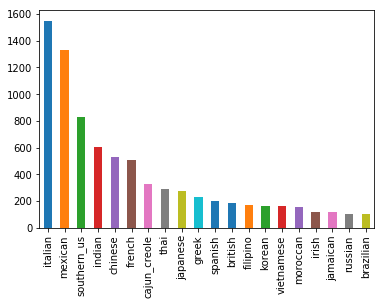

In [48]:
y_test.value_counts().plot(kind='bar')

In [49]:
from sklearn.neighbors import KNeighborsClassifier

neigh = KNeighborsClassifier(n_neighbors=21)
neigh.fit(X_train, y_train)

neigh.score(X_test, y_test)

0.5994971715901949

In [50]:
from sklearn.neighbors import KNeighborsClassifier

neigh = KNeighborsClassifier(n_neighbors=20)
neigh.fit(X_train, y_train)

neigh.score(X_test, y_test)

0.6022627278441232

In [105]:
#this is for the classification report y labels
cuisines = trainData['cuisine'].value_counts(sort=False).index
cuisines

Index(['cajun_creole', 'moroccan', 'thai', 'russian', 'filipino', 'spanish',
       'italian', 'indian', 'vietnamese', 'irish', 'british', 'jamaican',
       'french', 'chinese', 'mexican', 'brazilian', 'greek', 'japanese',
       'korean', 'southern_us'],
      dtype='object')

In [106]:
#this is for the classification report y target_names
cuisineslist = cuisines.tolist()

In [107]:
neigh_pred = neigh.predict(X_test)
print(classification_report(y_test, neigh_pred, labels = cuisines, target_names=cuisineslist))

              precision    recall  f1-score   support

cajun_creole       0.67      0.54      0.59       327
    moroccan       0.77      0.24      0.37       152
        thai       0.83      0.32      0.46       292
     russian       0.39      0.20      0.27       104
    filipino       0.51      0.19      0.27       171
     spanish       0.71      0.12      0.20       201
     italian       0.51      0.88      0.64      1550
      indian       0.77      0.75      0.76       605
  vietnamese       0.48      0.33      0.39       163
       irish       0.33      0.15      0.21       121
     british       0.53      0.04      0.08       184
    jamaican       0.84      0.23      0.36       117
      french       0.43      0.39      0.41       508
     chinese       0.63      0.73      0.67       529
     mexican       0.75      0.81      0.78      1331
   brazilian       0.51      0.25      0.34       102
       greek       0.73      0.48      0.58       229
    japanese       0.72    

In [108]:
from sklearn import tree

dec = tree.DecisionTreeClassifier()
dec.fit(X_train, y_train)

dec.score(X_test, y_test)

0.627906976744186

In [109]:
dec_pred = dec.predict(X_test)
print(classification_report(y_test, dec_pred, labels = cuisines, target_names=cuisineslist))

              precision    recall  f1-score   support

cajun_creole       0.67      0.60      0.63       327
    moroccan       0.62      0.48      0.54       152
        thai       0.66      0.54      0.59       292
     russian       0.36      0.27      0.31       104
    filipino       0.45      0.23      0.31       171
     spanish       0.49      0.23      0.32       201
     italian       0.56      0.82      0.67      1550
      indian       0.77      0.74      0.75       605
  vietnamese       0.51      0.40      0.45       163
       irish       0.42      0.35      0.38       121
     british       0.52      0.22      0.31       184
    jamaican       0.74      0.43      0.54       117
      french       0.44      0.43      0.43       508
     chinese       0.65      0.68      0.66       529
     mexican       0.81      0.81      0.81      1331
   brazilian       0.47      0.43      0.45       102
       greek       0.64      0.56      0.60       229
    japanese       0.64    

In [111]:
from sklearn.tree import _tree

def tree_to_code(tree, feature_names):
    tree_ = tree.tree_
    feature_name = [
        feature_names[i] if i != _tree.TREE_UNDEFINED else "undefined!"
        for i in tree_.feature
    ]
    print("def tree({}):".format(", ".join(feature_names)))

    def recurse(node, depth):
        indent = "  " * depth
        if tree_.feature[node] != _tree.TREE_UNDEFINED:
            name = feature_name[node]
            threshold = tree_.threshold[node]
            print("{}if {} <= {}:".format(indent, name, threshold))
            recurse(tree_.children_left[node], depth + 1)
            print("{}else:  # if {} > {}".format(indent, name, threshold))
            recurse(tree_.children_right[node], depth + 1)
        else:
            print("{}return {}".format(indent, tree_.value[node]))

    recurse(0, 1)

In [113]:
tree_to_code(dec,final_ingredients_features)

def tree(feta cheese crumbles, feta cheese, dried oregano, greek seasoning, pitted kalamata olives, kalamata, fresh oregano, phyllo dough, ground lamb, grape leaves, greek yogurt, fresh dill, ouzo, greek style plain yogurt, pita bread, kefalotyri, pitas, hummus, pita bread rounds, black olives, dill, orzo, tzatziki, plain yogurt, dried mint flakes, romaine lettuce, phyllo, tahini, dried dill, greek-style vinaigrette, pita loaves, bulgur, frozen chopped spinach, grape tomatoes, pita rounds, nonfat plain greek yogurt, oregano, capers, lamb shoulder, english cucumber, artichoke hearts, plain low-fat yogurt, whole wheat pita, pita wedges, kasseri, sliced kalamata olives, sliced black olives, garbanzo beans, cherry tomatoes, phyllo pastry, grits, collard greens, buttermilk, bourbon whiskey, quickcooking grits, yellow corn meal, white cornmeal, chopped pecans, black-eyed peas, cajun seasoning, cornmeal, country ham, peaches, green tomatoes, self-rising cornmeal, pecan halves, crawfish, key l

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          return [[1. 0.

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                        return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                         

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                        return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]]
                                                                                                                                                                                                                                         

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                else:  # if poppy seeds > 0.5
                                                                                                                                                                                                                                                                                                                                                                                          

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                        return [[0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 3. 0. 0. 0. 0.]]
                                                                                                                                                                                                                                                                                                                                                                                                                         

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                    return [[0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                                                                                                                                                                                                                                                                                                             

                                                                                                                                                                                                                                                                                                                                                                                                      else:  # if smoked haddock > 0.5
                                                                                                                                                                                                                                                                                                                                                                                                        return [[0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                  

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                                                                                                                                                                                                                                                                else:  # if crushed tomatoes > 0.5
                                                                                                                                                                                                                                                                  return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                                                                                                              else:  # if fresh thyme > 0.5
                                                                                                

                                                                                                                                                                                                                  if peanut butter <= 0.5:
                                                                                                                                                                                                                    if cherry tomatoes <= 0.5:
                                                                                                                                                                                                                      if wonton wrappers <= 0.5:
                                                                                                                                                                                                                        if toasted sesame seeds <= 0.5:
                                     

                                                                                                                                                                                                                                                                                                              if peanut butter <= 0.5:
                                                                                                                                                                                                                                                                                                                if roasted peanuts <= 0.5:
                                                                                                                                                                                                                                                                                                                  if meyer lemon <= 0.5:
             

                                                                                                                                                                                                            return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
                                                                                                                                                                                                        else:  # if ground red pepper > 0.5
                                                                                                                                                                                                          return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
                                                                                                                                                                                                      else:  # if golden

                                                                                                                                                                                                                                  else:  # if calvados > 0.5
                                                                                                                                                                                                                                    return [[0. 0. 0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                                                                                else:  # if fresh thyme > 0.5
                                                                                                                                                                                                  

                                                                                                                                                                                                      return [[0. 0. 0. 3. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                                                  else:  # if beansprouts > 0.5
                                                                                                                                                                                                    return [[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]]
                                                                                                                                                                                                else:  # if water chestnuts > 0.5
              

                                                                                                                                                          return [[0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                      else:  # if shrimp stock > 0.5
                                                                                                                                                        return [[0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                    else:  # if fresh thyme > 0.5
                                                                                                                                                      if large shrimp <= 0.5:
                   

                                                                                                                                                                                            else:  # if pearl onions > 0.5
                                                                                                                                                                                              return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]
                                                                                                                                                                                        else:  # if crushed tomatoes > 0.5
                                                                                                                                                                                          if old bay seasoning <= 0.5:
                                                                                      

                                                                                                                                                  if bittersweet chocolate <= 0.5:
                                                                                                                                                    if semisweet chocolate <= 0.5:
                                                                                                                                                      if vanilla beans <= 0.5:
                                                                                                                                                        if cognac <= 0.5:
                                                                                                                                                          if parmigiano-reggiano cheese <= 0.5:
                                                                                                         

                                                                                                                                                    if fennel bulb <= 0.5:
                                                                                                                                                      if black olives <= 0.5:
                                                                                                                                                        if fresh thyme <= 0.5:
                                                                                                                                                          if dried dill <= 0.5:
                                                                                                                                                            if frozen pastry puff sheets <= 0.5:
                                                                                                               

                                                                                                                                                          return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                      else:  # if potato starch > 0.5
                                                                                                                                                        return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                    else:  # if sherry vinegar > 0.5
                                                                                                                                                      return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

                                                                                                                  return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                              else:  # if gai lan > 0.5
                                                                                                                if fermented black beans <= 0.5:
                                                                                                                  return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 2. 0.]]
                                                                                                                else:  # if fermented black beans > 0.5
                                                                                                                  return [[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
            

                                                                                                  if roasted peanuts <= 0.5:
                                                                                                    if brown mustard seeds <= 0.5:
                                                                                                      if capers <= 0.5:
                                                                                                        if dried thyme <= 0.5:
                                                                                                          if queso fresco <= 0.5:
                                                                                                            if refried beans <= 0.5:
                                                                                                              if fontina cheese <= 0.5:
                                                                                                  

                                                                                                        return [[0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                  else:  # if malt vinegar > 0.5
                                                                                                    return [[0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                else:  # if stout > 0.5
                                                                                                  return [[0. 0. 0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                              else:  # if fresh tarragon > 0.5
                                                                                                if parsley sp

                                                                                                    return [[1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                else:  # if pinenuts > 0.5
                                                                                                  return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                              else:  # if cheese tortellini > 0.5
                                                                                                return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                            else:  # if cannellini beans > 0.5
                                                                                              return [[0. 0. 0. 0

                                                                                                                                                                                                else:  # if fettucine > 0.5
                                                                                                                                                                                                  return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                                              else:  # if ricotta cheese > 0.5
                                                                                                                                                                                                return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                             

                                                                                                                                                                                                                return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                                                            else:  # if cherry tomatoes > 0.5
                                                                                                                                                                                                              return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                                                          else

                                                                                                                      if arborio rice <= 0.5:
                                                                                                                        if parmigiano-reggiano cheese <= 0.5:
                                                                                                                          if peaches <= 0.5:
                                                                                                                            if country bread <= 0.5:
                                                                                                                              if pizza doughs <= 0.5:
                                                                                                                                if grape tomatoes <= 0.5:
                                                                                                          

                                                                                                  if pie crust <= 0.5:
                                                                                                    if peaches <= 0.5:
                                                                                                      if sour cream <= 0.5:
                                                                                                        if baking soda <= 0.5:
                                                                                                          if mini marshmallows <= 0.5:
                                                                                                            if refrigerated piecrusts <= 0.5:
                                                                                                              if pecan halves <= 0.5:
                                                                                                    

                                                                                                                    else:  # if thai basil > 0.5
                                                                                                                      return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                else:  # if reduced sodium soy sauce > 0.5
                                                                                                                  if cashew nuts <= 0.5:
                                                                                                                    return [[0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                  else:  # if cashew nuts > 0.5
                                           

                                                                                              return [[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                          else:  # if toasted sesame seeds > 0.5
                                                                                            return [[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                        else:  # if Shaoxing wine > 0.5
                                                                                          return [[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                      else:  # if water chestnuts > 0.5
                                                                                        return [[0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

                                                                      if sherry vinegar <= 0.5:
                                                                        if polenta <= 0.5:
                                                                          if arborio rice <= 0.5:
                                                                            if spaghetti <= 0.5:
                                                                              if prosciutto <= 0.5:
                                                                                if pinenuts <= 0.5:
                                                                                  if chopped fresh thyme <= 0.5:
                                                                                    if marinara sauce <= 0.5:
                                                                                      if pasta <= 0.5:
                                                                                        if f

                                                                                                                                                                                                                    if sour cream <= 0.5:
                                                                                                                                                                                                                      if chayotes <= 0.5:
                                                                                                                                                                                                                        if salsa verde <= 0.5:
                                                                                                                                                                                                                          if romaine lettuce <= 0.5:
                                                

                                                            if hungarian sweet paprika <= 0.5:
                                                              if phyllo pastry <= 0.5:
                                                                if green olives <= 0.5:
                                                                  if cardamom pods <= 0.5:
                                                                    if plain low-fat yogurt <= 0.5:
                                                                      if cashew nuts <= 0.5:
                                                                        if red lentils <= 0.5:
                                                                          if red chili powder <= 0.5:
                                                                            return [[0. 0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
                                                                          else:  # if red chili powder

                                              else:  # if plain yogurt > 0.5
                                                return [[0. 0. 0. 0. 0. 0. 0. 5. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                            else:  # if curry leaves > 0.5
                                              return [[0. 0. 0. 0. 0. 0. 0. 5. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                          else:  # if coconut milk > 0.5
                                            if fresh lime juice <= 0.5:
                                              if cilantro root <= 0.5:
                                                if peanut butter <= 0.5:
                                                  return [[0. 0. 0. 0. 0. 0. 0. 6. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                else:  # if peanut butter > 0.5
                                                  return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]]
 

                                          else:  # if baguette > 0.5
                                            return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                        else:  # if dried oregano > 0.5
                                          if fontina cheese <= 0.5:
                                            if pitted kalamata olives <= 0.5:
                                              return [[ 0.  0.  0.  0.  0.  0. 52.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.]]
                                            else:  # if pitted kalamata olives > 0.5
                                              if fresh oregano <= 0.5:
                                                if ground red pepper <= 0.5:
                                                  if capers <= 0.5:
                                                    if english cucumber <= 0.5:
                                                      if pita bread <= 0.5:
  

                                                                                                                                                  if low-fat buttermilk <= 0.5:
                                                                                                                                                    if chopped green bell pepper <= 0.5:
                                                                                                                                                      if ground thyme <= 0.5:
                                                                                                                                                        if Johnsonville Smoked Sausage <= 0.5:
                                                                                                                                                          if small red potato <= 0.5:
                                                                                            

                                                                                                                                                      else:  # if crushed tomatoes > 0.5
                                                                                                                                                        return [[ 0.  0.  0.  0.  0.  0.  0.  0.  0. 12.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.]]
                                                                                                                                                    else:  # if part-skim mozzarella cheese > 0.5
                                                                                                                                                      return [[ 0.  0.  0.  0.  0.  0.  0.  0.  0. 13.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.]]
                                                                                                                                     

                                                        return [[0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                    else:  # if orzo > 0.5
                                                      return [[0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                else:  # if roasted red peppers > 0.5
                                                  if large shrimp <= 0.5:
                                                    return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                  else:  # if large shrimp > 0.5
                                                    return [[0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                              else:  # if cannellini beans > 0.5
                                                return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 

                                                                                                                                                                                                                                                                        else:  # if allspice > 0.5
                                                                                                                                                                                                                                                                          return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
                                                                                                                                                                                                                                                                      else:  # if dark corn syrup > 0.5
                                                                            

                                                      if beansprouts <= 0.5:
                                                        return [[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                      else:  # if beansprouts > 0.5
                                                        return [[0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                  else:  # if ginger paste > 0.5
                                                    return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]]
                                                else:  # if curry powder > 0.5
                                                  return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]]
                                            else:  # if dark soy sauce > 0.5
                                              if tonkatsu sauce <= 0.5:
                                

                                                                                                                                                                        else:  # if fresh curry leaves > 0.5
                                                                                                                                                                          return [[0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                      else:  # if star anise > 0.5
                                                                                                                                                                        return [[0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                        

                                                                        else:  # if miso paste > 0.5
                                                                          return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 3. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                      else:  # if dark soy sauce > 0.5
                                                                        return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 5. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                    else:  # if white miso > 0.5
                                                                      return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 5. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                  else:  # if low sodium soy sauce > 0.5
                                                                    return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 5. 0. 0. 0. 0. 0. 0. 0. 0.]]
                          

                                                                                                                                                                                                            else:  # if cardamom pods > 0.5
                                                                                                                                                                                                              return [[0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                                                          else:  # if pita bread > 0.5
                                                                                                                                                                                                            if cilantro leaves <= 0.5:
                         

                                                          if hot sauce <= 0.5:
                                                            if pepper jack <= 0.5:
                                                              if nonfat plain greek yogurt <= 0.5:
                                                                if crushed tomatoes <= 0.5:
                                                                  if tortilla chips <= 0.5:
                                                                    return [[ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0. 10.  1.  0.  0.  0.
   0.  0.]]
                                                                  else:  # if tortilla chips > 0.5
                                                                    return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
                                                                else:  # if crushed tomatoes > 0.5
                                                         

                                    if chunky peanut butter <= 0.5:
                                      if thyme <= 0.5:
                                        if kaffir lime leaves <= 0.5:
                                          if minced ginger <= 0.5:
                                            if 1% low-fat milk <= 0.5:
                                              if cilantro leaves <= 0.5:
                                                if plain yogurt <= 0.5:
                                                  if chopped cilantro fresh <= 0.5:
                                                    if mustard seeds <= 0.5:
                                                      if ground lamb <= 0.5:
                                                        if extra firm tofu <= 0.5:
                                                          if corn starch <= 0.5:
                                                            if slivered almonds <= 0.5:
                                  

                                                                                                                                                                    if beets <= 0.5:
                                                                                                                                                                      if old bay seasoning <= 0.5:
                                                                                                                                                                        if potato starch <= 0.5:
                                                                                                                                                                          if fresh thyme <= 0.5:
                                                                                                                                                                            if coconut <= 0.5:
                                               

                                                                                        if shredded cheddar cheese <= 0.5:
                                                                                          if lime juice <= 0.5:
                                                                                            if enchilada sauce <= 0.5:
                                                                                              if tortilla chips <= 0.5:
                                                                                                if fresh lime juice <= 0.5:
                                                                                                  if cilantro leaves <= 0.5:
                                                                                                    if taco seasoning <= 0.5:
                                                                                                      if kidney beans <= 0.5:
                         

                                                                                                                                                                      else:  # if ground turmeric > 0.5
                                                                                                                                                                        return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 2.]]
                                                                                                                                                                    else:  # if Sriracha > 0.5
                                                                                                                                                                      if corn starch <= 0.5:
                                                                                                                                                                        return [[0. 0

                                                if creamy peanut butter <= 0.5:
                                                  if garlic chili sauce <= 0.5:
                                                    if toasted sesame seeds <= 0.5:
                                                      if curry powder <= 0.5:
                                                        if large shrimp <= 0.5:
                                                          if bird chile <= 0.5:
                                                            if sweet chili sauce <= 0.5:
                                                              if fresh basil leaves <= 0.5:
                                                                if Sriracha <= 0.5:
                                                                  if palm sugar <= 0.5:
                                                                    if galangal <= 0.5:
                                                                      if lemo

                                                                                                                                                                                        return [[0. 0. 0. 3. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                                      else:  # if minced ginger > 0.5
                                                                                                                                                                                        return [[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                                  else:  # if chili oil > 0.5
                                                                      

                                                if cornflour <= 0.5:
                                                  if low sodium soy sauce <= 0.5:
                                                    if medium shrimp <= 0.5:
                                                      if rice vinegar <= 0.5:
                                                        if dry sherry <= 0.5:
                                                          if gai lan <= 0.5:
                                                            if chinese five-spice powder <= 0.5:
                                                              if dark soy sauce <= 0.5:
                                                                if yams <= 0.5:
                                                                  if seaweed <= 0.5:
                                                                    if chow mein noodles <= 0.5:
                                                                      if toasted sesame oil 

                        if chili oil <= 0.5:
                          if peanut oil <= 0.5:
                            if palm sugar <= 0.5:
                              if fish sauce <= 0.5:
                                if extra firm tofu <= 0.5:
                                  if dried bonito flakes <= 0.5:
                                    if gari <= 0.5:
                                      if cilantro leaves <= 0.5:
                                        if spring roll wrappers <= 0.5:
                                          if light soy sauce <= 0.5:
                                            if dark soy sauce <= 0.5:
                                              if dried rice noodles <= 0.5:
                                                if bok choy <= 0.5:
                                                  if seaweed <= 0.5:
                                                    if low sodium soy sauce <= 0.5:
                                                      if

                                                                                                                                          return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                      else:  # if chayotes > 0.5
                                                                                                                                        return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                    else:  # if Sriracha > 0.5
                                                                                                                                      return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
                                                           

                                                  if green chilies <= 0.5:
                                                    if tumeric <= 0.5:
                                                      return [[  0.   0.   0.   0.   0.   0.   0. 341.   0.   0.   0.   0.   0.   0.
    0.   0.   0.   0.   0.   0.]]
                                                    else:  # if tumeric > 0.5
                                                      if coriander powder <= 0.5:
                                                        if cumin seed <= 0.5:
                                                          return [[ 0.  0.  0.  0.  0.  0.  0. 66.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.]]
                                                        else:  # if cumin seed > 0.5
                                                          if fresh coriander <= 0.5:
                                                            if chickpeas <= 0.5:
                                               

                                                                                                                                                                                                                                                                        else:  # if poppy seeds > 0.5
                                                                                                                                                                                                                                                                          return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                                                                                                                      else:  # if dried currants > 0.5
                                                                          

                                                                                                                                                  return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                              else:  # if dried oregano > 0.5
                                                                                                                                                return [[0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                        else:  # if arborio rice > 0.5
                                                                                                                                          return [[ 0.  0.  0.  0.  0.  0.  0.  0.  0. 74.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0

In [116]:
from sklearn.naive_bayes import MultinomialNB

bayes = MultinomialNB()
#todense() method used to coerce ndarray from csr (sparse) to dense format
#only seemed to be throwing errors on the training matrix, unsure why
bayes.fit(X_train, y_train)

bayes.score(X_test, y_test)

0.691514770584538

In [117]:
bayes_pred = bayes.predict(X_test)
print(classification_report(y_test, bayes_pred, labels = cuisines, target_names=cuisineslist))

              precision    recall  f1-score   support

cajun_creole       0.67      0.62      0.65       327
    moroccan       0.70      0.67      0.69       152
        thai       0.64      0.76      0.69       292
     russian       0.74      0.34      0.46       104
    filipino       0.83      0.35      0.49       171
     spanish       0.63      0.30      0.41       201
     italian       0.59      0.87      0.70      1550
      indian       0.83      0.84      0.83       605
  vietnamese       0.71      0.43      0.54       163
       irish       0.55      0.36      0.44       121
     british       0.64      0.25      0.36       184
    jamaican       0.76      0.60      0.67       117
      french       0.54      0.46      0.50       508
     chinese       0.70      0.81      0.75       529
     mexican       0.85      0.85      0.85      1331
   brazilian       0.71      0.29      0.42       102
       greek       0.77      0.64      0.70       229
    japanese       0.88    

In [118]:
from sklearn.ensemble import RandomForestClassifier

frst = RandomForestClassifier(random_state=37)
frst.fit(X_train, y_train)

frst.score(X_test, y_test)

0.651414204902577

In [119]:
frst_pred = frst.predict(X_test)
print(classification_report(y_test, frst_pred, labels = cuisines, target_names=cuisineslist))

              precision    recall  f1-score   support

cajun_creole       0.75      0.58      0.66       327
    moroccan       0.72      0.48      0.57       152
        thai       0.68      0.62      0.65       292
     russian       0.55      0.34      0.42       104
    filipino       0.44      0.25      0.31       171
     spanish       0.54      0.26      0.35       201
     italian       0.57      0.85      0.68      1550
      indian       0.77      0.80      0.79       605
  vietnamese       0.55      0.39      0.46       163
       irish       0.46      0.37      0.41       121
     british       0.56      0.19      0.28       184
    jamaican       0.71      0.44      0.55       117
      french       0.49      0.42      0.45       508
     chinese       0.67      0.72      0.69       529
     mexican       0.82      0.84      0.83      1331
   brazilian       0.58      0.34      0.43       102
       greek       0.68      0.56      0.62       229
    japanese       0.69    

In [120]:
#### Section 3.5: Logistic Regression Classifer

In [121]:
from sklearn.linear_model import LogisticRegression

logistic = LogisticRegression()
logistic.fit(X_train, y_train)

logistic.score(X_test, y_test)

0.6872407291011943

Text(0.5,64.6,'Predicted label')

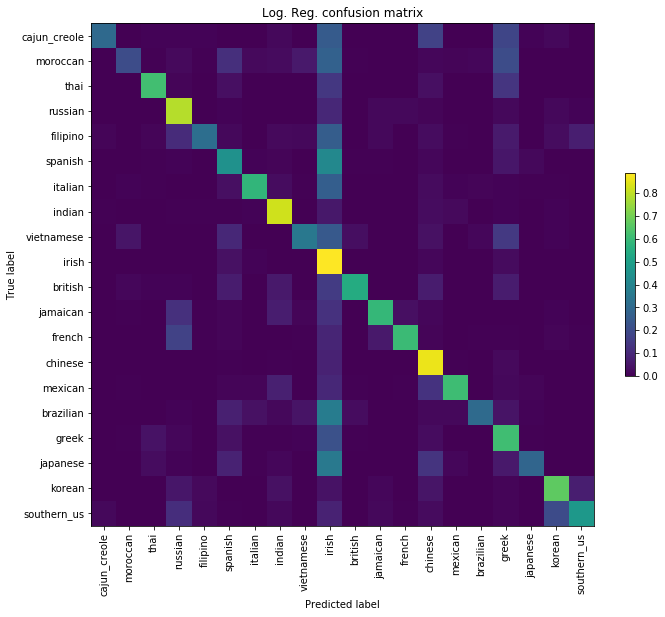

In [122]:
plt.figure(figsize=(10, 10))

log_cm = confusion_matrix(y_test, logistic.predict(X_test))
log_cm_normalized = log_cm.astype('float') / log_cm.sum(axis=1)[:, np.newaxis]

plt.imshow(log_cm_normalized, interpolation='nearest')
plt.title("Log. Reg. confusion matrix")
plt.colorbar(shrink=0.3)

tick_marks = np.arange(len(cuisines))
plt.xticks(tick_marks, cuisines, rotation=90)
plt.yticks(tick_marks, cuisines)
plt.tight_layout()
plt.ylabel('True label')
plt.xlabel('Predicted label')

In [123]:
log_pred = logistic.predict(X_test)
print(classification_report(y_test, log_pred, labels = cuisines, target_names=cuisineslist))

              precision    recall  f1-score   support

cajun_creole       0.77      0.62      0.69       327
    moroccan       0.74      0.61      0.67       152
        thai       0.74      0.67      0.70       292
     russian       0.65      0.31      0.42       104
    filipino       0.72      0.32      0.45       171
     spanish       0.67      0.29      0.40       201
     italian       0.56      0.89      0.69      1550
      indian       0.84      0.82      0.83       605
  vietnamese       0.66      0.47      0.55       163
       irish       0.54      0.36      0.43       121
     british       0.61      0.21      0.31       184
    jamaican       0.77      0.55      0.64       117
      french       0.52      0.45      0.48       508
     chinese       0.73      0.79      0.76       529
     mexican       0.84      0.86      0.85      1331
   brazilian       0.74      0.30      0.43       102
       greek       0.77      0.59      0.66       229
    japanese       0.81    

In [124]:
#### Section 3.6: SVM Classifer

In [125]:
from sklearn.svm import LinearSVC

lsvc = LinearSVC(random_state=37)
lsvc.fit(X_train, y_train)

lsvc.score(X_test, y_test)

0.6942803268384664

Text(0.5,64.6,'Predicted label')

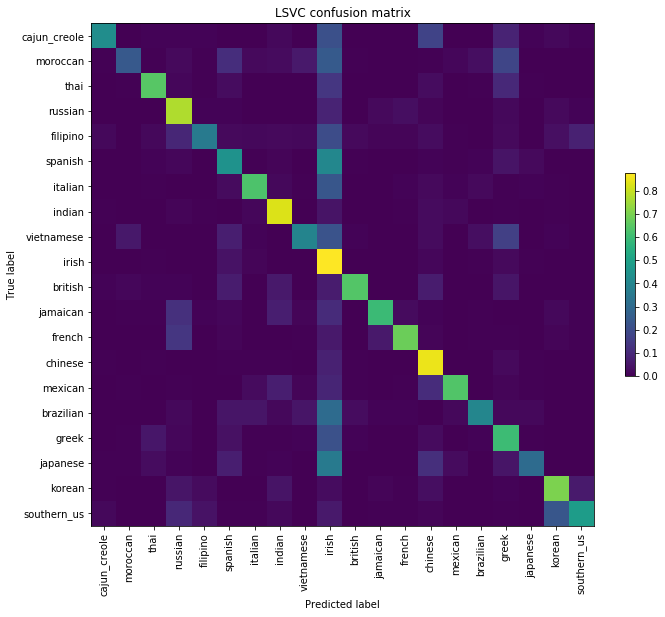

In [126]:
plt.figure(figsize=(10, 10))

lsvc_cm = confusion_matrix(y_test, lsvc.predict(X_test))
lsvc_cm_normalized = lsvc_cm.astype('float') / lsvc_cm.sum(axis=1)[:, np.newaxis]

plt.imshow(lsvc_cm_normalized, interpolation='nearest')
plt.title("LSVC confusion matrix")
plt.colorbar(shrink=0.3)

tick_marks = np.arange(len(cuisines))
plt.xticks(tick_marks, cuisines, rotation=90)
plt.yticks(tick_marks, cuisines)
plt.tight_layout()
plt.ylabel('True label')
plt.xlabel('Predicted label')

In [127]:
lsvc_pred = lsvc.predict(X_test)
print(classification_report(y_test, lsvc_pred, labels = cuisines, target_names=cuisineslist))

              precision    recall  f1-score   support

cajun_creole       0.74      0.65      0.69       327
    moroccan       0.73      0.64      0.68       152
        thai       0.73      0.71      0.72       292
     russian       0.49      0.40      0.44       104
    filipino       0.64      0.36      0.46       171
     spanish       0.60      0.31      0.41       201
     italian       0.58      0.88      0.70      1550
      indian       0.85      0.83      0.84       605
  vietnamese       0.66      0.48      0.56       163
       irish       0.55      0.40      0.46       121
     british       0.64      0.24      0.35       184
    jamaican       0.72      0.64      0.68       117
      french       0.53      0.45      0.49       508
     chinese       0.73      0.77      0.75       529
     mexican       0.87      0.85      0.86      1331
   brazilian       0.64      0.43      0.51       102
       greek       0.71      0.63      0.67       229
    japanese       0.82    